In [1]:
import os
import numpy as np
import glob as glob
import pandas as pd
from pathlib import Path
from scipy.io import loadmat
import matplotlib.pyplot as plt
import math
import seaborn as sns
import scipy 
from matplotlib.ticker import MultipleLocator
import sklearn
from sklearn.neighbors import KernelDensity
from sklearn.model_selection import GridSearchCV
from scipy.ndimage import gaussian_filter1d

# Import Data

In [2]:
MDN = pd.read_parquet(r"C:\1_Stop_project_allData\MDN_coactivation\Data_Structure\ball_predictions\MDN\df_ballpredictn.parquet", engine='pyarrow')
MDN  = MDN.loc[MDN['genotype']== 'MDN']

MDN_Stop1 = pd.read_parquet(r"C:\1_Stop_project_allData\MDN_coactivation\Data_Structure\ball_predictions\MDN_Stop1\df_ballpredictn.parquet", engine='pyarrow')
MDN_Stop1  = MDN_Stop1.loc[MDN_Stop1['genotype']== 'MDN_Stop1']

In [3]:
header = ['MDN', 'MDN+Stop1']  

# Heatmaps

In [4]:
def plot_heatmaps(df, title, angle):
    """
    # Plots Fe-Ti joint angle as a heatmap

    Parameters
    ----------
    df : dataframe
    title : title for plot
    """
    plt.rcParams['figure.figsize'] = (10,7)
    fig, ax = plt.subplots(3,2, sharex = True, sharey = True)
    vmin = 0
    vmax = 150
    cmap = 'coolwarm'
    

    sns.heatmap(ax = ax[0,0], data = np.array(df['L1' + angle]).reshape((int(len(df)/1400)), 1400), vmin = vmin, vmax = vmax, cmap = cmap, cbar=True)
    sns.heatmap(ax = ax[1,0], data = np.array(df['L2' + angle]).reshape((int(len(df)/1400)), 1400), vmin = vmin, vmax = 100, cmap = cmap, cbar=True)
    sns.heatmap(ax = ax[2,0], data = np.array(df['L3' + angle]).reshape((int(len(df)/1400)), 1400), vmin = vmin, vmax = vmax, cmap = cmap, cbar=True)
    sns.heatmap(ax = ax[0,1], data = np.array(df['R1' + angle]).reshape((int(len(df)/1400)), 1400), vmin = vmin, vmax = vmax, cmap = cmap, cbar=True)
    sns.heatmap(ax = ax[1,1], data = np.array(df['R2' + angle]).reshape((int(len(df)/1400)), 1400), vmin = vmin, vmax = 100, cmap = cmap, cbar=True)
    sns.heatmap(ax = ax[2,1], data = np.array(df['R3' + angle]).reshape((int(len(df)/1400)), 1400), vmin = vmin, vmax = vmax, cmap = cmap, cbar=True)
    ax[0,0].axvline(x = 400, color = 'k', alpha = 0.7, linestyle = '--')
    ax[1,0].axvline(x = 400, color = 'k', alpha = 0.7, linestyle = '--')
    ax[2,0].axvline(x = 400, color = 'k', alpha = 0.7, linestyle = '--')
    ax[0,1].axvline(x = 400, color = 'k', alpha = 0.7, linestyle = '--')
    ax[1,1].axvline(x = 400, color = 'k', alpha = 0.7, linestyle = '--')
    ax[2,1].axvline(x = 400, color = 'k', alpha = 0.7, linestyle = '--')

    ax[0,0].axvline(x = 1000, color = 'k', alpha = 0.7, linestyle = '--')
    ax[1,0].axvline(x = 1000, color = 'k', alpha = 0.7, linestyle = '--')
    ax[2,0].axvline(x = 1000, color = 'k', alpha = 0.7, linestyle = '--')
    ax[0,1].axvline(x = 1000, color = 'k', alpha = 0.7, linestyle = '--')
    ax[1,1].axvline(x = 1000, color = 'k', alpha = 0.7, linestyle = '--')
    ax[2,1].axvline(x = 1000, color = 'k', alpha = 0.7, linestyle = '--')
    plt.suptitle(title +' - ' + angle)
    plt.tight_layout()
    # plt.savefig(r'Z:\STOP PROJECT SHARED FOLDER\Fig2\07222023\1_Heatmaps\ES_66Hz.eps', format = 'eps',dpi = 300)
    # plt.savefig(r'Z:\STOP PROJECT SHARED FOLDER\Fig2\07222023\1_Heatmaps\ES_66Hz.tiff',format = 'tiff' ,dpi = 300)
    plt.show()

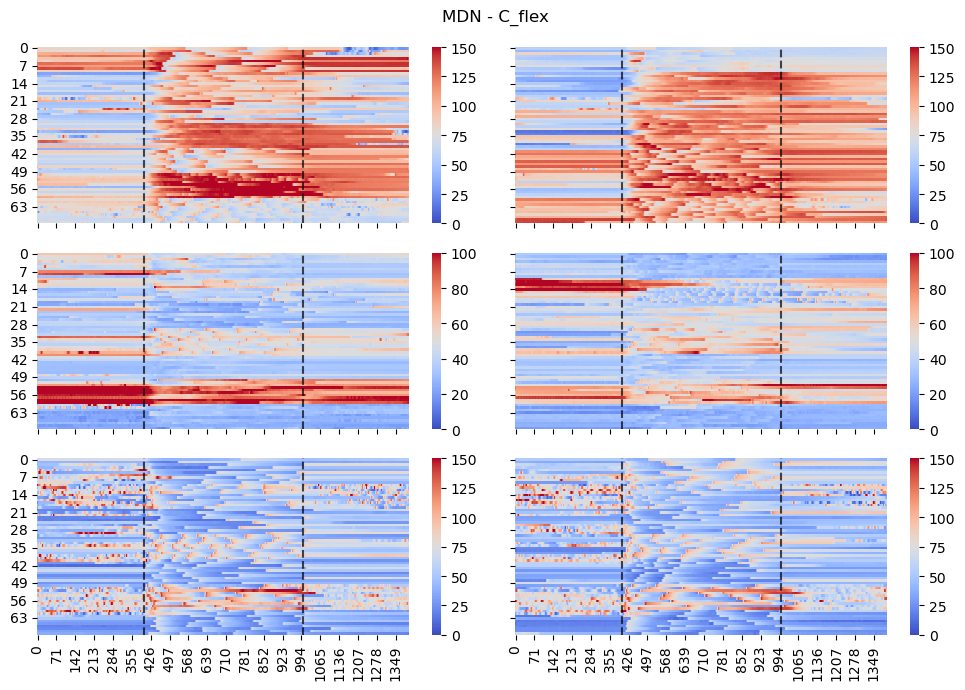

In [5]:
plot_heatmaps(MDN, 'MDN', 'C_flex')

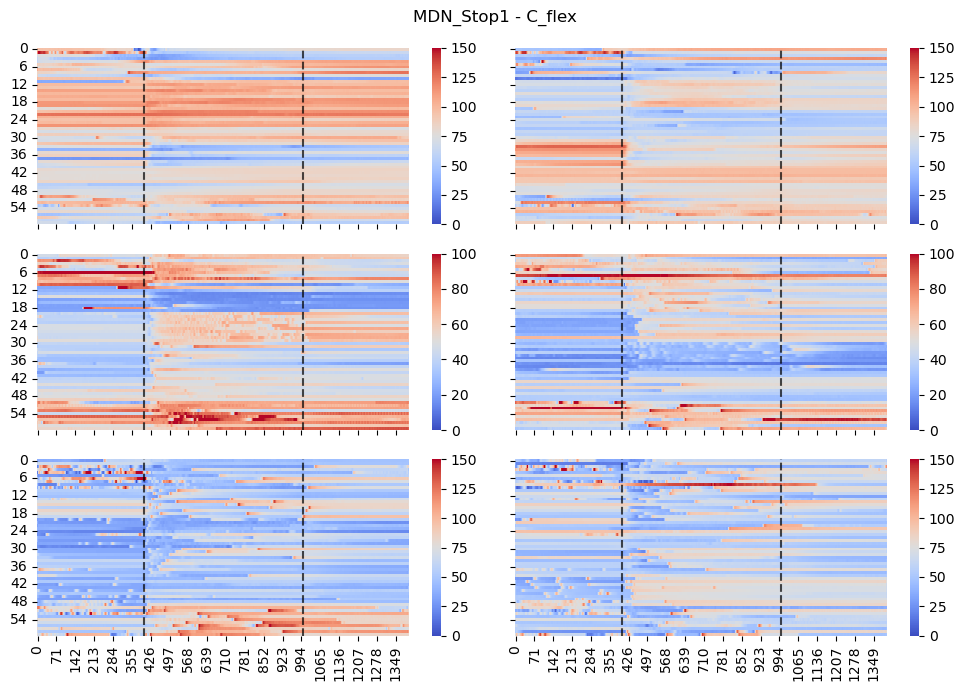

In [6]:
plot_heatmaps(MDN_Stop1, 'MDN_Stop1', 'C_flex')

# Front Leg

In [7]:
def get_reset_ang_Fleg (df, leg):
    """extracts the swing initiation time stamps and value of C_Flex angle at each swing initiation

    Parameters
    ----------
    df : DataFrame
        Data structure for the genotype

    leg : string: L1/R1


    Returns
    -------
    _type_
        _description_
    """
    if leg == 'L1':
        # sc = 'L-F_stepcycle'
        angle = 'L1C_flex'

    if leg =='R1':
        # sc = 'R-F_stepcycle'
        angle = 'R1C_flex'

    reset_ang = []
    swing_count = [] # number of separate events predicted to be swings from ball prediction and accompanied by a sudden, large change in angle
    reset_timepts = pd.DataFrame()

    for n in df['flynum'].unique().tolist():
        for t in df.groupby('flynum').get_group(n)['tnum'].unique().tolist():
            
            data = df.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)

            # sc_temp = pd.DataFrame(data[sc])
            ang = data[angle][400:1000]
            # sc_diff = pd.DataFrame(np.diff(sc_temp[sc].astype(int)))

            # swing_init =sc_diff.loc[sc_diff[0] == -1].index.tolist() # index from diff ==> add idx = 1 
            # swing_idx  =sc_temp.loc[sc_temp[sc] == False].index.tolist() # swing frames from ball prediction

            ang_diff = pd.DataFrame(np.diff(ang))
            ang_diff_resets = ang_diff.loc[(ang_diff[0]) < -3].index.tolist() #index from diff ==> add idx = 1 ## index from 0 to 599
            
            ang_diff_resets = [x+401 for x in ang_diff_resets] # indexing fixed
            
            # real_swing = []
            # for temp_swing in swing_idx:
            #     if ((temp_swing <1001) and (temp_swing> 400)):
            #         if temp_swing in ang_diff_resets:
            #             real_swing.append(temp_swing)  ## during swing there should be a sharp change in the Fe-Ti angle

            break_pt = np.split(ang_diff_resets, np.where(np.diff(ang_diff_resets)>10)[0]+1)
            swing_count.append(len(break_pt))
            try:
                for i in break_pt:
                    temp_ang = ang[i[0]]  ## FeTi flexion angle at swing initiation
                    reset_ang.append(temp_ang)
                    reset_timepts = pd.concat([reset_timepts, pd.DataFrame([n , t, i[0], temp_ang]).T], axis = 0)  ## reset time pts == swing initiations accompanied by sharp angle changes
            except:
                continue
    reset_timepts.columns = ['flynum', 'tnum', 'swing_ts', 'reset_ang']

    return reset_ang, swing_count, reset_timepts.reset_index(drop=True)

In [8]:
reset_ang_MDN_R1, swing_count_MDN_R1, swing_ts_MDN_R1 = get_reset_ang_Fleg(MDN, 'R1')
reset_ang_MDN_L1, swing_count_MDN_L1, swing_ts_MDN_L1 = get_reset_ang_Fleg(MDN, 'L1')

reset_ang_MDN_Stop1_R1, swing_count_MDN_Stop1_R1, swing_ts_MDN_Stop1_R1 = get_reset_ang_Fleg(MDN_Stop1, 'R1')
reset_ang_MDN_Stop1_L1, swing_count_MDN_Stop1_L1, swing_ts_MDN_Stop1_L1 = get_reset_ang_Fleg(MDN_Stop1, 'L1')

In [9]:
def get_Fleg_swings_test (df, swing_df, angle):

    plt.rcParams['figure.figsize'] = (10,2)
    # df = MDN
    # swing_df = swing_ts_MDN_L1
    # angle = 'L1C_flex'
    all_swings = pd.DataFrame()
    all_ang = []
    for n in df['flynum'].unique().tolist():
        
        for t in df.groupby('flynum').get_group(n)['tnum'].unique().tolist():
            temp_swings = []
            try:
                data = df.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)
                swings = swing_df.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)['swing_ts'].tolist()
                ang=  data[angle]

                diff = np.diff(ang).tolist()
                diff = [x+1 for x in diff]

                diff2 = np.diff(diff).tolist()
                diff2 = [x+1 for x in diff2]

                print((n,t))
                plt.plot(ang)

                plt.plot(diff)
                plt.plot(diff2) 
                # all_peaks = scipy.signal.find_peaks(ang, height=5, prominence=1)[0].tolist()
                for i in swings:
                    i = int(i)
                    plt.axvline(x = i, color = 'grey', alpha = 1)
                    temp_init = pd.DataFrame(diff2).iloc[i-5:i+5].idxmin()[0]
                
                    plt.axvline(x = temp_init, color = 'r', alpha = 1)

                    all_peaks = scipy.signal.find_peaks(ang[i-10:i],prominence=0.5)[0].tolist()
                    all_peaks = [x + i-10 for x in all_peaks]

                    if len(all_peaks) == 1:
                        temp_swings.append(all_peaks[0])
                        all_ang.append(ang[all_peaks[0]])
                    elif len(all_peaks) == 0:
                        temp_swings.append(temp_init)
                        all_ang.append(ang[temp_init])
                    else:
                        print('more than one peak found for ', (n,t))
                        temp_swings.append(temp_init)
                        all_ang.append(ang[temp_init])

                    for p in all_peaks:
                        plt.plot(p, ang[p], 'o')

                plt.xlim(400,800)
                for idx in temp_swings:
                    plt.axvline(x = idx,ls = '--', color = 'k' )
                plt.show()
                temp_swings = pd.DataFrame(temp_swings)
                temp_swings.columns = ['swing_ts_new']
                temp_swings.insert(0, 'tnum', t)
                temp_swings.insert(0, 'flynum', n)
                all_swings = pd.concat([all_swings, temp_swings.reset_index(drop=True) ], axis = 0)
            except:
                print('no swings in ',((n,t)))
    return all_swings, all_ang

(1, 1)


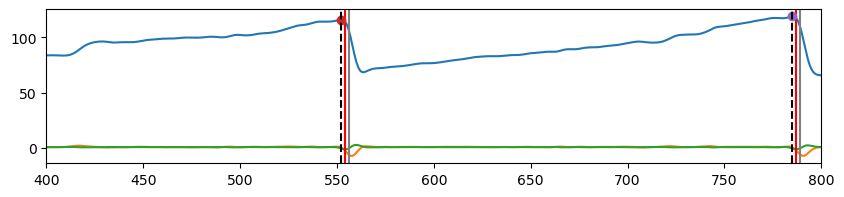

(1, 2)


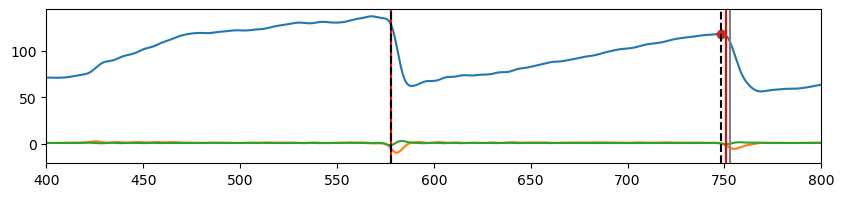

(1, 3)


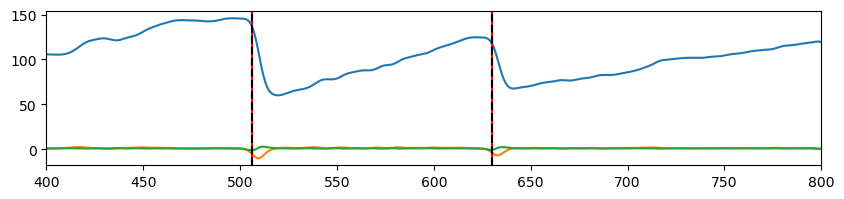

(1, 4)


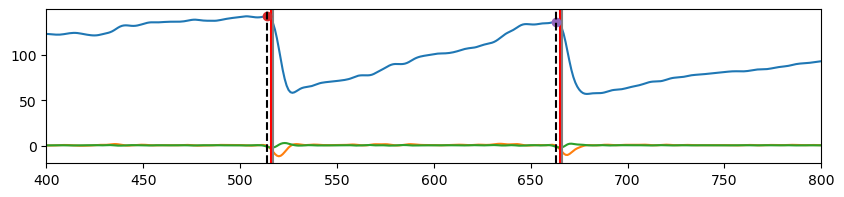

(1, 5)


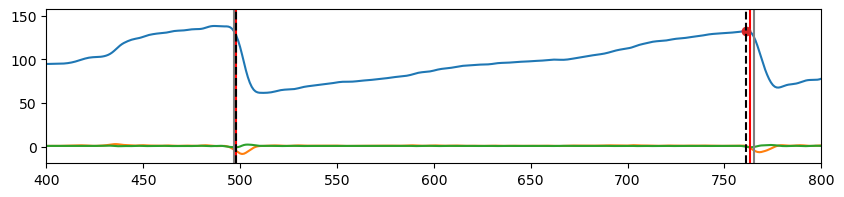

(1, 6)


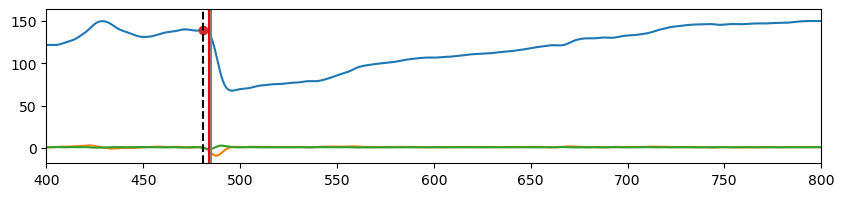

(1, 7)


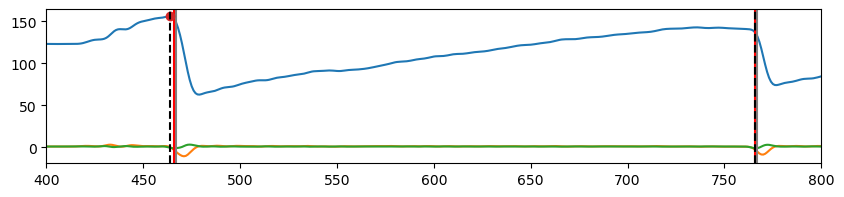

(1, 8)


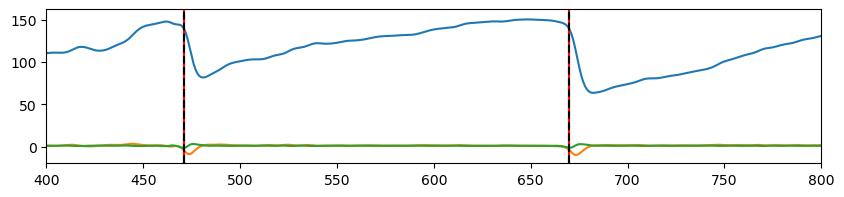

(1, 9)


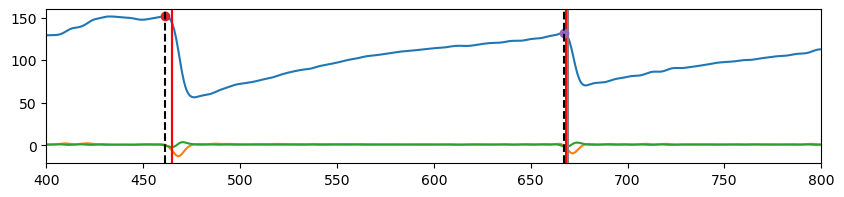

(1, 10)


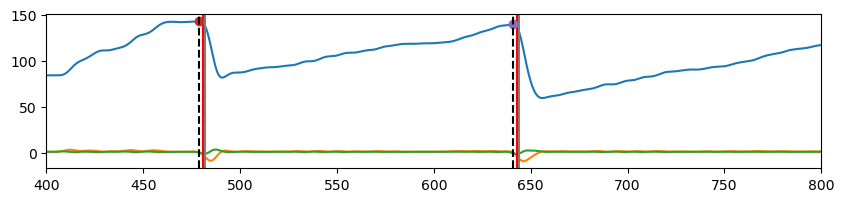

(2, 1)


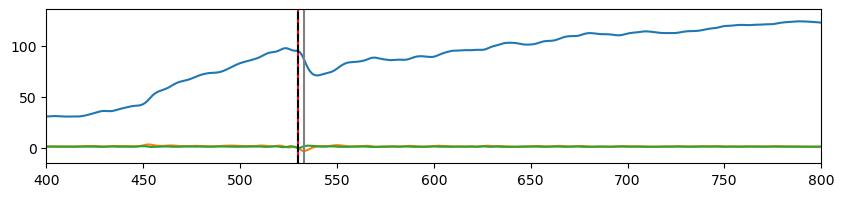

(2, 2)


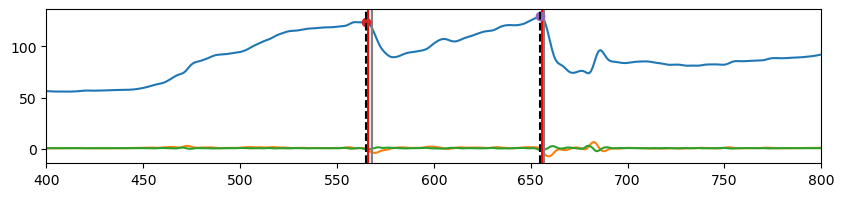

(2, 3)


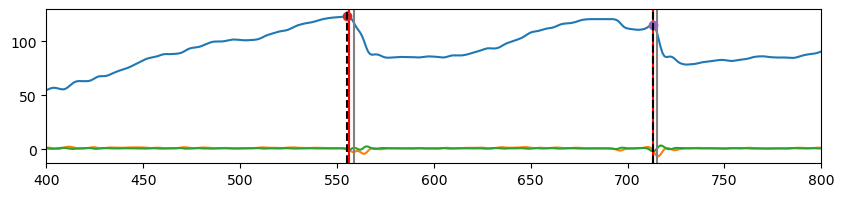

(2, 4)


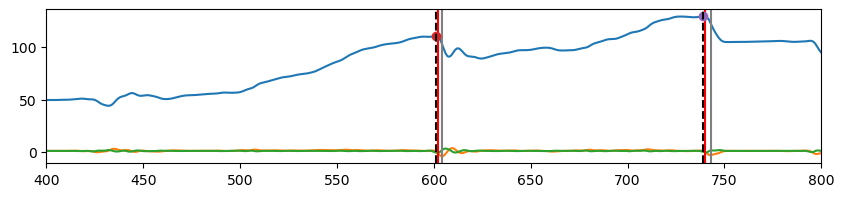

(2, 5)


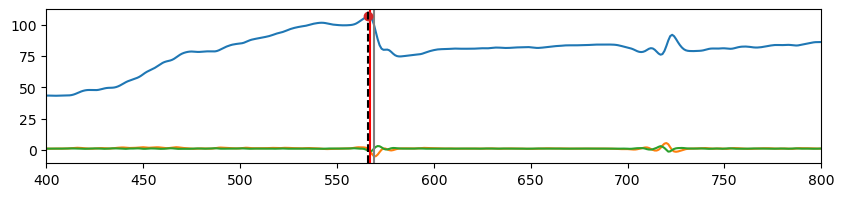

(2, 6)


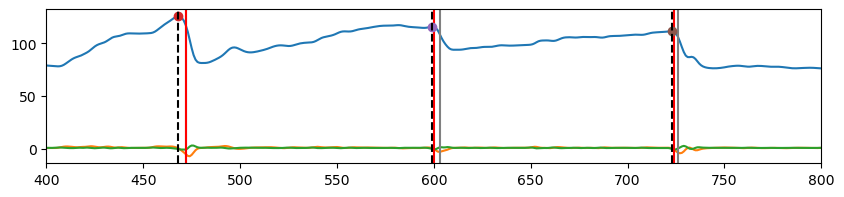

(2, 7)


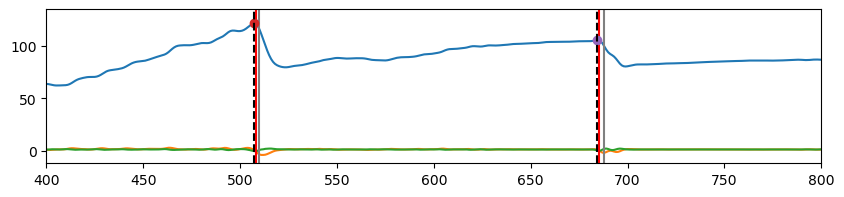

(2, 8)


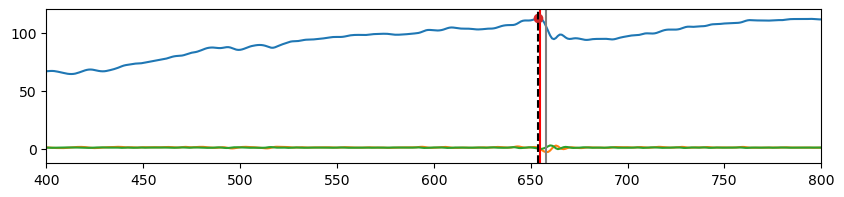

(2, 9)


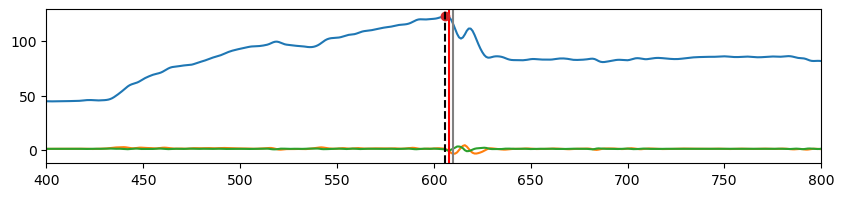

(2, 10)


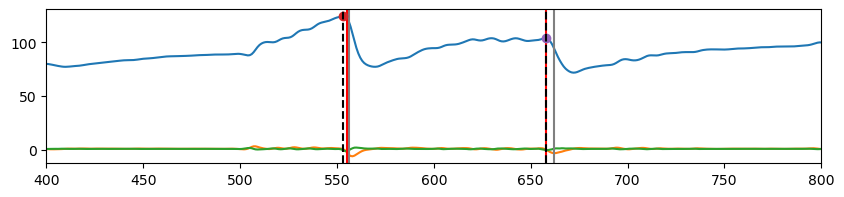

(3, 1)


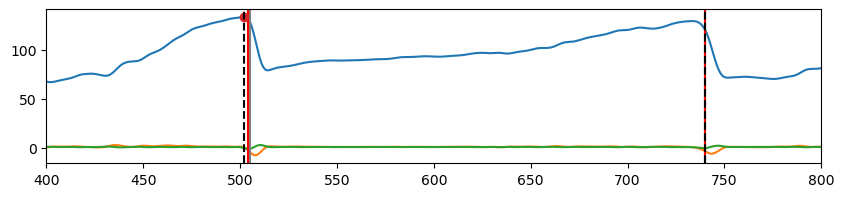

(3, 2)


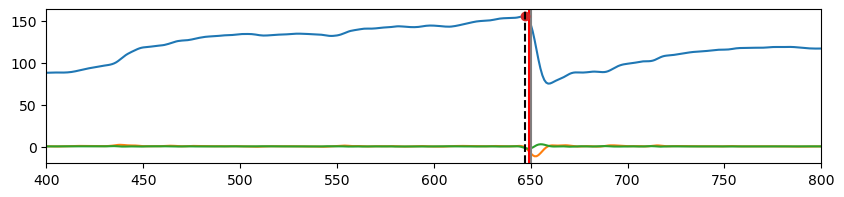

(3, 3)


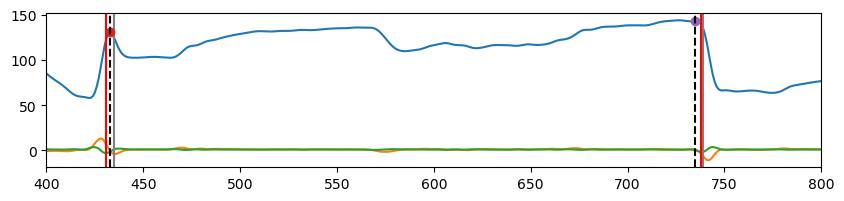

(3, 4)


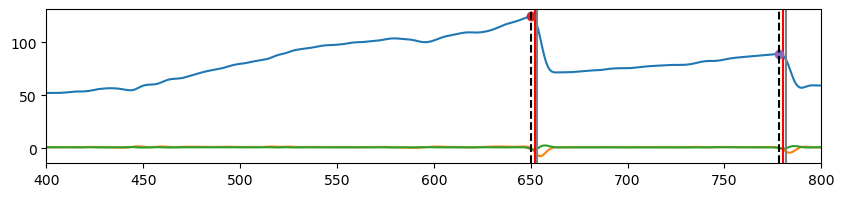

(3, 5)


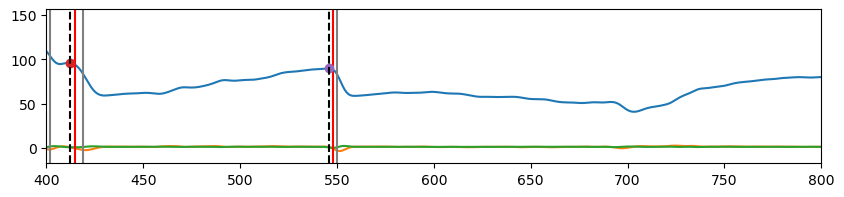

(3, 6)


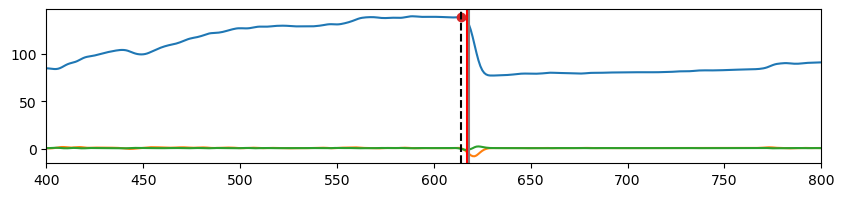

(3, 7)


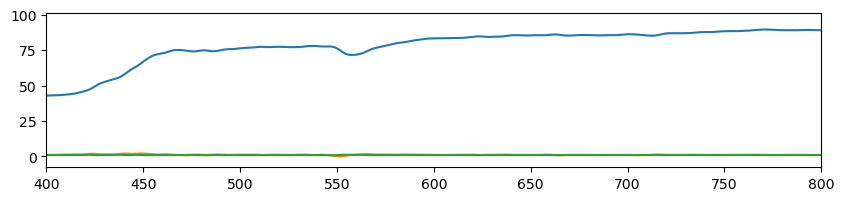

(3, 8)


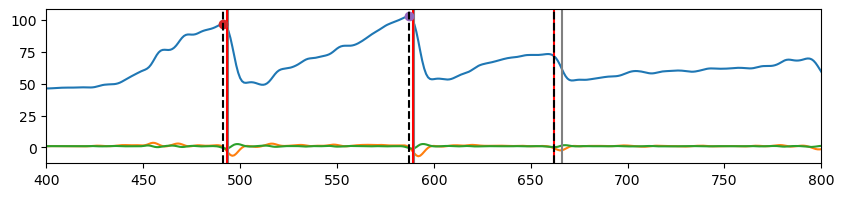

(3, 9)


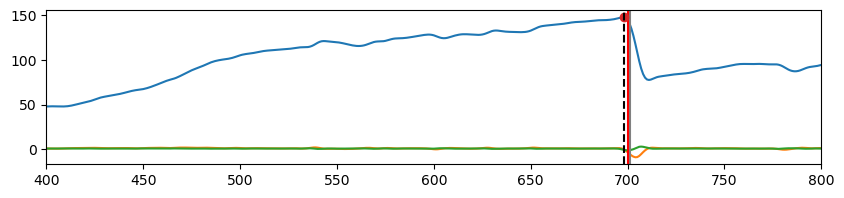

(3, 10)


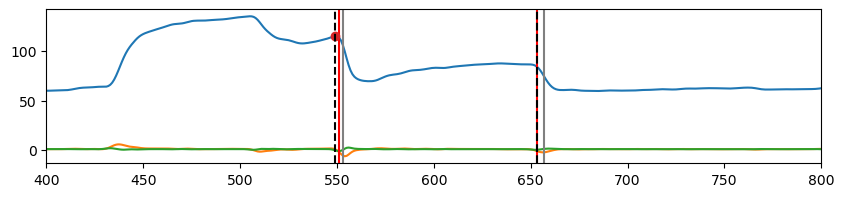

no swings in  (4, 1)
no swings in  (4, 2)
no swings in  (4, 3)
no swings in  (4, 4)
no swings in  (4, 5)
no swings in  (4, 6)
(4, 7)


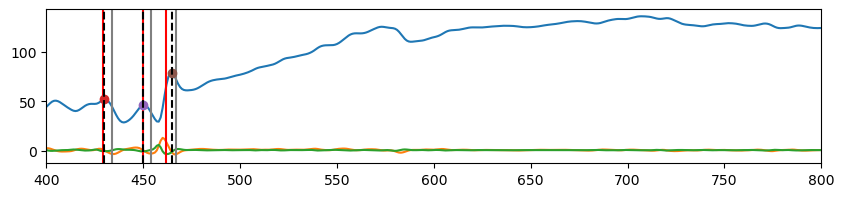

no swings in  (4, 8)
no swings in  (4, 9)
no swings in  (4, 10)
(5, 1)


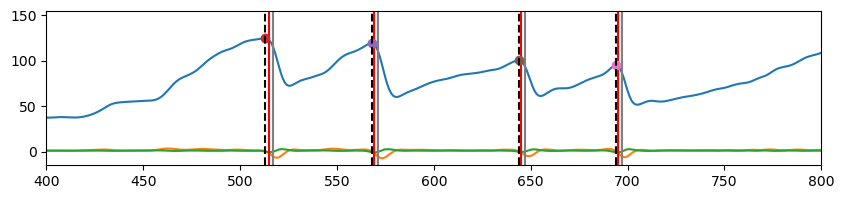

(5, 2)


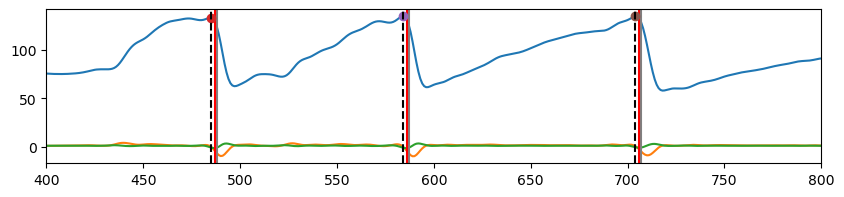

(5, 3)


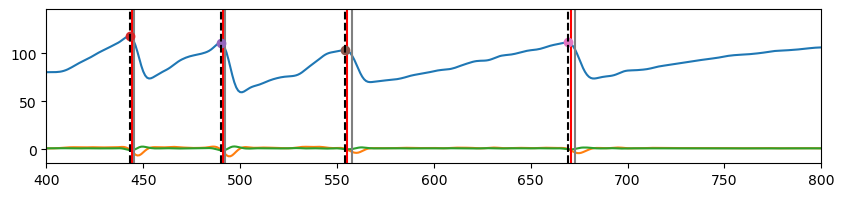

(5, 4)


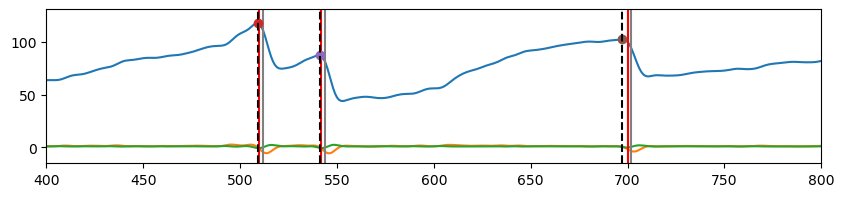

(5, 5)


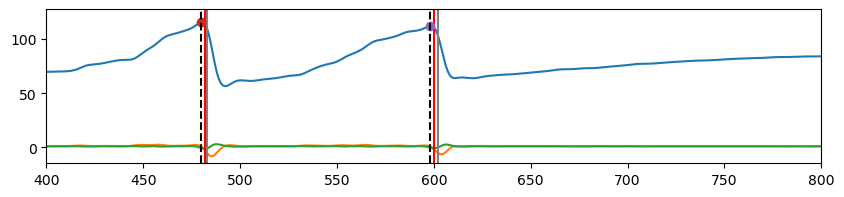

(5, 6)


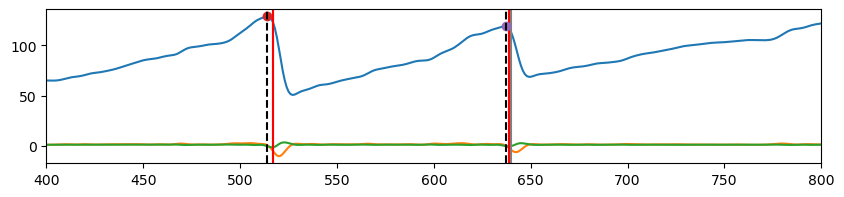

(5, 7)


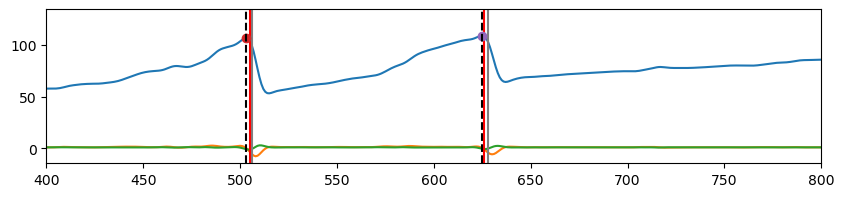

(5, 8)


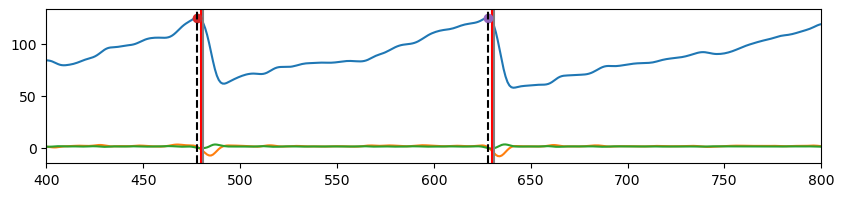

(5, 9)


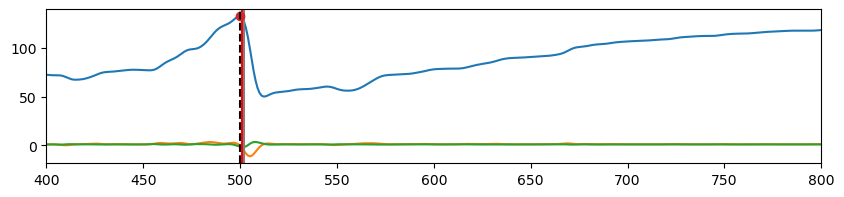

(5, 10)


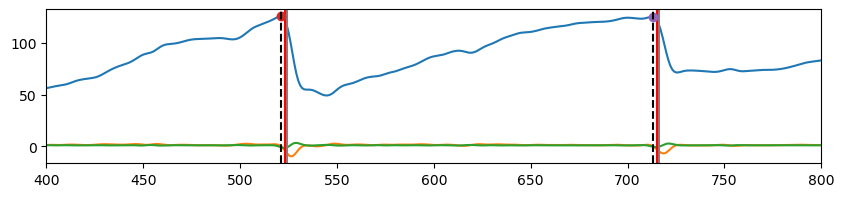

(6, 1)


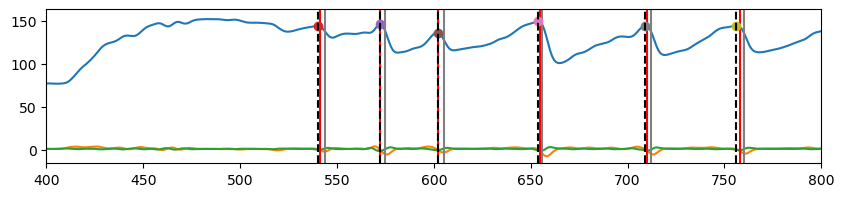

(6, 2)


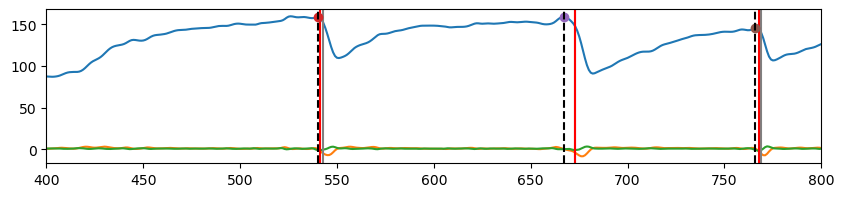

(6, 3)


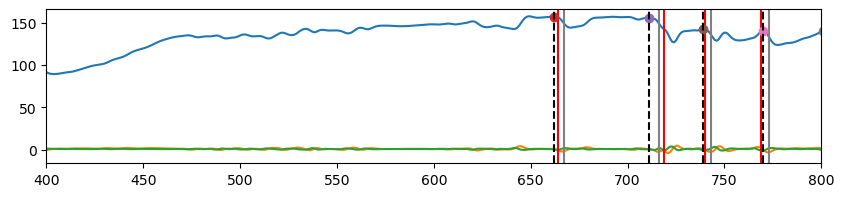

(6, 4)


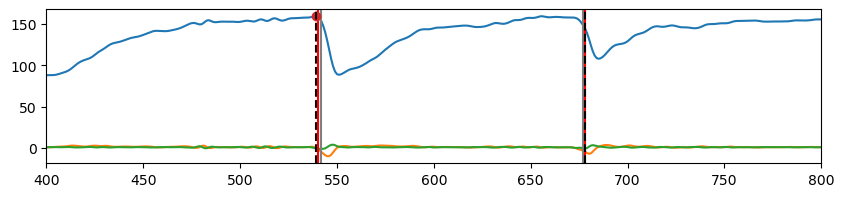

(6, 5)


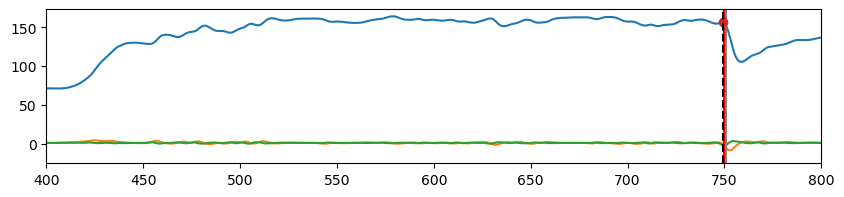

no swings in  (6, 6)
(6, 7)


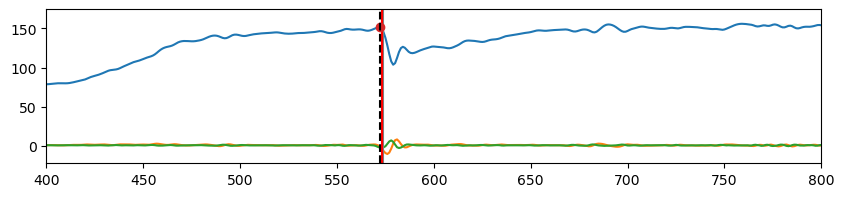

(6, 8)


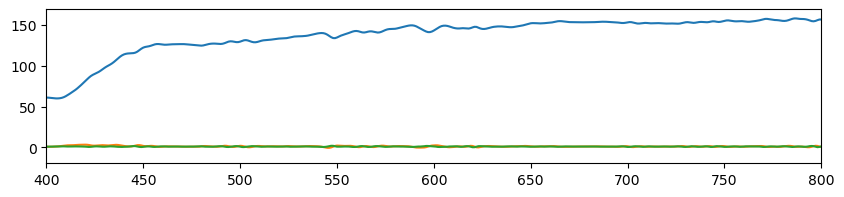

(6, 9)


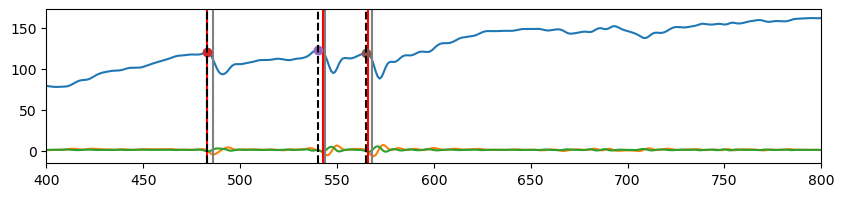

(6, 10)


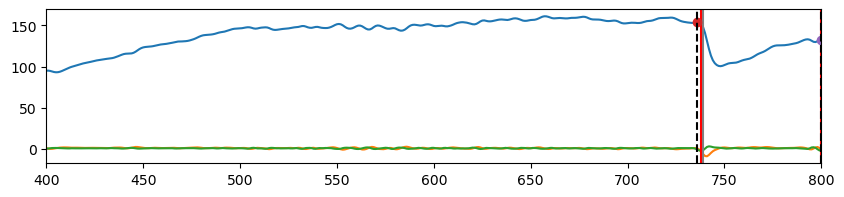

(7, 1)


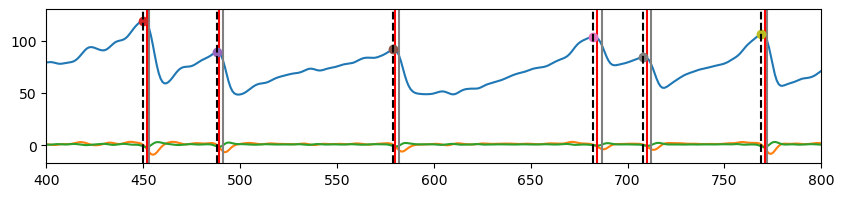

(7, 2)


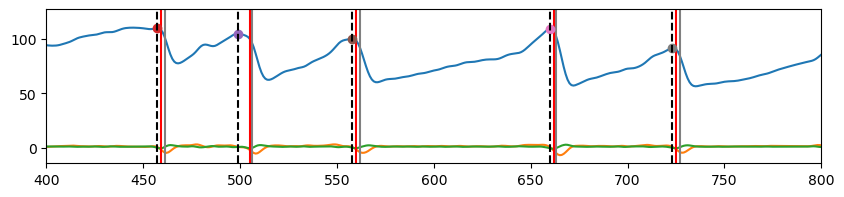

(7, 3)


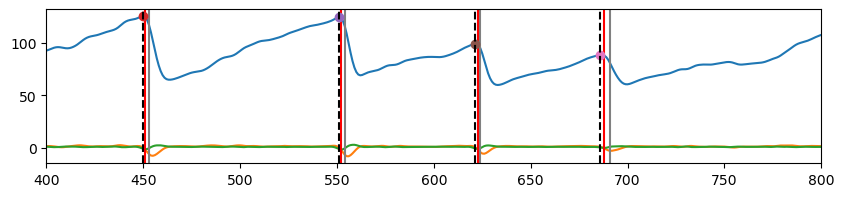

(7, 4)


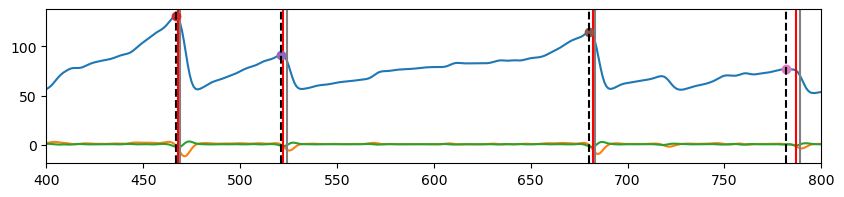

(7, 5)


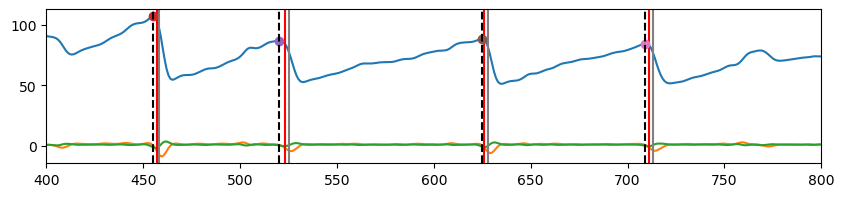

(7, 6)


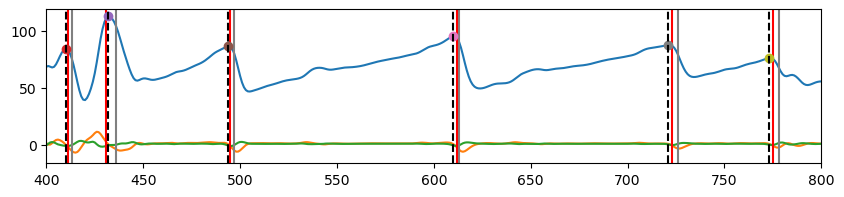

(7, 7)


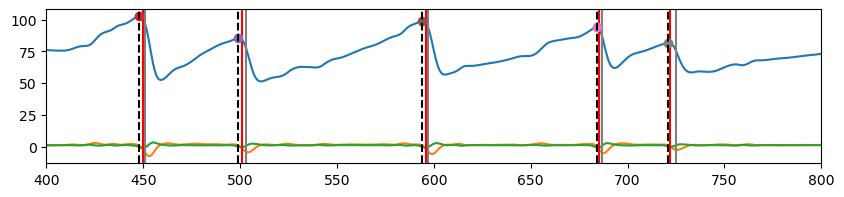

(7, 8)


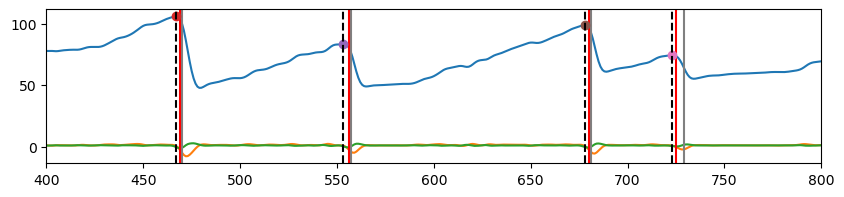

(7, 9)


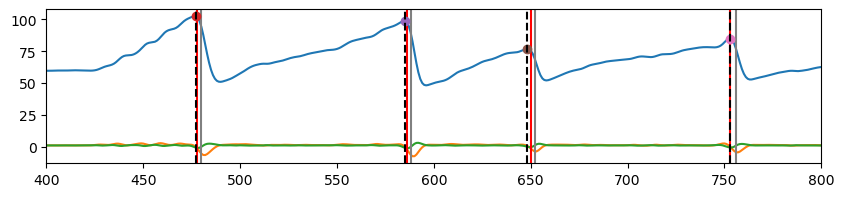

(7, 10)


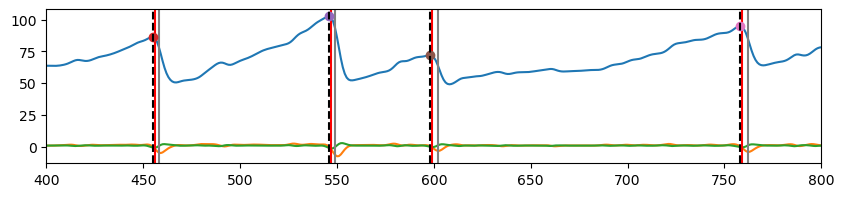

(1, 1)


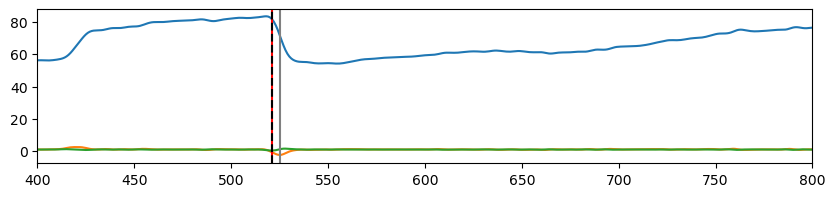

no swings in  (1, 2)
(1, 3)


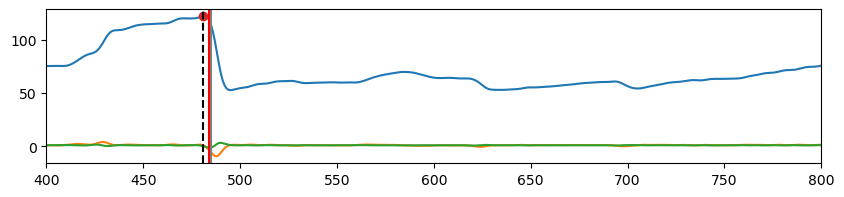

no swings in  (1, 4)
(1, 5)


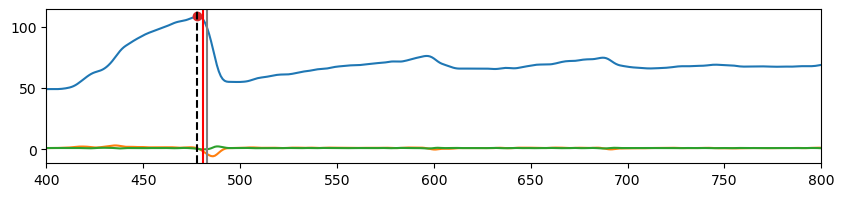

(1, 6)


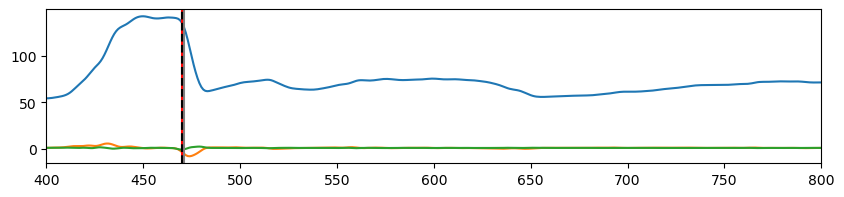

(1, 7)


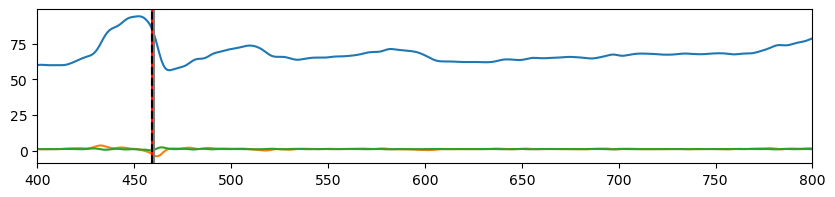

no swings in  (1, 8)
(1, 9)


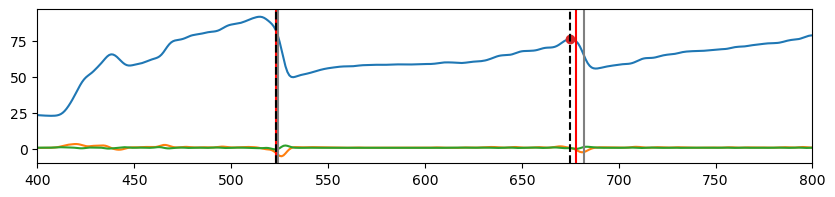

(1, 10)


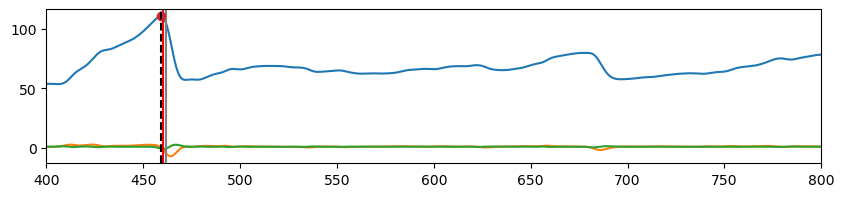

no swings in  (2, 1)
(2, 2)


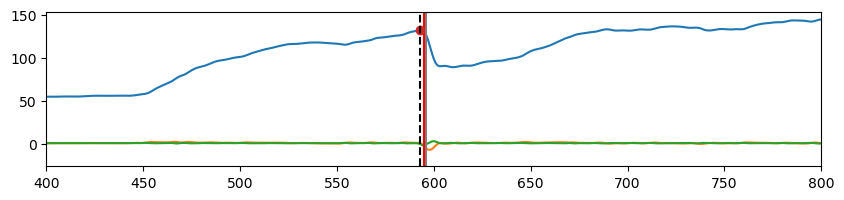

(2, 3)


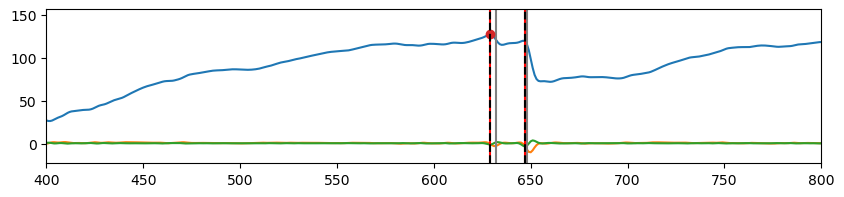

no swings in  (2, 4)
no swings in  (2, 5)
(2, 6)


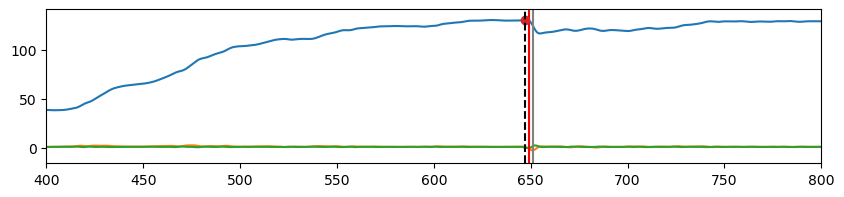

(2, 7)


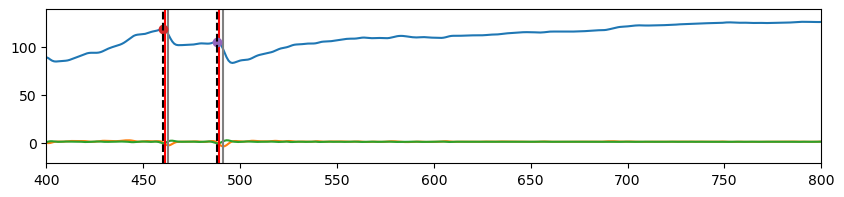

(2, 8)


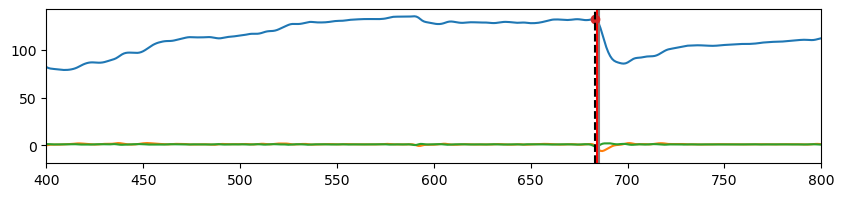

no swings in  (2, 9)
(2, 10)


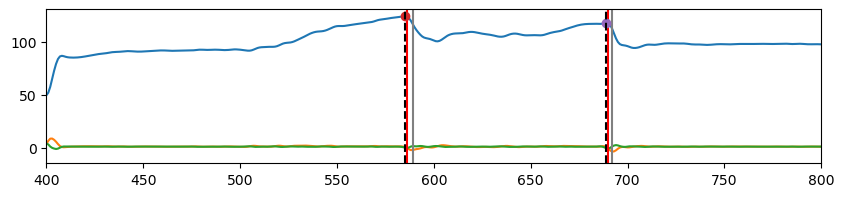

no swings in  (3, 1)
(3, 2)


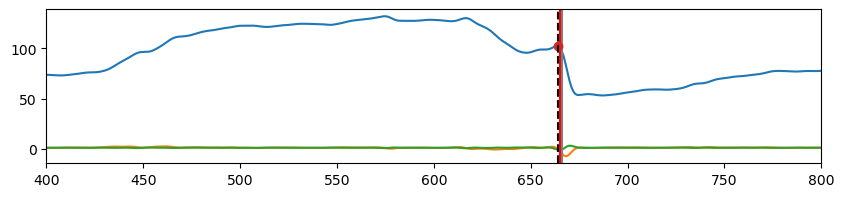

(3, 3)


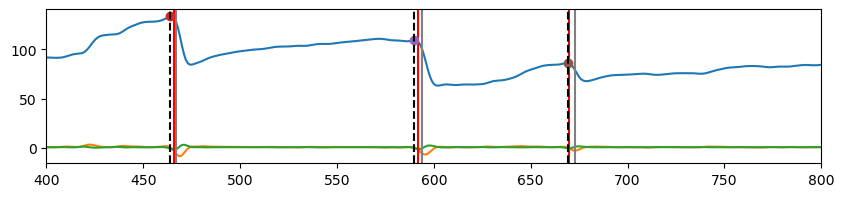

no swings in  (3, 4)
no swings in  (3, 5)
no swings in  (3, 6)
no swings in  (3, 7)
(3, 8)


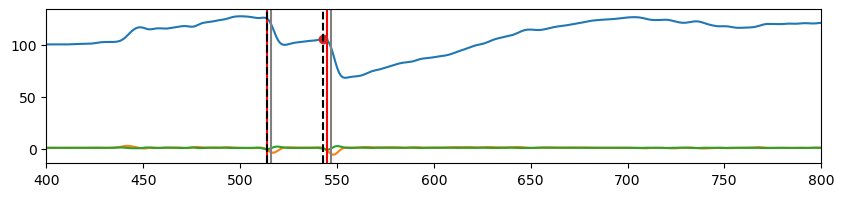

no swings in  (3, 9)
no swings in  (3, 10)
(4, 1)


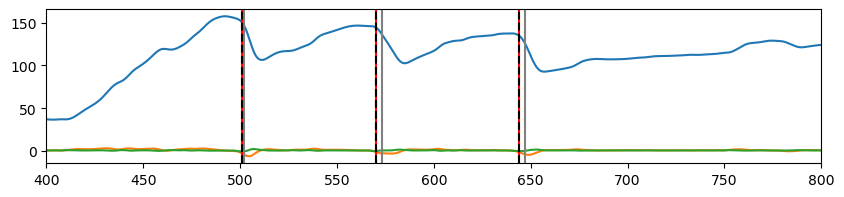

(4, 2)


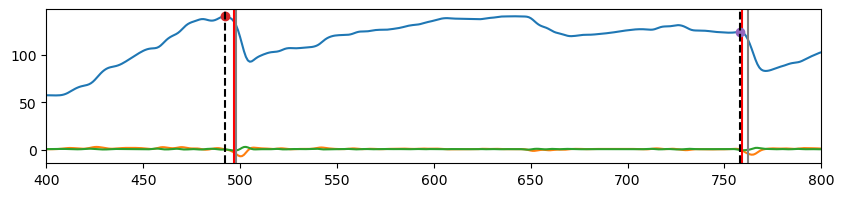

no swings in  (4, 3)
(4, 4)


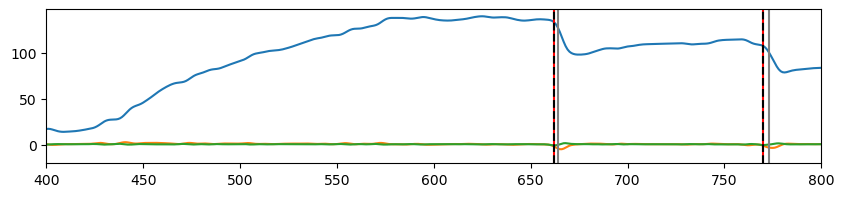

no swings in  (4, 5)
(4, 6)


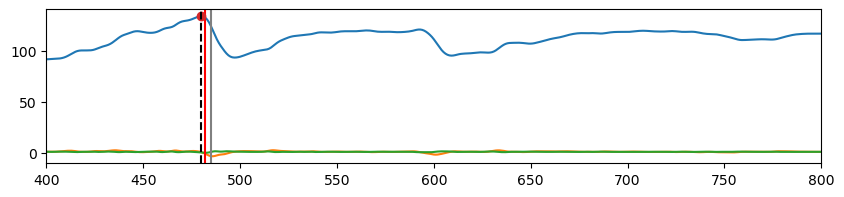

(4, 7)


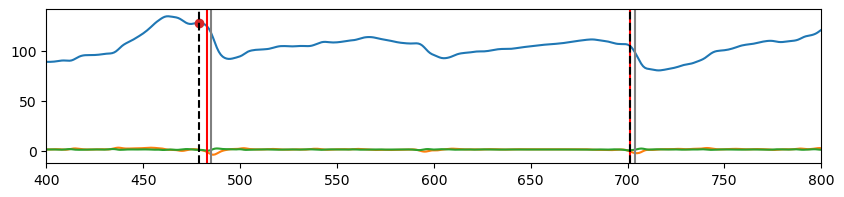

(4, 8)


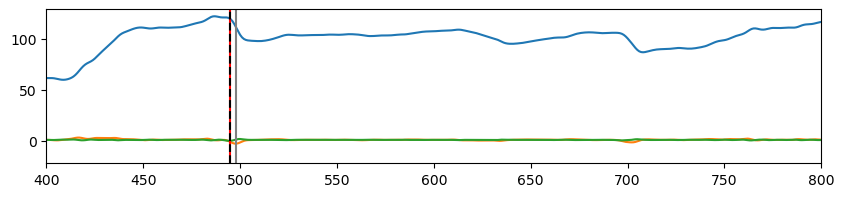

(4, 9)


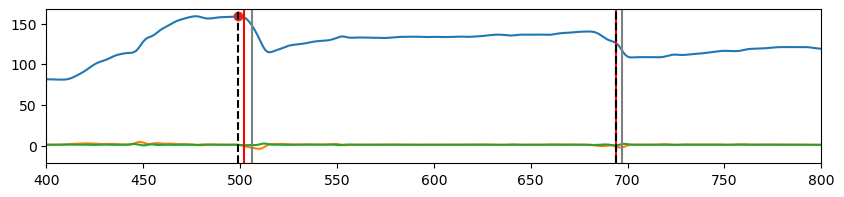

(4, 10)


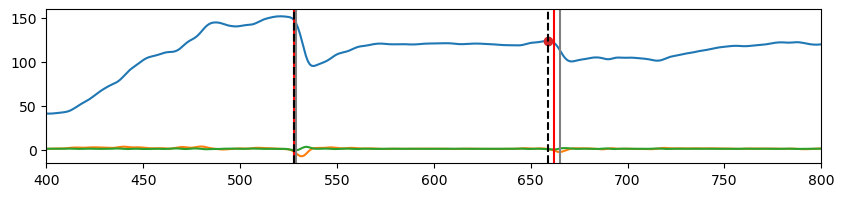

(5, 1)


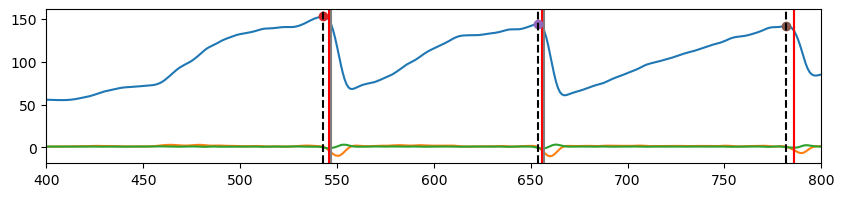

(5, 2)


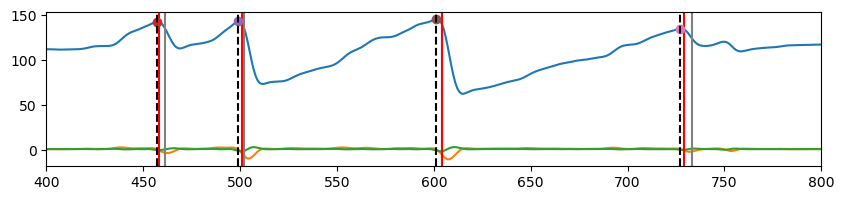

(5, 3)


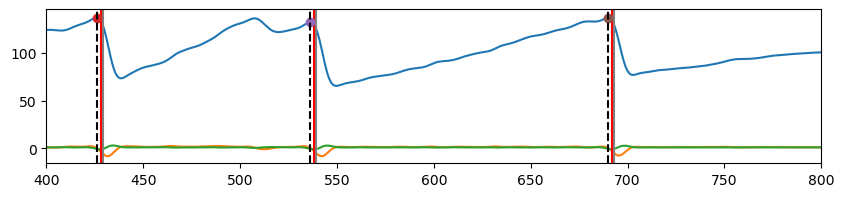

(5, 4)


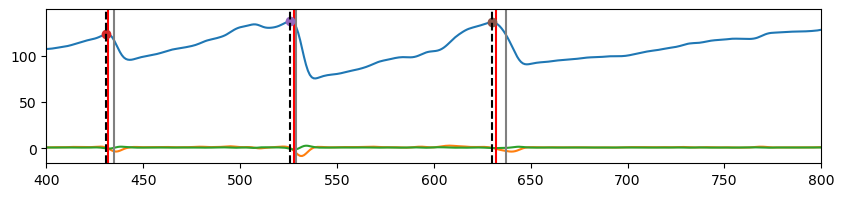

(5, 5)


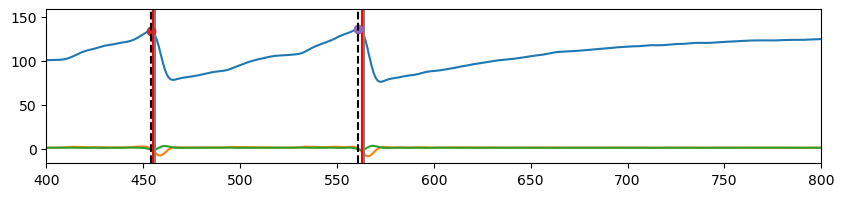

(5, 6)


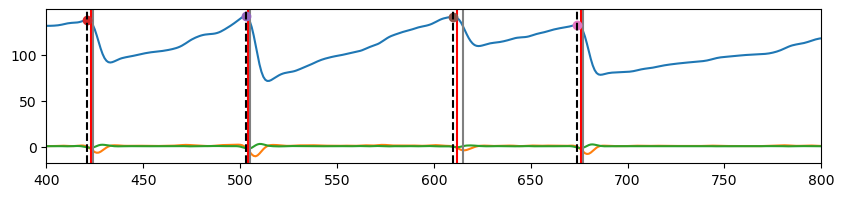

(5, 7)


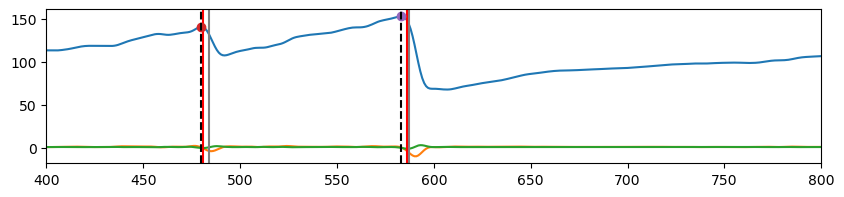

(5, 8)


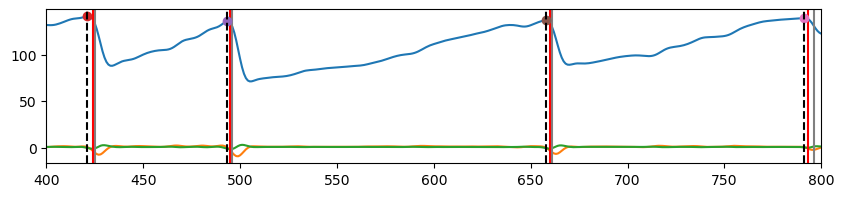

(5, 9)


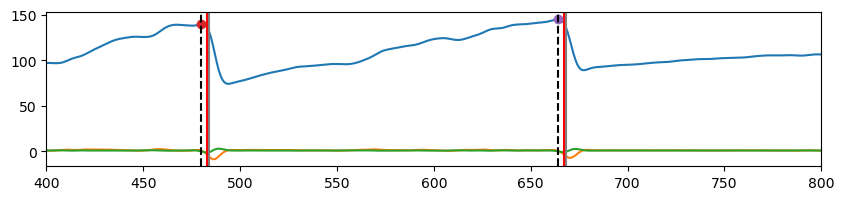

(5, 10)


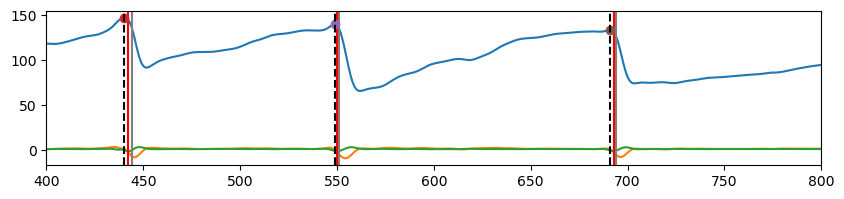

(6, 1)


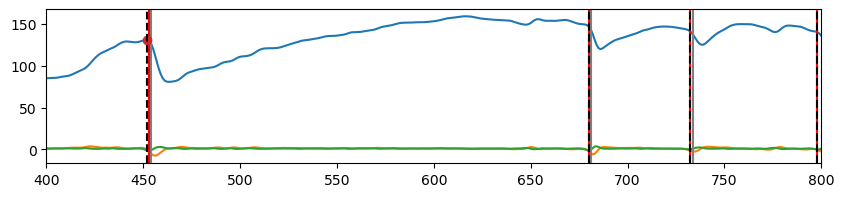

(6, 2)


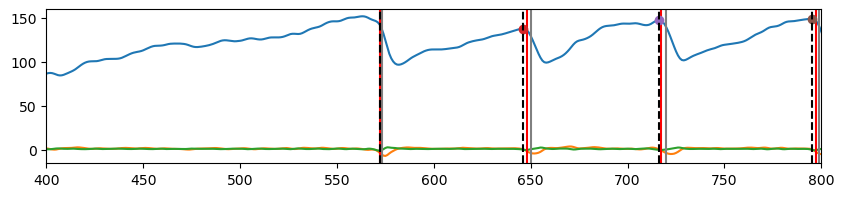

(6, 3)


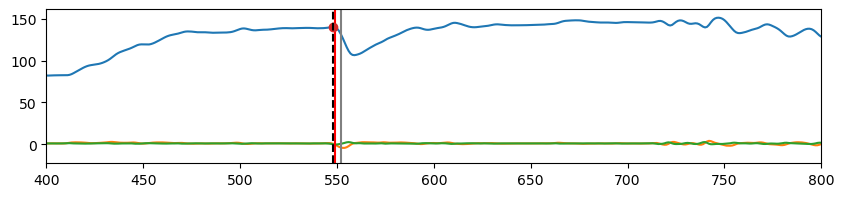

(6, 4)


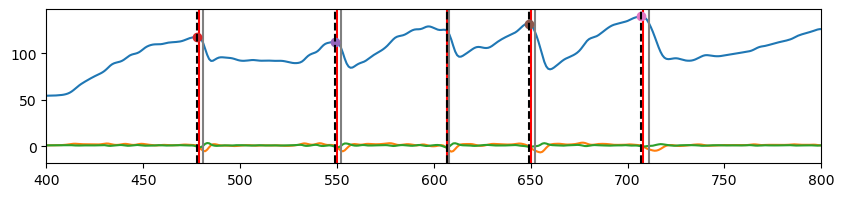

(6, 5)


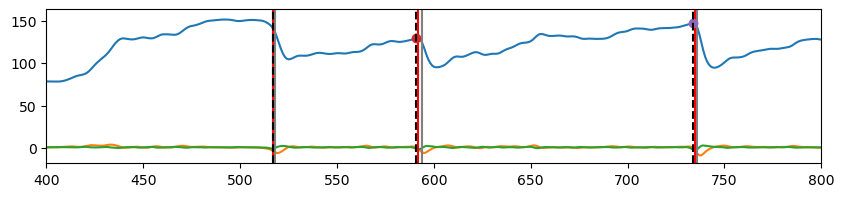

(6, 6)


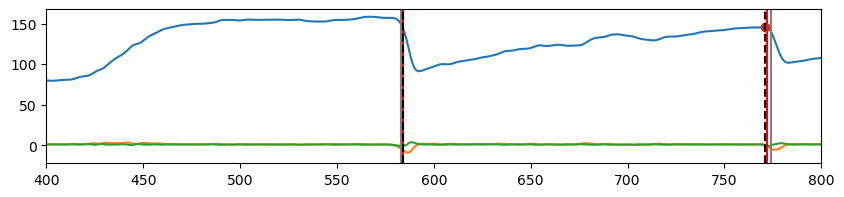

(6, 7)


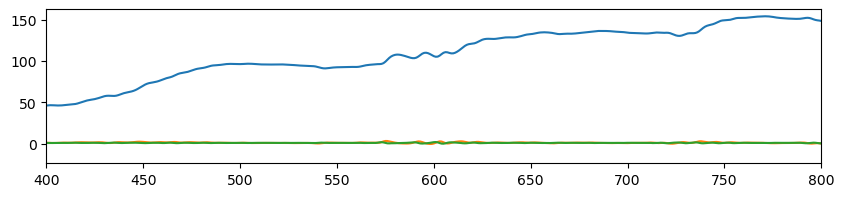

(6, 8)


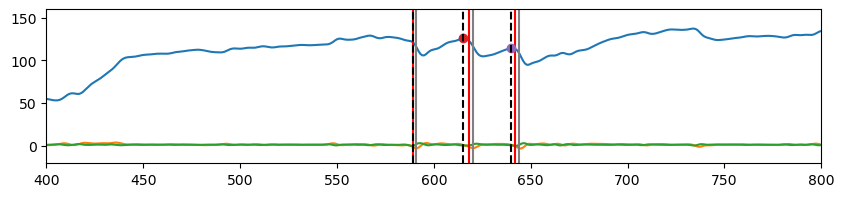

(6, 9)


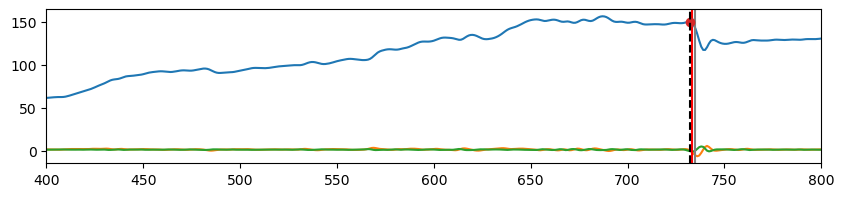

(6, 10)


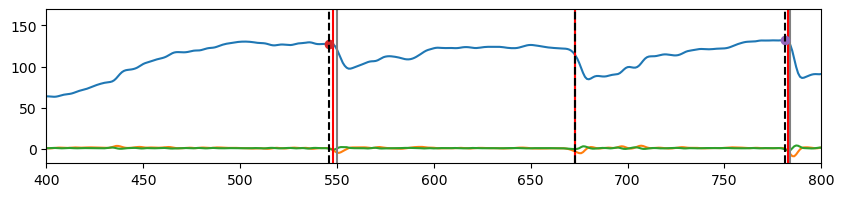

(7, 1)


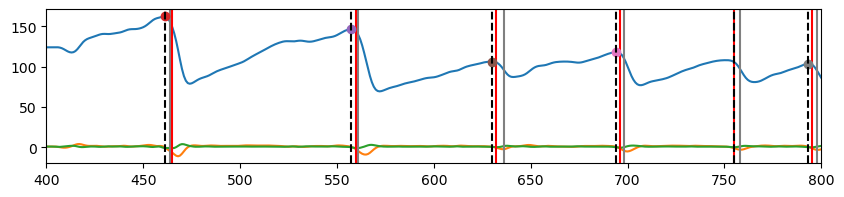

(7, 2)


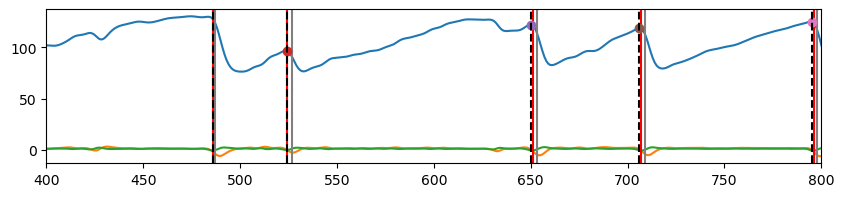

(7, 3)


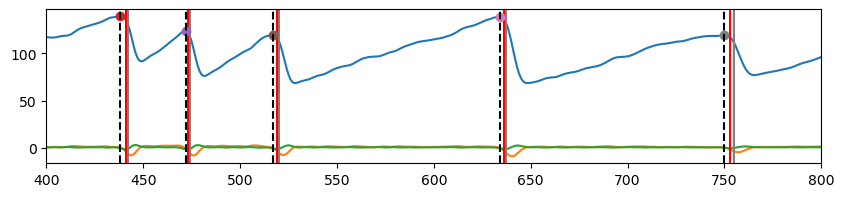

(7, 4)


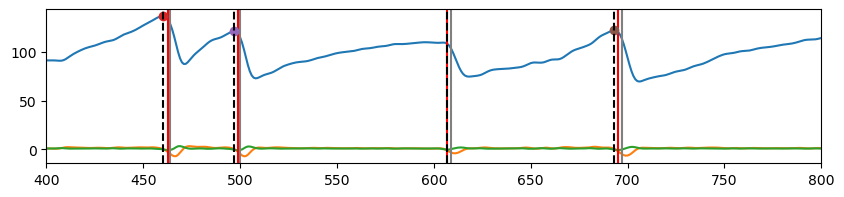

(7, 5)


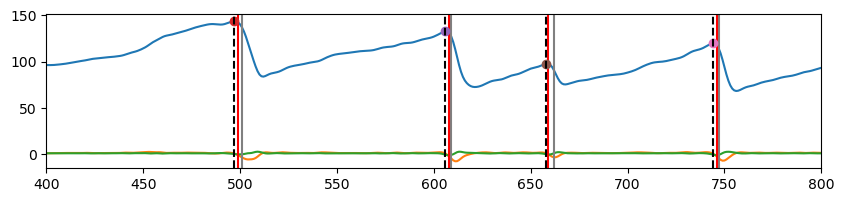

(7, 6)


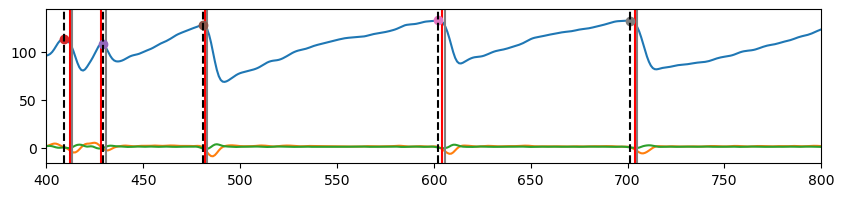

(7, 7)


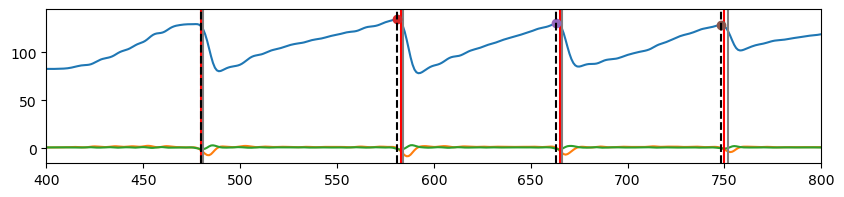

(7, 8)


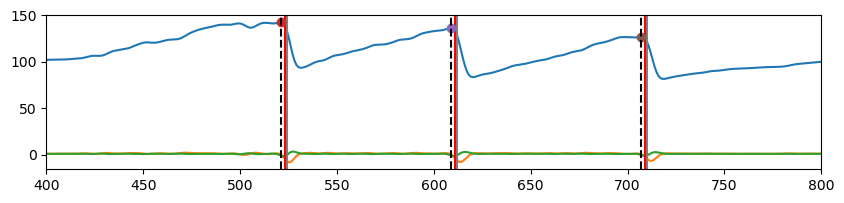

(7, 9)


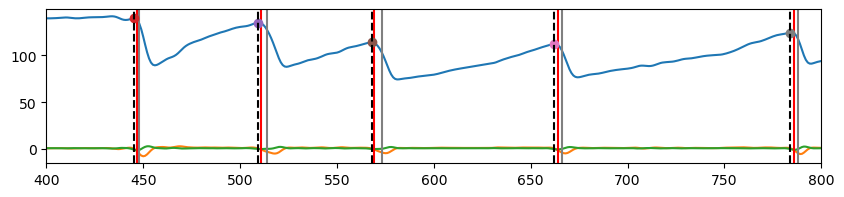

(7, 10)


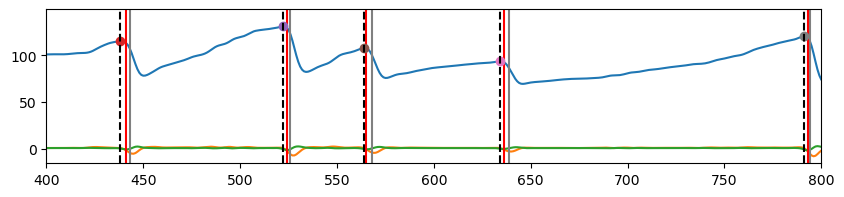

In [10]:
MDN_L1_all_swings, MDN_L1_all_ang = get_Fleg_swings_test (MDN, swing_ts_MDN_L1, 'L1C_flex')
MDN_R1_all_swings, MDN_R1_all_ang = get_Fleg_swings_test (MDN, swing_ts_MDN_R1, 'R1C_flex')

(2, 1)


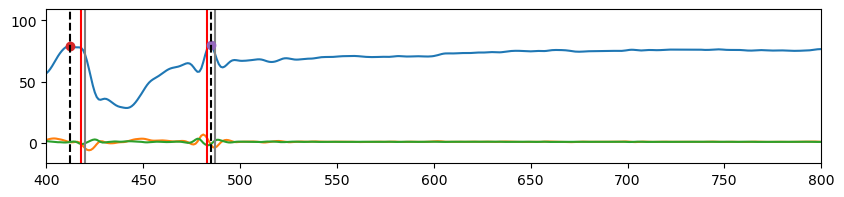

(2, 2)


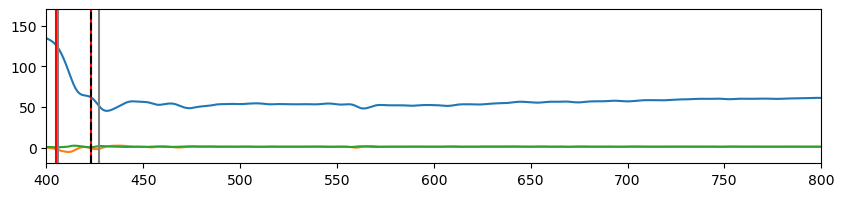

no swings in  (2, 3)
no swings in  (2, 4)
no swings in  (2, 5)
no swings in  (2, 6)
no swings in  (2, 7)
no swings in  (2, 8)
no swings in  (2, 9)
no swings in  (2, 10)
no swings in  (3, 1)
no swings in  (3, 2)
no swings in  (3, 3)
no swings in  (3, 4)
no swings in  (3, 5)
no swings in  (3, 6)
no swings in  (3, 7)
no swings in  (3, 8)
no swings in  (3, 9)
no swings in  (3, 10)
no swings in  (5, 1)
no swings in  (5, 2)
no swings in  (5, 3)
no swings in  (5, 4)
no swings in  (5, 5)
no swings in  (5, 6)
no swings in  (5, 7)
no swings in  (5, 8)
no swings in  (5, 9)
no swings in  (5, 10)
no swings in  (6, 1)
no swings in  (6, 2)
(6, 3)


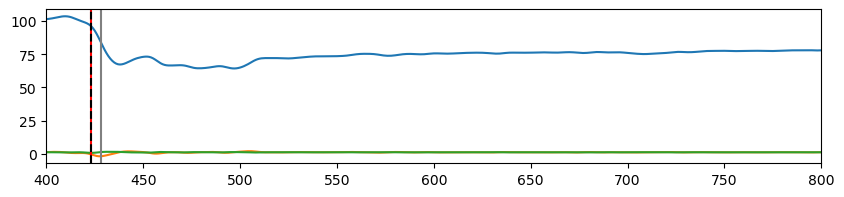

no swings in  (6, 4)
no swings in  (6, 5)
no swings in  (6, 6)
no swings in  (6, 7)
no swings in  (6, 8)
no swings in  (6, 9)
(6, 10)


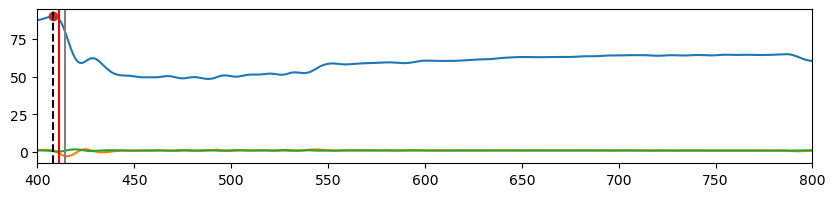

no swings in  (7, 1)
no swings in  (7, 2)
no swings in  (7, 3)
no swings in  (7, 4)
no swings in  (7, 5)
no swings in  (7, 6)
no swings in  (7, 7)
no swings in  (7, 8)
no swings in  (7, 9)
no swings in  (7, 10)
no swings in  (8, 1)
(8, 2)


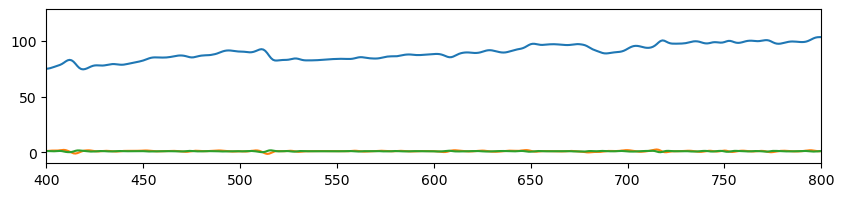

no swings in  (8, 3)
(8, 4)


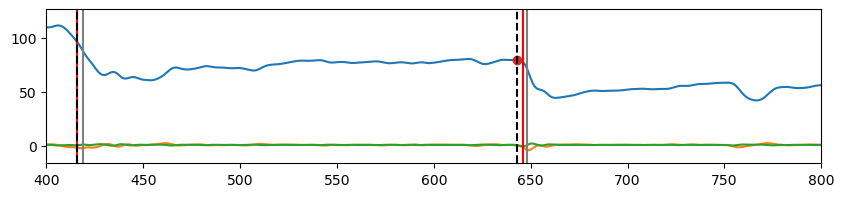

no swings in  (8, 5)
(8, 6)


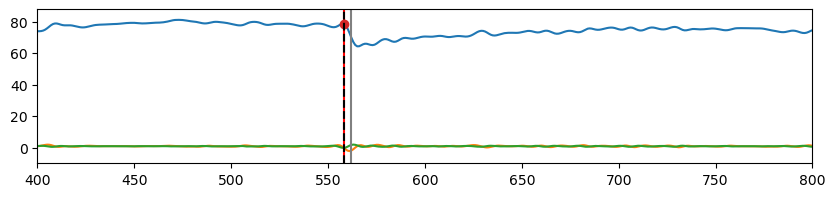

(8, 7)


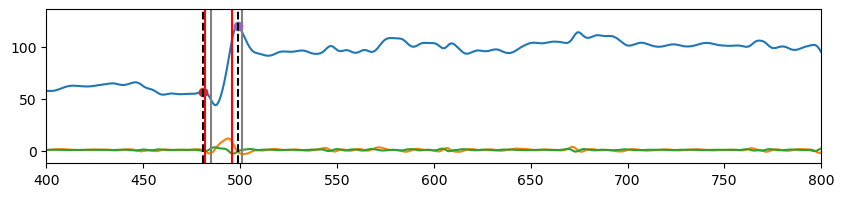

(8, 8)


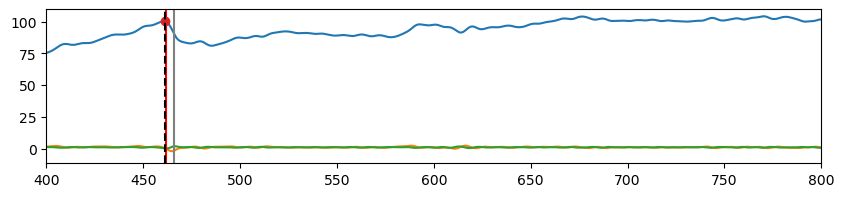

(8, 9)


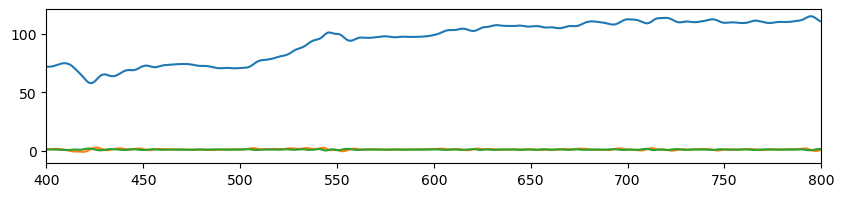

no swings in  (8, 10)
no swings in  (2, 1)
(2, 2)


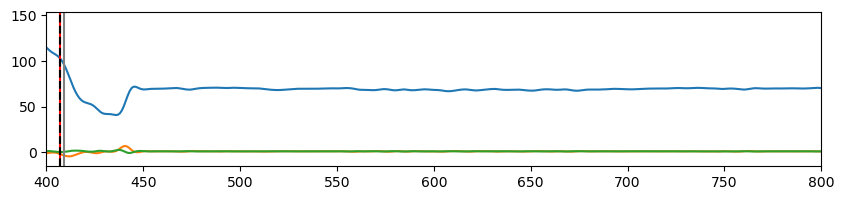

no swings in  (2, 3)
no swings in  (2, 4)
no swings in  (2, 5)
no swings in  (2, 6)
no swings in  (2, 7)
(2, 8)


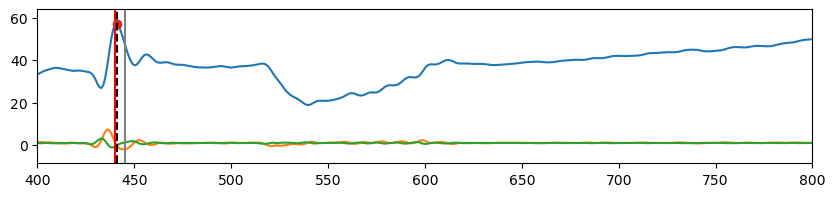

(2, 9)


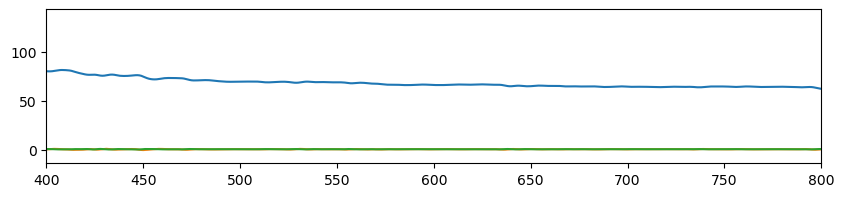

no swings in  (2, 10)
no swings in  (3, 1)
no swings in  (3, 2)
no swings in  (3, 3)
no swings in  (3, 4)
no swings in  (3, 5)
no swings in  (3, 6)
no swings in  (3, 7)
no swings in  (3, 8)
no swings in  (3, 9)
no swings in  (3, 10)
no swings in  (5, 1)
no swings in  (5, 2)
no swings in  (5, 3)
no swings in  (5, 4)
no swings in  (5, 5)
no swings in  (5, 6)
no swings in  (5, 7)
no swings in  (5, 8)
no swings in  (5, 9)
no swings in  (5, 10)
no swings in  (6, 1)
no swings in  (6, 2)
no swings in  (6, 3)
(6, 4)


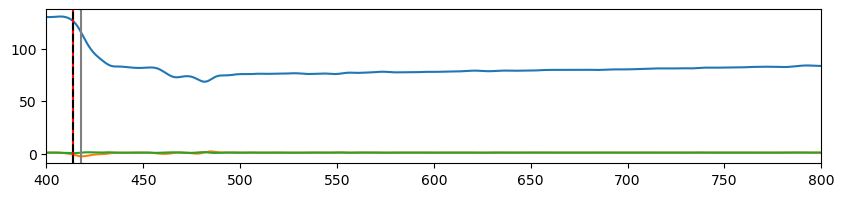

no swings in  (6, 5)
no swings in  (6, 6)
no swings in  (6, 7)
no swings in  (6, 8)
no swings in  (6, 9)
no swings in  (6, 10)
no swings in  (7, 1)
no swings in  (7, 2)
no swings in  (7, 3)
no swings in  (7, 4)
no swings in  (7, 5)
no swings in  (7, 6)
no swings in  (7, 7)
no swings in  (7, 8)
no swings in  (7, 9)
no swings in  (7, 10)
no swings in  (8, 1)
no swings in  (8, 2)
no swings in  (8, 3)
no swings in  (8, 4)
no swings in  (8, 5)
(8, 6)


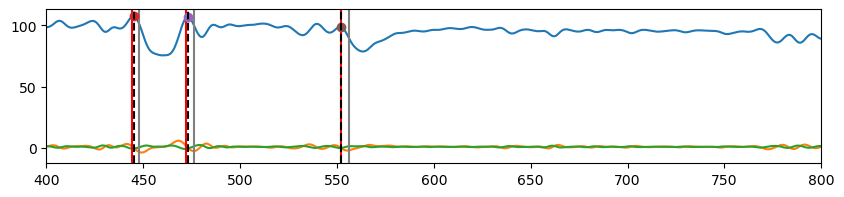

(8, 7)


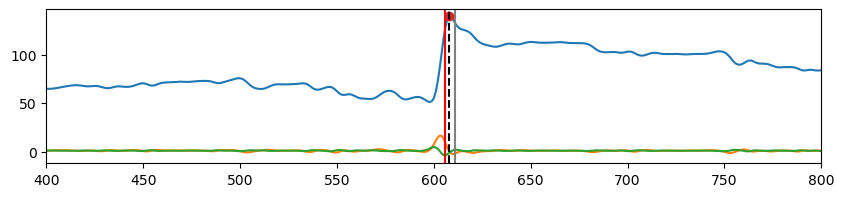

no swings in  (8, 8)
no swings in  (8, 9)
no swings in  (8, 10)


In [ ]:
MDN_Stop1_L1_all_swings, MDN_Stop1_L1_all_ang = get_Fleg_swings_test (MDN_Stop1, swing_ts_MDN_Stop1_L1, 'L1C_flex')
MDN_Stop1_R1_all_swings, MDN_Stop1_R1_all_ang = get_Fleg_swings_test (MDN_Stop1, swing_ts_MDN_Stop1_R1, 'R1C_flex')

<AxesSubplot:>

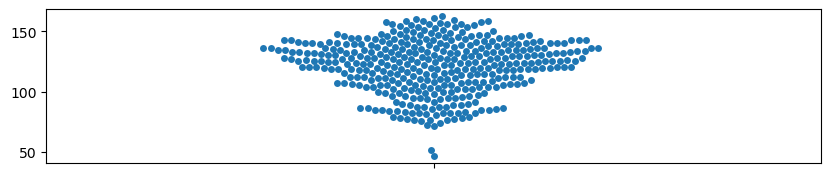

In [ ]:
sns.swarmplot(MDN_L1_all_ang + MDN_R1_all_ang)

In [ ]:
np.percentile(np.array(MDN_L1_all_ang + MDN_R1_all_ang), [5,10, 25])

array([ 82.10659988,  87.61860743, 107.43599052])

<AxesSubplot:>

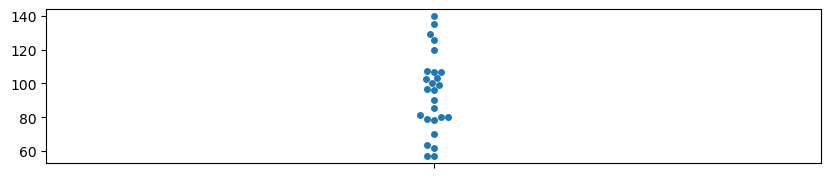

In [ ]:
sns.swarmplot(MDN_Stop1_L1_all_ang + MDN_Stop1_R1_all_ang)

In [ ]:
len(MDN_L1_all_ang + MDN_R1_all_ang)

385

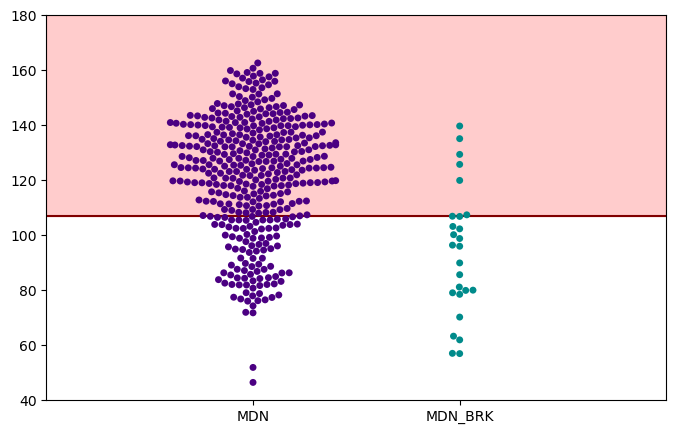

In [ ]:
plt.rcParams['figure.figsize'] = (8,5)
swing_init_ang = pd.concat([pd.DataFrame([(MDN_L1_all_ang + MDN_R1_all_ang)]).T , pd.DataFrame([(MDN_Stop1_L1_all_ang + MDN_Stop1_R1_all_ang)]).T], axis = 1)
swing_init_ang.columns = ['MDN', 'MDN_BRK']
sns.swarmplot(swing_init_ang, palette=  ['indigo', 'darkcyan'])
plt.axhline (y = 107, color = 'maroon')
plt.xlim(-1,  2)
plt.ylim(40, 180)
plt.fill_between( [-1,  2], y1 = 107, y2 = 180, color = 'r',alpha = 0.2)
# plt.savefig(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Front\swing_init_ang.svg', dpi = 300)

# swing_init_ang.to_csv(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Front\swing_init_ang.csv', index = False)

In [ ]:
# def get_val_at_swing(df, sc_df, angle):
#     val = []
#     for n in df['flynum'].unique().tolist():
#         for t in df.groupby('flynum').get_group(n)['tnum'].unique().tolist():
#             data = df.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)

#             ang = data[angle]
#             try:   ## not all trials have swing events; sc_df may not have all (n,t) combinations
#                 sc = sc_df.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)
#             except:
#                          continue
#             swing_init_ts = sc['swing_ts'].tolist()
            
#             for i in swing_init_ts:
#                 temp_val = ang[i]
#                 val.append(temp_val)
#     return val

In [ ]:
# ang_name = 'C_flex'
# MDN_L1_flex= get_val_at_swing(MDN, swing_ts_MDN_L1,  'L1'+ang_name)
# MDN_R1_flex= get_val_at_swing(MDN, swing_ts_MDN_R1,  'R1'+ang_name)

# pooled_MDN_F = pd.concat([pd.DataFrame(MDN_L1_flex),pd.DataFrame(MDN_R1_flex)], axis = 0)
# np.percentile(pooled_MDN_F, q = [10,25,50,75,90])

In [ ]:
# ang_name = 'C_flex'
# MDN_Stop1_L1_flex= get_val_at_swing(MDN_Stop1, swing_ts_MDN_Stop1_L1,  'L1'+ang_name)
# MDN_Stop1_R1_flex= get_val_at_swing(MDN_Stop1, swing_ts_MDN_Stop1_R1,  'R1'+ang_name)

# pooled_MDN_Stop1_F = pd.concat([pd.DataFrame(MDN_Stop1_L1_flex),pd.DataFrame(MDN_Stop1_R1_flex)], axis = 0)
# np.percentile(pooled_MDN_Stop1_F, q = [10,25,50,75,90])

In [ ]:
# plt.rcParams['figure.figsize'] = (10,5)

In [ ]:
# sns.swarmplot(reset_count_Flegs, size = 2)

# plt.title('Reset Count (proxy for step count)')
# plt.show()

In [ ]:
# sns.swarmplot(reset_ang_MDN_L1)
# sns.swarmplot(reset_ang_MDN_R1)
# plt.legend (['L1 - MDN', 'R1- MDN'])

In [ ]:
# sns.swarmplot(reset_ang_MDN_Stop1_L1)
# sns.swarmplot(reset_ang_MDN_Stop1_R1)
# # print('L1 range:',np.mean(reset_ang_L1_MDN_Stop1) - np.std(reset_ang_L1_MDN_Stop1) , np.mean(reset_ang_L1_MDN_Stop1)+np.std(reset_ang_L1_MDN_Stop1))
# # print('R1 range:',np.mean(reset_ang_R1_MDN_Stop1) - np.std(reset_ang_R1_MDN_Stop1) , np.mean(reset_ang_R1_MDN_Stop1)+np.std(reset_ang_R1_MDN_Stop1))
# plt.legend (['L1 - MDN_Stop1', 'R1- MDN_Stop1'])

In [ ]:
def get_stepping_params_Fleg (df,leg , angle, leg_swing_ts, filter_boundary_event = True):
    
    range_lim = 107 #C_flex (10th percentile; GREATER than; because leg is extended during swing)

    if leg == 'L1':
        sc = 'L-F_stepcycle'
    if leg == 'R1':
        sc = 'R-F_stepcycle'
    
    count_SIZ_reached = [] # per trial
    swing_events_within_SIZ = [] # per trial
    percentage_swings_per_trial = []  # per trial
    dwell_time = [] # per SIZ event

    for n in df['flynum'].unique().tolist():
        for t in df.groupby('flynum').get_group(n)['tnum'].unique().tolist():

            # plt.rcParams['figure.figsize'] = (10,2)
            swing_events_temp = []
            
            data = df.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)
            ang = data[angle]


            

            ang = pd.DataFrame(scipy.ndimage.gaussian_filter(ang, sigma= 10))
            ang.columns = [angle]
            slope = np.gradient(ang[angle]).tolist()
            # diff2 = np.diff(diff).tolist()
            # diff2 = [x+1 for x in diff2]
            # plt.plot(ang)

           

            try:
                sc_df_temp = leg_swing_ts.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)
                swing_ts = sc_df_temp['swing_ts_new'].tolist()
            except:
                ## no swings in the trial
                swing_ts = []

            temp_ang = pd.DataFrame(ang[430:1000])
            list_in_range = temp_ang.loc[(temp_ang[angle] >range_lim)].index.tolist() #time index when leg is in SIZ

            if len(list_in_range) > 0: 
                ## if the leg ever enters the SIZ
                break_pt = np.split(list_in_range, np.where(np.diff(list_in_range)>10)[0]+1) #breaking time indices into events---> number of times when the ang is reached
                # print(break_pt)



                plt.axhline(y =range_lim, color = 'grey' )
            
                #-------------  FILTERS  -------------#

                if filter_boundary_event:
                    print('Filtering last event:',break_pt[-1][-1], len(break_pt[-1])  )
                    if (break_pt[-1][-1] == 999 and len(break_pt[-1])<20):
                        print('removing last event of length', len(break_pt[-1]))
                        break_pt = break_pt[:-1]
                    else:
                        print('valid end point')
                
                if len(break_pt)>0:

                    if slope[break_pt[0][0]]<0 and break_pt[0][0]<450 and len(break_pt[0]) < 50:
                        print('remoning first event initiated during contraction', len(break_pt[0]))
                        break_pt = break_pt[1:]
                    else:
                        print('valid beginning')
                # -----------------------------------#

                if len(break_pt)>0:
                    plt.rcParams['figure.figsize'] = (10,2)
                    print(n,t)
                    plt.plot(ang)

                    range_count_temp = len(break_pt) # number of times the SIZ was achieved in trial
                    count_SIZ_reached.append(range_count_temp)
                    # print((n,t,range_count_temp))

                    # temp_dwell_time = []
                    for event in break_pt: # for each time the leg enters SIZ
                        

                        plt.axvline(x = event[0], color = 'g')
                        plt.axvline(x = event[-1], color = 'r')

                        dwell_time.append(len(event)) 
                        swing_count = 0
                        
                        for swing in swing_ts:
                            if swing_count == 0:
                                if swing in event or swing in [x+10 for x in event]:

                                    # if there was a swing in this stretch of time
                                    swing_events_temp.append('True')
                                    plt.axvline(x = swing, color = 'k', ls = '--')
                                    swing_count+=1

                    swing_events_within_SIZ.append(len(swing_events_temp))
                    dwell_time.append(np.mean(dwell_time))
                    
                    percentage_swings_per_trial.append((len(swing_events_temp)/range_count_temp)*100)
                    # print(n,t,((len(swing_events_temp), range_count_temp, (len(swing_events_temp)/range_count_temp)*100)))
    
                    plt.show()
                else:
                    continue
            else:
                count_SIZ_reached.append(len(list_in_range)) # appends zero
                # plt.show()

    return count_SIZ_reached, swing_events_within_SIZ, percentage_swings_per_trial, dwell_time

Filtering last event: 782 39
valid end point
valid beginning
1 1


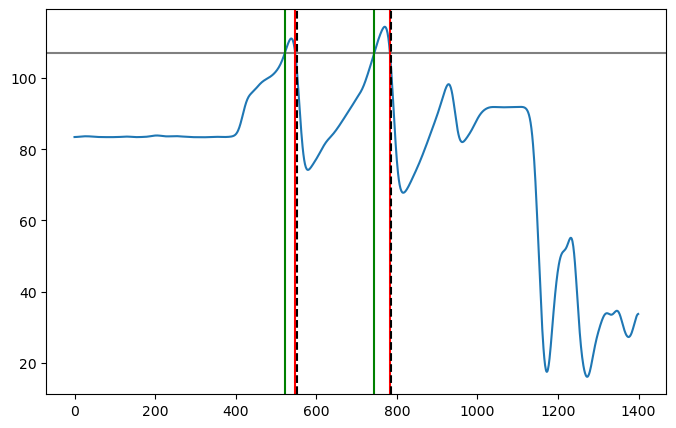

Filtering last event: 999 96
valid end point
valid beginning
1 2


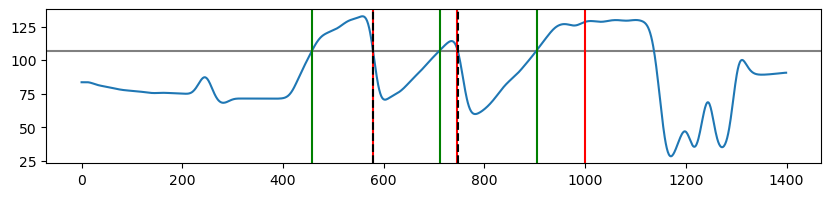

Filtering last event: 999 88
valid end point
valid beginning
1 3


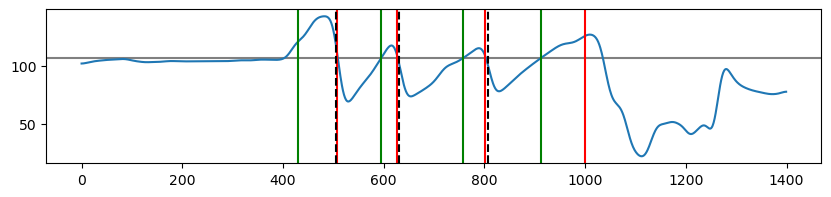

Filtering last event: 999 131
valid end point
valid beginning
1 4


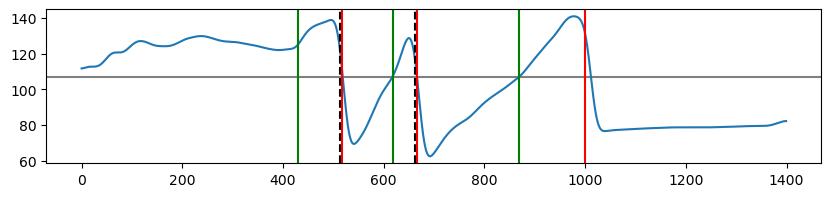

Filtering last event: 999 138
valid end point
valid beginning
1 5


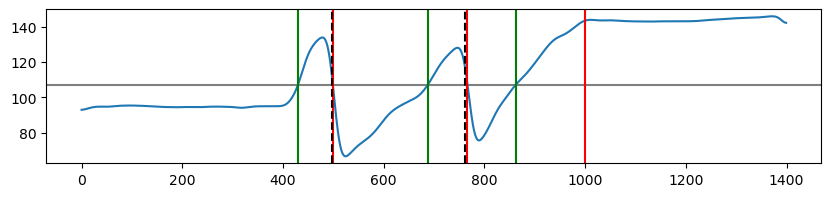

Filtering last event: 999 15
removing last event of length 15
valid beginning
1 6


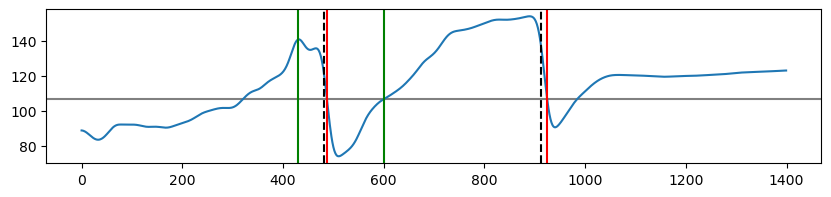

Filtering last event: 999 135
valid end point
valid beginning
1 7


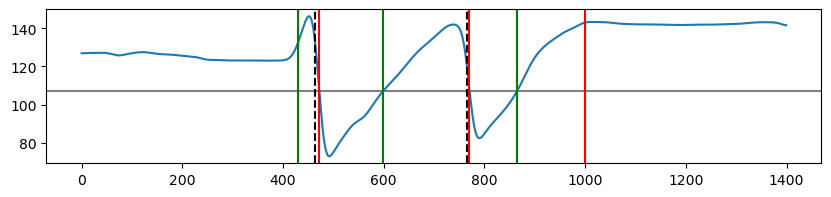

Filtering last event: 999 45
valid end point
valid beginning
1 8


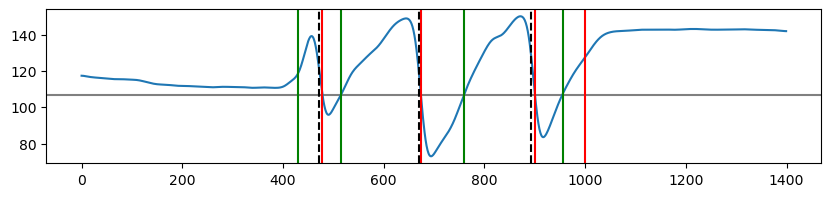

Filtering last event: 999 45
valid end point
valid beginning
1 9


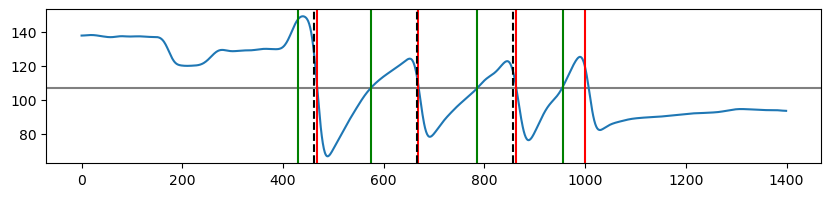

Filtering last event: 999 67
valid end point
valid beginning
1 10


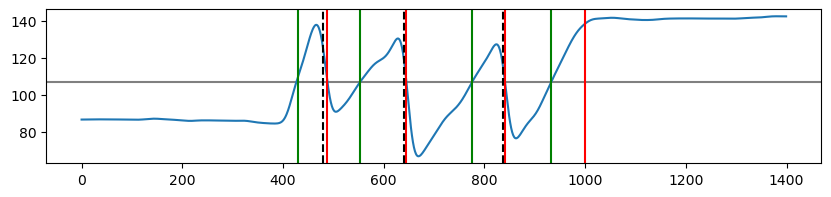

Filtering last event: 999 334
valid end point
valid beginning
2 1


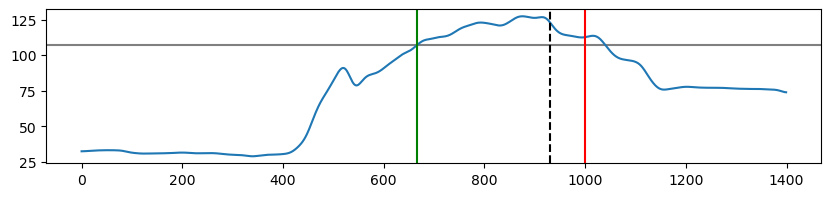

Filtering last event: 657 46
valid end point
valid beginning
2 2


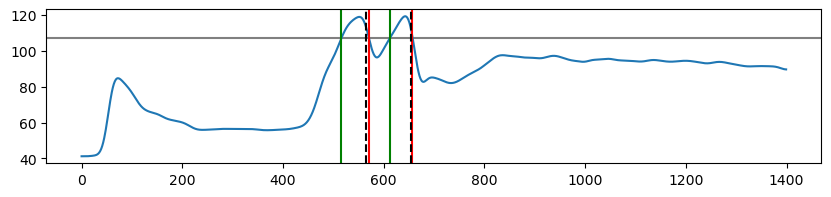

Filtering last event: 708 58
valid end point
valid beginning
2 3


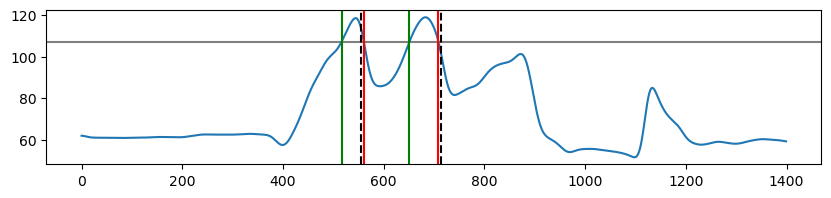

Filtering last event: 979 120
valid end point
valid beginning
2 4


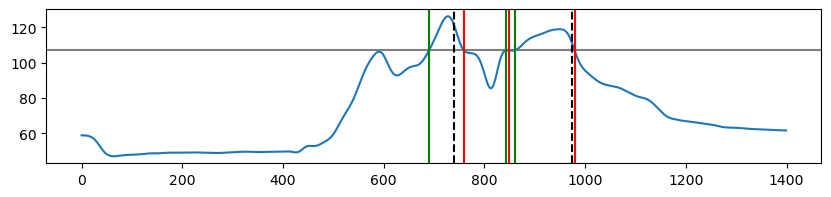

Filtering last event: 715 22
valid end point
valid beginning
2 6


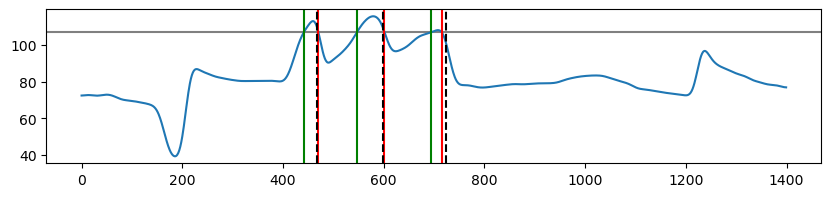

Filtering last event: 507 21
valid end point
valid beginning
2 7


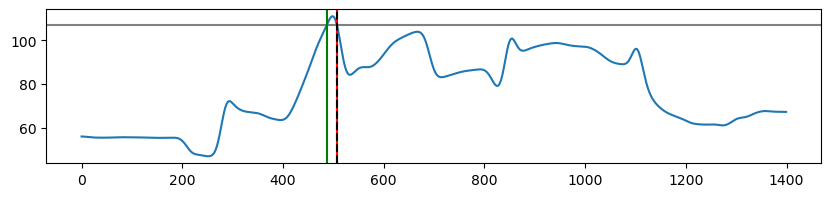

Filtering last event: 999 119
valid end point
valid beginning
2 8


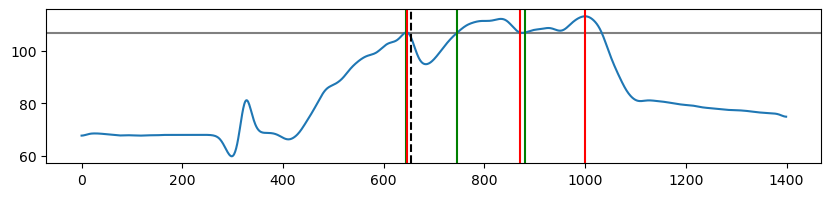

Filtering last event: 615 55
valid end point
valid beginning
2 9


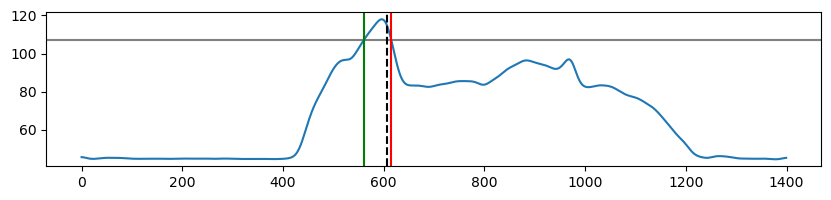

Filtering last event: 554 27
valid end point
valid beginning
2 10


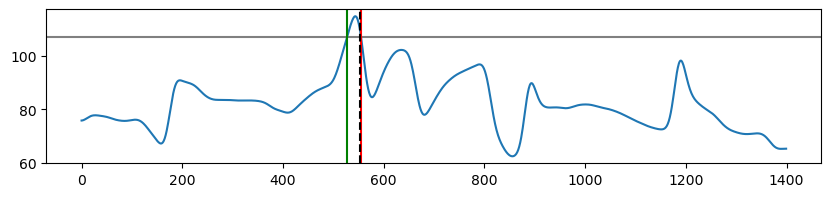

Filtering last event: 999 34
valid end point
valid beginning
3 1


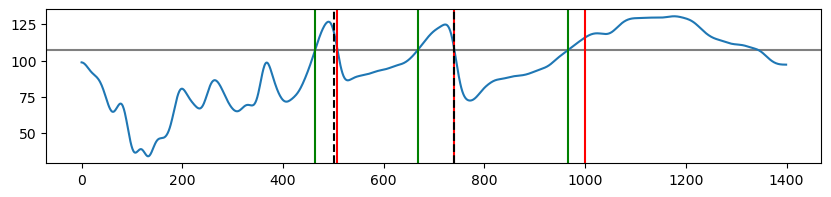

Filtering last event: 880 162
valid end point
valid beginning
3 2


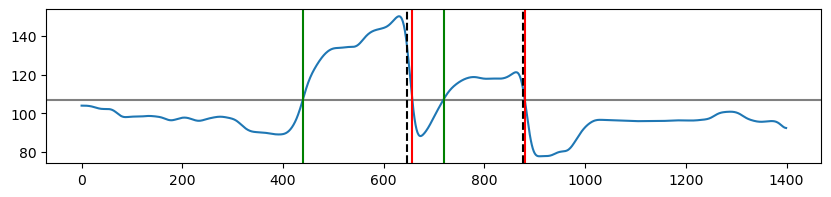

Filtering last event: 741 277
valid end point
valid beginning
3 3


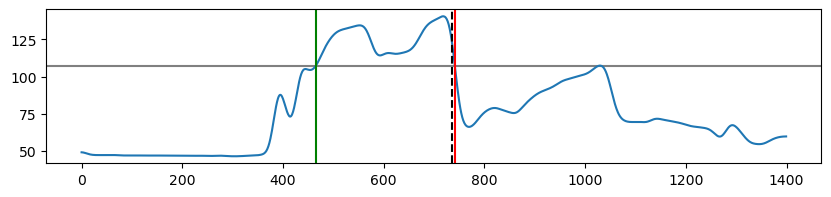

Filtering last event: 649 38
valid end point
valid beginning
3 4


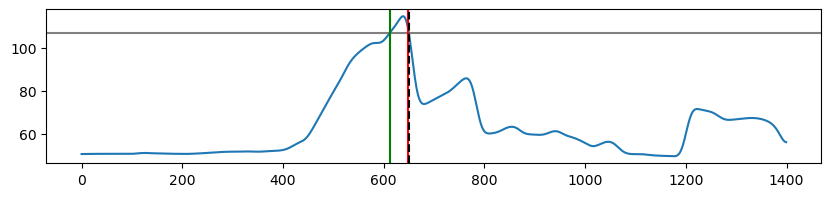

Filtering last event: 621 161
valid end point
valid beginning
3 6


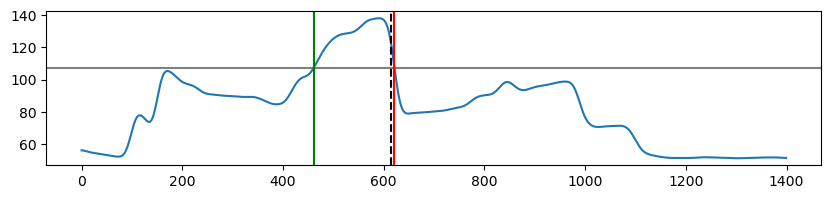

Filtering last event: 999 171
valid end point
valid beginning
3 9


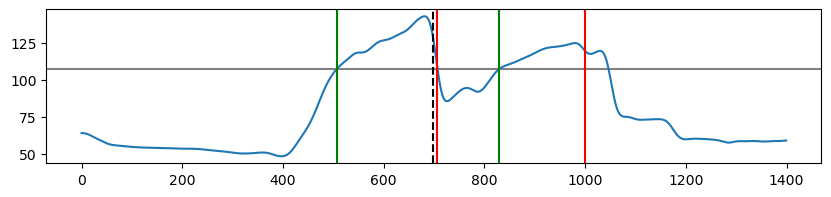

Filtering last event: 542 95
valid end point
valid beginning
3 10


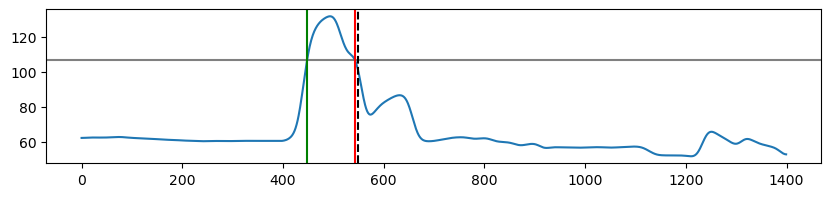

Filtering last event: 999 499
valid end point
valid beginning
4 1


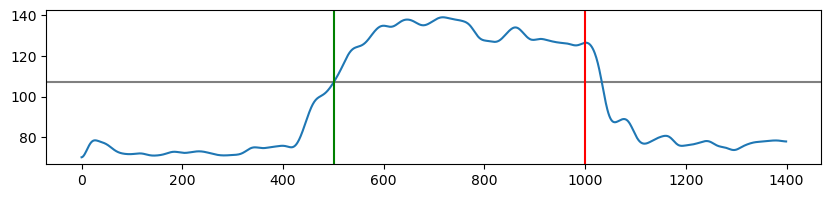

Filtering last event: 999 516
valid end point
valid beginning
4 2


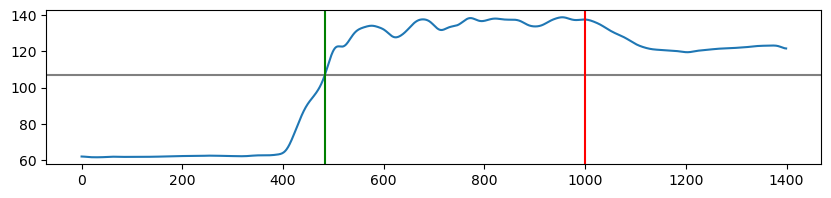

Filtering last event: 999 475
valid end point
valid beginning
4 3


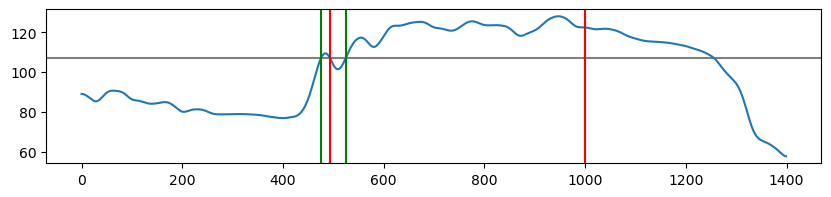

Filtering last event: 999 461
valid end point
valid beginning
4 4


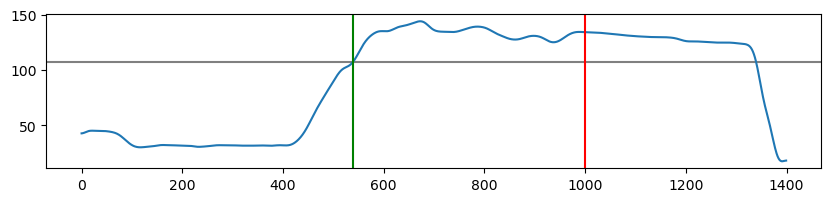

Filtering last event: 999 509
valid end point
valid beginning
4 5


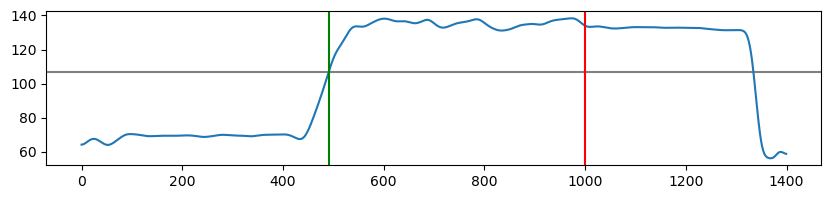

Filtering last event: 999 549
valid end point
valid beginning
4 6


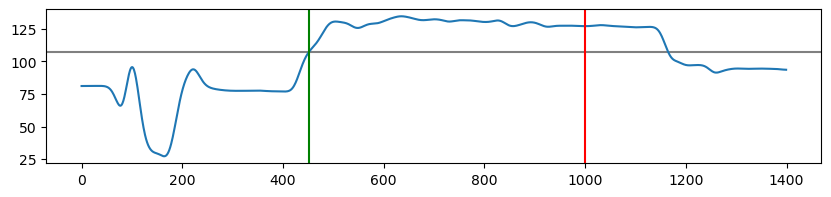

Filtering last event: 999 453
valid end point
valid beginning
4 7


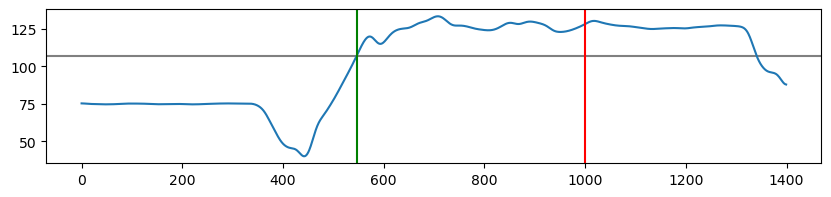

Filtering last event: 999 559
valid end point
valid beginning
4 8


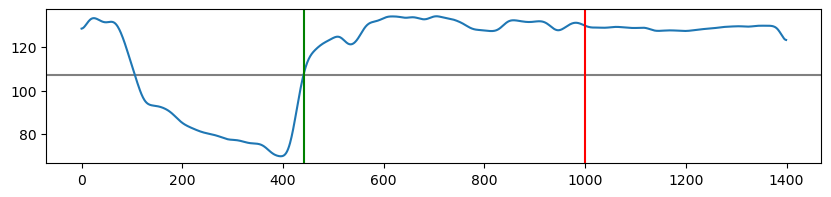

Filtering last event: 999 477
valid end point
valid beginning
4 9


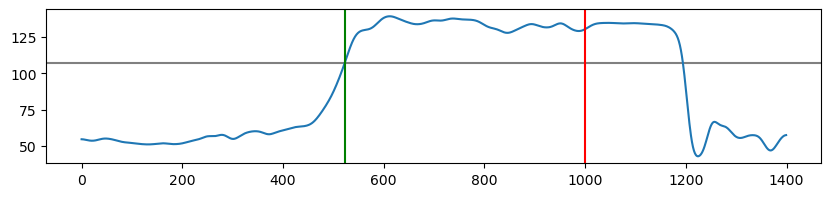

Filtering last event: 999 476
valid end point
valid beginning
4 10


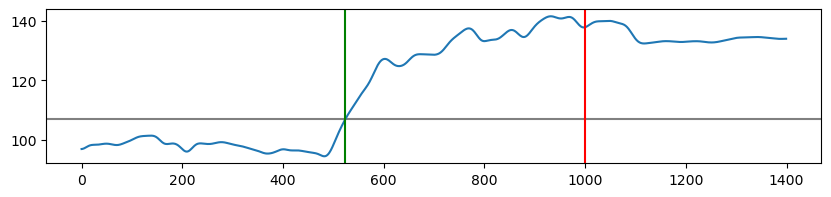

Filtering last event: 999 99
valid end point
valid beginning
5 1


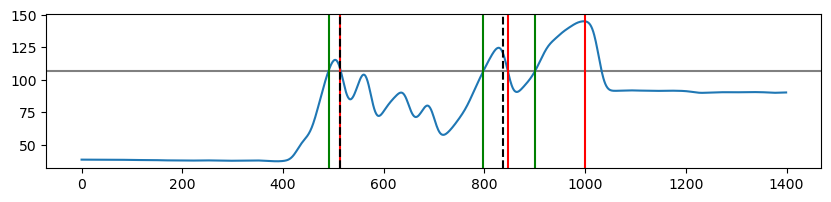

Filtering last event: 893 42
valid end point
valid beginning
5 2


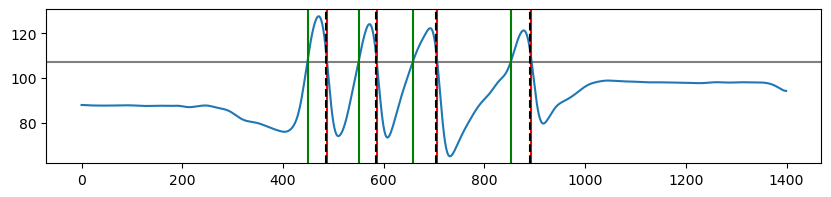

Filtering last event: 999 192
valid end point
valid beginning
5 3


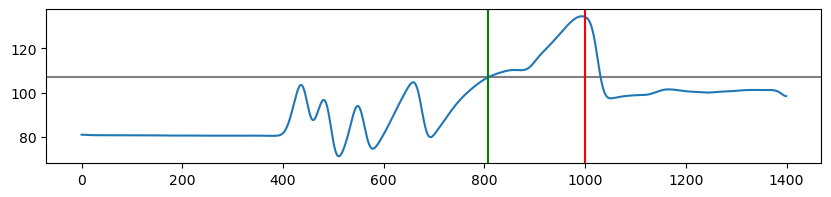

Filtering last event: 999 114
valid end point
valid beginning
5 4


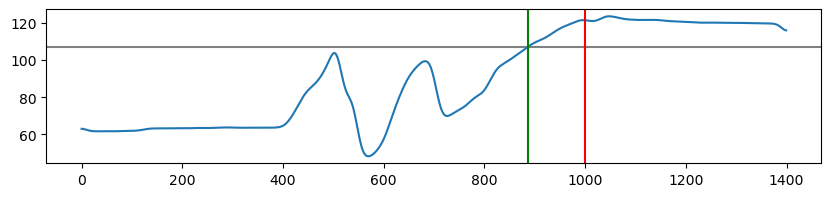

Filtering last event: 999 45
valid end point
valid beginning
5 5


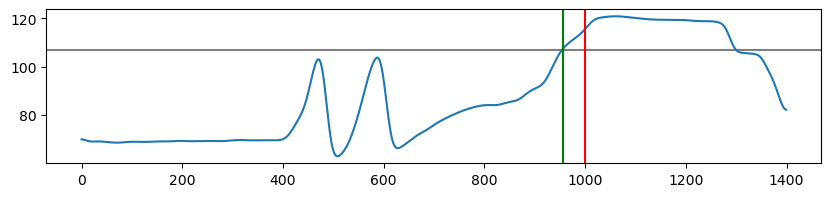

Filtering last event: 804 35
valid end point
valid beginning
5 6


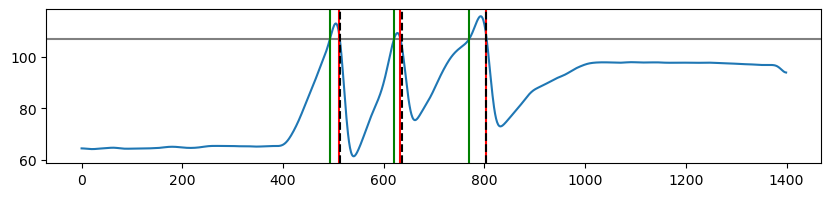

Filtering last event: 999 108
valid end point
valid beginning
5 7


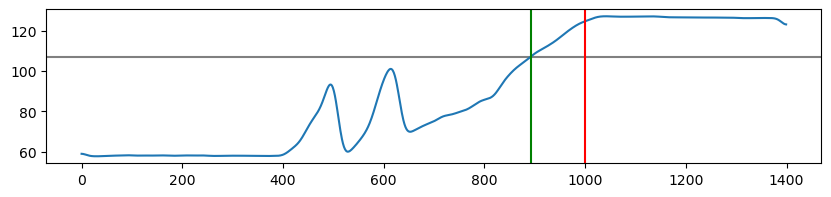

Filtering last event: 826 48
valid end point
valid beginning
5 8


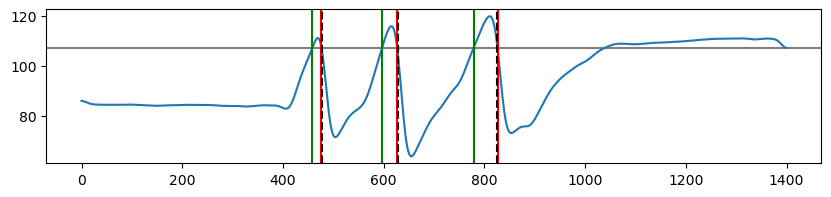

Filtering last event: 999 295
valid end point
valid beginning
5 9


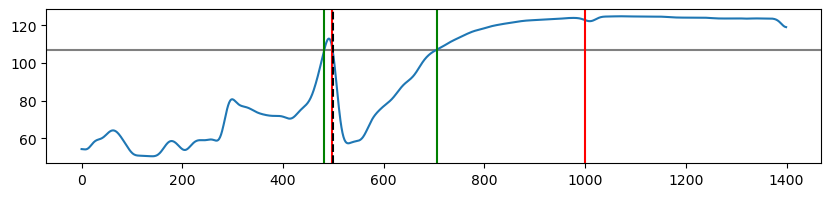

Filtering last event: 999 139
valid end point
valid beginning
5 10


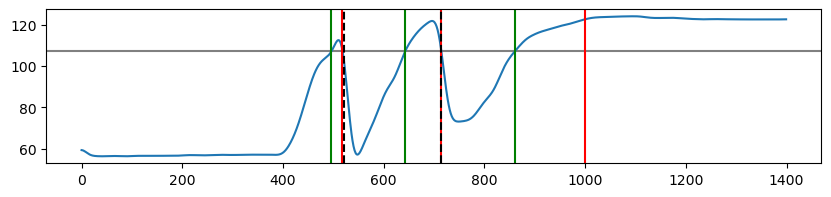

Filtering last event: 999 570
valid end point
valid beginning
6 1


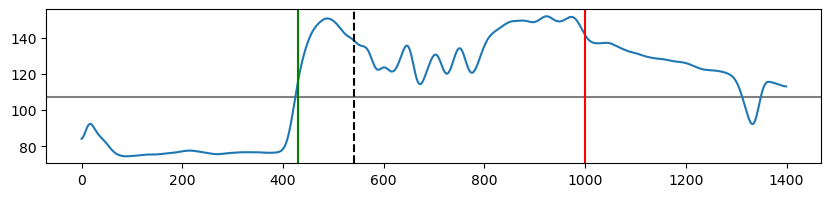

Filtering last event: 999 563
valid end point
valid beginning
6 2


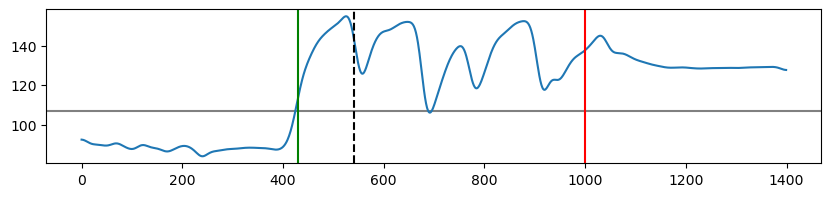

Filtering last event: 999 565
valid end point
valid beginning
6 3


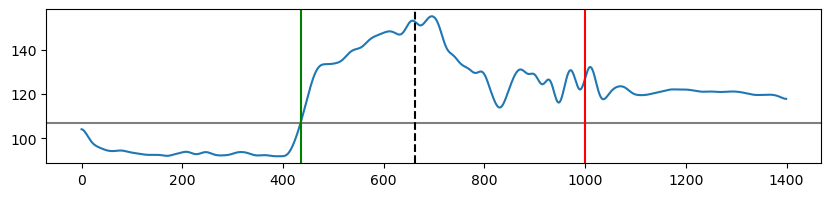

Filtering last event: 999 434
valid end point
valid beginning
6 4


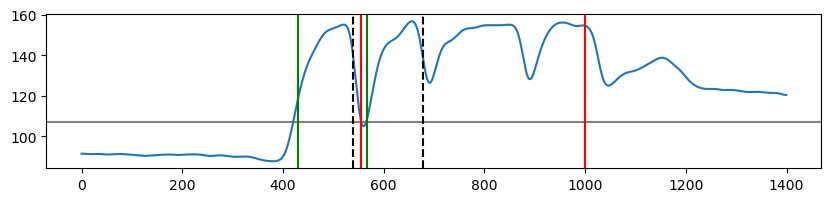

Filtering last event: 999 569
valid end point
valid beginning
6 5


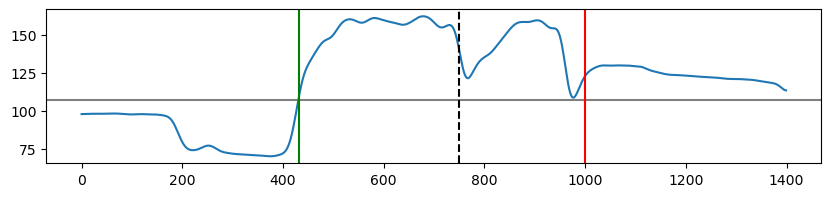

Filtering last event: 999 515
valid end point
valid beginning
6 6


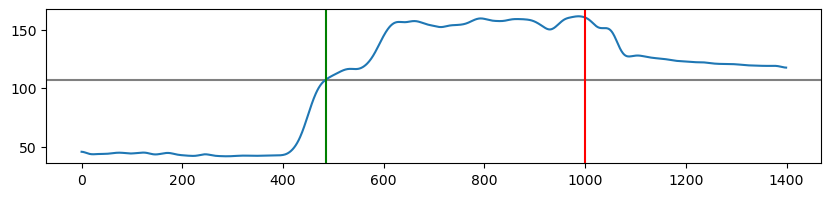

Filtering last event: 999 554
valid end point
valid beginning
6 7


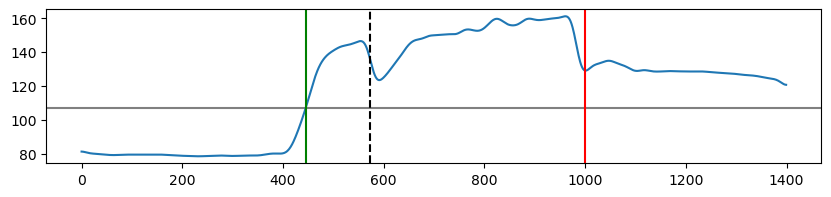

Filtering last event: 999 562
valid end point
valid beginning
6 8


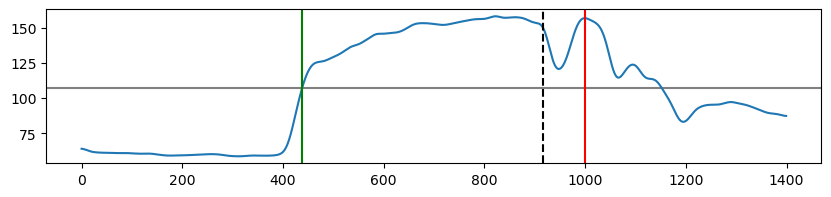

Filtering last event: 999 496
valid end point
valid beginning
6 9


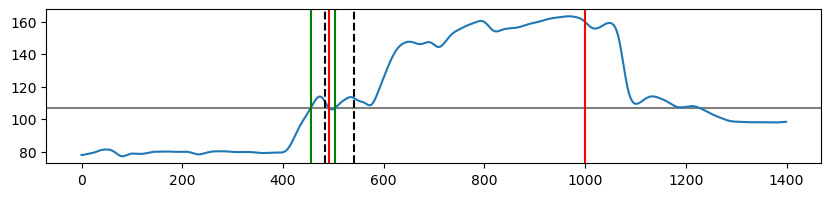

Filtering last event: 972 20
valid end point
valid beginning
6 10


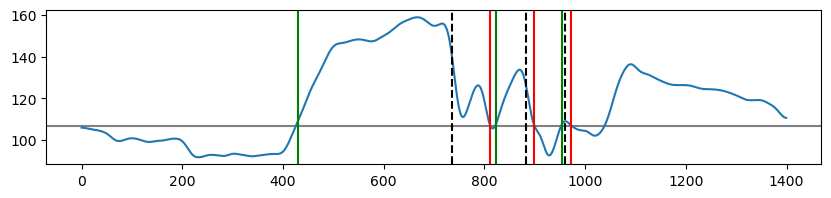

Filtering last event: 999 9
removing last event of length 9
valid beginning
7 2


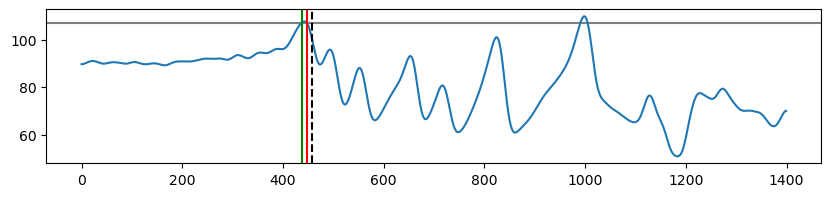

Filtering last event: 550 29
valid end point
valid beginning
7 3


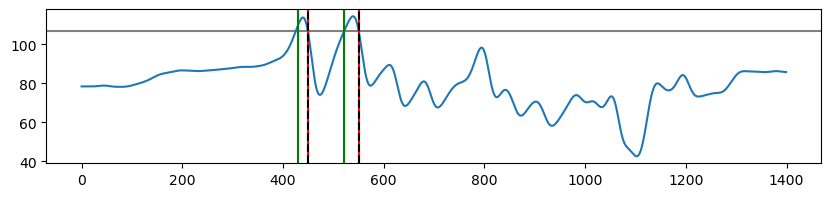

Filtering last event: 462 9
valid end point
valid beginning
7 4


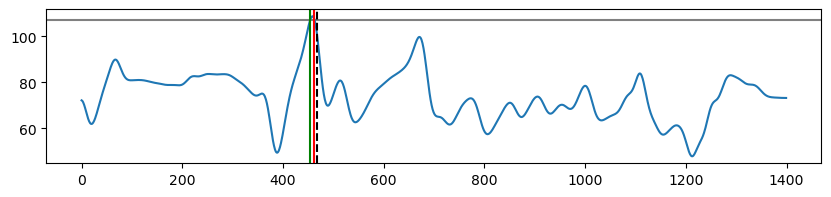

Filtering last event: 479 41
valid end point
valid beginning
1 3


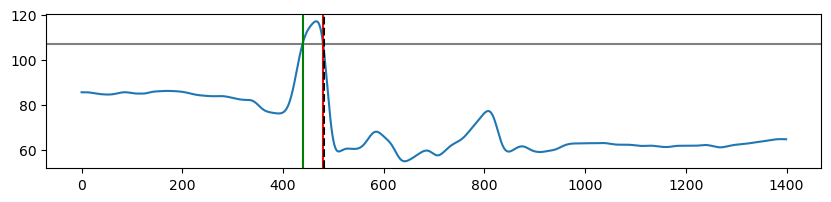

Filtering last event: 473 42
valid end point
valid beginning
1 6


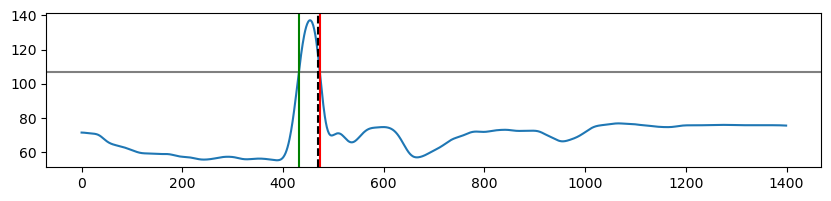

Filtering last event: 999 420
valid end point
valid beginning
2 1


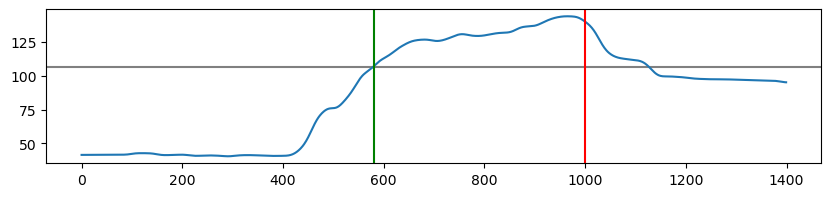

Filtering last event: 999 350
valid end point
valid beginning
2 2


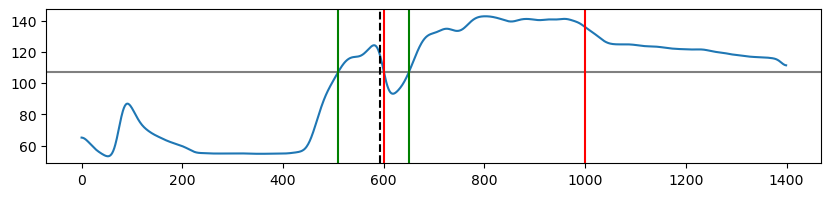

Filtering last event: 999 253
valid end point
valid beginning
2 3


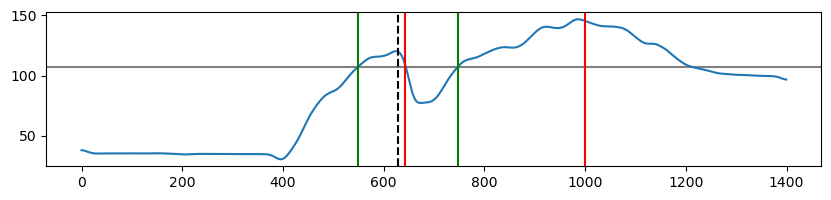

Filtering last event: 999 435
valid end point
valid beginning
2 4


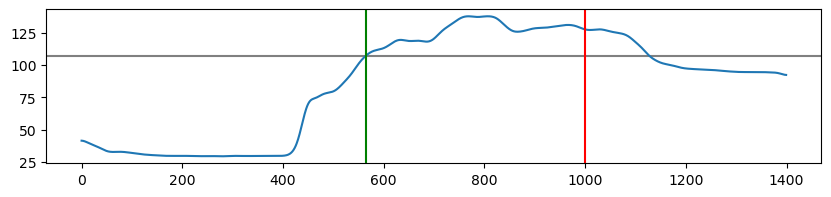

Filtering last event: 999 431
valid end point
valid beginning
2 5


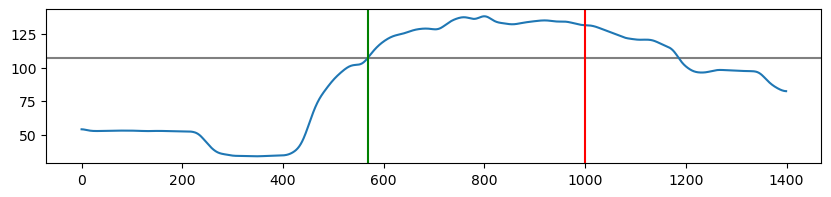

Filtering last event: 999 487
valid end point
valid beginning
2 6


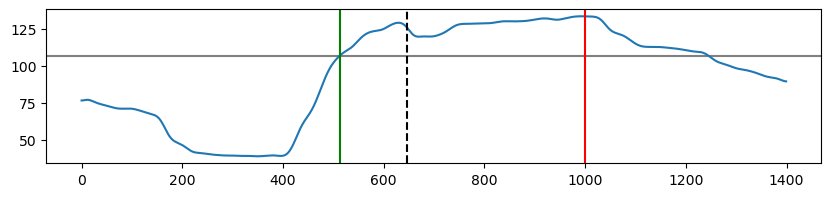

Filtering last event: 999 448
valid end point
valid beginning
2 7


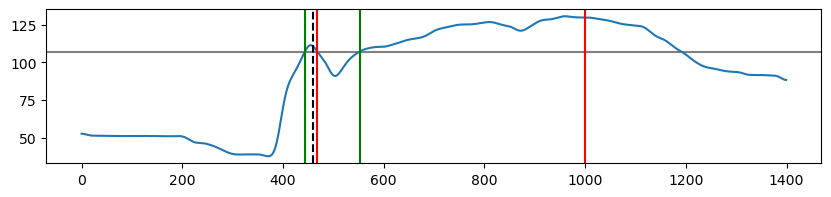

Filtering last event: 999 233
valid end point
valid beginning
2 8


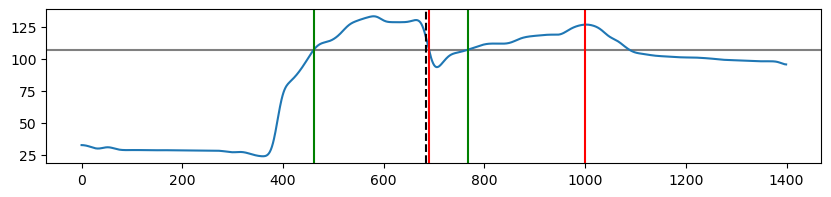

Filtering last event: 999 389
valid end point
valid beginning
2 9


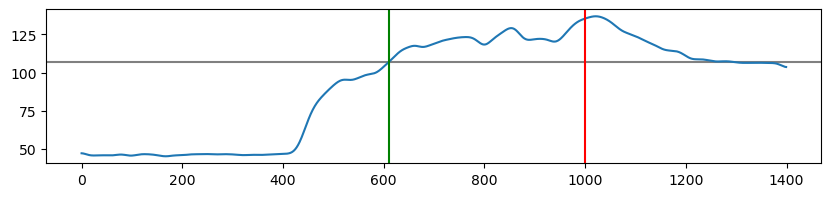

Filtering last event: 999 105
valid end point
valid beginning
2 10


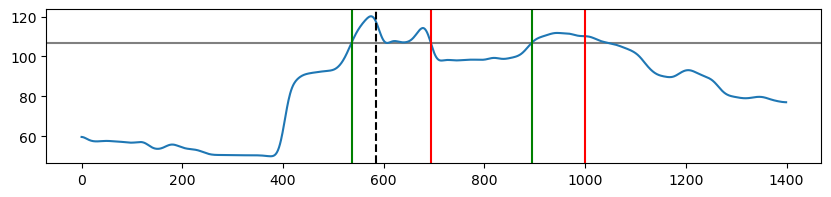

Filtering last event: 839 354
valid end point
valid beginning
3 1


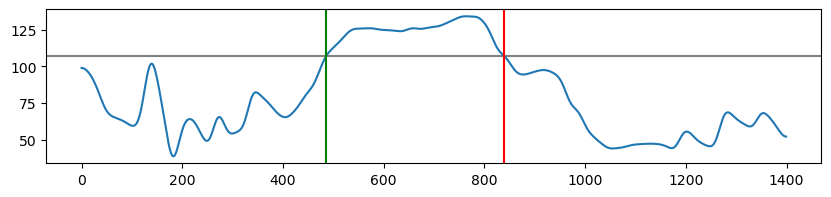

Filtering last event: 637 173
valid end point
valid beginning
3 2


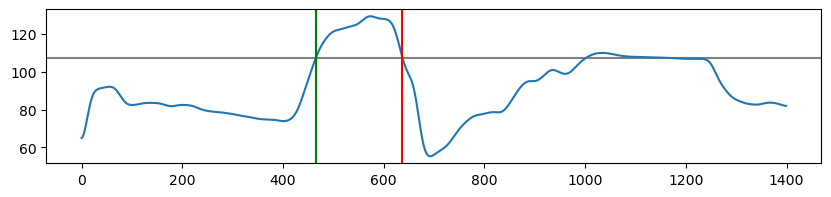

Filtering last event: 999 93
valid end point
valid beginning
3 3


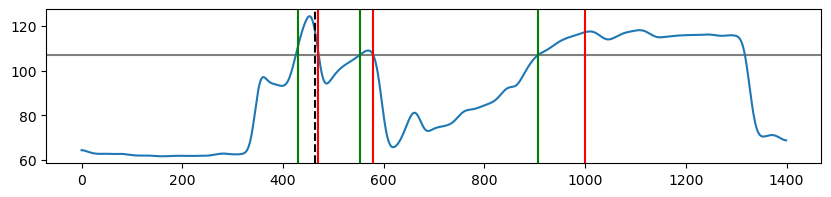

Filtering last event: 999 375
valid end point
valid beginning
3 4


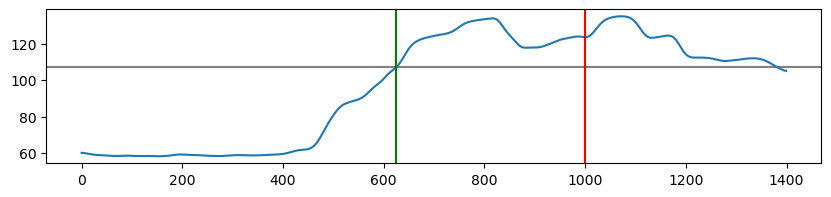

Filtering last event: 981 41
valid end point
valid beginning
3 6


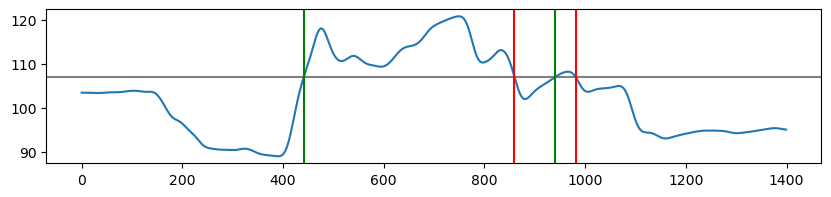

Filtering last event: 999 506
valid end point
valid beginning
3 7


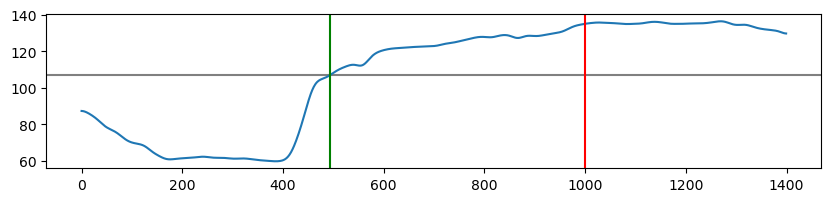

Filtering last event: 999 363
valid end point
valid beginning
3 8


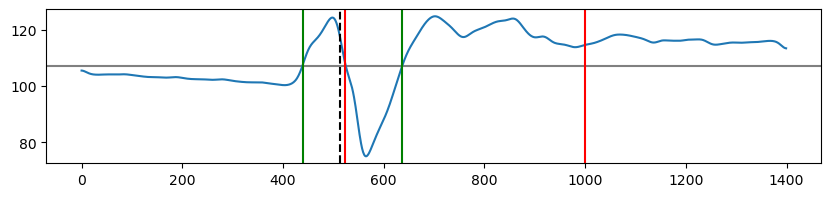

Filtering last event: 999 154
valid end point
valid beginning
3 9


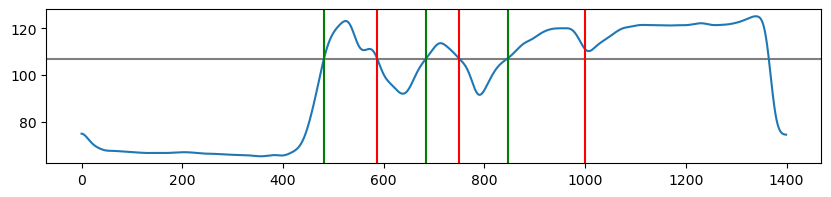

Filtering last event: 999 537
valid end point
valid beginning
3 10


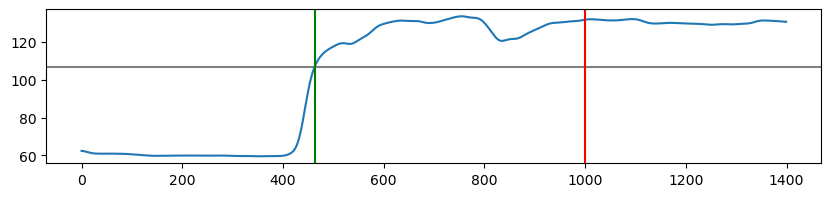

Filtering last event: 999 40
valid end point
valid beginning
4 1


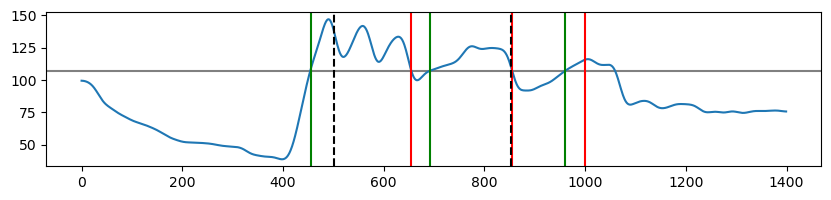

Filtering last event: 948 129
valid end point
valid beginning
4 2


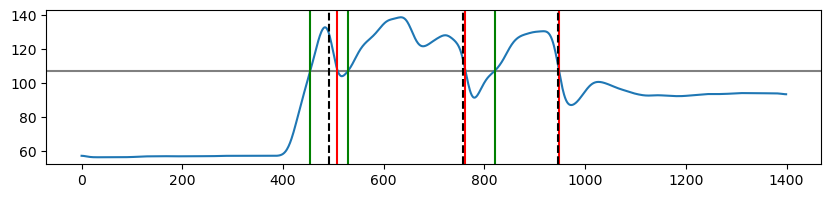

Filtering last event: 942 491
valid end point
valid beginning
4 3


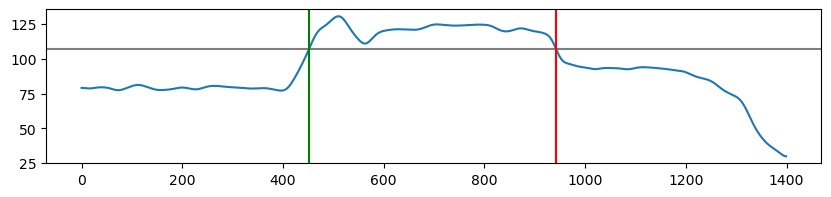

Filtering last event: 763 62
valid end point
valid beginning
4 4


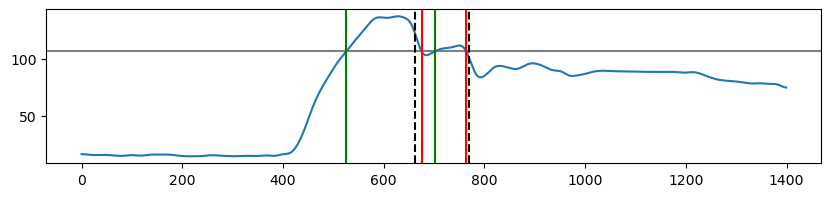

Filtering last event: 999 501
valid end point
valid beginning
4 5


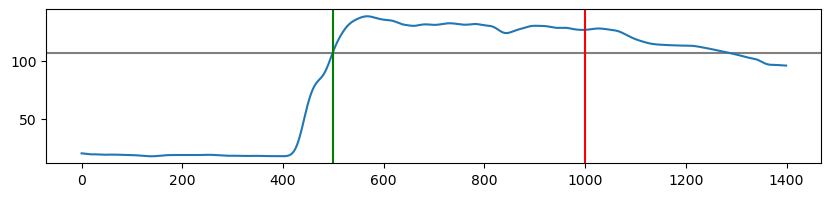

Filtering last event: 949 306
valid end point
valid beginning
4 6


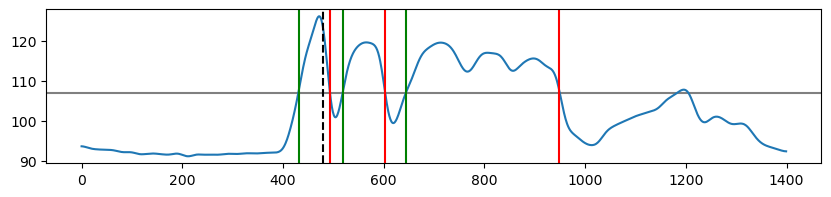

Filtering last event: 999 6
removing last event of length 6
valid beginning
4 7


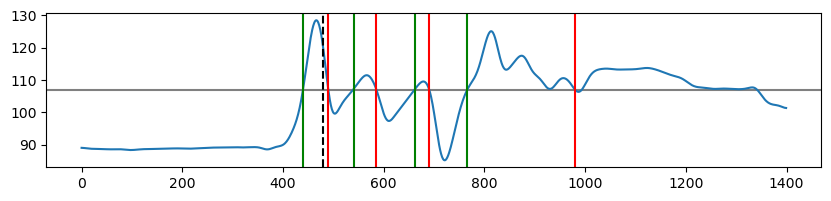

Filtering last event: 838 73
valid end point
valid beginning
4 8


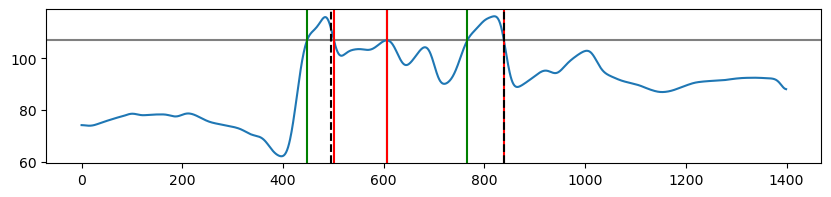

Filtering last event: 999 566
valid end point
valid beginning
4 9


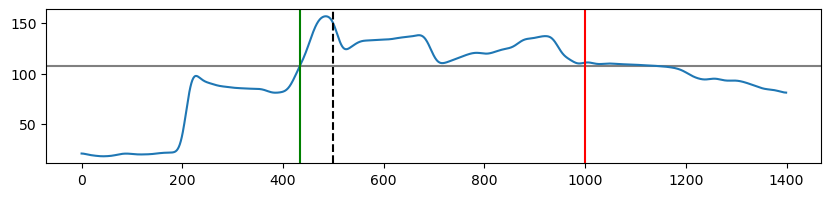

Filtering last event: 999 275
valid end point
valid beginning
4 10


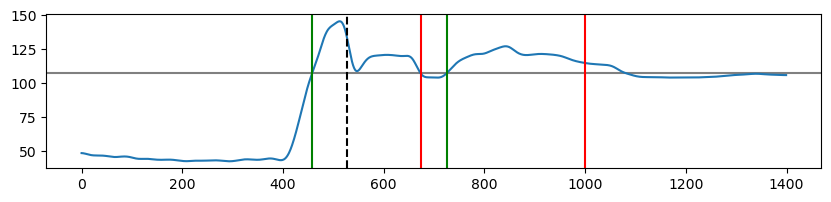

Filtering last event: 999 164
valid end point
valid beginning
5 1


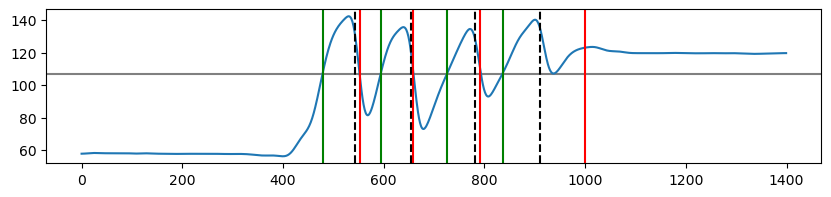

Filtering last event: 999 96
valid end point
valid beginning
5 2


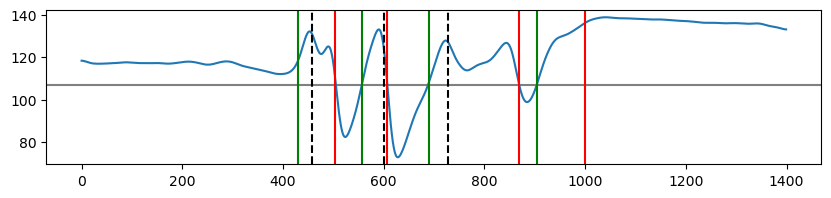

Filtering last event: 999 111
valid end point
remoning first event initiated during contraction 2
5 3


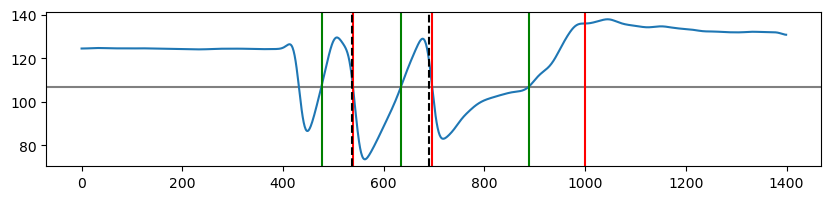

Filtering last event: 851 134
valid end point
remoning first event initiated during contraction 10
5 4


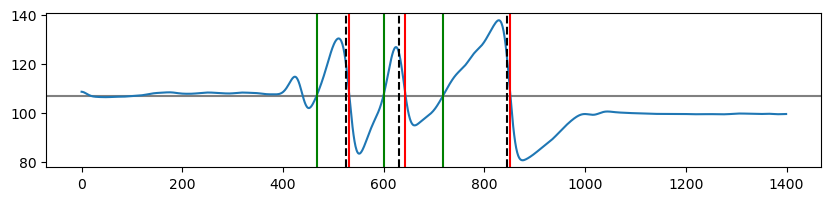

Filtering last event: 999 344
valid end point
valid beginning
5 5


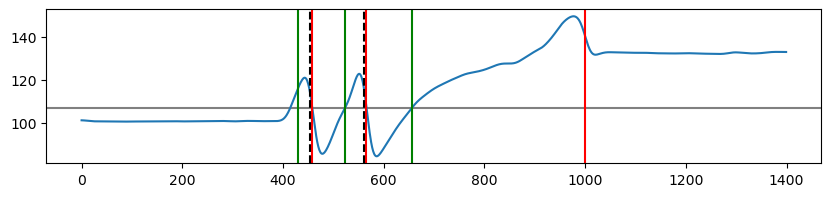

Filtering last event: 999 53
valid end point
remoning first event initiated during contraction 3
5 6


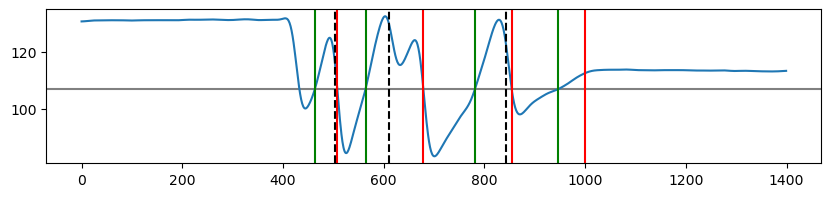

Filtering last event: 999 196
valid end point
valid beginning
5 7


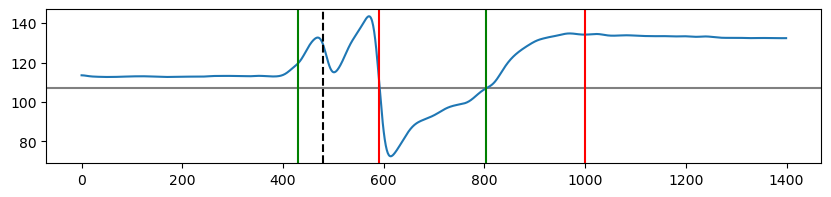

Filtering last event: 920 198
valid end point
remoning first event initiated during contraction 3
5 8


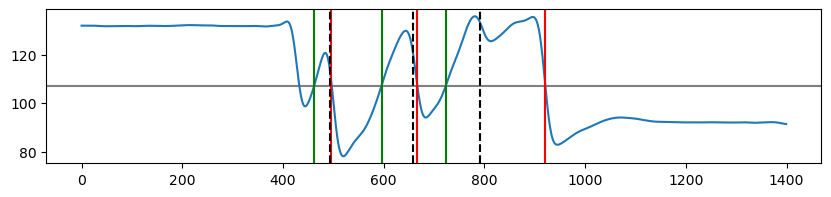

Filtering last event: 999 145
valid end point
valid beginning
5 9


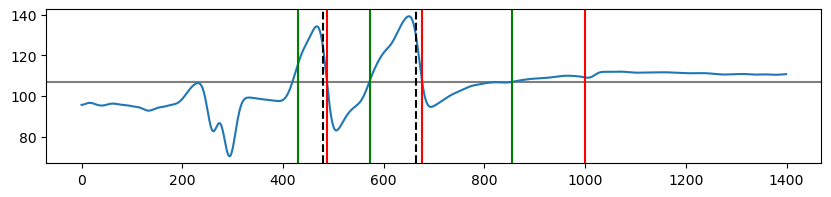

Filtering last event: 999 161
valid end point
valid beginning
5 10


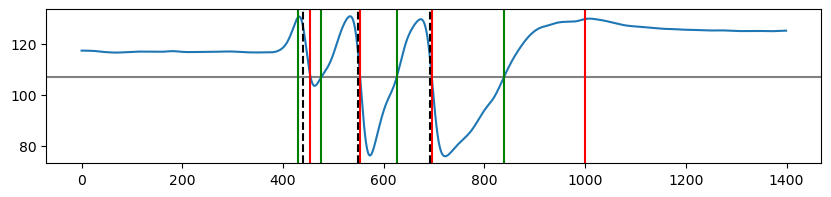

Filtering last event: 999 100
valid end point
valid beginning
6 1


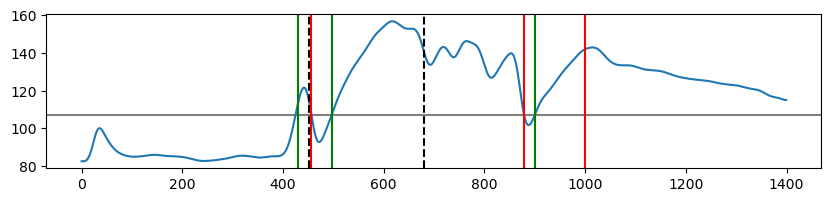

Filtering last event: 999 33
valid end point
valid beginning
6 2


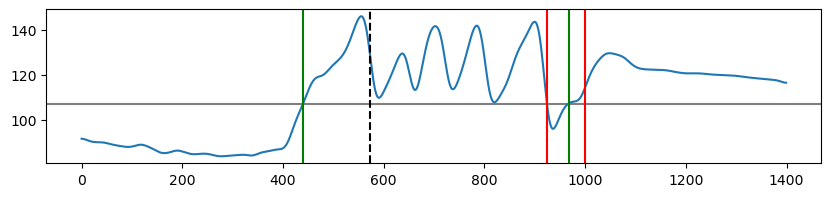

Filtering last event: 999 563
valid end point
valid beginning
6 3


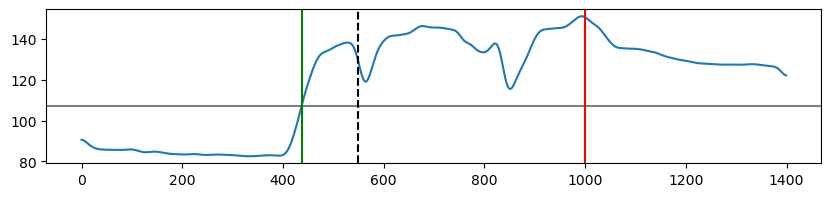

Filtering last event: 999 231
valid end point
valid beginning
6 4


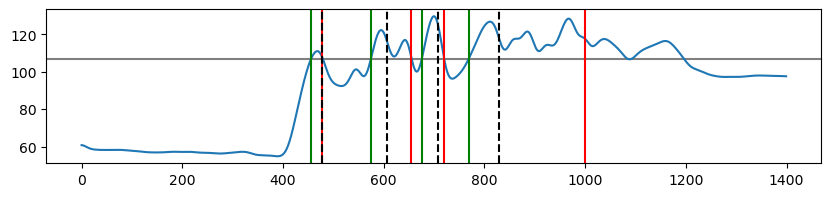

Filtering last event: 999 30
valid end point
valid beginning
6 5


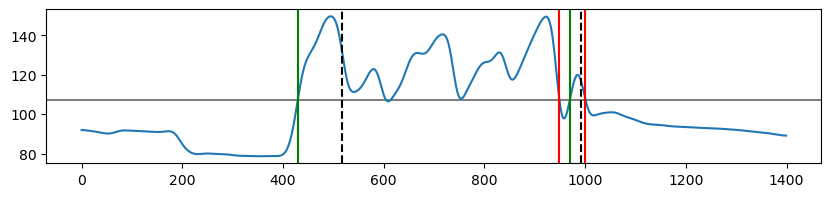

Filtering last event: 990 369
valid end point
valid beginning
6 6


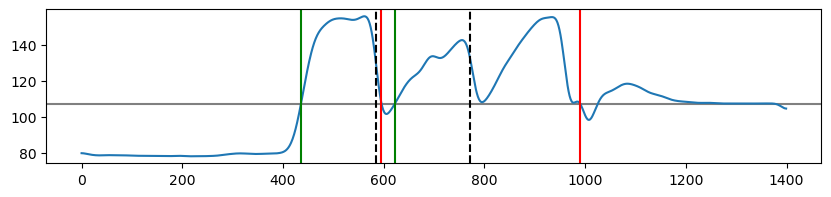

Filtering last event: 999 407
valid end point
valid beginning
6 7


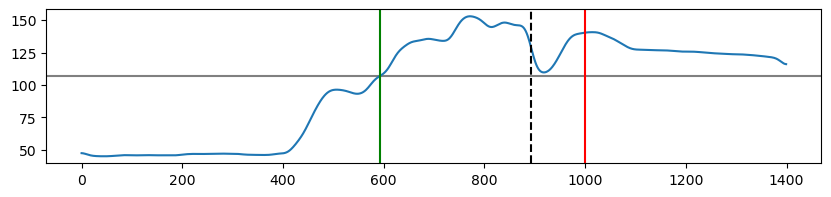

Filtering last event: 999 67
valid end point
valid beginning
6 8


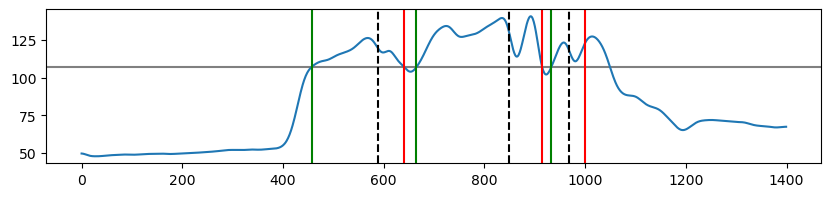

Filtering last event: 999 440
valid end point
valid beginning
6 9


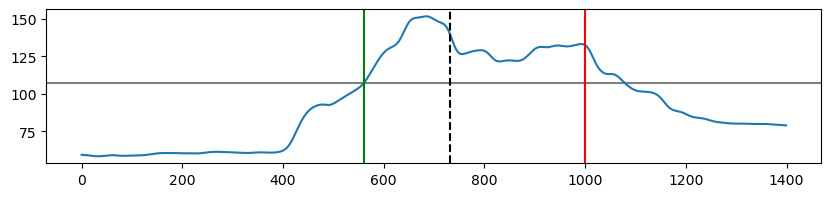

Filtering last event: 999 184
valid end point
valid beginning
6 10


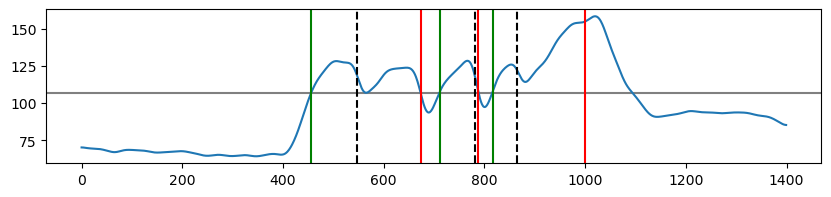

Filtering last event: 691 18
valid end point
valid beginning
7 1


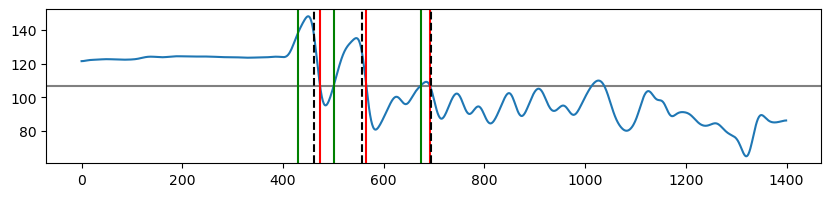

Filtering last event: 986 4
valid end point
valid beginning
7 2


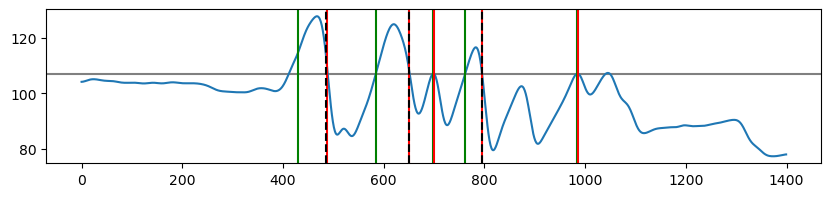

Filtering last event: 997 21
valid end point
remoning first event initiated during contraction 36
7 3


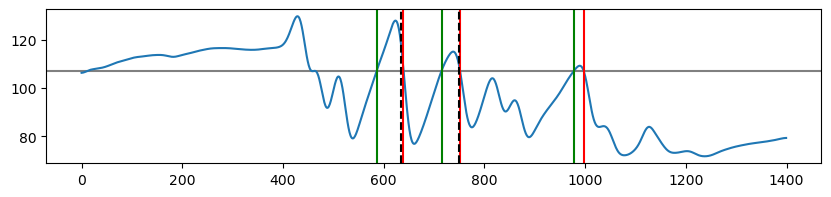

Filtering last event: 941 27
valid end point
valid beginning
7 4


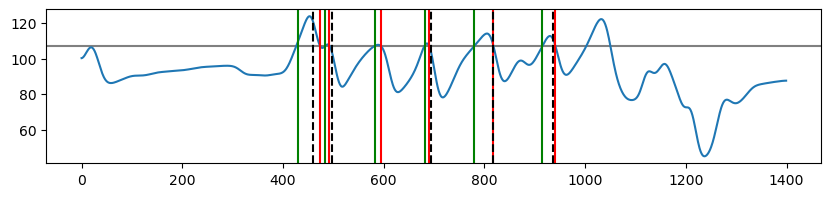

Filtering last event: 999 39
valid end point
valid beginning
7 5


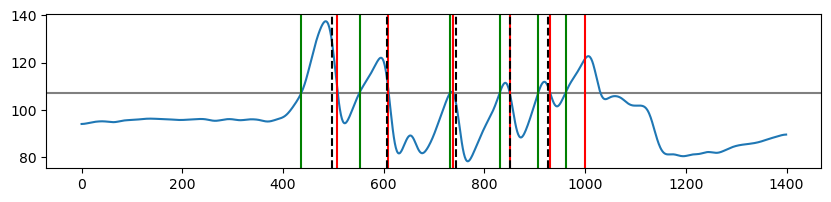

Filtering last event: 999 8
removing last event of length 8
valid beginning
7 6


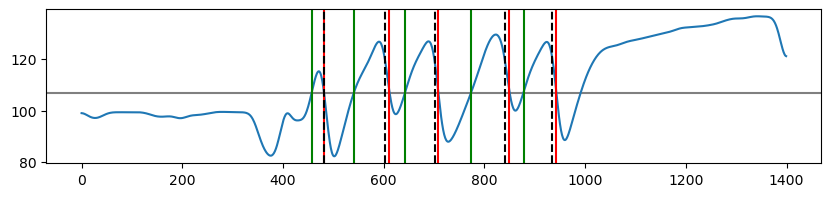

Filtering last event: 999 13
removing last event of length 13
valid beginning
7 7


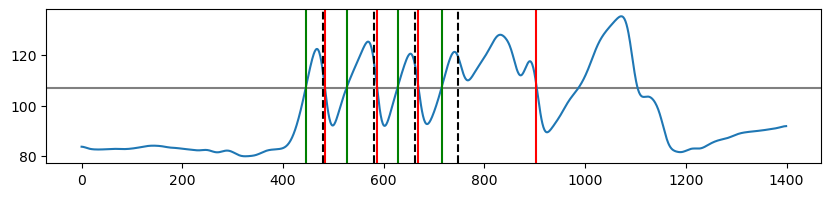

Filtering last event: 999 93
valid end point
valid beginning
7 8


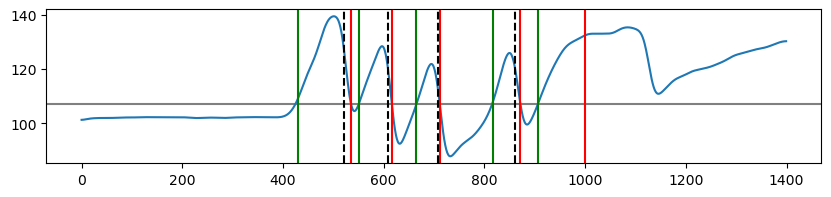

Filtering last event: 999 6
removing last event of length 6
remoning first event initiated during contraction 28
7 9


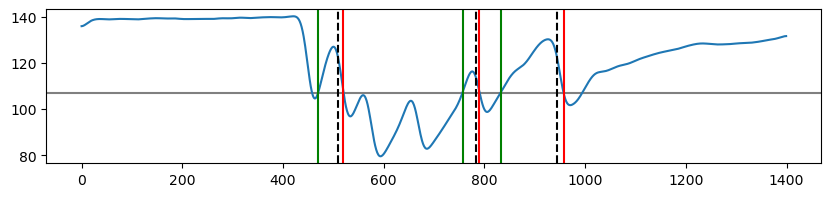

Filtering last event: 999 43
valid end point
remoning first event initiated during contraction 2
7 10


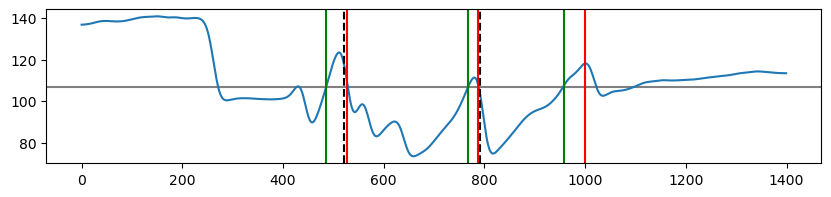

In [ ]:
ang_name = 'C_flex'
count_SIZ_reached_MDN_L1, swing_events_within_SIZ_MDN_L1, percentage_MDN_L1, dwell_time_MDN_L1 = get_stepping_params_Fleg(MDN,'L1','L1'+ang_name,MDN_L1_all_swings)
count_SIZ_reached_MDN_R1, swing_events_within_SIZ_MDN_R1, percentage_MDN_R1, dwell_time_MDN_R1 = get_stepping_params_Fleg(MDN,'R1','R1'+ang_name, MDN_R1_all_swings)

Filtering last event: 999 14
removing last event of length 14
Filtering last event: 999 37
valid end point
valid beginning
2 7


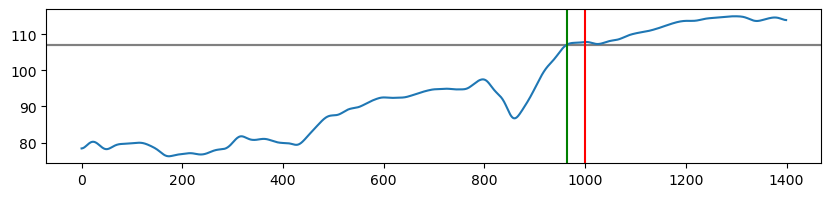

Filtering last event: 999 27
valid end point
valid beginning
2 9


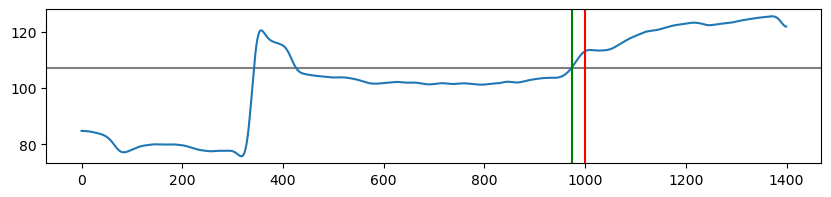

Filtering last event: 624 195
valid end point
valid beginning
3 3


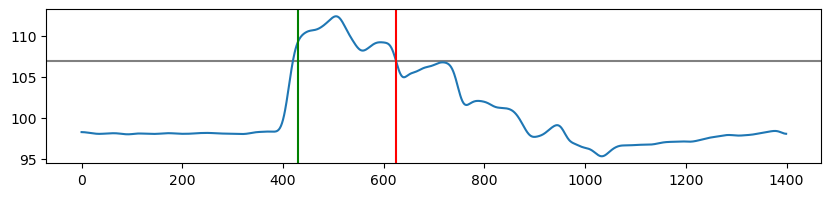

Filtering last event: 999 187
valid end point
valid beginning
3 4


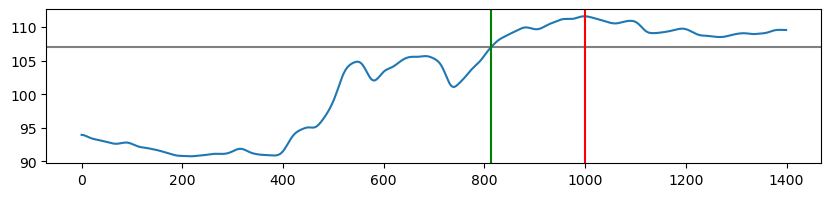

Filtering last event: 860 431
valid end point
valid beginning
3 5


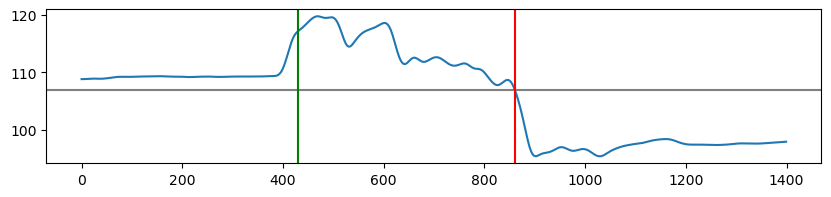

Filtering last event: 543 64
valid end point
valid beginning
3 6


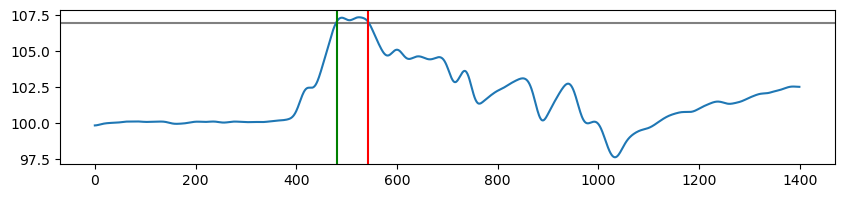

Filtering last event: 999 543
valid end point
valid beginning
3 8


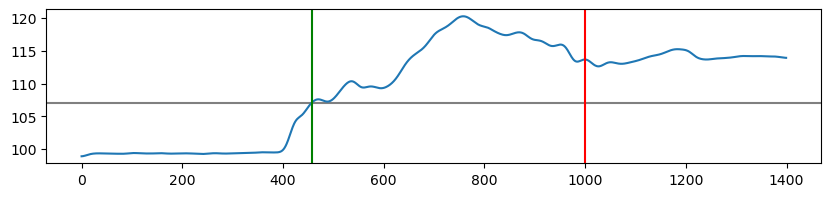

Filtering last event: 999 570
valid end point
valid beginning
3 9


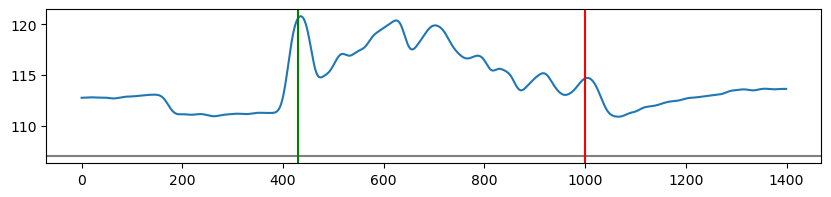

Filtering last event: 999 254
valid end point
remoning first event initiated during contraction 34
3 10


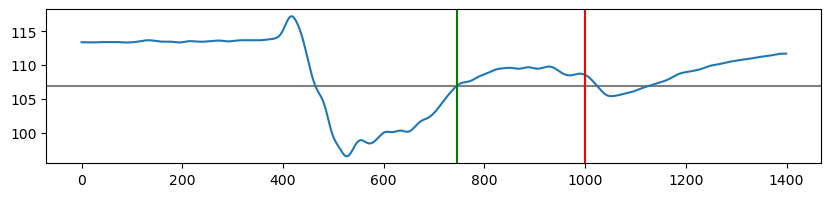

Filtering last event: 999 570
valid end point
valid beginning
5 2


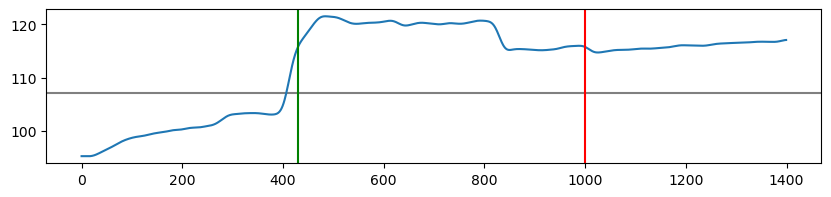

Filtering last event: 999 570
valid end point
valid beginning
5 3


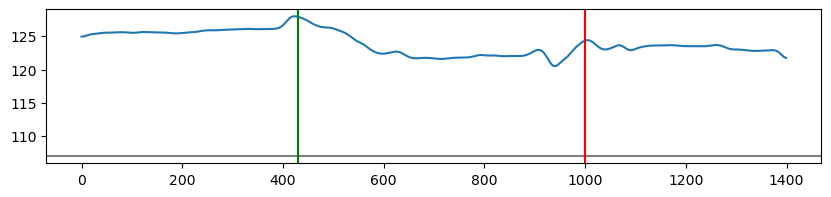

Filtering last event: 505 76
valid end point
valid beginning
5 6


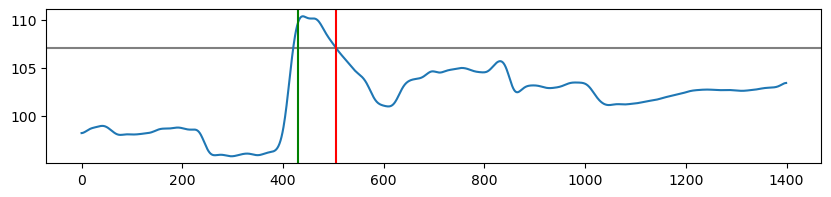

Filtering last event: 999 570
valid end point
valid beginning
5 7


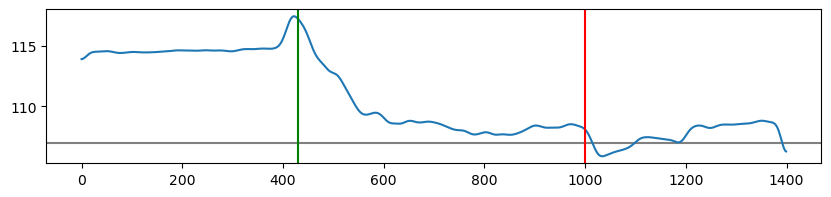

Filtering last event: 999 342
valid end point
valid beginning
8 3


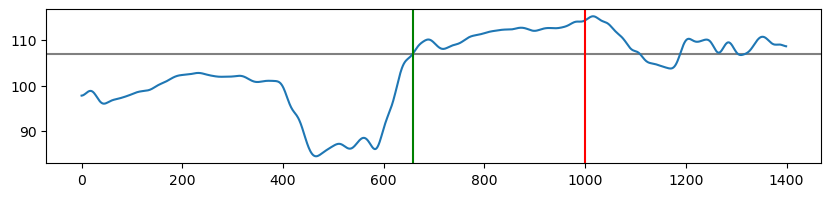

Filtering last event: 693 24
valid end point
valid beginning
8 7


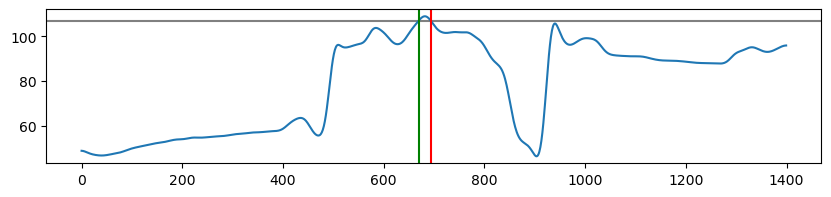

Filtering last event: 827 159
valid end point
valid beginning
8 9


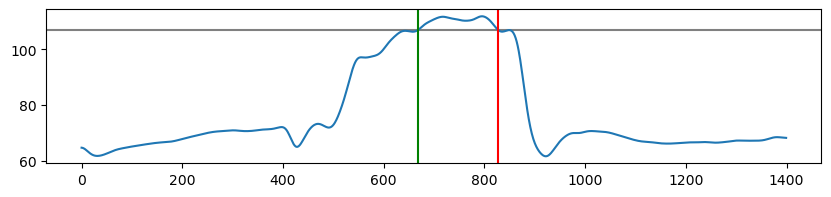

Filtering last event: 999 114
valid end point
valid beginning
2 1


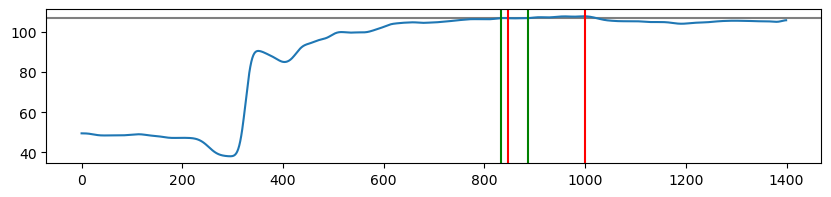

Filtering last event: 999 312
valid end point
valid beginning
2 4


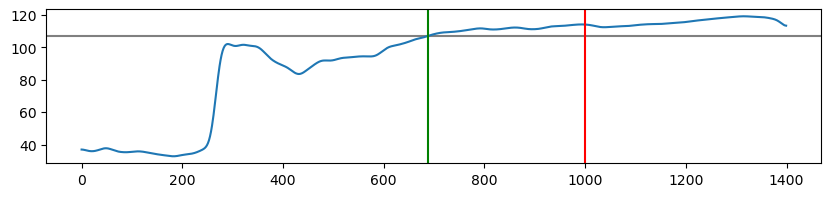

Filtering last event: 570 45
valid end point
valid beginning
3 9


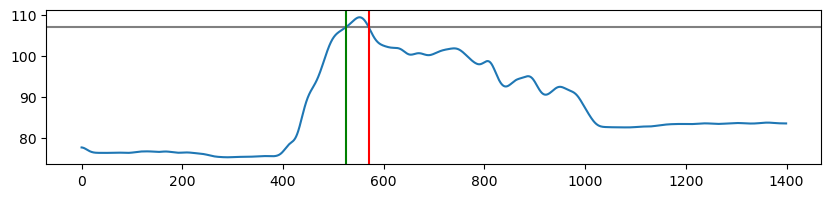

Filtering last event: 966 82
valid end point
valid beginning
8 7


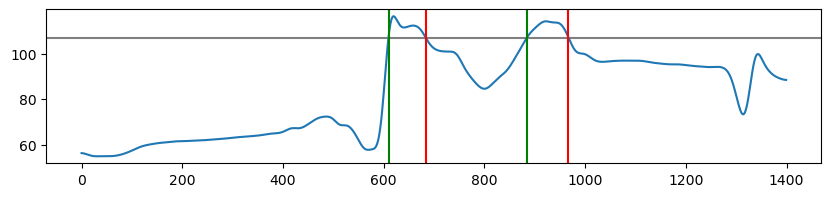

In [ ]:

count_SIZ_reached_MDN_Stop1_L1, swing_events_within_SIZ_MDN_Stop1_L1, percentage_MDN_Stop1_L1, dwell_time_MDN_Stop1_L1 = get_stepping_params_Fleg(MDN_Stop1,'L1','L1'+ang_name, MDN_Stop1_L1_all_swings )
count_SIZ_reached_MDN_Stop1_R1, swing_events_within_SIZ_MDN_Stop1_R1, percentage_MDN_Stop1_R1, dwell_time_MDN_Stop1_R1 = get_stepping_params_Fleg(MDN_Stop1,'R1','R1'+ang_name, MDN_Stop1_R1_all_swings )

In [ ]:
len(dwell_time_MDN_L1 + dwell_time_MDN_R1)

384

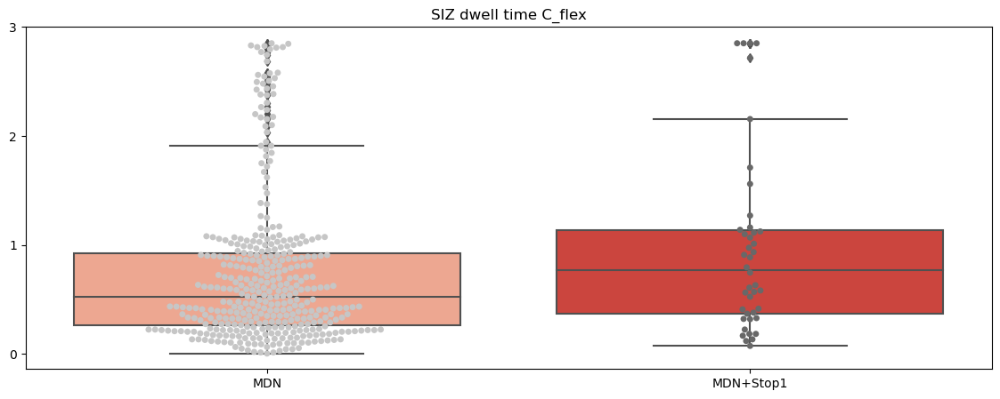

In [ ]:
dwell_time_Flegs_pooled = pd.concat([pd.concat([pd.DataFrame(dwell_time_MDN_L1),pd.DataFrame(dwell_time_MDN_R1)]).reset_index(drop=True),
                                    pd.concat([pd.DataFrame(dwell_time_MDN_Stop1_L1),pd.DataFrame(dwell_time_MDN_Stop1_R1)]).reset_index(drop=True)], axis =1)
dwell_time_Flegs_pooled.columns = header      
# dwell_time_Flegs_pooled.to_csv(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Front\DT_'+ang_name+'.csv')  

plt.rcParams['figure.figsize'] = (14,5)
sns.swarmplot(dwell_time_Flegs_pooled, size = 5, palette = 'Greys')
sns.boxplot(dwell_time_Flegs_pooled, palette = 'Reds')
plt.yticks(np.arange(0,800,200), np.arange(0,4,1)) 
plt.title('SIZ dwell time '+ ang_name)
# plt.savefig(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Front\DwellTime_'+ang_name+'.svg', dpi = 300)

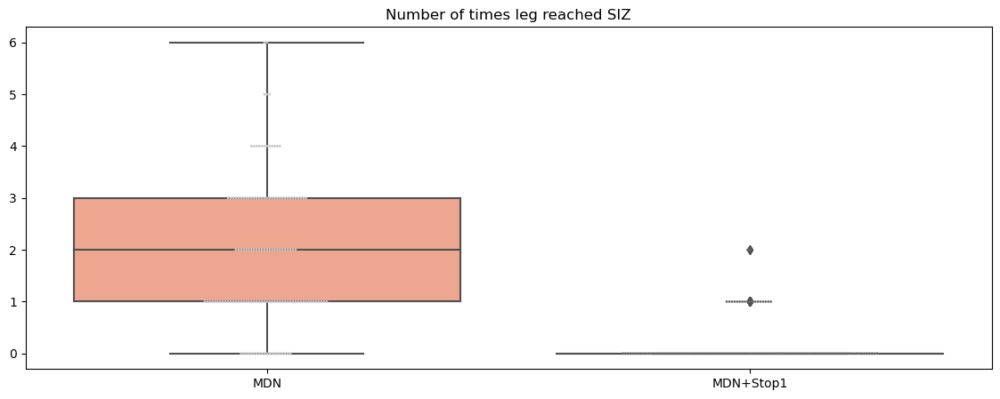

In [ ]:
count_SIZ_Flegs_pooled = pd.concat([pd.concat([pd.DataFrame(count_SIZ_reached_MDN_L1),pd.DataFrame(count_SIZ_reached_MDN_R1)]).reset_index(drop=True),
                                    pd.concat([pd.DataFrame(count_SIZ_reached_MDN_Stop1_L1),pd.DataFrame(count_SIZ_reached_MDN_Stop1_R1)]).reset_index(drop=True)], axis =1)
count_SIZ_Flegs_pooled.columns = header      
# count_SIZ_Flegs_pooled.to_csv(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Front\Count_'+ang_name+'.csv') 

plt.rcParams['figure.figsize'] = (14,5)
sns.swarmplot(count_SIZ_Flegs_pooled, size = 2, palette = 'Greys')
sns.boxplot(count_SIZ_Flegs_pooled, palette = 'Reds')
# plt.yticks(np.arange(0,13,2))
plt.title('Number of times leg reached SIZ')
# plt.savefig(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Front\SIZ_Count_'+ang_name+'.svg', dpi = 300)

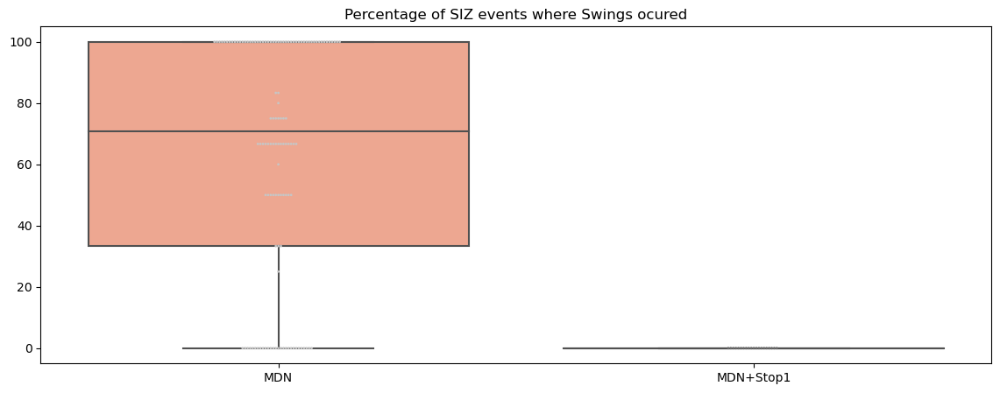

In [ ]:
percentage_swings_SIZ_Flegs_pooled = pd.concat([pd.concat([pd.DataFrame(percentage_MDN_L1),pd.DataFrame(percentage_MDN_R1)]).reset_index(drop=True),
                                    pd.concat([pd.DataFrame(percentage_MDN_Stop1_L1),pd.DataFrame(percentage_MDN_Stop1_R1)]).reset_index(drop=True)], axis =1)
percentage_swings_SIZ_Flegs_pooled.columns = header      
# percentage_swings_SIZ_Flegs_pooled.to_csv(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Front\PS_corrected_'+ang_name+'.csv') 

plt.rcParams['figure.figsize'] = (14,5)
sns.swarmplot(percentage_swings_SIZ_Flegs_pooled, size = 2, palette = 'Greys')
sns.boxplot(percentage_swings_SIZ_Flegs_pooled, palette = 'Reds')
# plt.yticks(np.arange(0,13,2))
plt.title('Percentage of SIZ events where Swings ocured')
# plt.savefig(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Front\Percent_Swings_'+ang_name+'.svg', dpi = 300)

In [ ]:
raise TypeError('end of section')

##  Hind Leg

In [ ]:

def get_reset_ang_Hleg (df, leg):
    if leg == 'L3':
        sc = 'L-H_stepcycle'
        angle = 'L3C_flex'
    if leg =='R3':
        sc = 'R-H_stepcycle'
        angle = 'R3C_flex'

    reset_ang = []
    swing_count = [] # number of separate events predicted to be swings from ball prediction and accompanied by a sudden, large change in angle
    reset_timepts = pd.DataFrame()

    for n in df['flynum'].unique().tolist():
        for t in df.groupby('flynum').get_group(n)['tnum'].unique().tolist():
            print((n,t))
            data = df.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)
            sc_temp = pd.DataFrame(data[sc])
            ang = data[angle]

            plt.rcParams['figure.figsize'] = (10,2)
            plt.plot (ang)
            
            sc_diff = pd.DataFrame(np.diff(sc_temp[sc].astype(int)))
            swing_init =sc_diff.loc[sc_diff[0] == -1].index.tolist() # index from diff ==> add idx = 1 
            
            if len(swing_init)>0:
                swing_init = [x+1 for x in swing_init]
            
                print((n,t,swing_init))
                for i in swing_init:
                    plt.plot(i, ang[i], 'oy', alpha = 1, label = 'predicted')

                # swing_idx  =sc_temp.loc[sc_temp[sc] == False].index.tolist() # swing frames from ball prediction

                ang_diff = pd.DataFrame(np.diff(ang))
                ang_diff_resets = ang_diff.loc[(ang_diff[0]) > 3].index.tolist() #index from diff ==> add idx = 1
                ang_diff_resets = [x+1 for x in ang_diff_resets] # indexing fixed

                # for i in ang_diff_resets:
                #     plt.plot(i, ang[i], 'ob', alpha = 0.2)

                real_swing = []
                for temp_swing in swing_init:
                    reset_within = 0
                    if ((temp_swing <1001) & (temp_swing> 400)):
                        
                        for ang_reset in ang_diff_resets:
                            if reset_within == 0 :
                                if ang_reset in range(temp_swing,temp_swing+5):
                                    real_swing.append(temp_swing)
                                    reset_within+=1
                print((n,t,real_swing))
                temp_df = pd.DataFrame(real_swing)
                temp_df.insert(0, 'tnum', t)
                temp_df.insert(0, 'flynum', n)
                reset_timepts = pd.concat([reset_timepts, temp_df], axis = 0).reset_index(drop= True)

                for i in real_swing:
                    plt.plot(real_swing, ang[real_swing], 'or', label = 'real_swing')
                    
                swing_count.append(len(real_swing))

                for i in real_swing:
                    temp_ang = ang[i]
                    reset_ang.append(temp_ang)

                plt.xlim(400,1000)
                plt.show()

            else:
                print('no swing found')
                plt.xlim(400,1000)
                plt.show()


    reset_timepts.columns = ['flynum', 'tnum', 'swing_ts']
    return reset_ang, swing_count, reset_timepts

(1, 1)
(1, 1, [453, 477, 496, 825])
(1, 1, [496, 825])


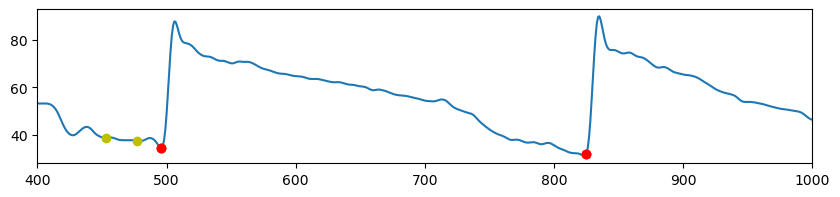

(1, 2)
(1, 2, [410, 547, 652, 777, 1016, 1229, 1259, 1278])
(1, 2, [410, 547, 777])


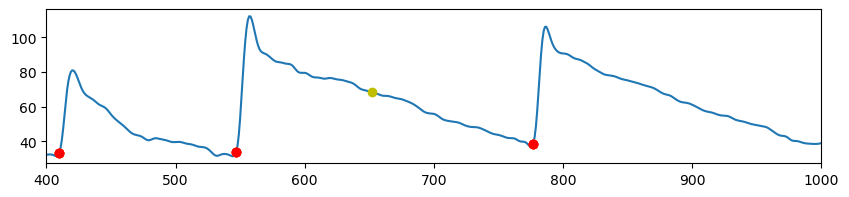

(1, 3)
(1, 3, [54, 97, 116, 160, 513, 546, 674, 716, 760, 917, 969, 1398])
(1, 3, [760, 969])


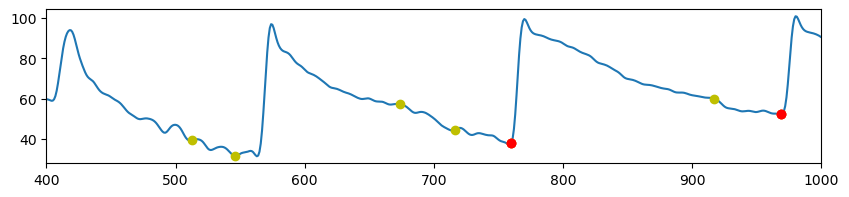

(1, 4)
(1, 4, [277, 413, 456, 573, 628, 756])
(1, 4, [628, 756])


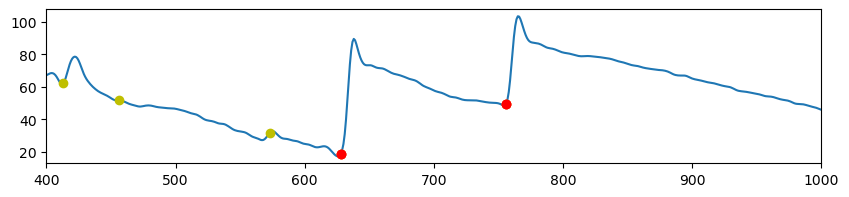

(1, 5)
(1, 5, [43, 661, 868, 1019, 1058, 1095, 1169, 1228])
(1, 5, [661, 868])


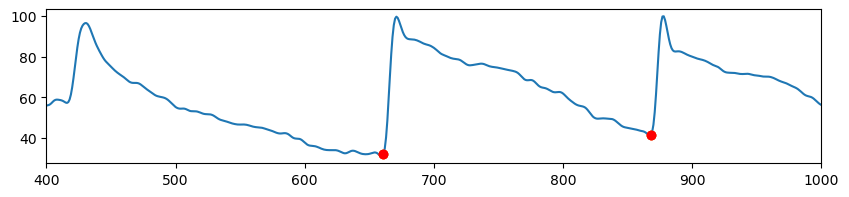

(1, 6)
(1, 6, [2, 409, 542, 842, 869, 890, 905, 953])
(1, 6, [409, 542, 869])


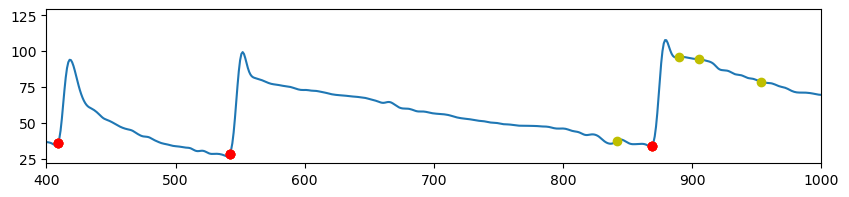

(1, 7)
(1, 7, [126, 188, 213, 564, 828, 1398])
(1, 7, [564, 828])


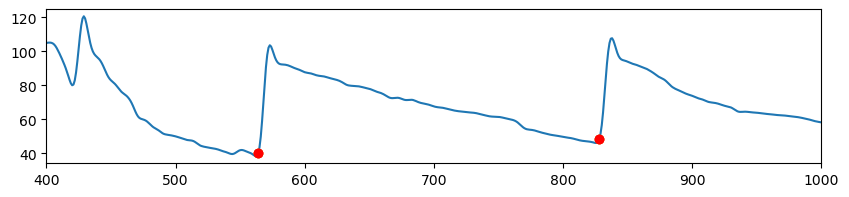

(1, 8)
(1, 8, [435, 450, 503, 653, 821, 962, 981])
(1, 8, [653, 821, 962])


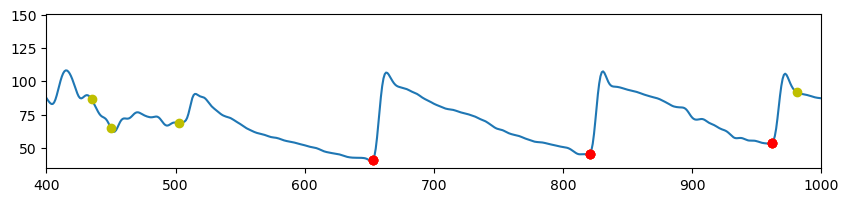

(1, 9)
(1, 9, [9, 33, 90, 113, 189, 309, 642, 811, 831, 859, 932, 962])
(1, 9, [642, 811, 932])


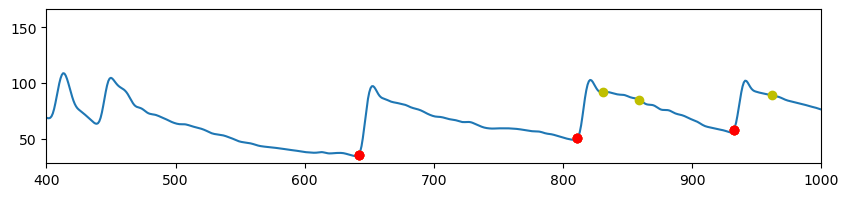

(1, 10)
(1, 10, [268, 428, 596, 617, 737, 756, 890, 908, 938])
(1, 10, [428, 596, 737, 890])


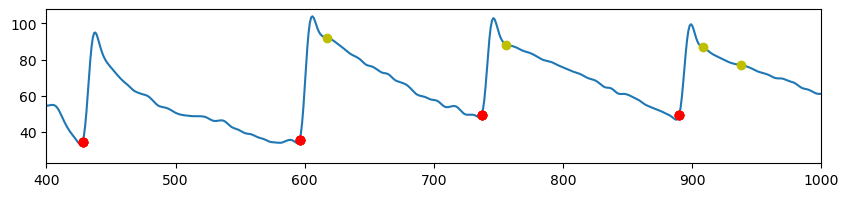

(2, 1)
(2, 1, [153, 159, 180, 212, 337, 476, 526, 571, 633, 710, 820, 888, 1033, 1146, 1194])
(2, 1, [476, 526, 571, 633, 710, 820, 888])


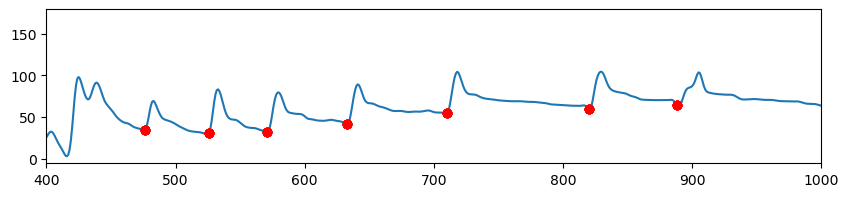

(2, 2)
(2, 2, [91, 137, 467, 483, 566, 606, 725, 864, 901, 952, 1033, 1051, 1073, 1173, 1397])
(2, 2, [483, 566, 606, 725, 864, 901])


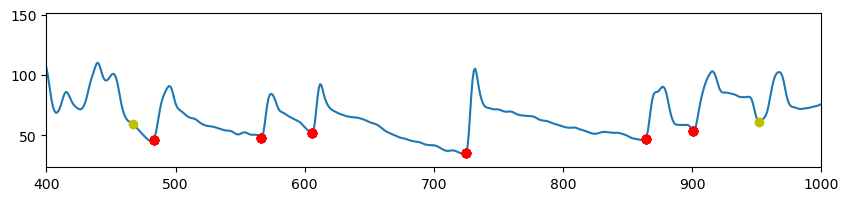

(2, 3)
(2, 3, [197, 454, 483, 602, 773, 1193, 1228, 1281])
(2, 3, [454, 602, 773])


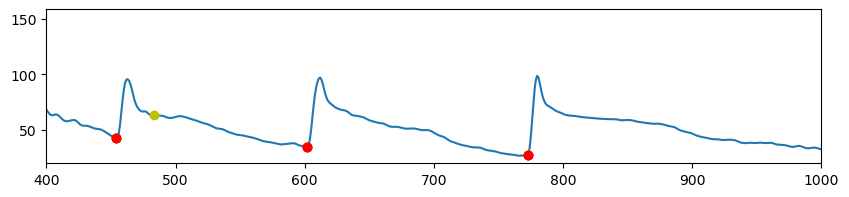

(2, 4)
(2, 4, [20, 32, 522, 660, 1001, 1145, 1184])
(2, 4, [522, 660])


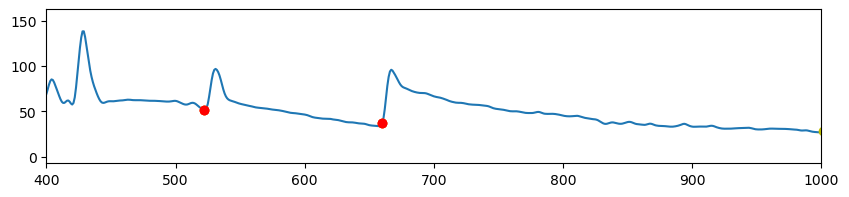

(2, 5)
(2, 5, [304, 355, 474, 695, 989, 1081, 1234, 1394])
(2, 5, [474, 695, 989])


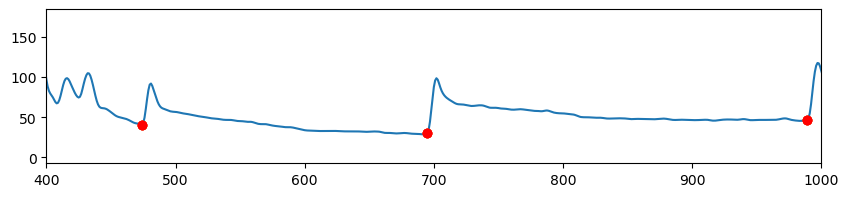

(2, 6)
(2, 6, [59, 211, 249, 441, 495, 581, 1217, 1350])
(2, 6, [441, 495, 581])


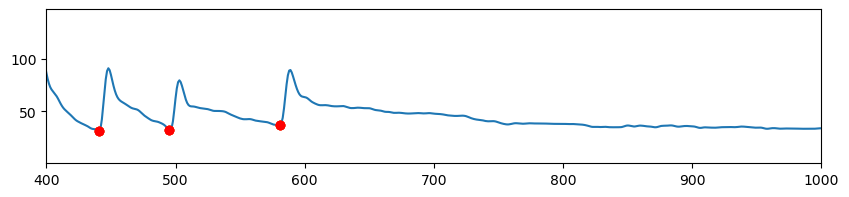

(2, 7)
(2, 7, [321, 367, 413, 473, 561, 1227, 1287])
(2, 7, [413, 473, 561])


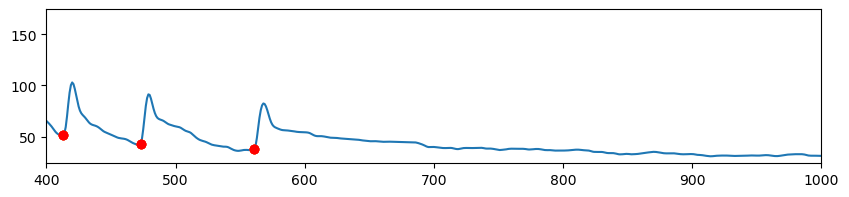

(2, 8)
(2, 8, [2, 364, 377, 504, 616, 844, 1038, 1076, 1100, 1198, 1253, 1289, 1373])
(2, 8, [504, 616, 844])


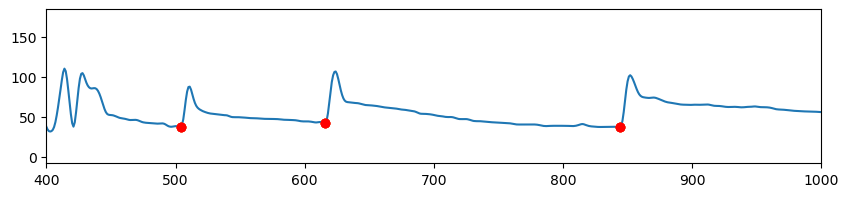

(2, 9)
(2, 9, [522, 792, 1161, 1212, 1241])
(2, 9, [522, 792])


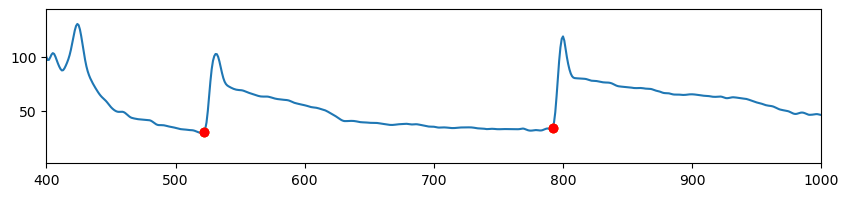

(2, 10)
(2, 10, [30, 84, 139, 196, 244, 643, 839, 1365])
(2, 10, [643, 839])


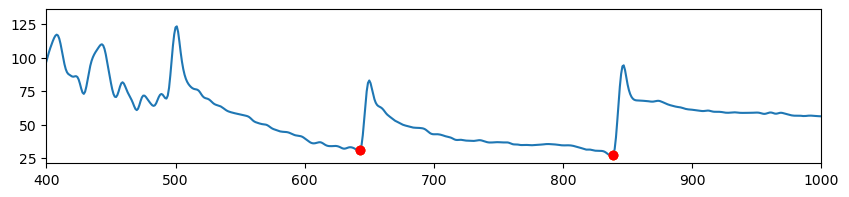

(3, 1)
(3, 1, [423, 629, 765])
(3, 1, [423, 629, 765])


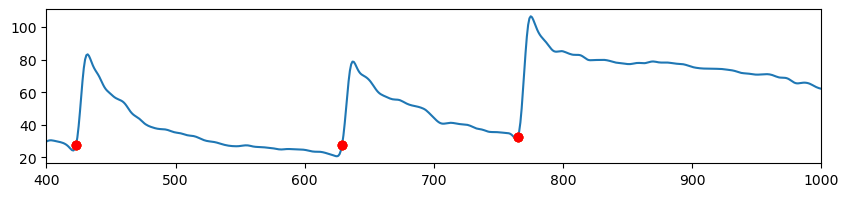

(3, 2)
(3, 2, [165, 216, 290, 540, 680, 958, 1396])
(3, 2, [540, 680, 958])


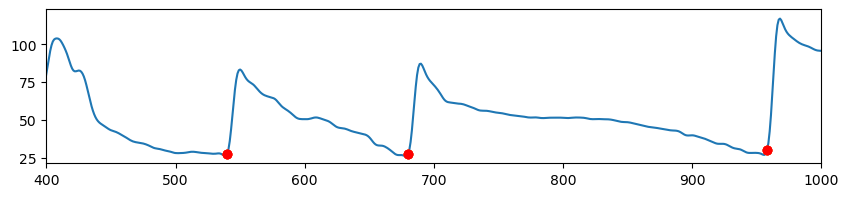

(3, 3)
(3, 3, [426, 614, 765])
(3, 3, [426, 614, 765])


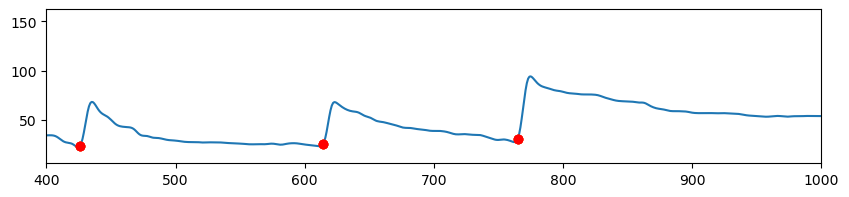

(3, 4)
(3, 4, [436, 588])
(3, 4, [436, 588])


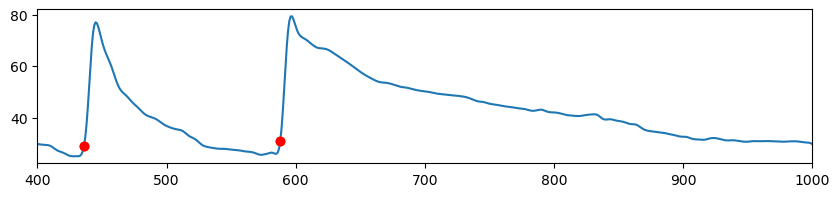

(3, 5)
(3, 5, [468, 695])
(3, 5, [468, 695])


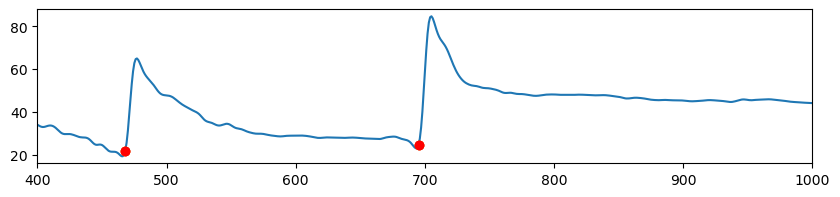

(3, 6)
(3, 6, [369, 441])
(3, 6, [441])


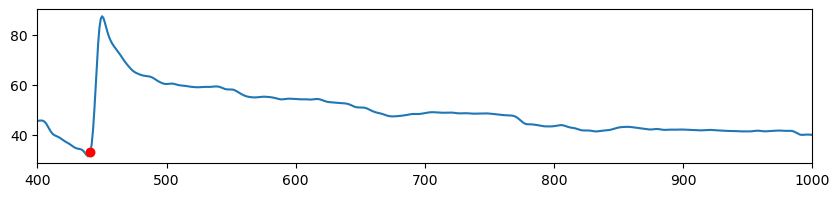

(3, 7)
(3, 7, [102, 226, 254, 294, 550, 1397])
(3, 7, [550])


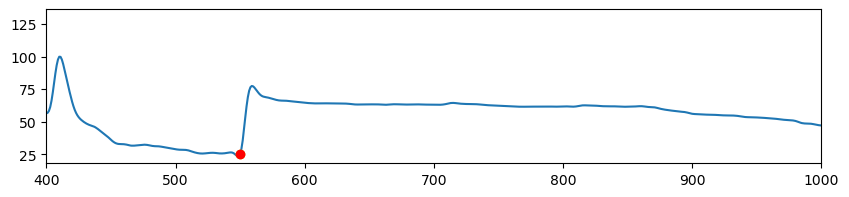

(3, 8)
(3, 8, [501, 599, 1133, 1201])
(3, 8, [501, 599])


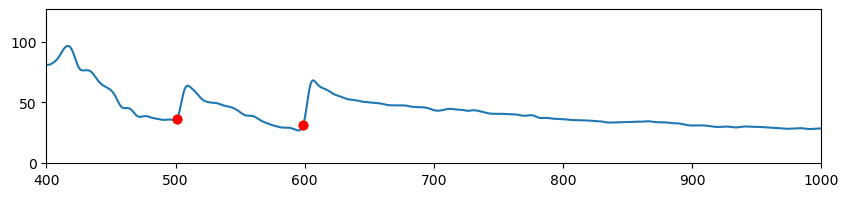

(3, 9)
(3, 9, [20, 553, 777, 1396])
(3, 9, [553, 777])


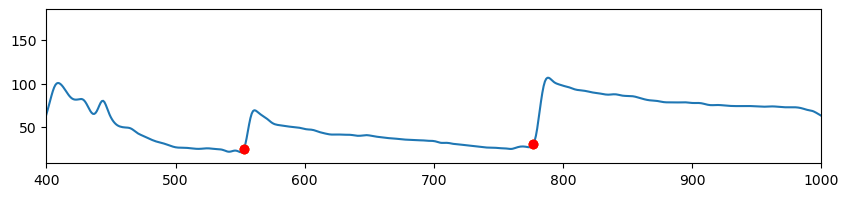

(3, 10)
(3, 10, [91, 560])
(3, 10, [560])


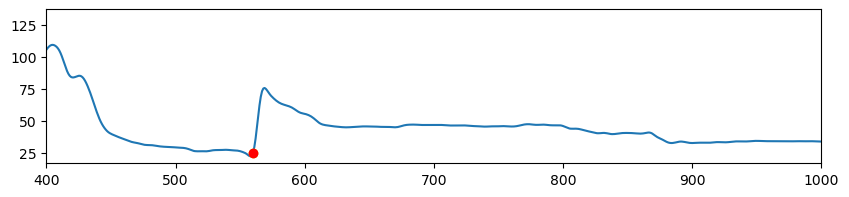

(4, 1)
(4, 1, [128, 158, 240, 296, 382, 510, 623, 817, 973])
(4, 1, [510, 623, 817, 973])


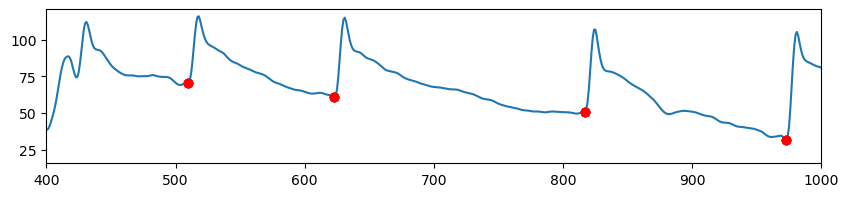

(4, 2)
(4, 2, [435, 517, 606, 736, 878, 1195])
(4, 2, [435, 517, 606, 736, 878])


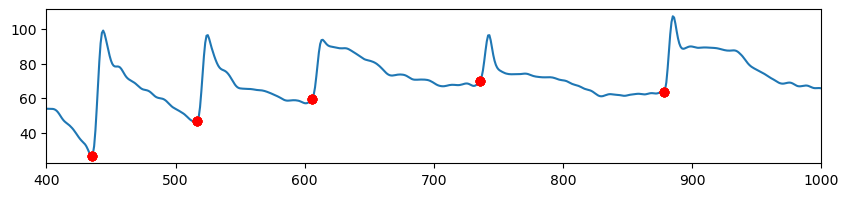

(4, 3)
(4, 3, [424, 503, 583, 691, 863, 976, 1241, 1266, 1291, 1308, 1356])
(4, 3, [424, 503, 583, 691, 863, 976])


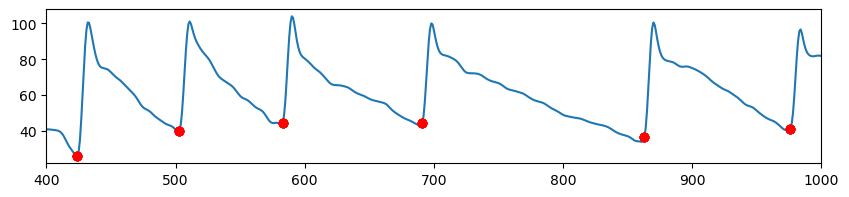

(4, 4)
(4, 4, [148, 263, 528, 631, 836, 920, 1194, 1396])
(4, 4, [528, 631, 836, 920])


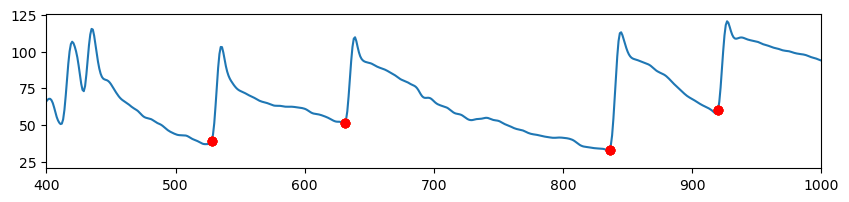

(4, 5)
(4, 5, [154, 454, 616, 813])
(4, 5, [454, 616, 813])


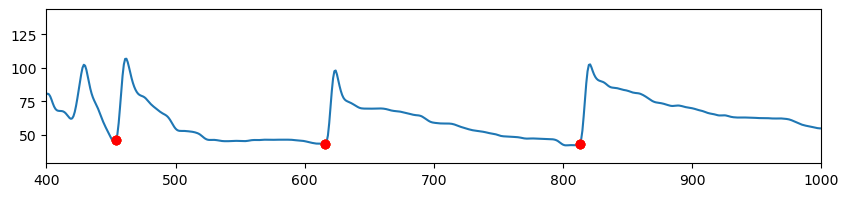

(4, 6)
(4, 6, [412, 465, 549, 679, 807])
(4, 6, [412, 465, 549, 679, 807])


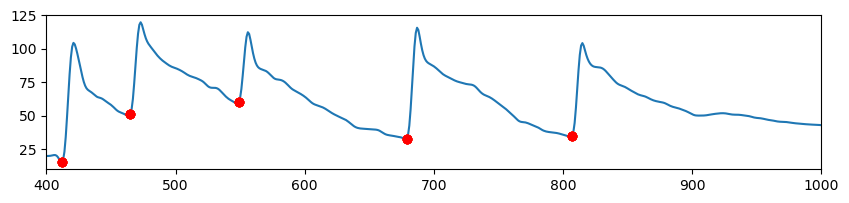

(4, 7)
(4, 7, [411, 470, 538, 638, 755, 931])
(4, 7, [411, 470, 538, 638, 755, 931])


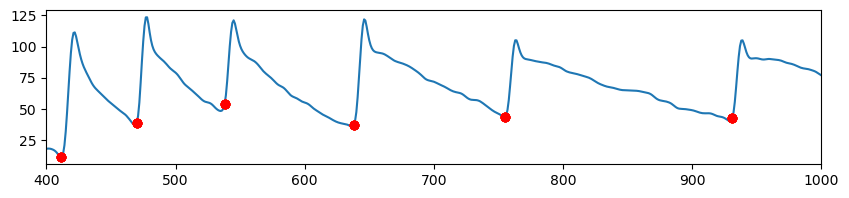

(4, 8)
(4, 8, [323, 404, 442, 541, 639, 775])
(4, 8, [404, 442, 541, 639, 775])


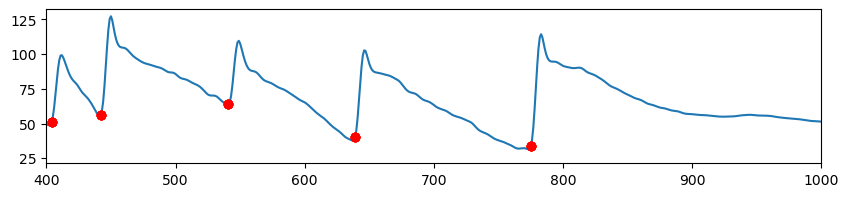

(4, 9)
(4, 9, [170, 214, 403, 620, 835, 1398])
(4, 9, [403, 620, 835])


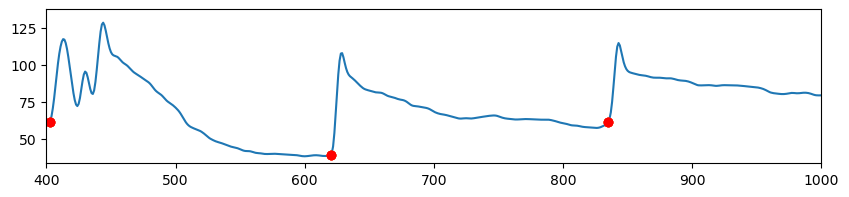

(4, 10)
(4, 10, [458, 536, 612, 783, 1091])
(4, 10, [458, 536, 612, 783])


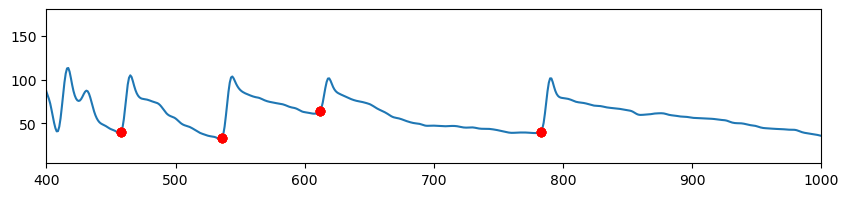

(5, 1)
(5, 1, [468, 530, 621, 749, 876])
(5, 1, [468, 530, 621, 749, 876])


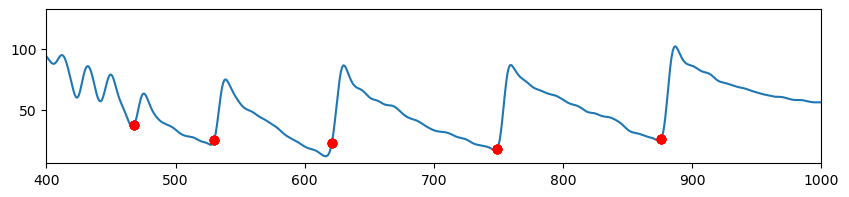

(5, 2)
(5, 2, [297, 479, 517, 571, 679, 832])
(5, 2, [479, 517, 571, 679, 832])


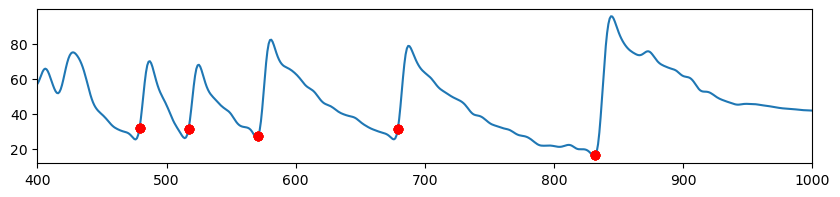

(5, 3)
(5, 3, [8, 46, 75, 116, 211, 231, 245, 307, 348, 375, 451, 519, 615, 879, 1001])
(5, 3, [451, 519, 615, 879])


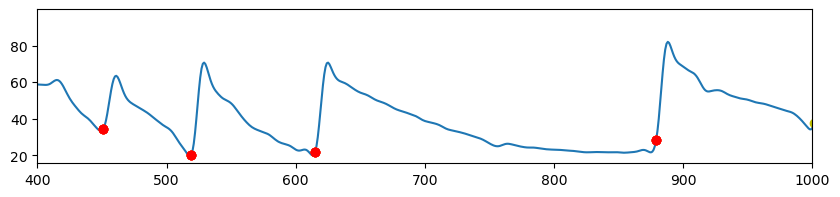

(5, 4)
(5, 4, [481, 593, 786])
(5, 4, [481, 593, 786])


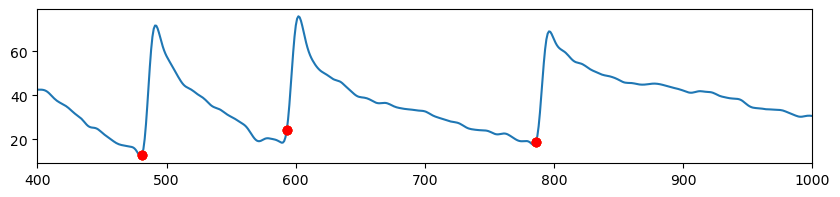

(5, 5)
(5, 5, [434, 535, 904])
(5, 5, [434, 535, 904])


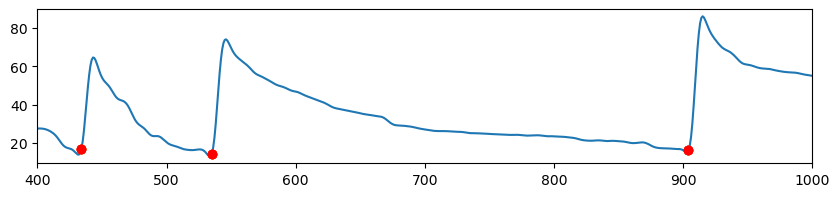

(5, 6)
(5, 6, [483, 586, 760])
(5, 6, [483, 586, 760])


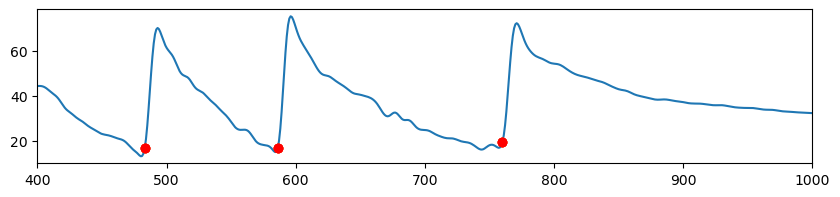

(5, 7)
(5, 7, [464, 559, 806])
(5, 7, [464, 559, 806])


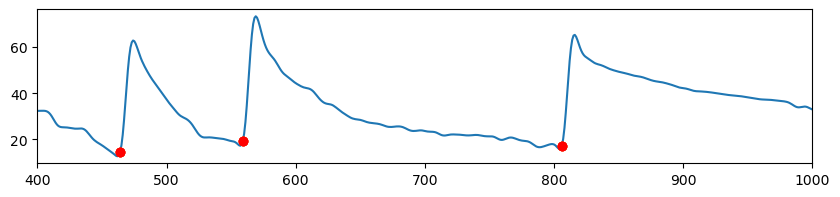

(5, 8)
(5, 8, [453, 553, 737, 880])
(5, 8, [453, 553, 737, 880])


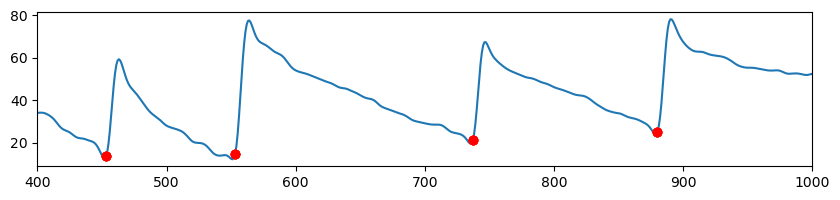

(5, 9)
(5, 9, [113, 445, 548, 1000])
(5, 9, [445, 548, 1000])


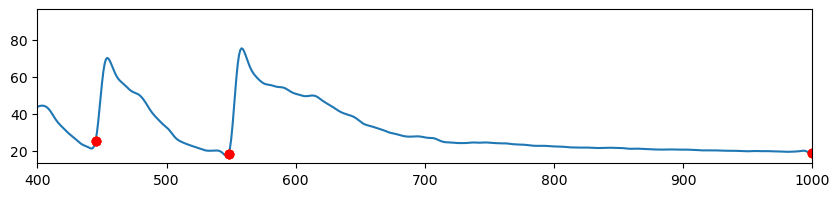

(5, 10)
(5, 10, [490, 537, 614, 806])
(5, 10, [490, 537, 614, 806])


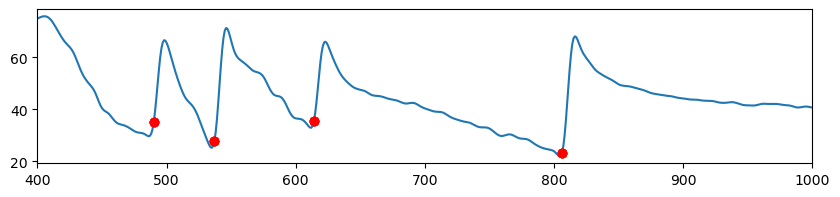

(6, 1)
(6, 1, [377, 395, 434, 525, 900, 952, 998, 1056, 1375])
(6, 1, [434, 525, 900])


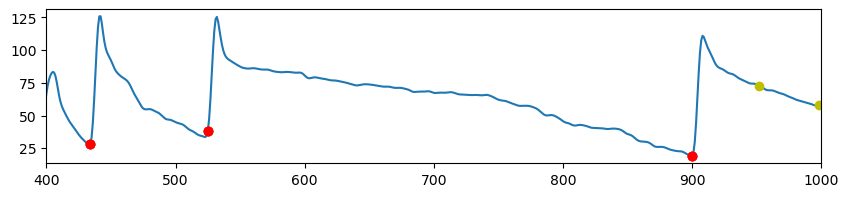

(6, 2)
(6, 2, [37, 414, 495, 625, 733, 866, 998, 1070, 1131])
(6, 2, [414, 495, 625, 733, 866, 998])


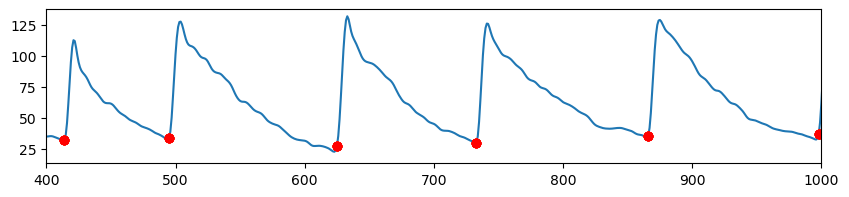

(6, 3)
(6, 3, [82, 114, 141, 199, 322, 357, 410, 442, 467, 857, 907, 919, 1048])
(6, 3, [410, 467])


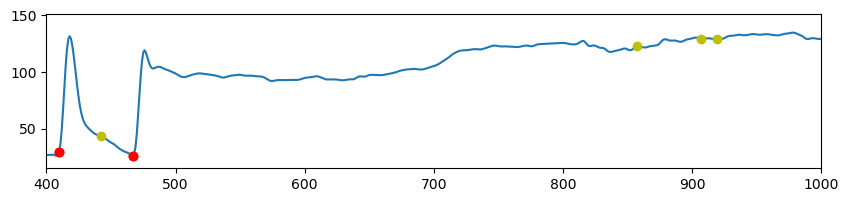

(6, 4)
(6, 4, [8, 85, 109, 367, 412, 567, 685, 775, 1004, 1028, 1042, 1197])
(6, 4, [412, 567, 685, 775])


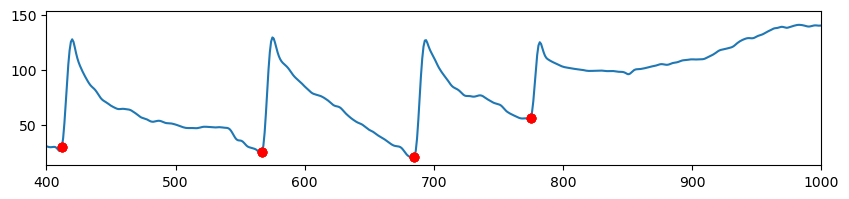

(6, 5)
(6, 5, [264, 445, 550, 710, 801, 919, 1043, 1120])
(6, 5, [445, 550, 710, 801, 919])


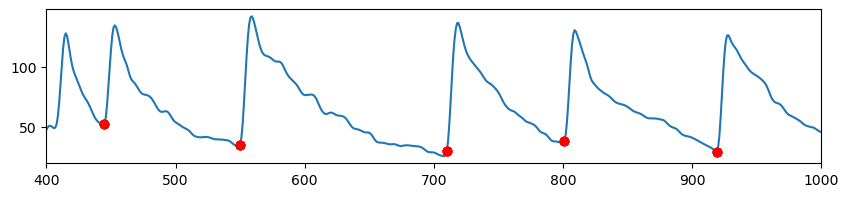

(6, 6)
(6, 6, [208, 281, 538, 829, 919, 1100])
(6, 6, [538, 829, 919])


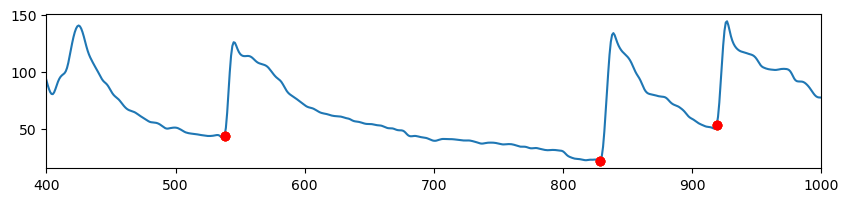

(6, 7)
(6, 7, [581, 854, 1010, 1062])
(6, 7, [581, 854])


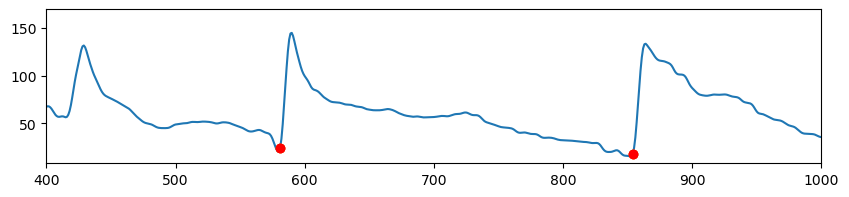

(6, 8)
(6, 8, [481, 510, 569, 1048, 1111, 1148, 1167, 1181, 1398])
(6, 8, [481])


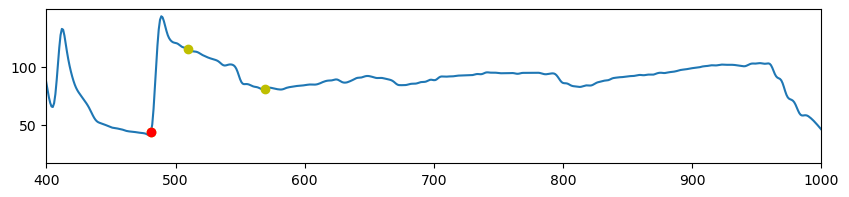

(6, 9)
(6, 9, [640, 1003, 1234, 1251])
(6, 9, [640])


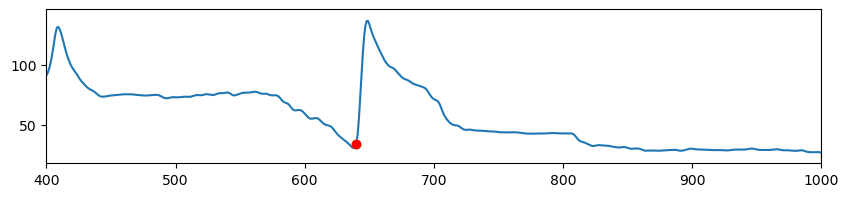

(6, 10)
(6, 10, [21, 36, 255, 315, 358, 444, 758, 953, 983, 1103])
(6, 10, [758])


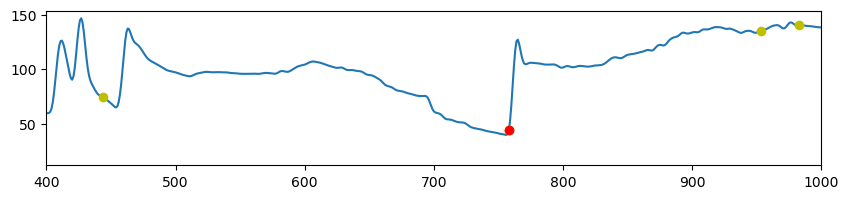

(7, 1)
(7, 1, [537, 657, 750, 860, 991, 1397])
(7, 1, [537, 657, 750, 860, 991])


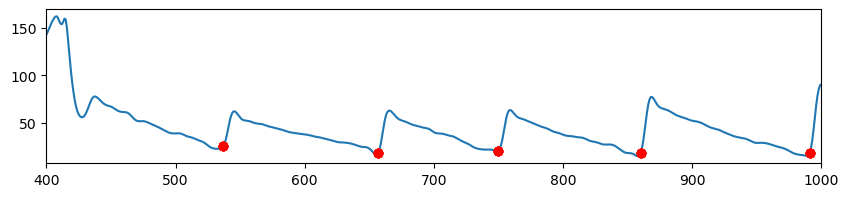

(7, 2)
(7, 2, [449, 632, 754, 953])
(7, 2, [632, 754, 953])


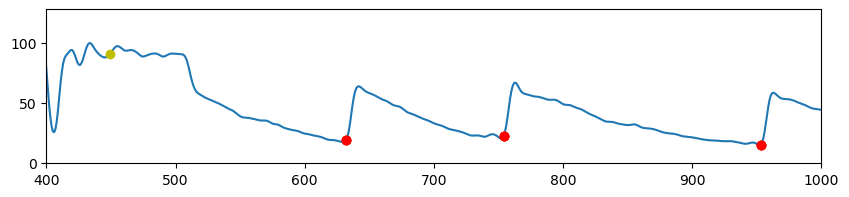

(7, 3)
(7, 3, [129, 404, 425, 604, 740, 765, 854, 943])
(7, 3, [404, 604, 765, 943])


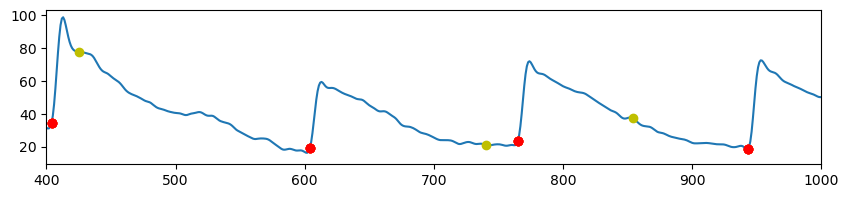

(7, 4)
(7, 4, [430, 454, 645, 799, 970])
(7, 4, [430, 645, 799, 970])


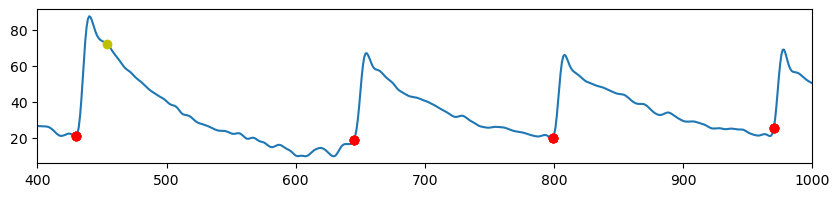

(7, 5)
(7, 5, [419, 569, 726, 867, 1134])
(7, 5, [419, 569, 726, 867])


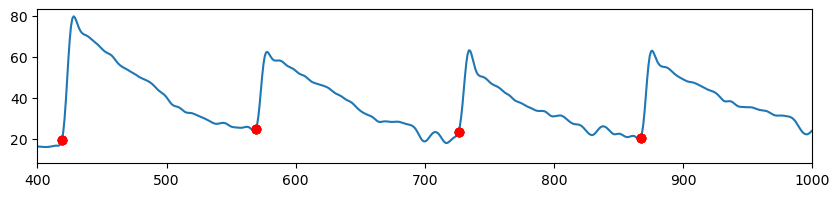

(7, 6)
(7, 6, [415, 582, 743, 897])
(7, 6, [415, 582, 743, 897])


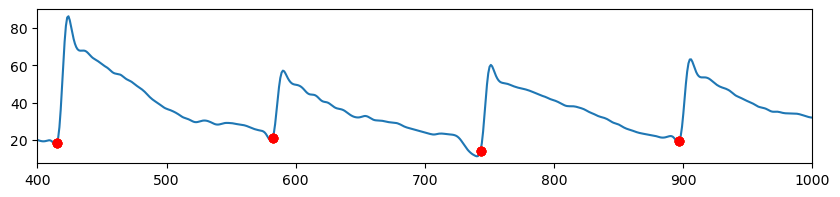

(7, 7)
(7, 7, [412, 530, 637, 796, 975])
(7, 7, [412, 530, 637, 796, 975])


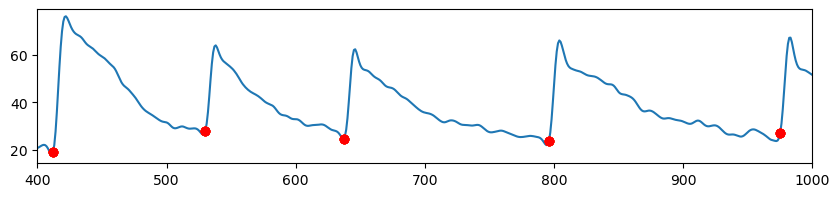

(7, 8)
(7, 8, [416, 578, 781, 1011])
(7, 8, [416, 578, 781])


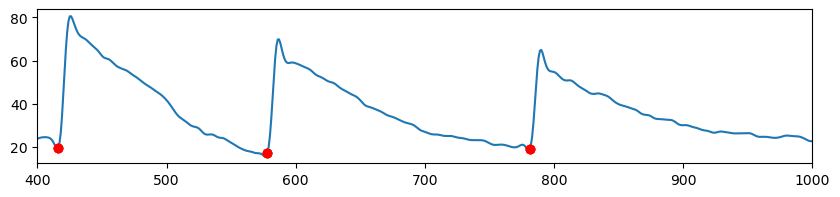

(7, 9)
(7, 9, [410, 540, 713, 917, 1397])
(7, 9, [410, 540, 713, 917])


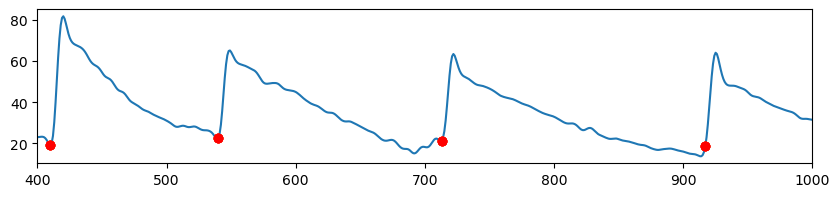

(7, 10)
(7, 10, [471, 686, 846, 914])
(7, 10, [471, 686, 914])


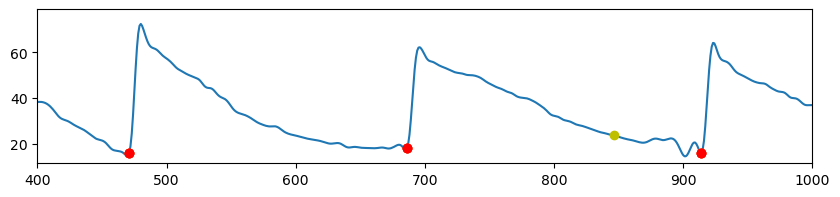

(1, 1)
(1, 1, [761])
(1, 1, [761])


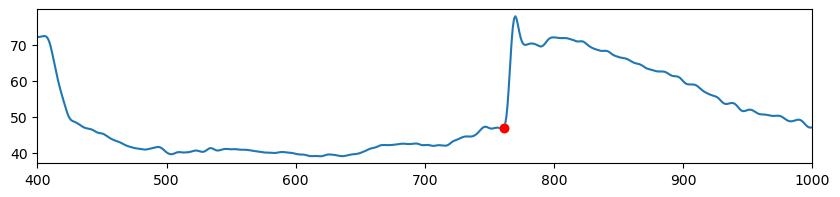

(1, 2)
(1, 2, [526])
(1, 2, [526])


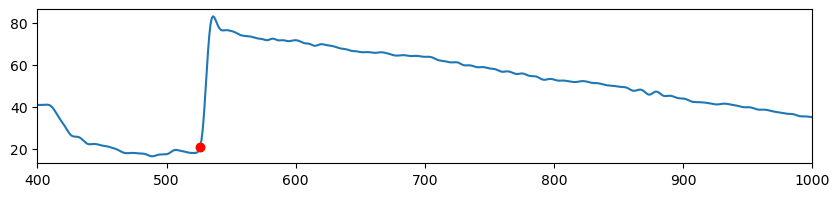

(1, 3)
(1, 3, [73, 254, 283, 711, 999])
(1, 3, [711, 999])


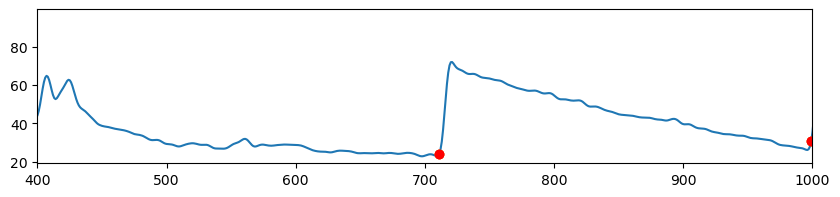

(1, 4)
(1, 4, [54, 248, 641, 883, 1397])
(1, 4, [641, 883])


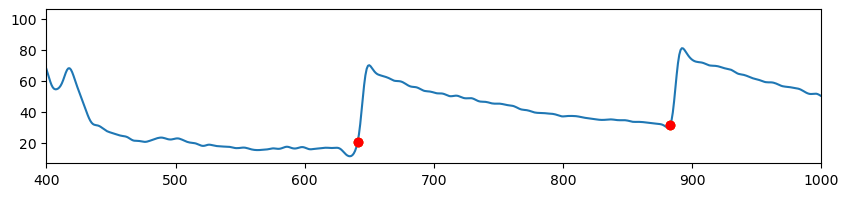

(1, 5)
(1, 5, [819])
(1, 5, [819])


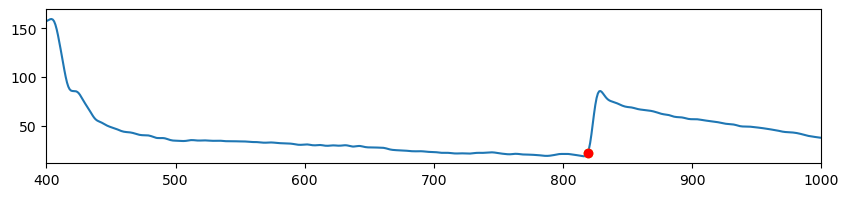

(1, 6)
(1, 6, [64, 278, 420, 671, 973])
(1, 6, [420, 671, 973])


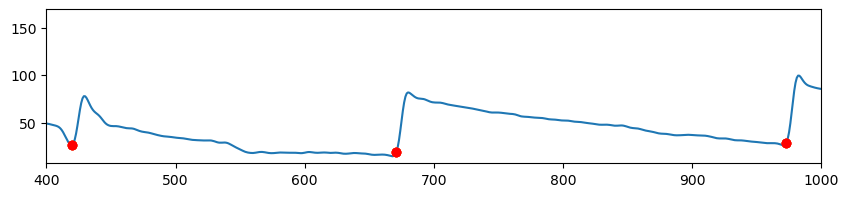

(1, 7)
(1, 7, [125, 629, 857, 1398])
(1, 7, [629, 857])


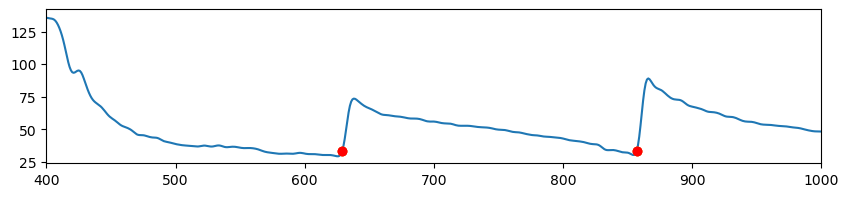

(1, 8)
(1, 8, [425, 457, 745, 882, 986])
(1, 8, [745, 882, 986])


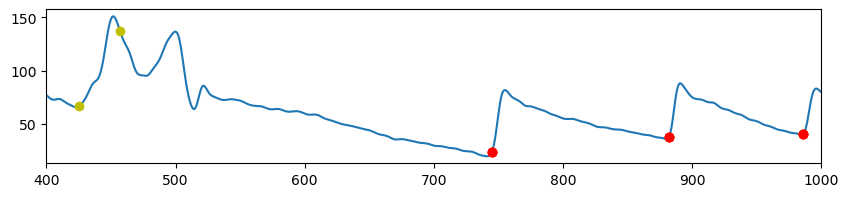

(1, 9)
(1, 9, [9, 22, 35, 49, 65, 94, 136, 230, 622, 832, 947])
(1, 9, [622, 832, 947])


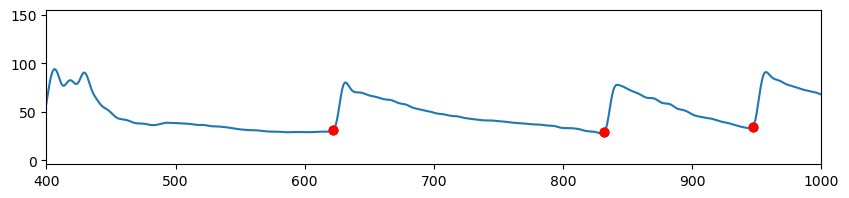

(1, 10)
(1, 10, [3, 200, 440, 613, 766, 907])
(1, 10, [440, 613, 766, 907])


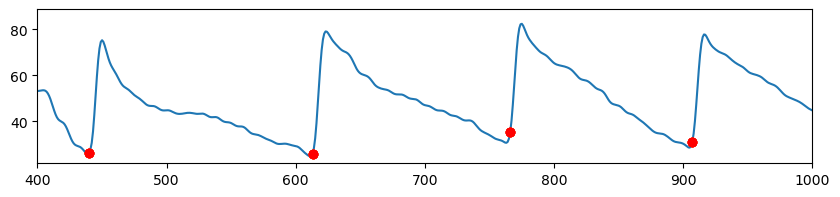

(2, 1)
(2, 1, [96, 159, 195, 234, 245, 262, 283, 292, 309, 338, 382, 402, 467, 561, 599, 649, 761, 847, 995, 1043])
(2, 1, [402, 467, 561, 599, 649, 761, 847, 995])


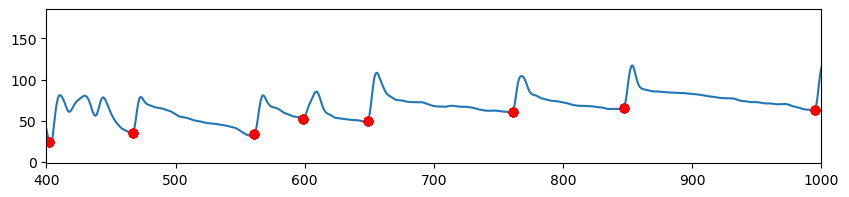

(2, 2)
(2, 2, [95, 109, 128, 543, 632, 748, 845, 973])
(2, 2, [543, 632, 748, 845])


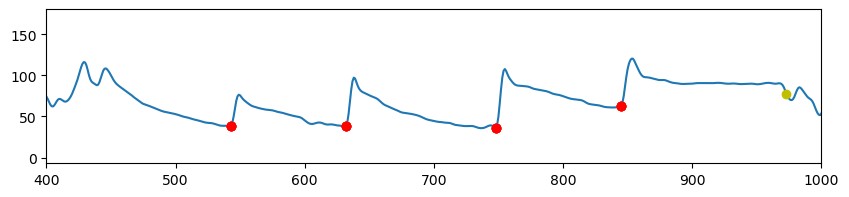

(2, 3)
(2, 3, [104, 155, 414, 582, 687, 842, 950, 1112, 1167, 1192, 1223, 1266, 1279])
(2, 3, [414, 582, 687, 842, 950])


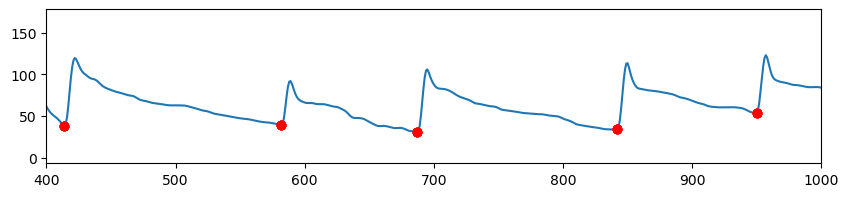

(2, 4)
(2, 4, [4, 42, 439, 456, 683, 848, 1096, 1177, 1270, 1299])
(2, 4, [456, 683, 848])


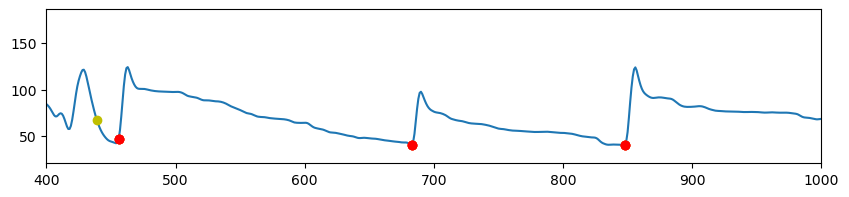

(2, 5)
(2, 5, [260, 360, 546, 770, 1058, 1093, 1126, 1230, 1372])
(2, 5, [546, 770])


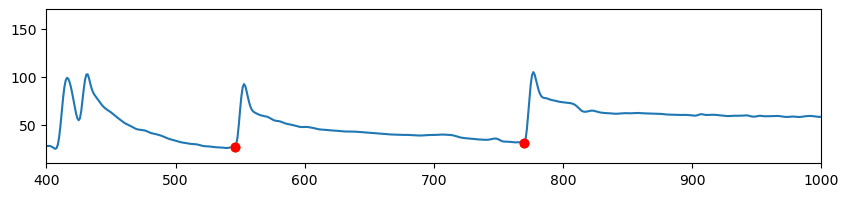

(2, 6)
(2, 6, [38, 82, 258, 522, 684, 1252, 1299, 1341, 1378])
(2, 6, [522, 684])


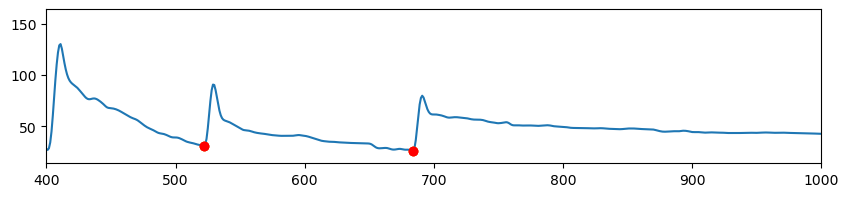

(2, 7)
(2, 7, [232, 369, 424, 587, 858, 1169, 1204, 1231, 1266, 1345])
(2, 7, [424, 587, 858])


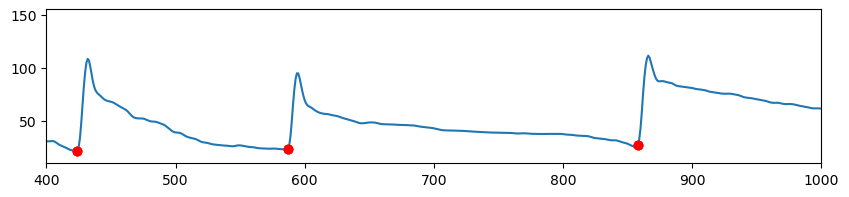

(2, 8)
(2, 8, [309, 347, 408, 485, 701, 939, 1039, 1080, 1272, 1304])
(2, 8, [408, 485, 701, 939])


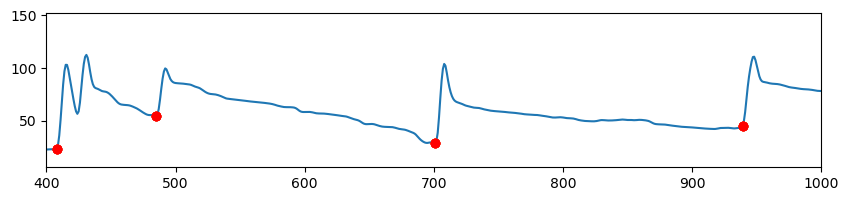

(2, 9)
(2, 9, [104, 571, 669, 930, 1201, 1253])
(2, 9, [571, 669, 930])


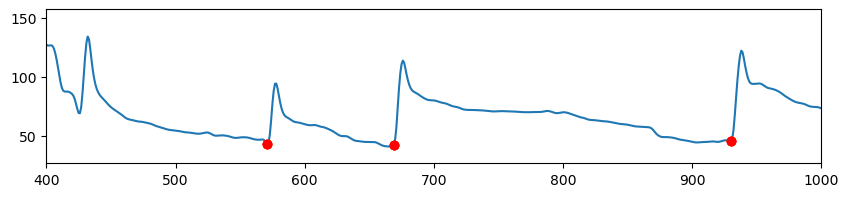

(2, 10)
(2, 10, [91, 135, 197, 225, 255, 624, 950, 1265, 1304, 1386])
(2, 10, [624, 950])


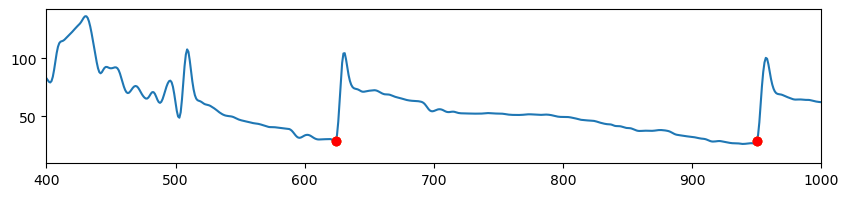

(3, 1)
(3, 1, [451, 663, 1037])
(3, 1, [451, 663])


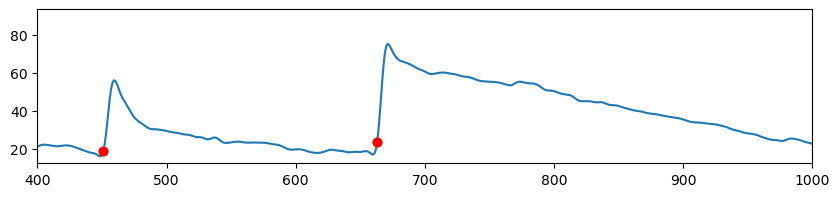

(3, 2)
(3, 2, [33, 101, 146, 323, 345, 450, 597, 823, 1398])
(3, 2, [597, 823])


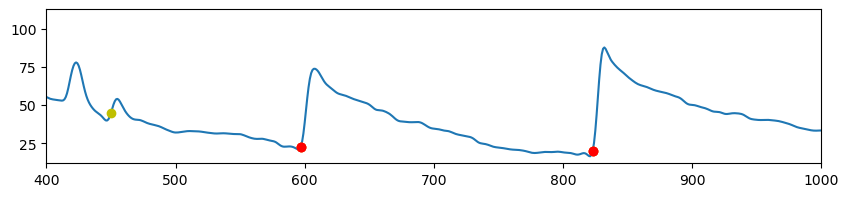

(3, 3)
(3, 3, [351, 406, 631, 854])
(3, 3, [406, 631, 854])


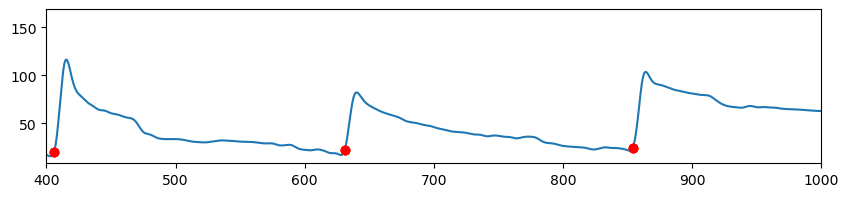

(3, 4)
(3, 4, [460, 619, 998])
(3, 4, [460, 619, 998])


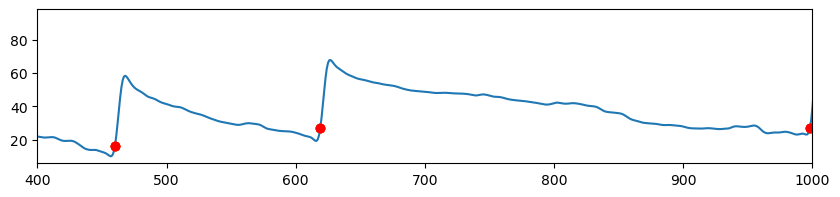

(3, 5)
(3, 5, [450, 706])
(3, 5, [450, 706])


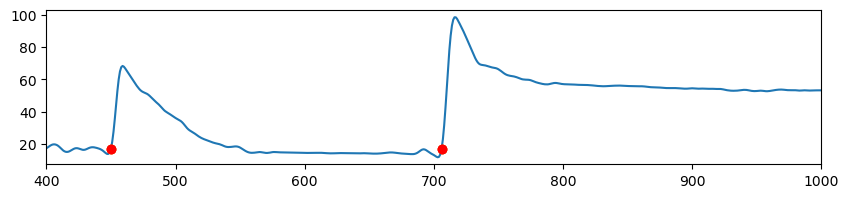

(3, 6)
(3, 6, [404, 806])
(3, 6, [404, 806])


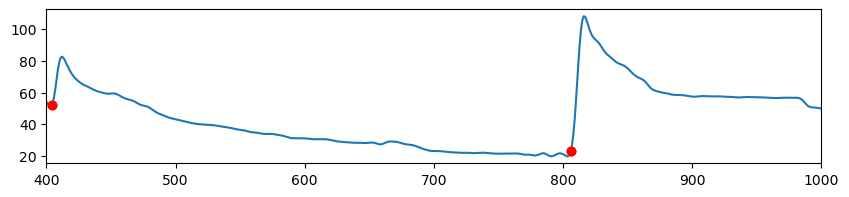

(3, 7)
(3, 7, [198, 287, 320, 376, 428, 858, 1398])
(3, 7, [428, 858])


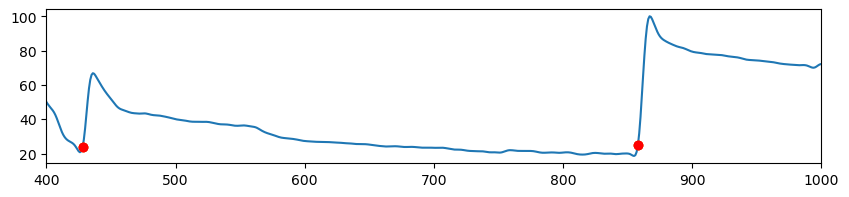

(3, 8)
(3, 8, [551, 754, 1184, 1355, 1375])
(3, 8, [551, 754])


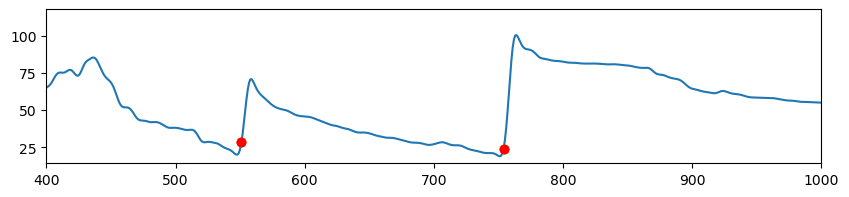

(3, 9)
(3, 9, [250, 287, 340, 454, 638, 996, 1399])
(3, 9, [454, 638, 996])


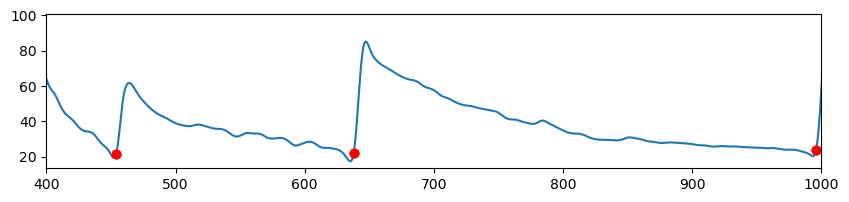

(3, 10)
(3, 10, [21, 93, 524, 857])
(3, 10, [524, 857])


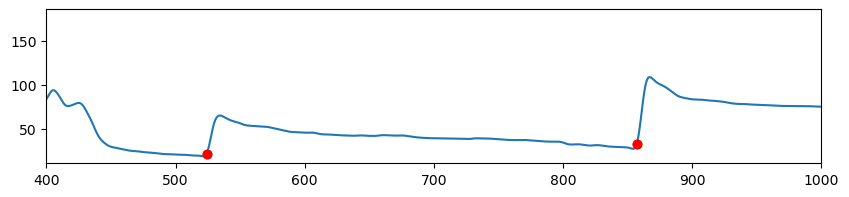

(4, 1)
(4, 1, [4, 98, 149, 241, 302, 389, 458, 539, 595, 660, 777, 879])
(4, 1, [458, 539, 595, 660, 777, 879])


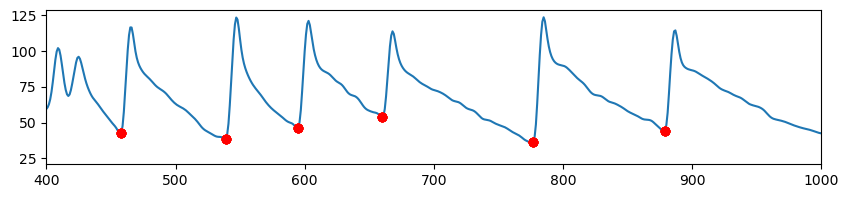

(4, 2)
(4, 2, [411, 455, 544, 617, 702, 776, 899])
(4, 2, [411, 455, 544, 617, 702, 776, 899])


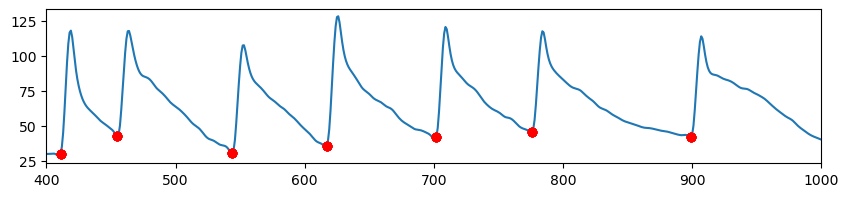

(4, 3)
(4, 3, [434, 528, 616, 723, 881, 1008, 1205, 1257, 1324, 1361])
(4, 3, [434, 528, 616, 723, 881])


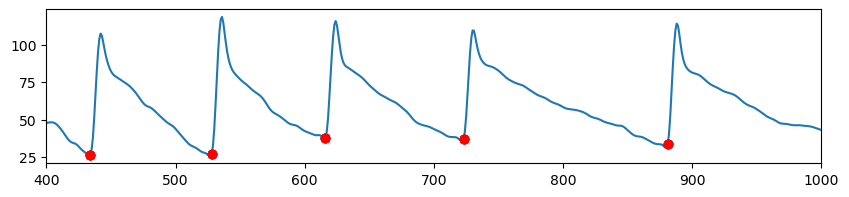

(4, 4)
(4, 4, [6, 88, 132, 160, 207, 244, 291, 390, 410, 467, 514, 597, 728, 853, 932])
(4, 4, [467, 514, 597, 728, 853, 932])


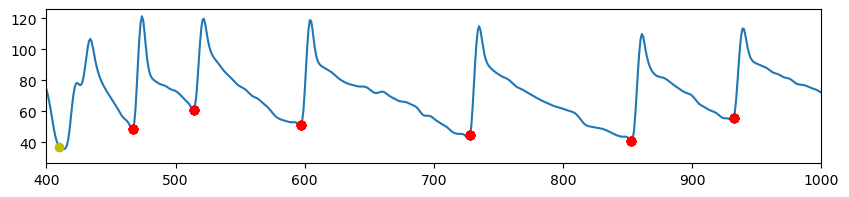

(4, 5)
(4, 5, [46, 230, 437, 501, 546, 647, 702, 833, 990])
(4, 5, [437, 501, 546, 647, 702, 833, 990])


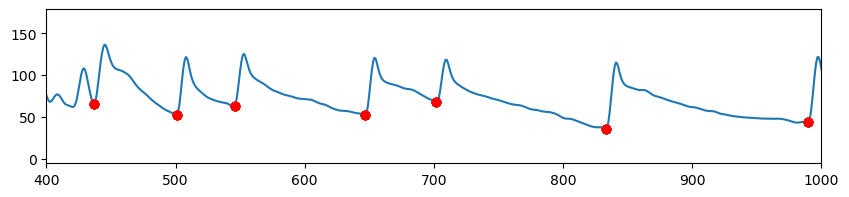

(4, 6)
(4, 6, [445, 502, 573, 642, 717, 840, 914])
(4, 6, [445, 502, 573, 642, 717, 840, 914])


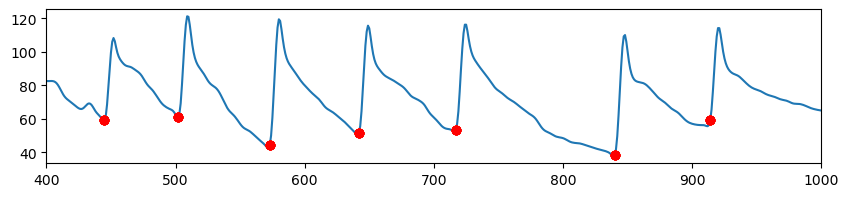

(4, 7)
(4, 7, [442, 525, 665, 773, 952])
(4, 7, [442, 525, 665, 773, 952])


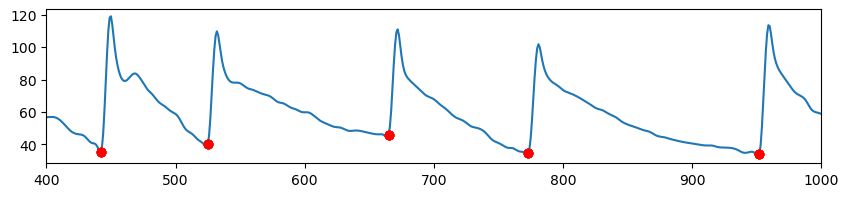

(4, 8)
(4, 8, [372, 411, 460, 572, 660, 805, 933, 1398])
(4, 8, [411, 460, 572, 660, 805, 933])


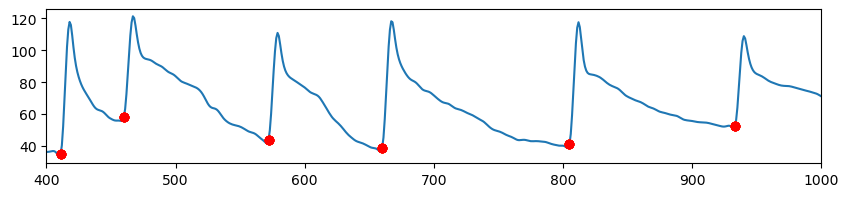

(4, 9)
(4, 9, [41, 183, 215, 300, 324, 406, 508, 560, 647, 792, 974, 1399])
(4, 9, [508, 560, 647, 792, 974])


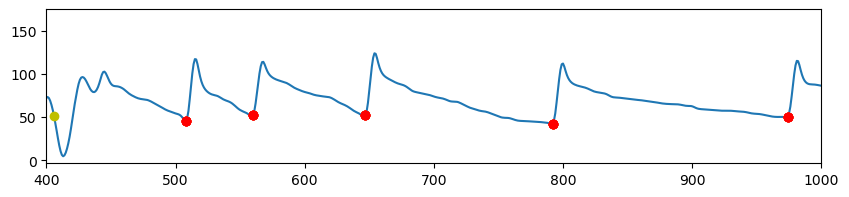

(4, 10)
(4, 10, [116, 164, 217, 271, 287, 398, 500, 550, 629, 704, 862])
(4, 10, [500, 550, 629, 704, 862])


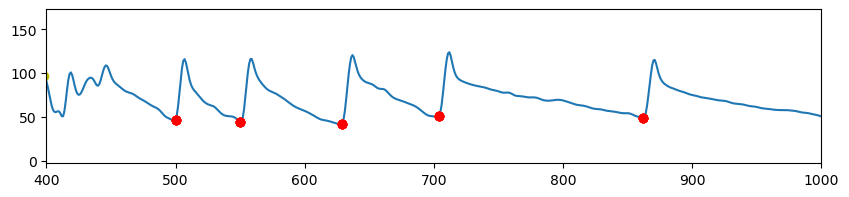

(5, 1)
(5, 1, [502, 566, 674, 811])
(5, 1, [502, 566, 674, 811])


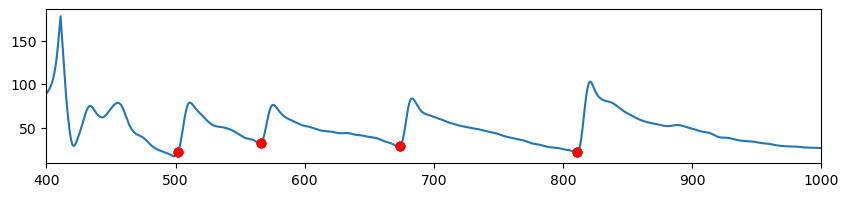

(5, 2)
(5, 2, [212, 539, 633, 799])
(5, 2, [539, 633, 799])


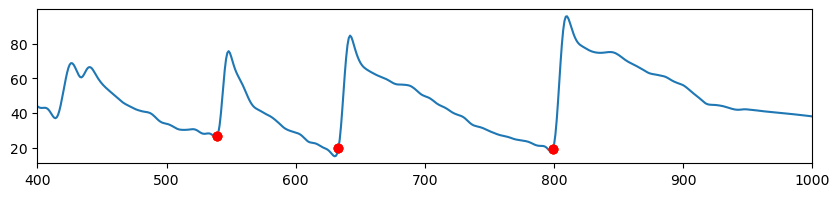

(5, 3)
(5, 3, [405, 473, 597, 918])
(5, 3, [405, 473, 597, 918])


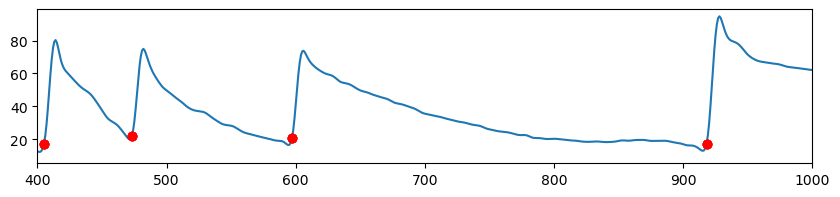

(5, 4)
(5, 4, [467, 579, 753, 1009])
(5, 4, [467, 579, 753])


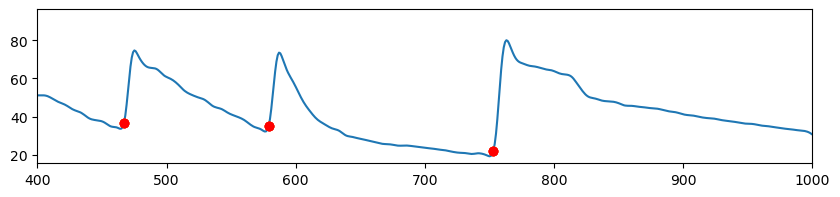

(5, 5)
(5, 5, [520, 857])
(5, 5, [520, 857])


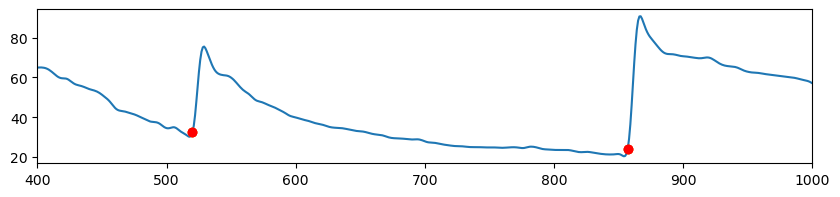

(5, 6)
(5, 6, [455, 551, 690])
(5, 6, [455, 551, 690])


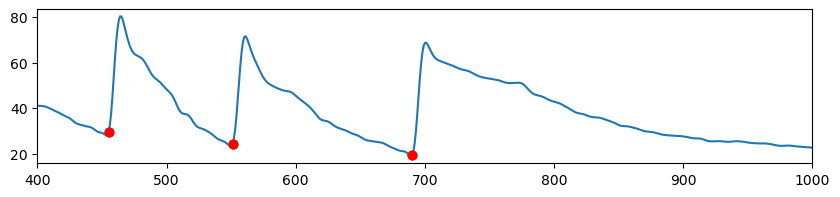

(5, 7)
(5, 7, [426, 543, 754])
(5, 7, [426, 543, 754])


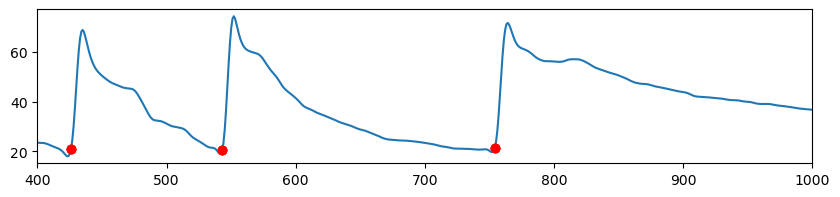

(5, 8)
(5, 8, [434, 578, 702, 996])
(5, 8, [434, 578, 702, 996])


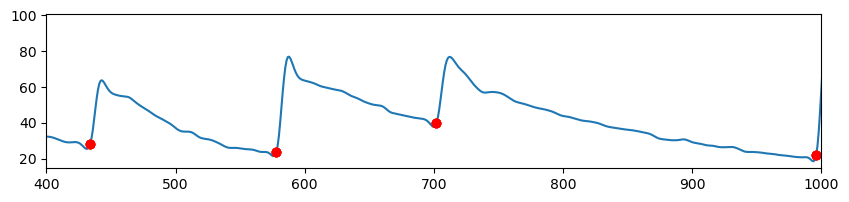

(5, 9)
(5, 9, [467, 604])
(5, 9, [467, 604])


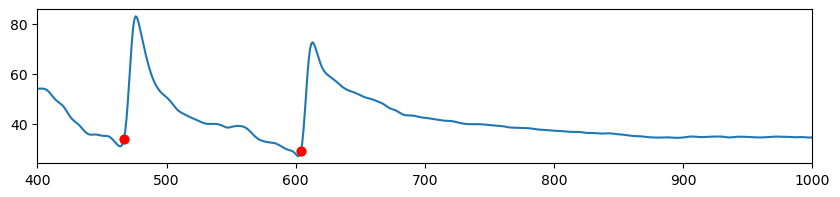

(5, 10)
(5, 10, [414, 562, 766])
(5, 10, [414, 562, 766])


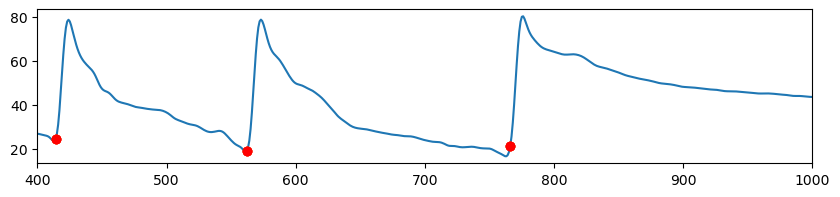

(6, 1)
(6, 1, [327, 408, 464, 851, 917, 931, 1063, 1074, 1102, 1157, 1202, 1250, 1273, 1316])
(6, 1, [408, 464, 851, 917, 931])


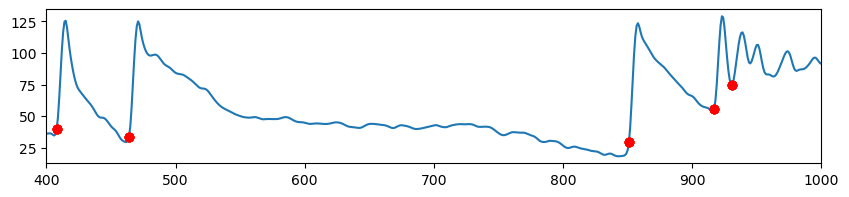

(6, 2)
(6, 2, [1, 194, 211, 394, 427, 473, 603, 701, 833, 981, 1086, 1105, 1162])
(6, 2, [427, 473, 603, 701, 833, 981])


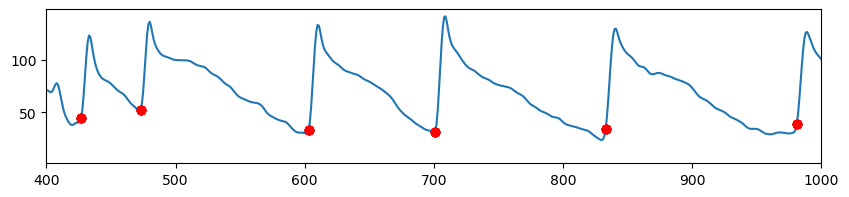

(6, 3)
(6, 3, [41, 83, 248, 487, 986, 1009, 1033, 1078])
(6, 3, [487])


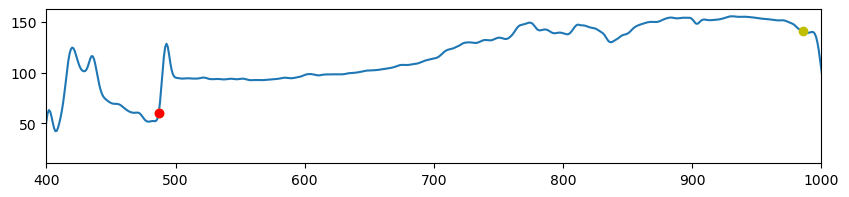

(6, 4)
(6, 4, [47, 63, 74, 93, 119, 391, 438, 460, 629, 742, 1024, 1057, 1073, 1172, 1191, 1227, 1382])
(6, 4, [438, 460, 629, 742])


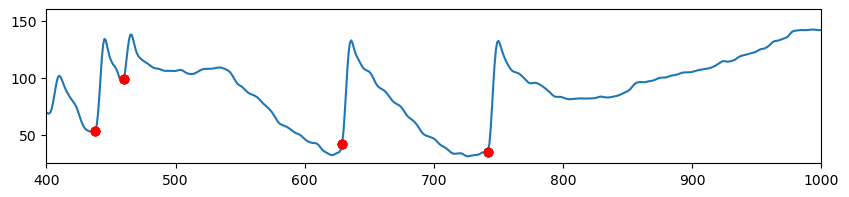

(6, 5)
(6, 5, [229, 290, 459, 627, 769, 888, 1078, 1097, 1126])
(6, 5, [459, 627, 769, 888])


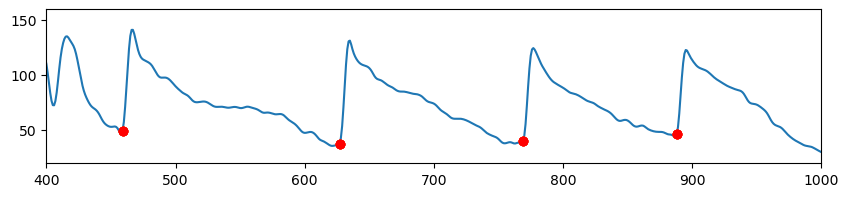

(6, 6)
(6, 6, [475, 702, 759, 959, 1118, 1137, 1152, 1351, 1387])
(6, 6, [475, 702, 959])


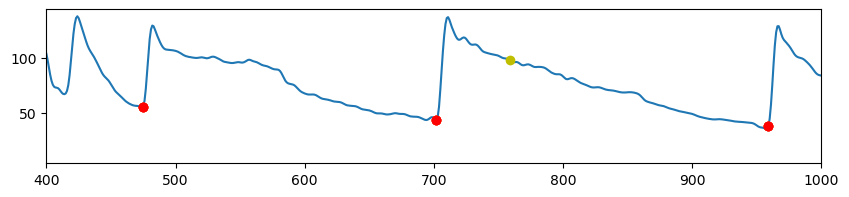

(6, 7)
(6, 7, [598, 724, 915, 1029, 1065, 1084, 1155, 1222])
(6, 7, [598, 724, 915])


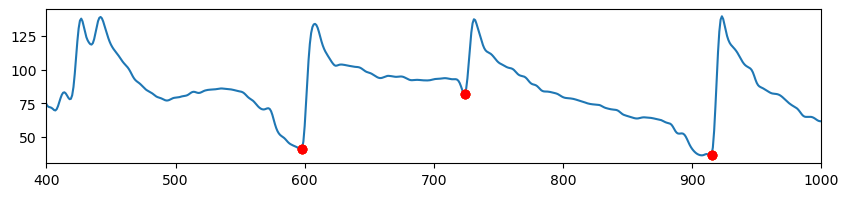

(6, 8)
(6, 8, [432, 544, 976, 1063, 1118, 1147, 1176, 1202, 1230, 1254, 1357])
(6, 8, [432, 544, 976])


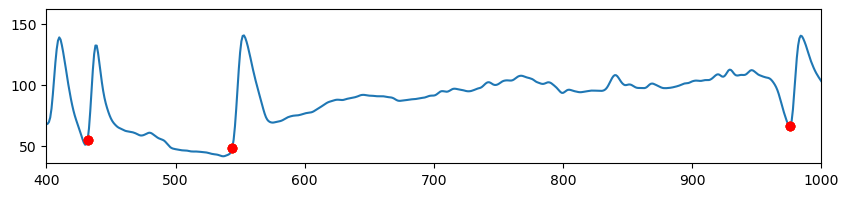

(6, 9)
(6, 9, [426, 659, 1106, 1123, 1153, 1241, 1256])
(6, 9, [426, 659])


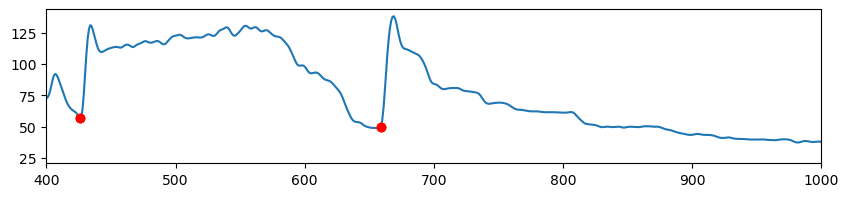

(6, 10)
(6, 10, [601, 617, 627, 701, 996, 1026, 1077, 1110, 1359])
(6, 10, [701])


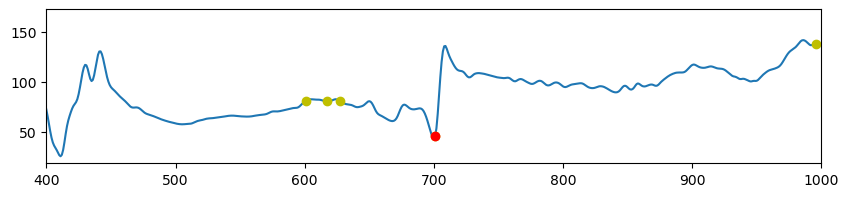

(7, 1)
(7, 1, [430, 501, 633, 717, 788, 813, 920, 974, 1066, 1101, 1116, 1135, 1211, 1225, 1329, 1377, 1394])
(7, 1, [501, 633, 717, 813, 920])


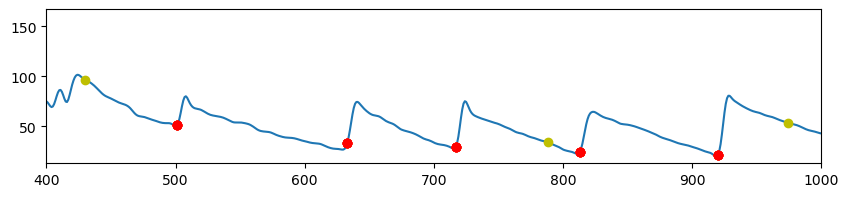

(7, 2)
(7, 2, [457, 553, 673, 816, 1002, 1244])
(7, 2, [673, 816])


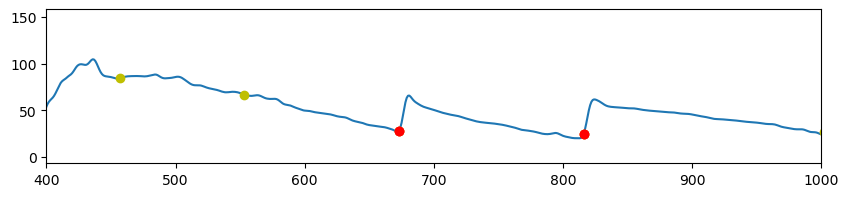

(7, 3)
(7, 3, [108, 166, 407, 572, 786, 965])
(7, 3, [407, 572, 786, 965])


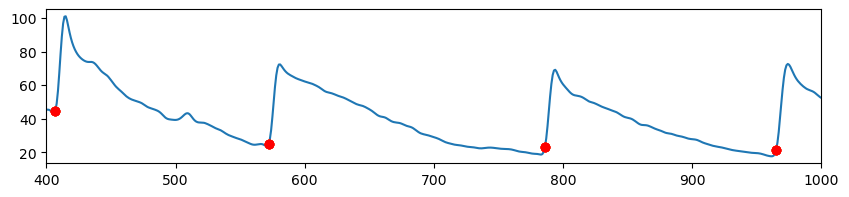

(7, 4)
(7, 4, [444, 666, 839, 989])
(7, 4, [444, 666, 839, 989])


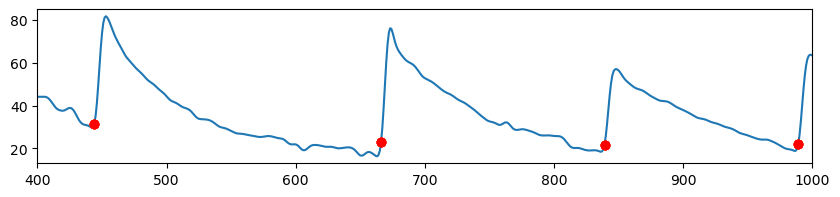

(7, 5)
(7, 5, [435, 593, 687, 810, 983])
(7, 5, [435, 593, 687, 810, 983])


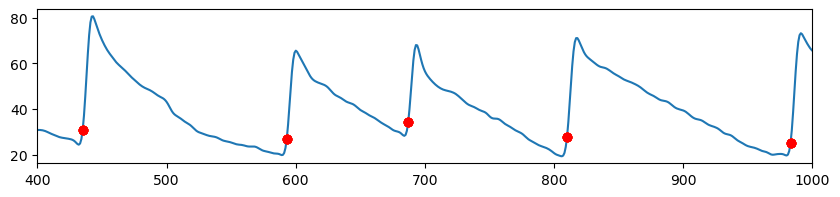

(7, 6)
(7, 6, [444, 565, 677, 738, 831, 921])
(7, 6, [444, 565, 677, 831, 921])


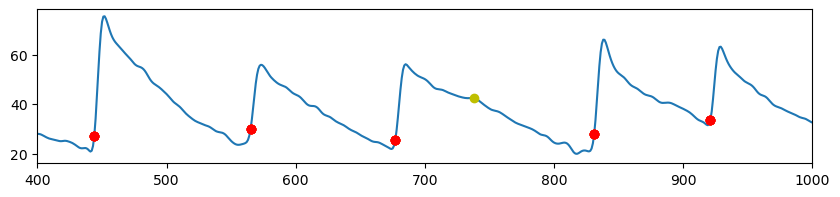

(7, 7)
(7, 7, [423, 558, 690, 846, 997])
(7, 7, [423, 558, 690, 846, 997])


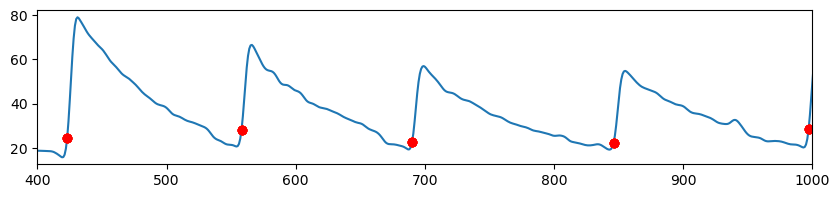

(7, 8)
(7, 8, [444, 618, 802, 1102])
(7, 8, [444, 618, 802])


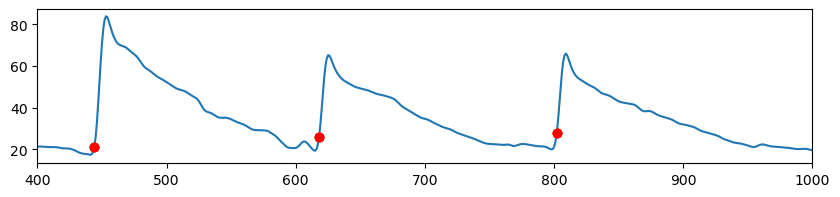

(7, 9)
(7, 9, [456, 619, 744, 872, 1024])
(7, 9, [456, 619, 744, 872])


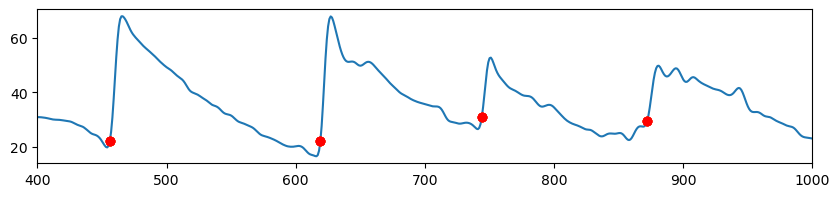

(7, 10)
(7, 10, [416, 532, 734, 936])
(7, 10, [416, 532, 734, 936])


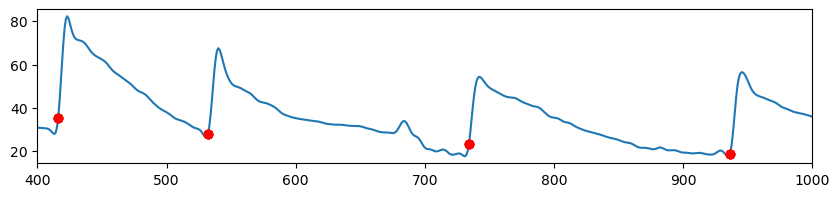

In [ ]:
reset_ang_MDN_R3, swing_count_MDN_R3, swing_ts_MDN_R3 = get_reset_ang_Hleg(MDN, 'R3')
reset_ang_MDN_L3, swing_count_MDN_L3, swing_ts_MDN_L3 = get_reset_ang_Hleg(MDN, 'L3')

(2, 1)
(2, 1, [34, 87, 448, 511])
(2, 1, [511])


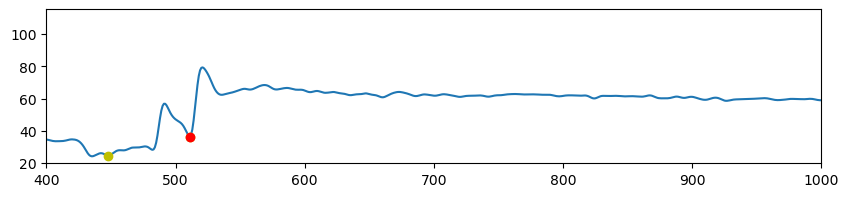

(2, 2)
(2, 2, [421, 468, 483, 558, 603])
(2, 2, [421, 468, 483, 558, 603])


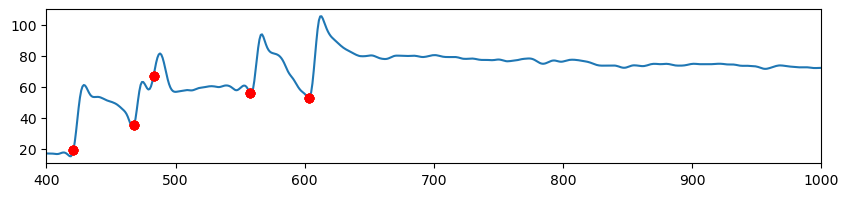

(2, 3)
(2, 3, [6, 60, 132, 173, 231, 258, 318, 387, 462, 504, 1329, 1373])
(2, 3, [462, 504])


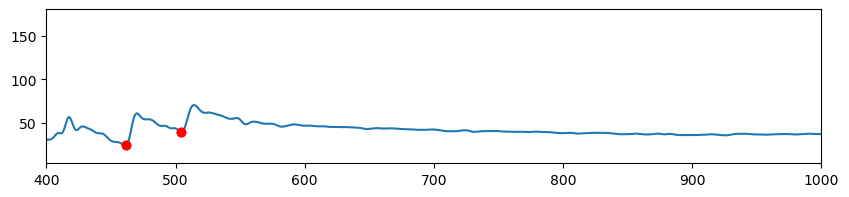

(2, 4)
(2, 4, [104, 145, 283, 425, 716, 797, 828, 897, 1307, 1327, 1363])
(2, 4, [425, 716, 797, 828, 897])


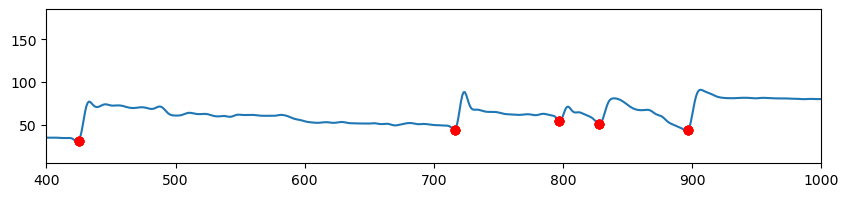

(2, 5)
(2, 5, [463, 504, 540, 643, 710, 805])
(2, 5, [463, 643, 710, 805])


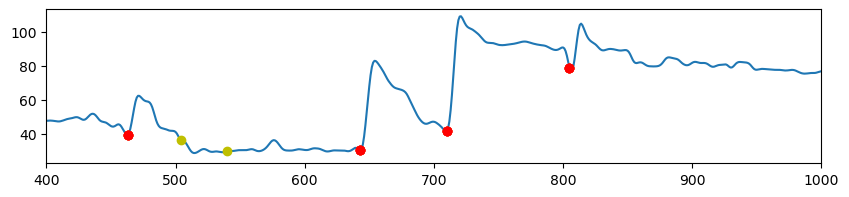

(2, 6)
(2, 6, [398, 843, 1307])
(2, 6, [843])


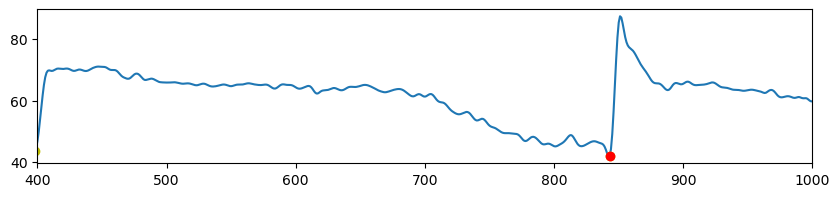

(2, 7)
(2, 7, [61, 453, 832, 1398])
(2, 7, [832])


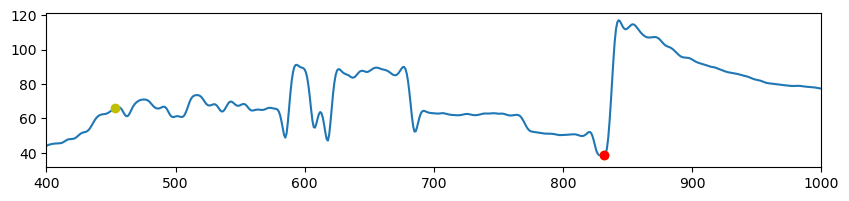

(2, 8)
(2, 8, [212, 245, 278, 516, 558, 613, 817, 930])
(2, 8, [516, 558, 613, 817, 930])


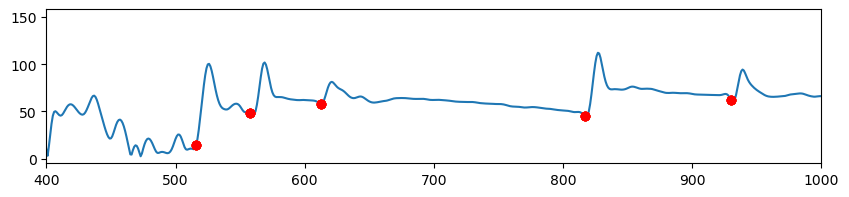

(2, 9)
(2, 9, [294, 480, 503, 557, 661, 742, 754, 1129, 1399])
(2, 9, [])


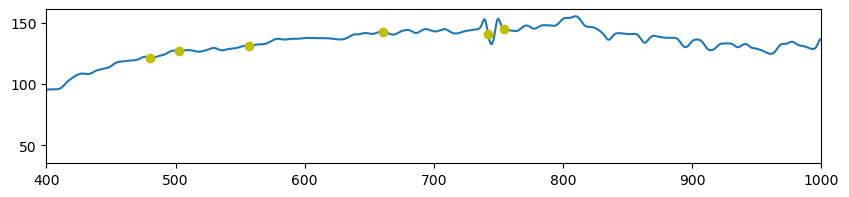

(2, 10)
(2, 10, [385, 470, 490, 531, 554, 641, 653, 741])
(2, 10, [470, 490, 641, 653, 741])


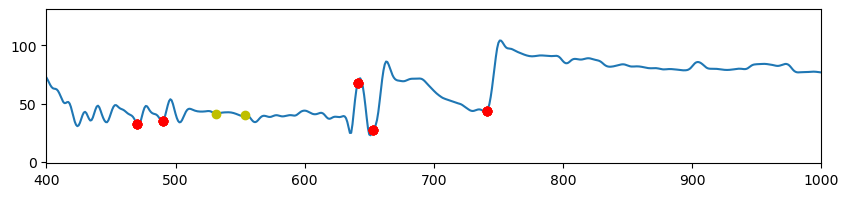

(3, 1)
(3, 1, [480, 538, 767])
(3, 1, [480, 538, 767])


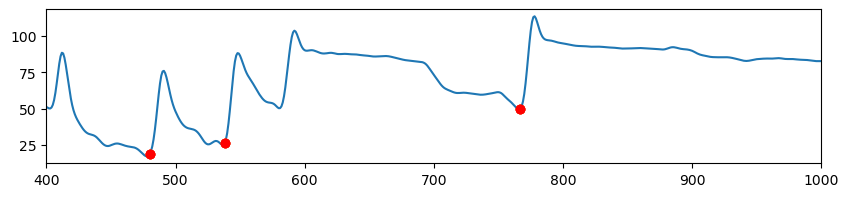

(3, 2)
(3, 2, [516, 571, 1116])
(3, 2, [516, 571])


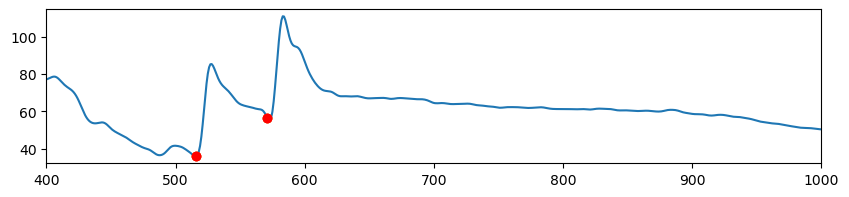

(3, 3)
(3, 3, [539, 783])
(3, 3, [539])


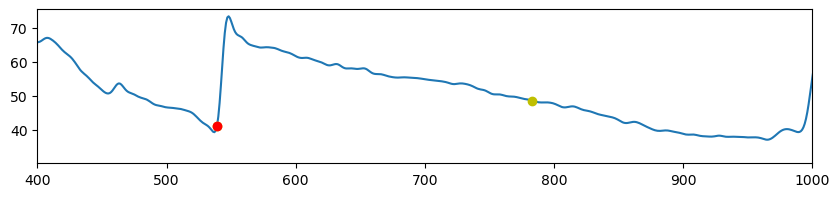

(3, 4)
(3, 4, [11, 100, 355, 414, 460, 491, 737, 958, 998, 1067, 1113, 1212])
(3, 4, [414, 460])


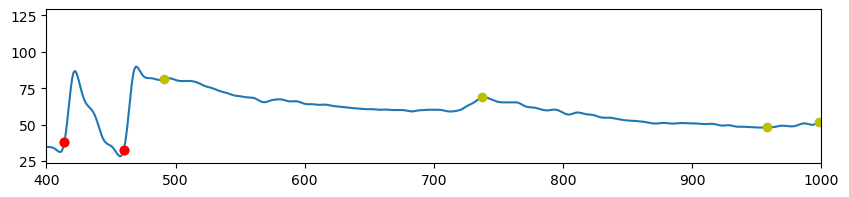

(3, 5)
(3, 5, [489, 672, 697, 860, 885])
(3, 5, [489, 672, 860, 885])


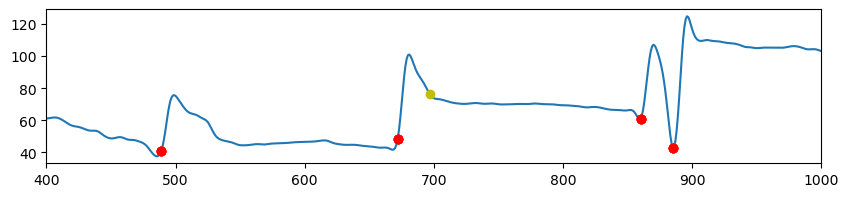

(3, 6)
(3, 6, [660, 959, 988, 1007])
(3, 6, [959])


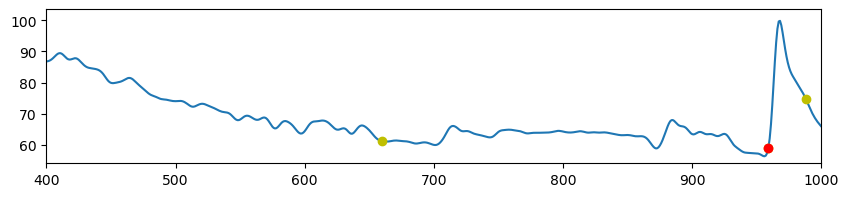

(3, 7)
(3, 7, [544, 566, 610, 813])
(3, 7, [544, 813])


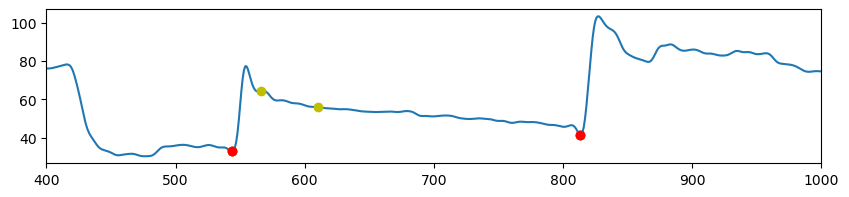

(3, 8)
(3, 8, [429, 579, 1215, 1396])
(3, 8, [429, 579])


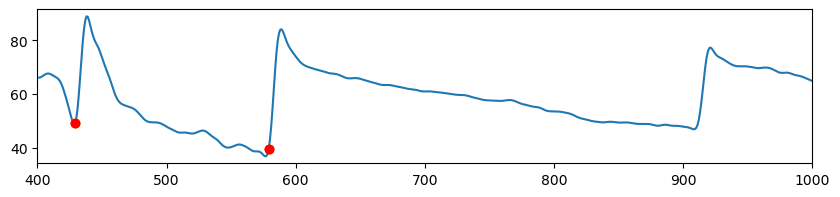

(3, 9)
(3, 9, [479, 504, 526, 625])
(3, 9, [479])


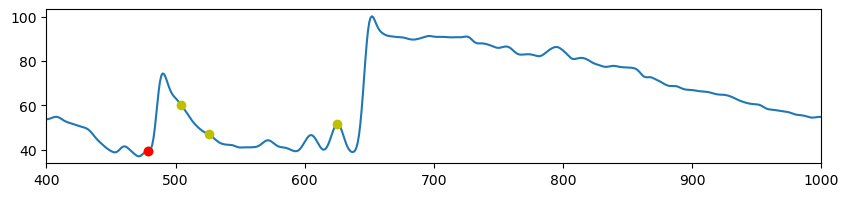

(3, 10)
(3, 10, [459, 507, 944, 1004, 1043])
(3, 10, [459, 507, 944])


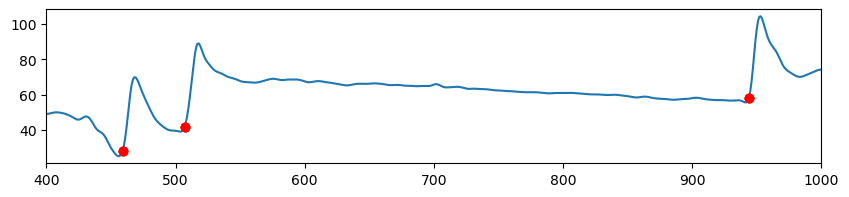

(5, 1)
(5, 1, [18, 558, 800])
(5, 1, [558])


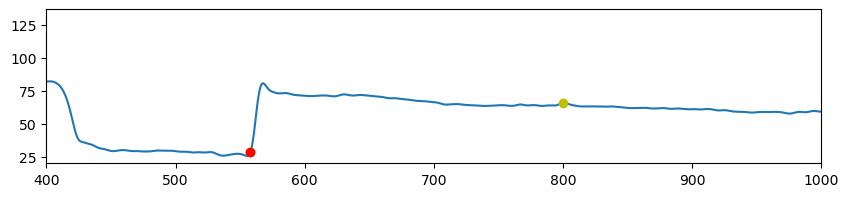

(5, 2)
no swing found


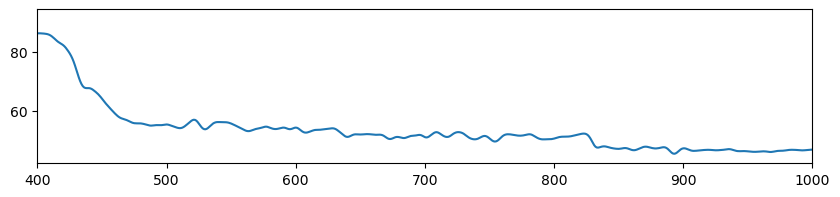

(5, 3)
(5, 3, [929])
(5, 3, [929])


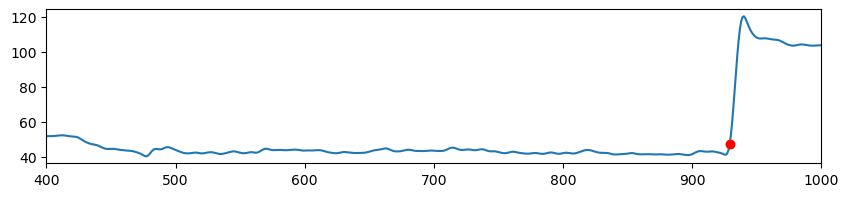

(5, 4)
(5, 4, [797, 890, 1014, 1068, 1126])
(5, 4, [797])


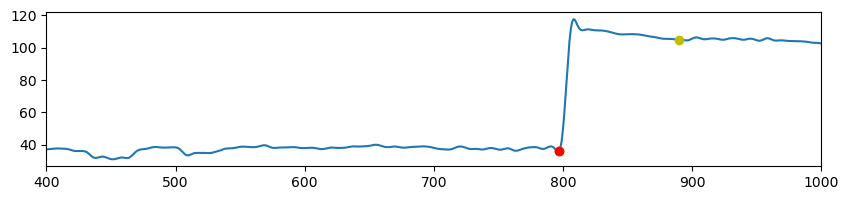

(5, 5)
(5, 5, [63, 363, 378, 405, 747, 968])
(5, 5, [])


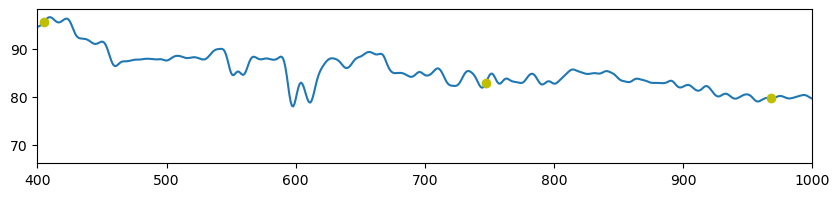

(5, 6)
(5, 6, [239, 690, 703, 750])
(5, 6, [])


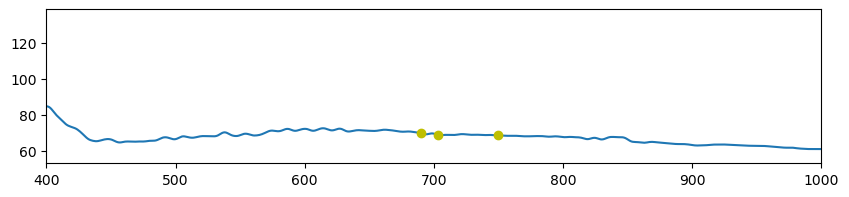

(5, 7)
no swing found


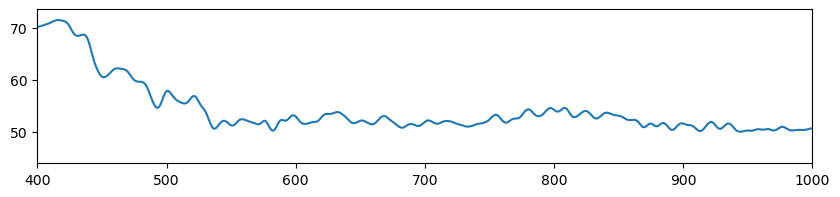

(5, 8)
(5, 8, [773, 788, 872, 885, 1105])
(5, 8, [773])


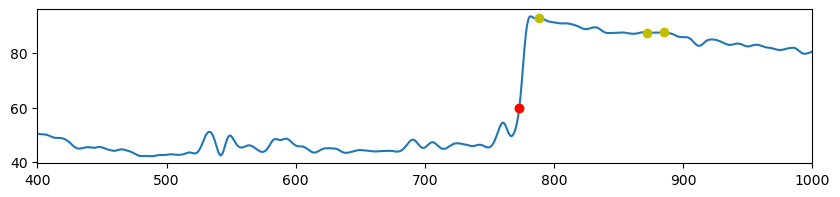

(5, 9)
no swing found


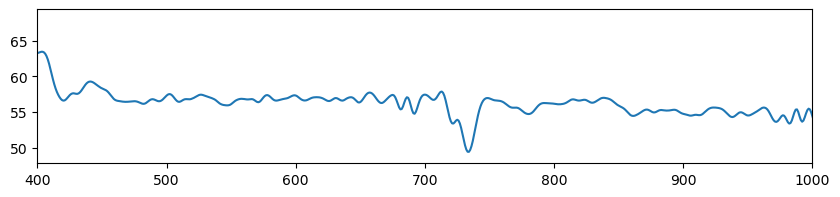

(5, 10)
no swing found


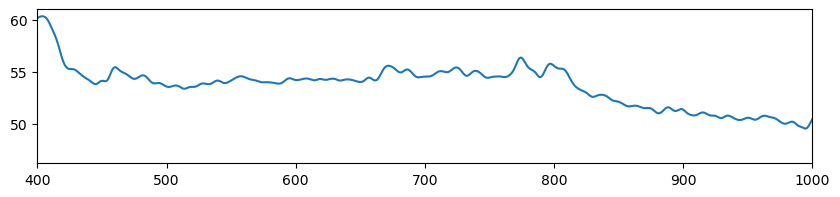

(6, 1)
(6, 1, [454])
(6, 1, [454])


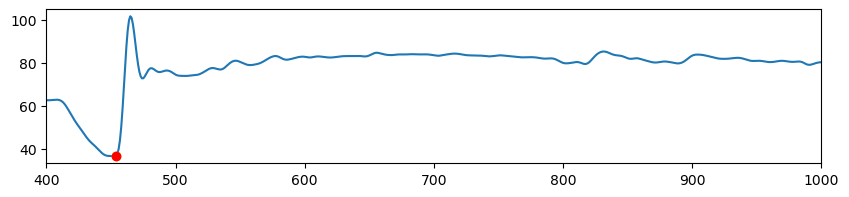

(6, 2)
(6, 2, [484, 540, 897, 928, 967, 1025])
(6, 2, [])


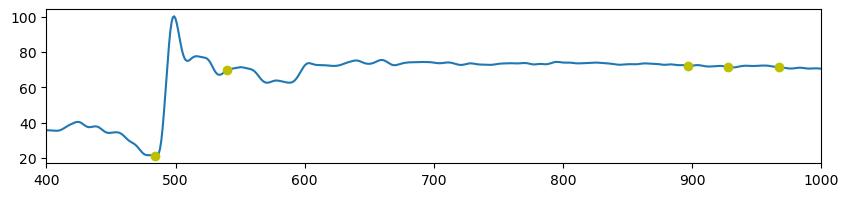

(6, 3)
(6, 3, [424])
(6, 3, [424])


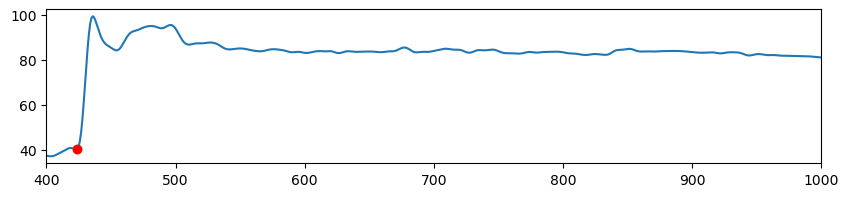

(6, 4)
(6, 4, [535, 962])
(6, 4, [535])


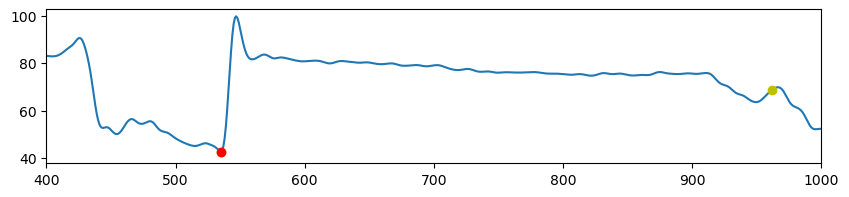

(6, 5)
(6, 5, [491, 906, 1045])
(6, 5, [491])


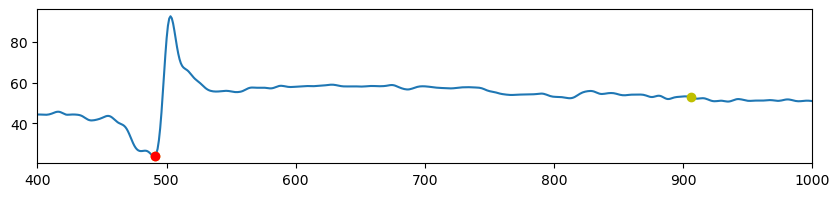

(6, 6)
(6, 6, [567])
(6, 6, [567])


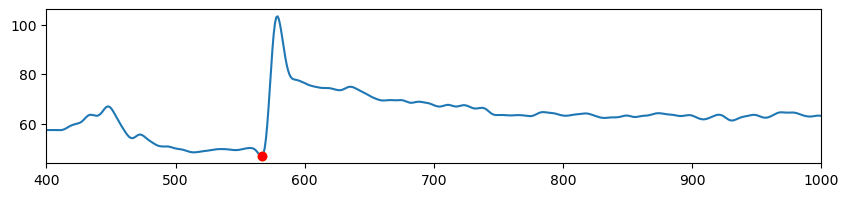

(6, 7)
(6, 7, [573, 1397])
(6, 7, [573])


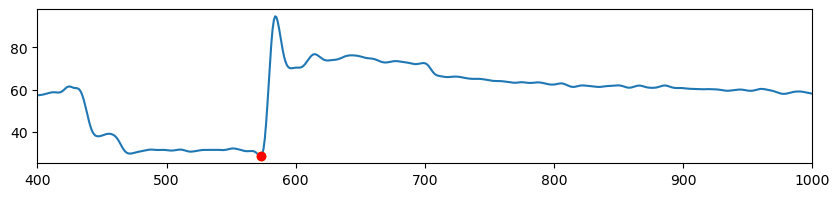

(6, 8)
(6, 8, [127, 193, 324, 350, 362, 709])
(6, 8, [709])


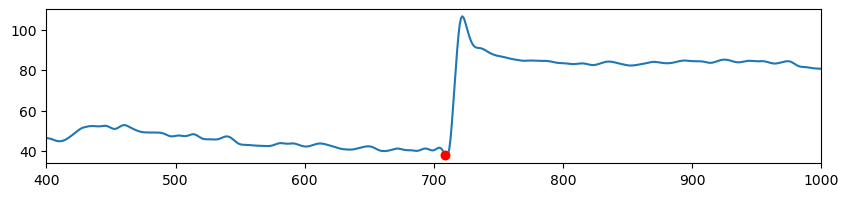

(6, 9)
no swing found


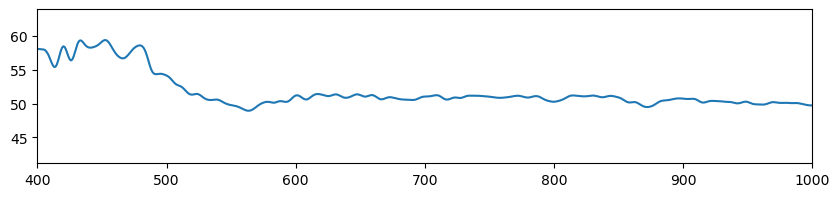

(6, 10)
(6, 10, [410])
(6, 10, [410])


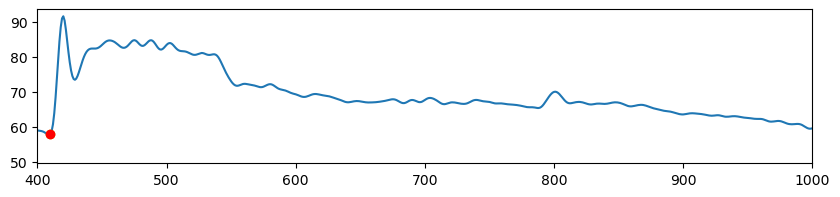

(7, 1)
(7, 1, [62, 119, 261, 426, 446, 559])
(7, 1, [446, 559])


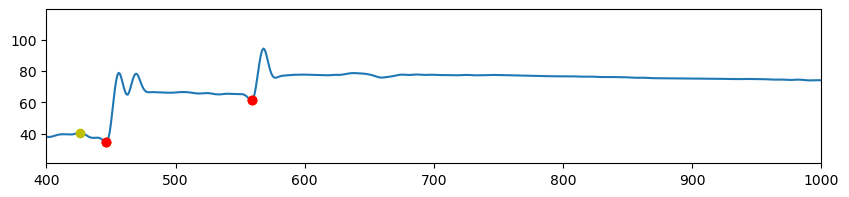

(7, 2)
(7, 2, [34, 127, 370])
(7, 2, [])


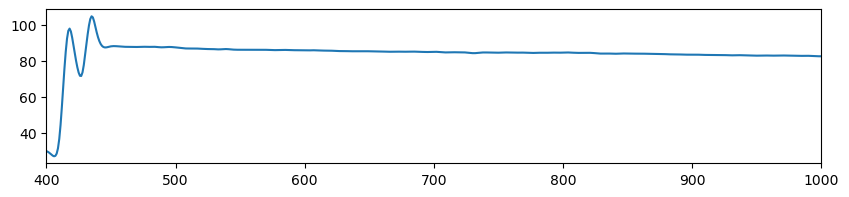

(7, 3)
(7, 3, [52, 161, 268, 437])
(7, 3, [437])


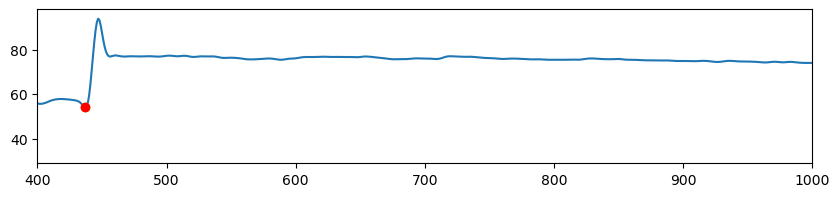

(7, 4)
(7, 4, [67, 166, 196, 353, 377, 408, 546, 739])
(7, 4, [408, 546, 739])


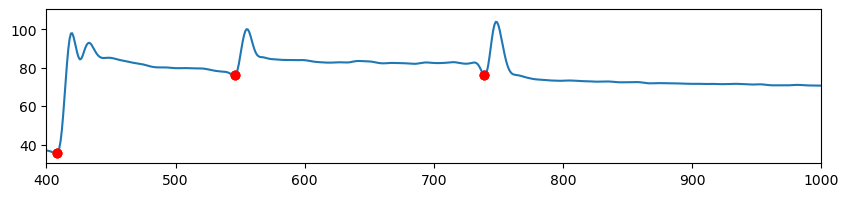

(7, 5)
(7, 5, [18, 155, 313, 430, 453, 495, 549, 603])
(7, 5, [430])


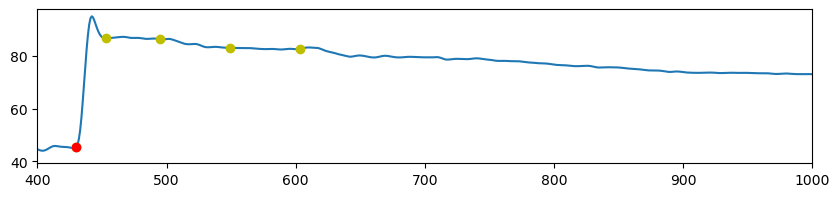

(7, 6)
(7, 6, [101, 306, 337, 441, 1085, 1109, 1359])
(7, 6, [441])


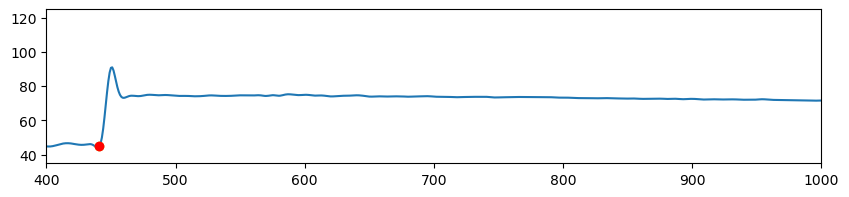

(7, 7)
(7, 7, [112, 180, 430])
(7, 7, [430])


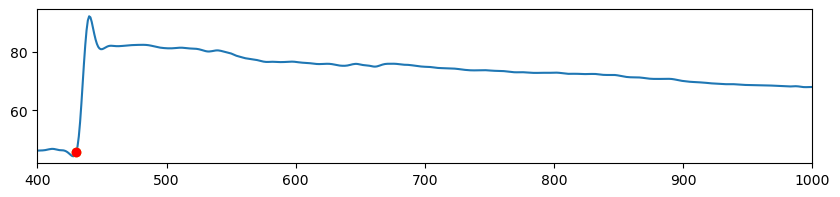

(7, 8)
(7, 8, [220, 435, 1399])
(7, 8, [435])


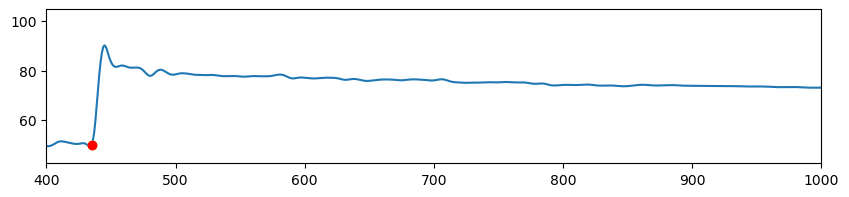

(7, 9)
(7, 9, [298, 361, 556, 584, 1032, 1393])
(7, 9, [556])


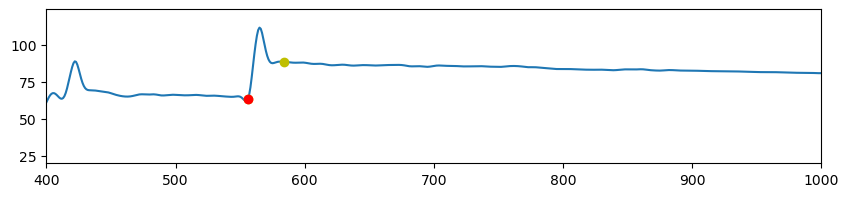

(7, 10)
(7, 10, [279, 435, 583, 621, 1062])
(7, 10, [435, 583])


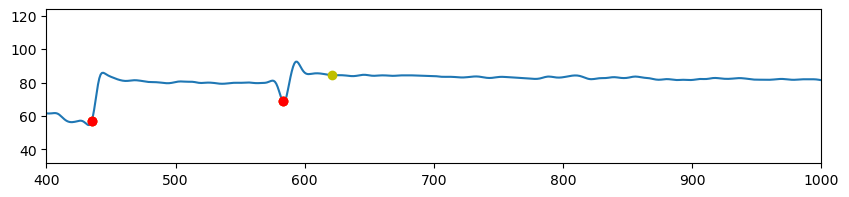

(8, 1)
(8, 1, [409, 523, 574, 600, 617, 639, 666, 990, 1083])
(8, 1, [])


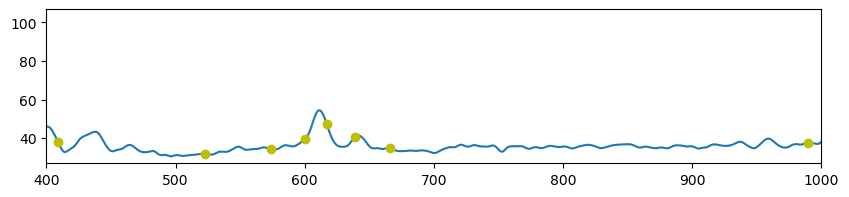

(8, 2)
(8, 2, [154, 186, 279, 442, 493, 615, 626, 1397])
(8, 2, [626])


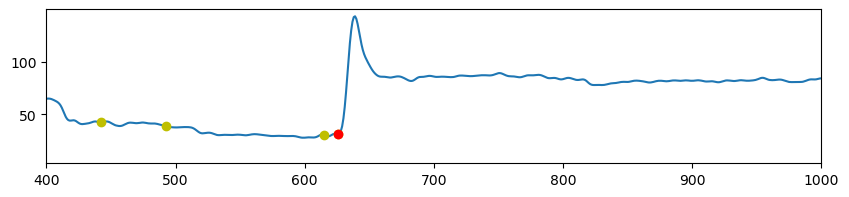

(8, 3)
(8, 3, [500, 511])
(8, 3, [])


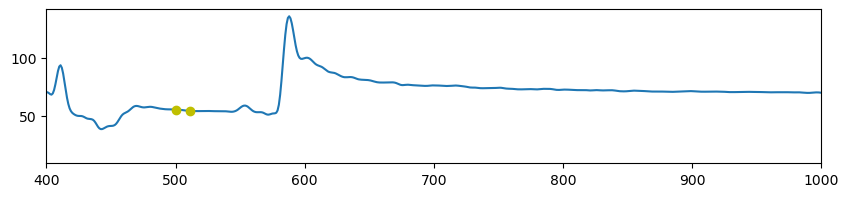

(8, 4)
(8, 4, [415, 507, 556, 600, 618, 646, 773, 783, 936, 983, 1027, 1051])
(8, 4, [415])


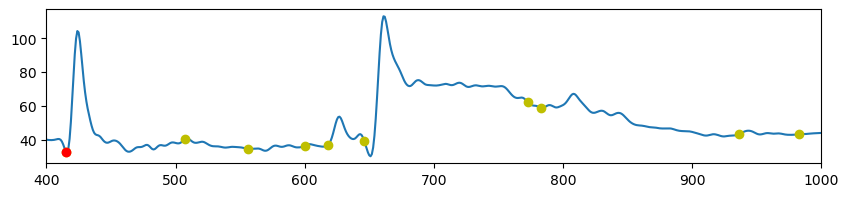

(8, 5)
(8, 5, [24, 190, 349, 531, 545, 577, 745, 795, 818, 850, 880, 910, 922, 936, 992, 1060, 1081, 1106])
(8, 5, [])


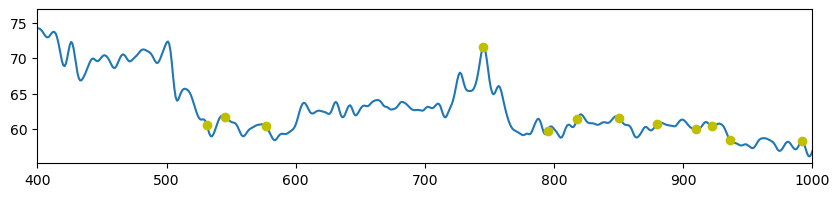

(8, 6)
(8, 6, [408, 437, 466, 482, 504, 547, 559, 1399])
(8, 6, [559])


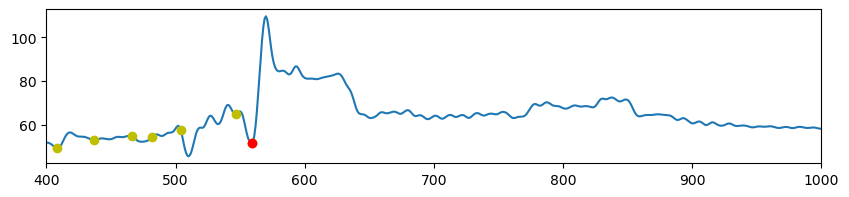

(8, 7)
(8, 7, [500, 533, 584, 632, 655, 697, 719, 906])
(8, 7, [533, 906])


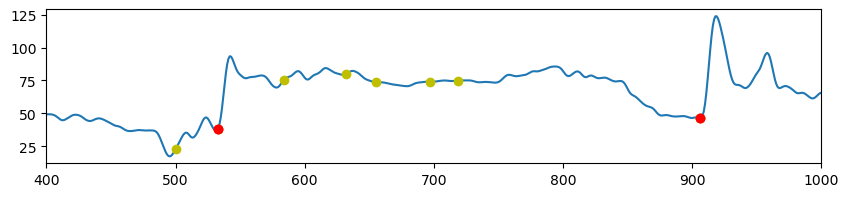

(8, 8)
(8, 8, [268, 422, 473, 508, 535, 567, 613, 797, 835, 1131, 1163, 1377])
(8, 8, [])


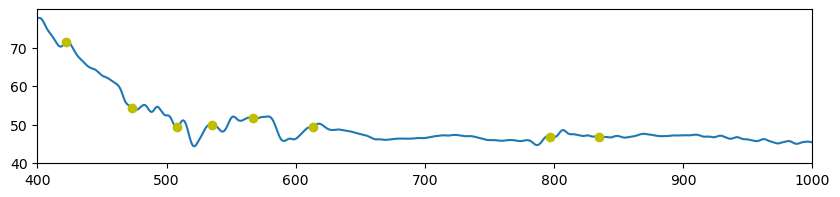

(8, 9)
(8, 9, [412, 547, 577, 621, 646, 676, 824, 898, 1395])
(8, 9, [412, 824, 898])


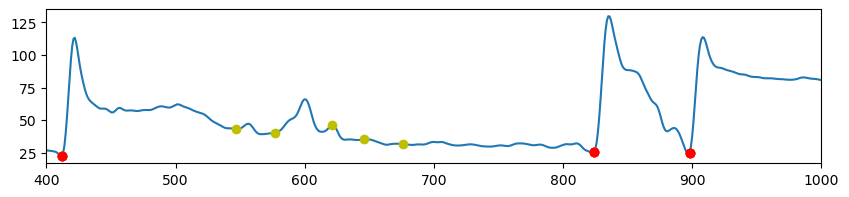

(8, 10)
(8, 10, [263, 551, 693, 835])
(8, 10, [693, 835])


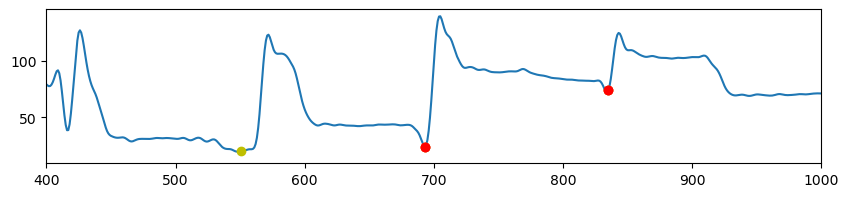

(2, 1)
(2, 1, [246])
(2, 1, [])


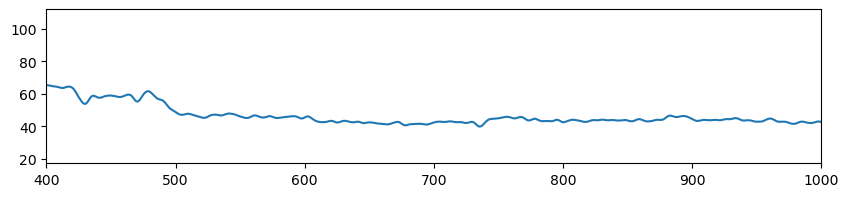

(2, 2)
no swing found


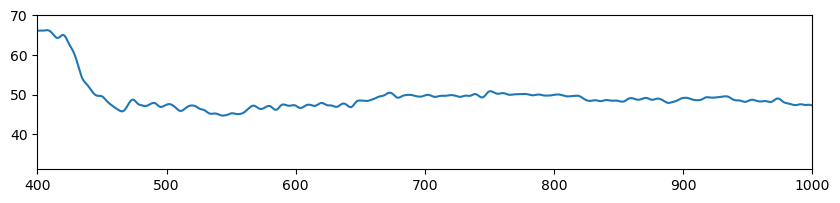

(2, 3)
(2, 3, [1, 161, 262, 347, 473, 1040, 1357])
(2, 3, [473])


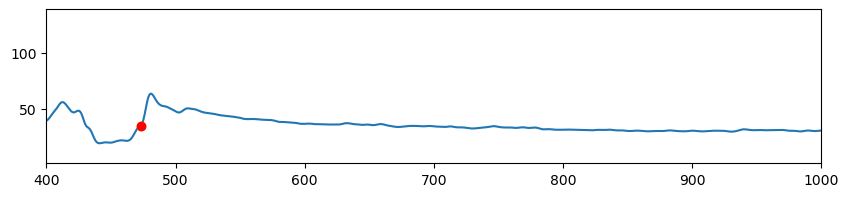

(2, 4)
(2, 4, [121, 231, 276, 486, 543, 576, 1398])
(2, 4, [486, 576])


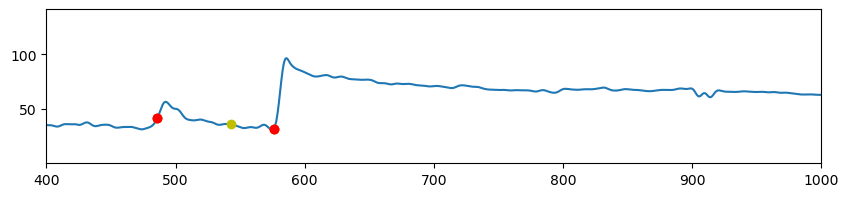

(2, 5)
(2, 5, [142, 166, 480, 721, 817, 857, 895, 1184])
(2, 5, [])


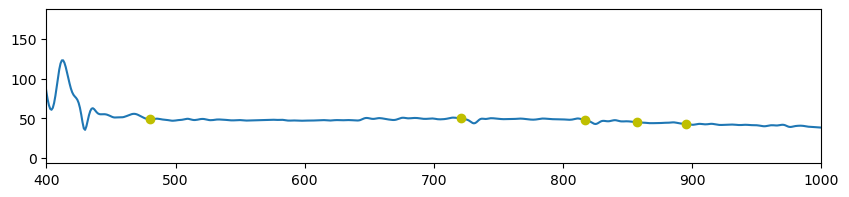

(2, 6)
(2, 6, [240, 552, 678])
(2, 6, [678])


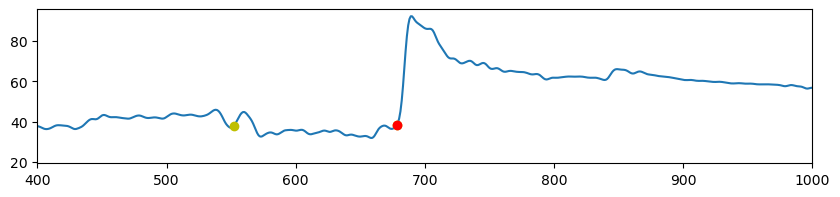

(2, 7)
(2, 7, [1, 446, 541, 600, 827, 845])
(2, 7, [845])


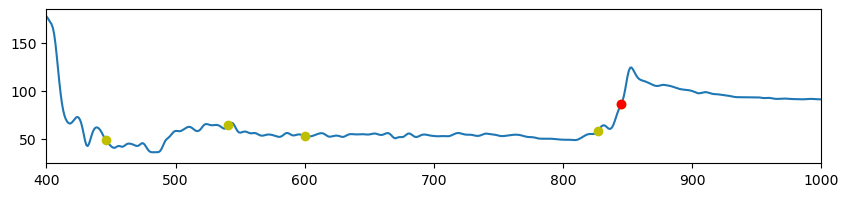

(2, 8)
(2, 8, [14, 257, 466, 519, 742])
(2, 8, [466, 742])


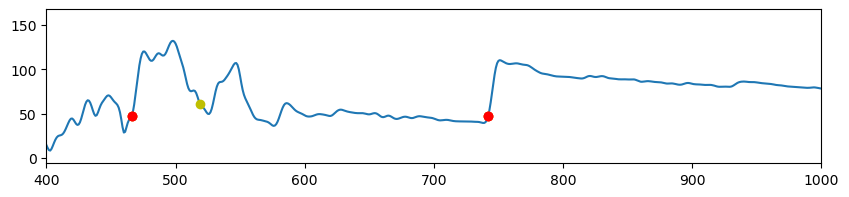

(2, 9)
(2, 9, [72, 449, 531, 589, 754, 1398])
(2, 9, [])


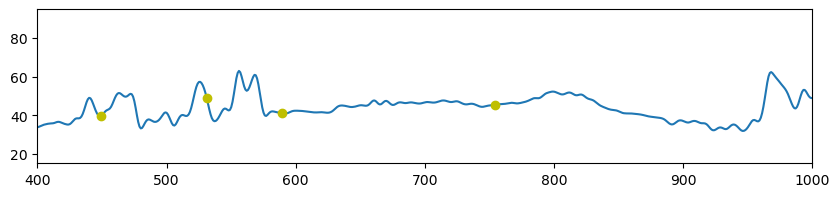

(2, 10)
(2, 10, [24, 113, 151, 277, 318, 358, 481, 533, 554, 705, 882, 971, 990, 1009])
(2, 10, [])


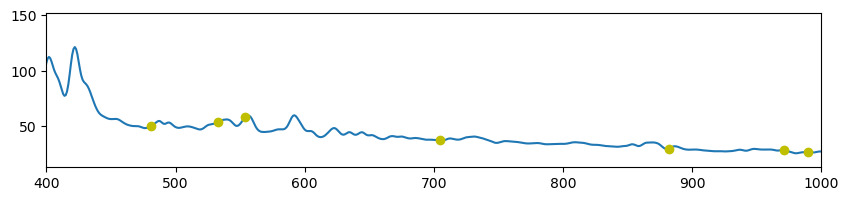

(3, 1)
(3, 1, [454, 520])
(3, 1, [454, 520])


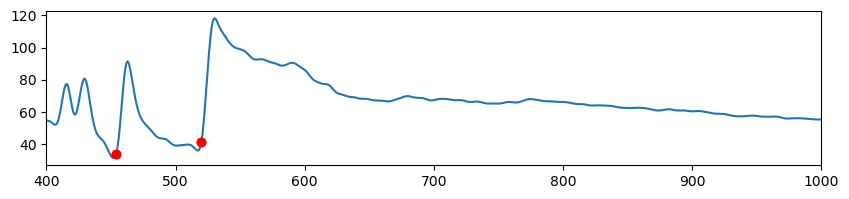

(3, 2)
(3, 2, [299, 430, 492])
(3, 2, [430, 492])


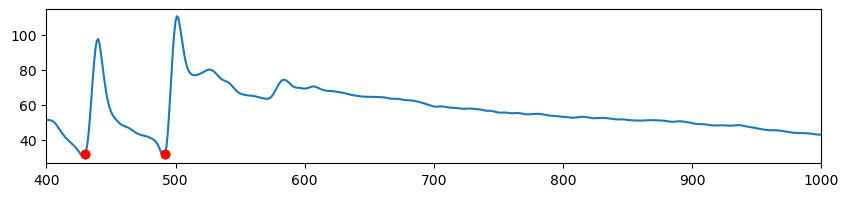

(3, 3)
(3, 3, [450])
(3, 3, [450])


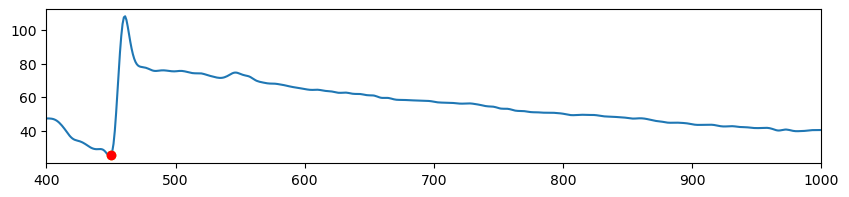

(3, 4)
(3, 4, [48, 426, 722])
(3, 4, [426, 722])


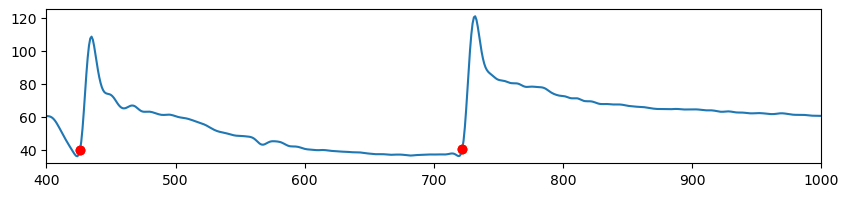

(3, 5)
(3, 5, [515, 883])
(3, 5, [515, 883])


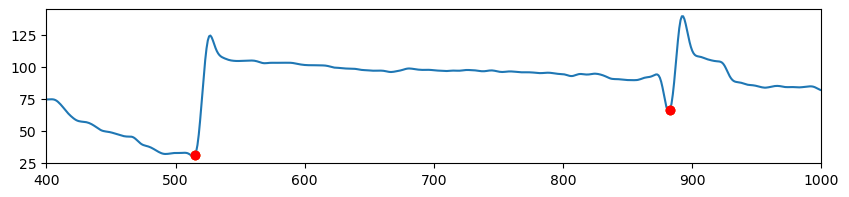

(3, 6)
(3, 6, [416, 453, 702, 746])
(3, 6, [416, 453, 702, 746])


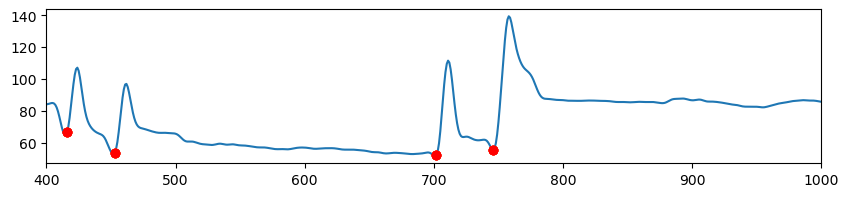

(3, 7)
(3, 7, [415, 442, 867, 1015])
(3, 7, [415, 442, 867])


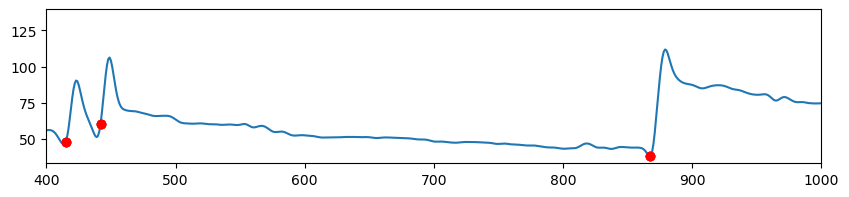

(3, 8)
(3, 8, [542, 1003])
(3, 8, [542])


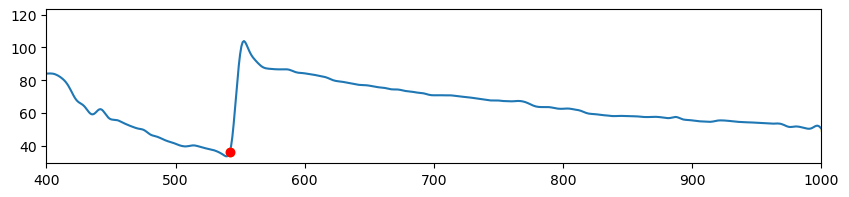

(3, 9)
(3, 9, [174, 454, 780])
(3, 9, [454, 780])


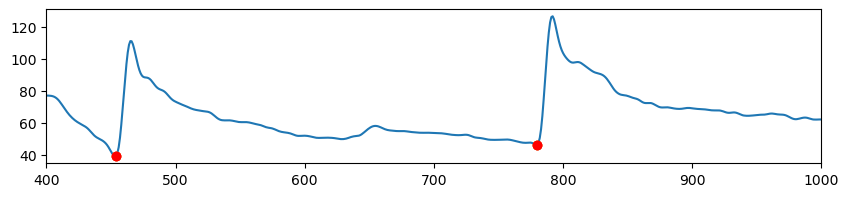

(3, 10)
(3, 10, [419, 565, 993])
(3, 10, [419, 565, 993])


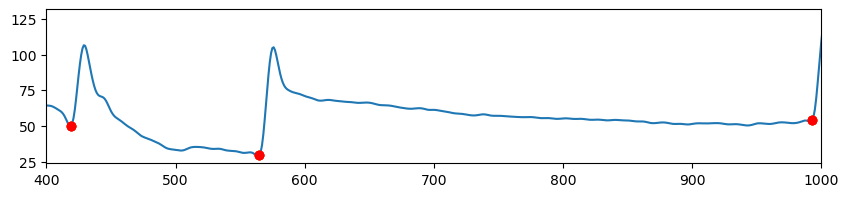

(5, 1)
(5, 1, [111, 217, 257, 368, 460, 650, 725, 740, 774, 828, 852, 974])
(5, 1, [650, 828, 974])


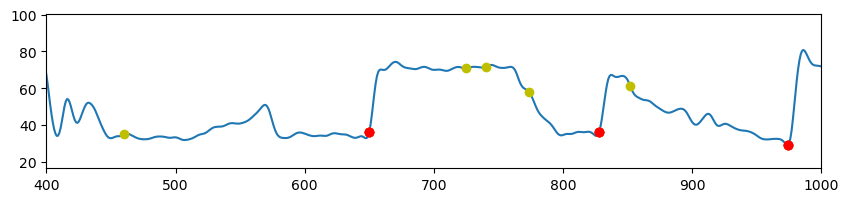

(5, 2)
(5, 2, [138, 166, 399, 416, 1011])
(5, 2, [416])


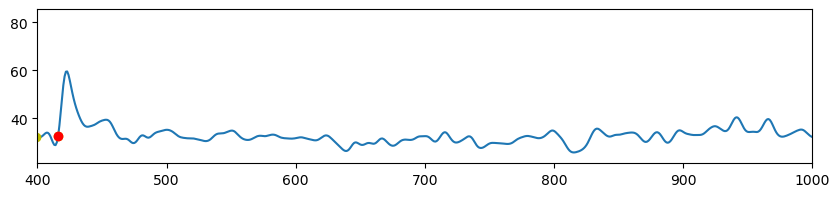

(5, 3)
(5, 3, [149, 174, 708, 957, 1397])
(5, 3, [])


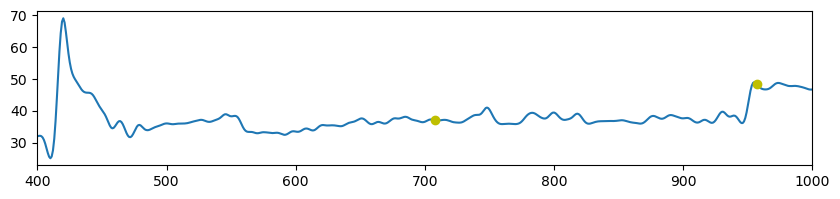

(5, 4)
(5, 4, [806, 874, 1073, 1136, 1169, 1205, 1262, 1391])
(5, 4, [])


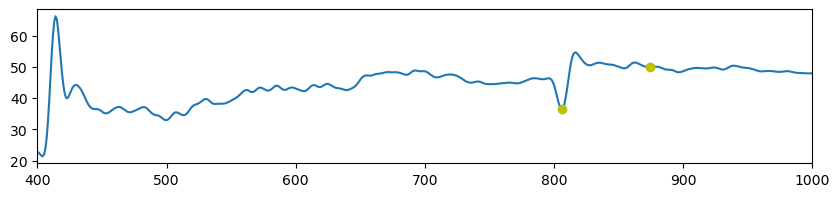

(5, 5)
(5, 5, [45, 492, 1396])
(5, 5, [])


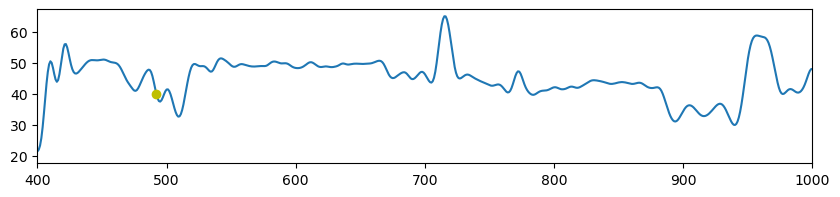

(5, 6)
(5, 6, [163, 421, 435, 506, 631, 648])
(5, 6, [648])


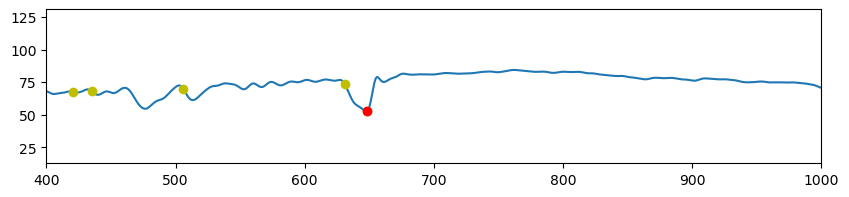

(5, 7)
(5, 7, [505, 807, 1399])
(5, 7, [505, 807])


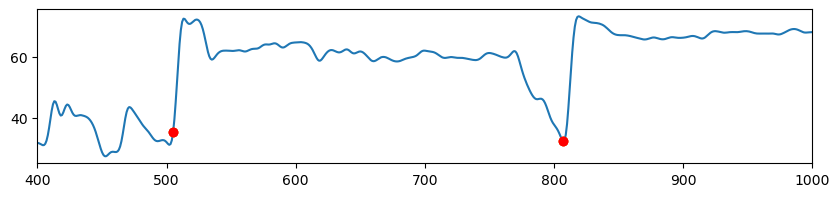

(5, 8)
(5, 8, [442, 586, 633, 782, 816, 864, 888, 904, 922, 962, 1006, 1021, 1064])
(5, 8, [586])


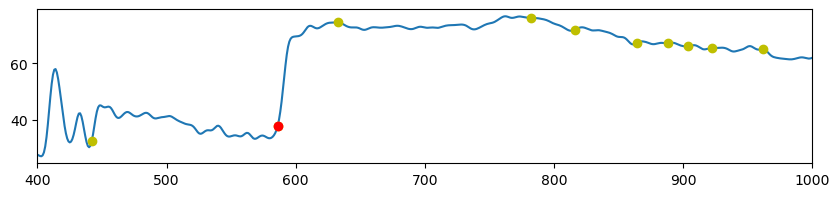

(5, 9)
(5, 9, [149, 176, 225, 274, 401, 470, 492, 525, 550, 601, 653, 717, 775, 1073, 1088, 1099, 1127, 1143, 1180, 1198, 1217, 1396])
(5, 9, [401])


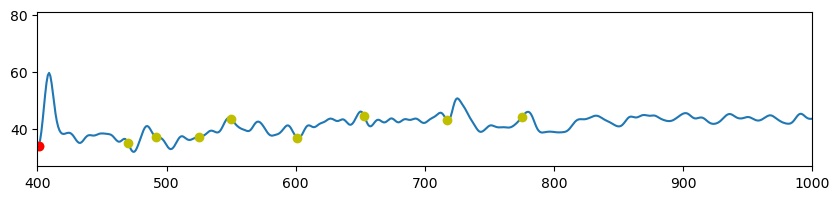

(5, 10)
(5, 10, [401, 453, 507, 518, 548, 727, 766])
(5, 10, [727, 766])


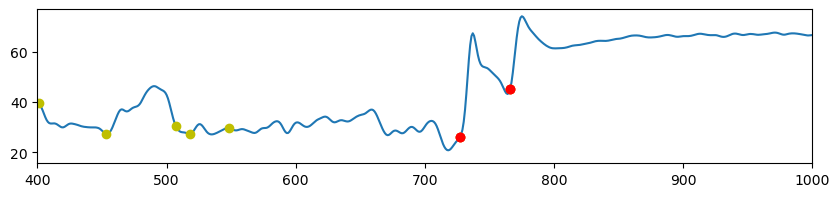

(6, 1)
(6, 1, [411, 445, 541, 822, 908, 1118, 1239, 1312, 1334])
(6, 1, [411, 445, 541, 822])


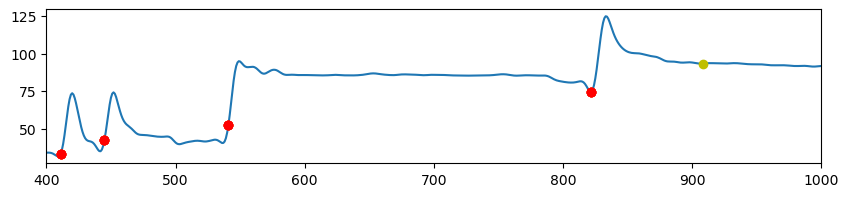

(6, 2)
(6, 2, [414, 460, 478, 516, 629])
(6, 2, [414, 516, 629])


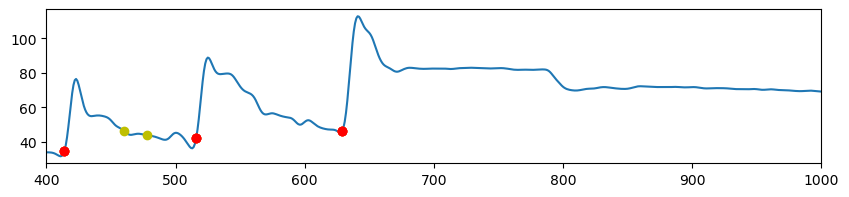

(6, 3)
(6, 3, [454, 492, 1129, 1220, 1267, 1295, 1319, 1350, 1366])
(6, 3, [492])


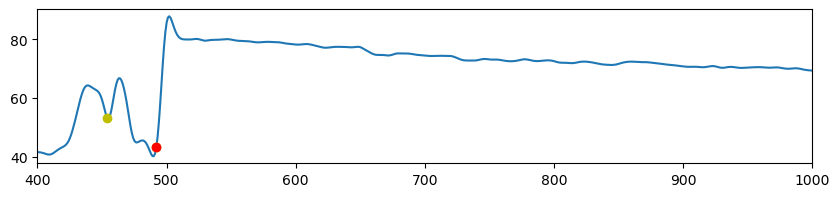

(6, 4)
(6, 4, [416, 956, 1225, 1276, 1333])
(6, 4, [416, 956])


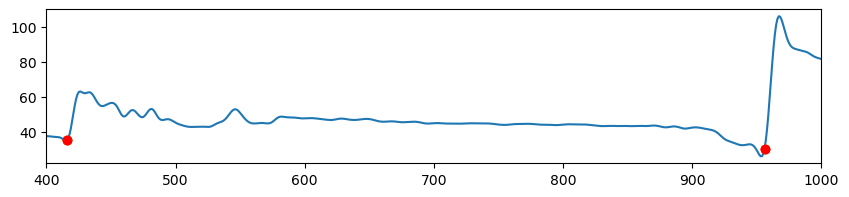

(6, 5)
(6, 5, [475])
(6, 5, [])


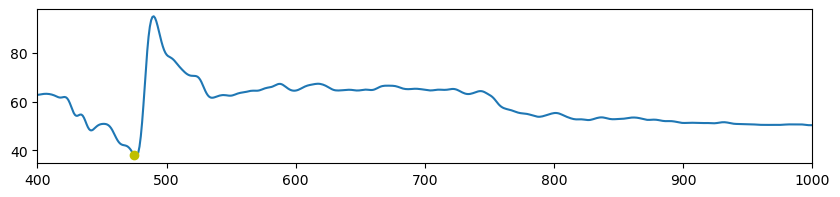

(6, 6)
(6, 6, [422, 462])
(6, 6, [422, 462])


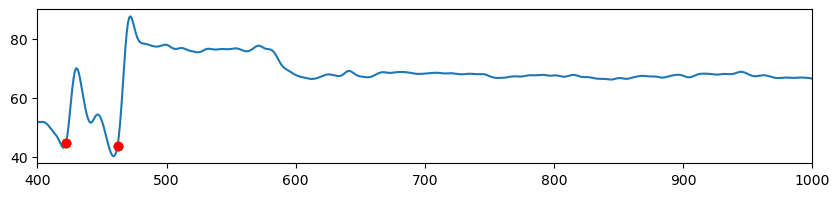

(6, 7)
(6, 7, [444, 1397])
(6, 7, [444])


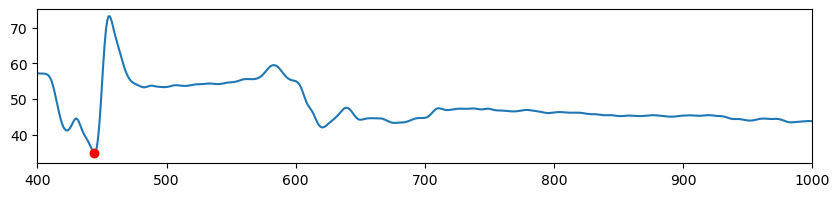

(6, 8)
(6, 8, [187, 273, 414, 454, 1155, 1181, 1281])
(6, 8, [414, 454])


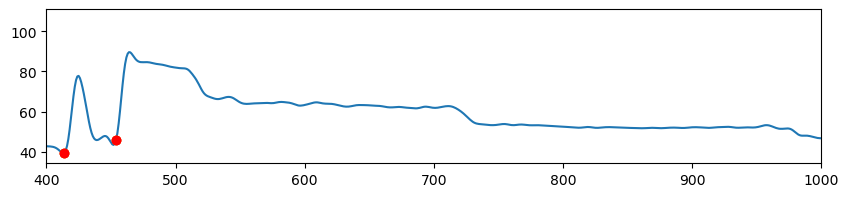

(6, 9)
(6, 9, [421])
(6, 9, [421])


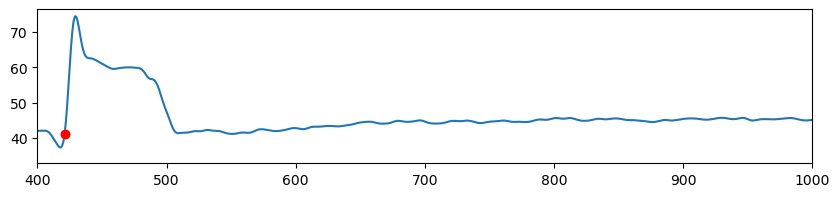

(6, 10)
(6, 10, [551, 577, 790])
(6, 10, [790])


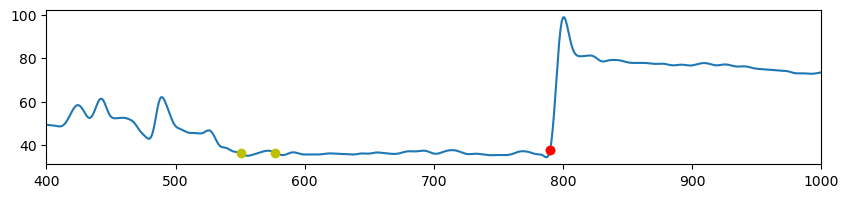

(7, 1)
(7, 1, [288, 626])
(7, 1, [626])


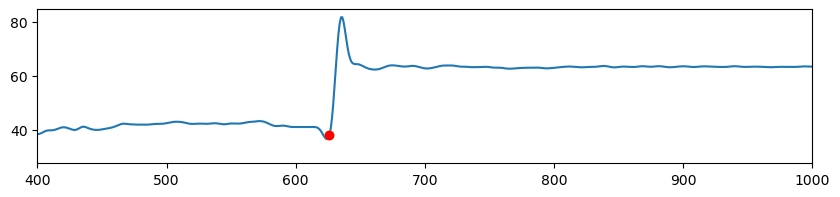

(7, 2)
(7, 2, [1113])
(7, 2, [])


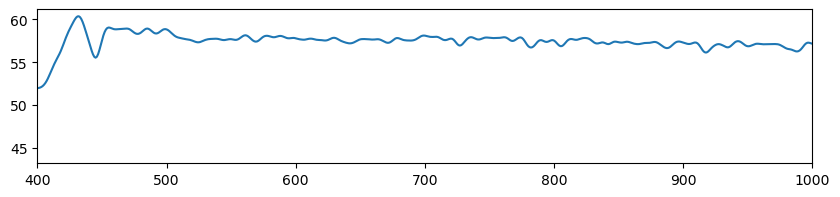

(7, 3)
(7, 3, [76, 280, 451, 601, 619, 715, 776, 803, 825, 913, 932, 967, 994, 1011])
(7, 3, [])


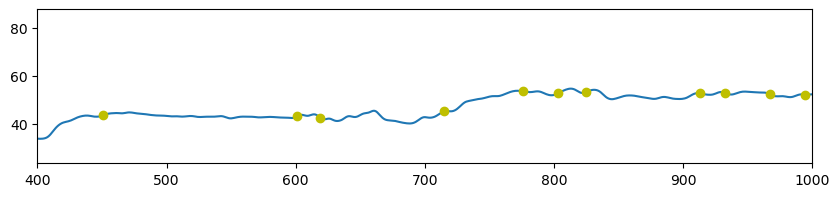

(7, 4)
(7, 4, [439, 1089, 1120, 1395])
(7, 4, [])


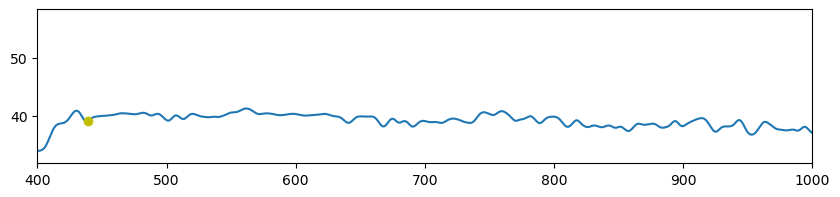

(7, 5)
(7, 5, [38, 136, 187, 337, 395, 931])
(7, 5, [])


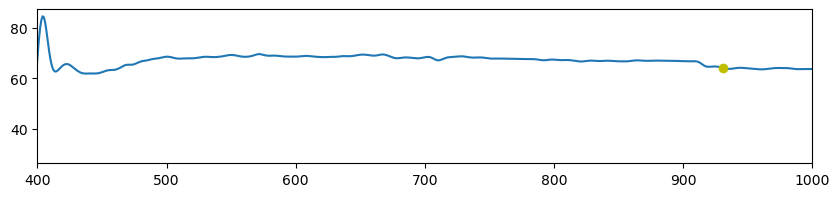

(7, 6)
(7, 6, [1111, 1129])
(7, 6, [])


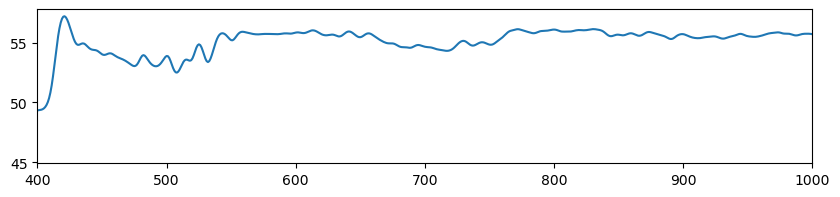

(7, 7)
(7, 7, [44, 90, 163, 264, 332, 382, 657])
(7, 7, [657])


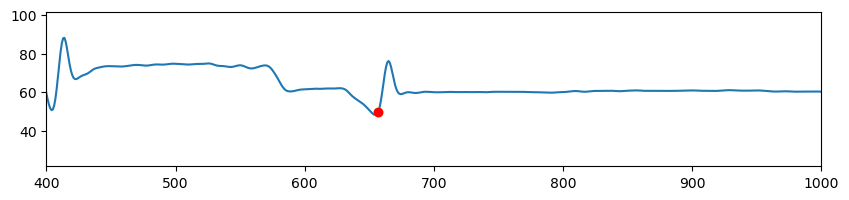

(7, 8)
(7, 8, [483, 547, 1091, 1122, 1398])
(7, 8, [])


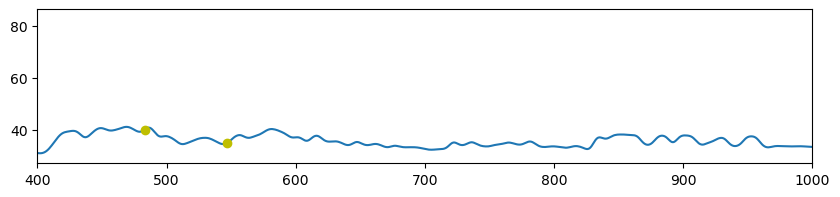

(7, 9)
(7, 9, [318, 368, 713])
(7, 9, [])


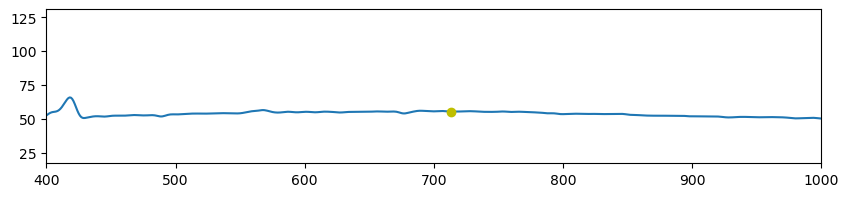

(7, 10)
(7, 10, [275, 408])
(7, 10, [408])


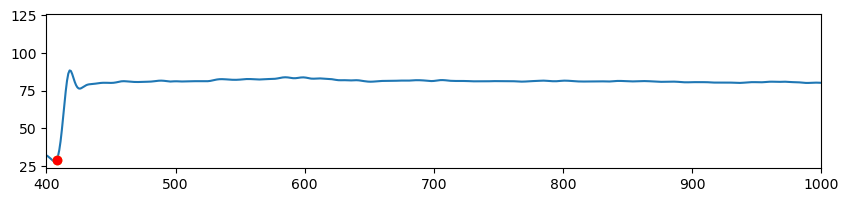

(8, 1)
(8, 1, [423, 451, 474, 602, 761, 913, 930, 997, 1049, 1192, 1222, 1248, 1337, 1354, 1377, 1387])
(8, 1, [423, 474])


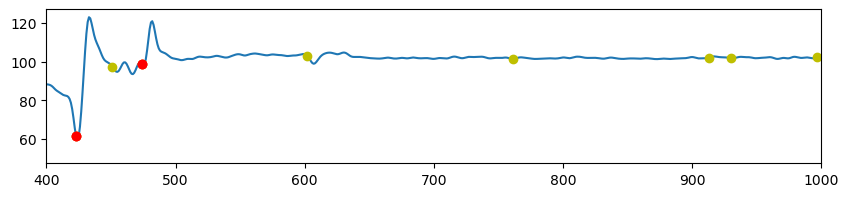

(8, 2)
(8, 2, [410, 448, 471, 864, 912, 935, 1058, 1362, 1397])
(8, 2, [410, 471, 864])


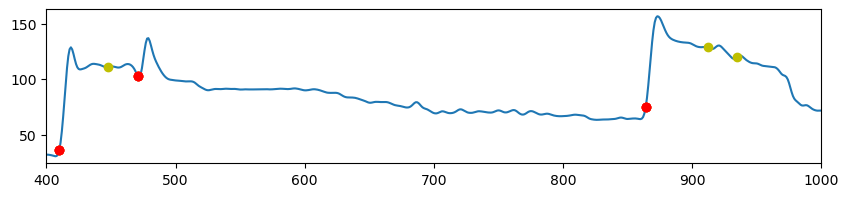

(8, 3)
(8, 3, [596, 614, 662, 704, 749, 870])
(8, 3, [596])


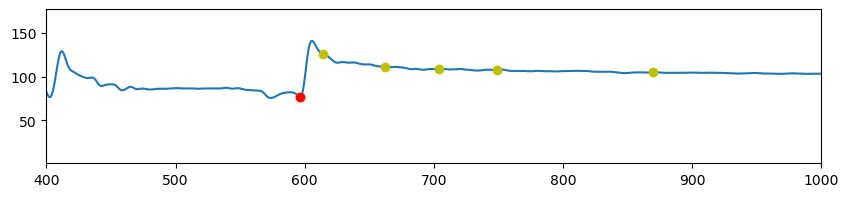

(8, 4)
(8, 4, [461, 519, 530, 551, 604, 636, 677, 709, 736, 765, 809, 850, 1050, 1287, 1299])
(8, 4, [636, 709])


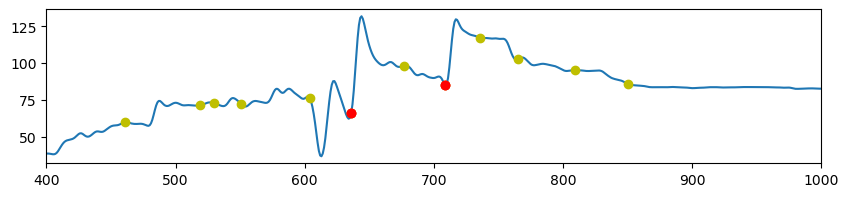

(8, 5)
(8, 5, [434, 478, 491, 505, 647, 713, 731, 756, 1125])
(8, 5, [731])


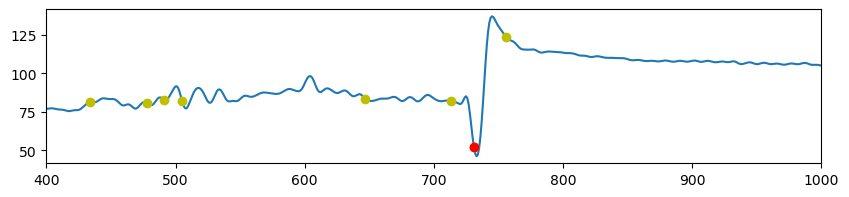

(8, 6)
(8, 6, [1, 353, 380, 408, 552, 621, 659, 676, 704, 841, 1141])
(8, 6, [552, 841])


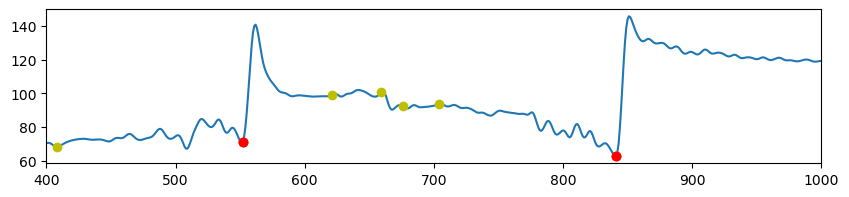

(8, 7)
(8, 7, [437, 492, 504, 529, 582, 600, 648, 746, 793, 816, 842, 856, 955, 1366])
(8, 7, [437, 504, 600, 816])


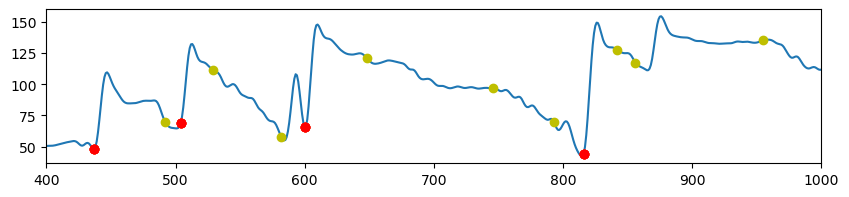

(8, 8)
(8, 8, [77, 236, 254, 266, 599, 783, 1093, 1309])
(8, 8, [599])


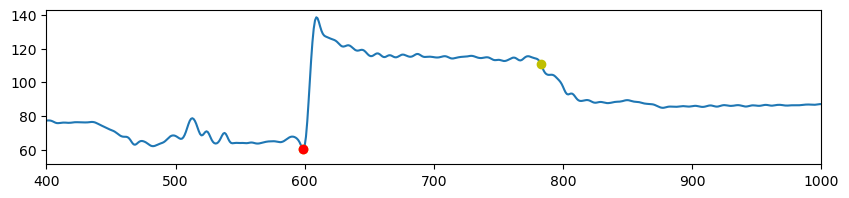

(8, 9)
(8, 9, [332, 447, 524, 545, 569, 601, 808, 878, 916, 1100, 1128, 1198, 1397])
(8, 9, [524, 916])


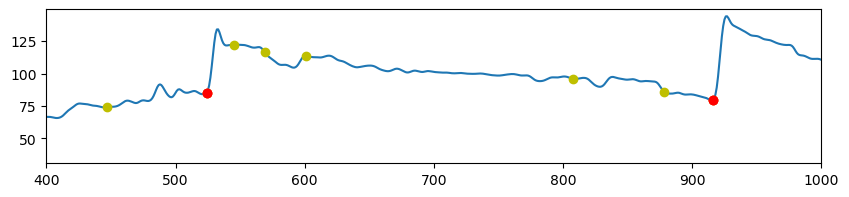

(8, 10)
(8, 10, [270, 417, 480, 531, 668])
(8, 10, [417, 531])


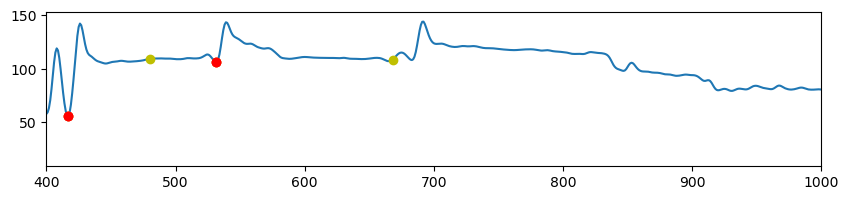

In [ ]:
reset_ang_MDN_Stop1_R3, swing_count_MDN_Stop1_R3, swing_ts_MDN_Stop1_R3 = get_reset_ang_Hleg(MDN_Stop1, 'R3')
reset_ang_MDN_Stop1_L3, swing_count_MDN_Stop1_L3, swing_ts_MDN_Stop1_L3 = get_reset_ang_Hleg(MDN_Stop1, 'L3')

<AxesSubplot:>

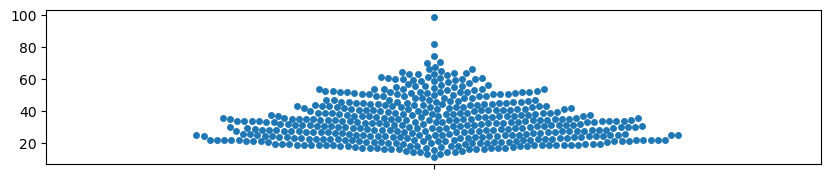

In [ ]:
sns.swarmplot(reset_ang_MDN_R3 + reset_ang_MDN_L3)

In [ ]:
np.percentile(np.array(reset_ang_MDN_L3 + reset_ang_MDN_R3), [5,10,25, 50, 75, 90, 95])

array([17.61240055, 19.30157396, 24.18353662, 32.46249314, 42.76584694,
       52.9759967 , 59.94167973])

<AxesSubplot:>

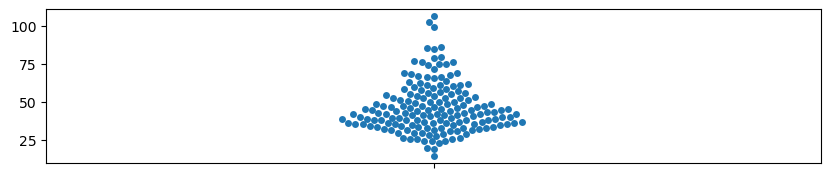

In [ ]:
sns.swarmplot(reset_ang_MDN_Stop1_R3 + reset_ang_MDN_Stop1_L3)

In [ ]:
np.percentile(np.array(reset_ang_MDN_Stop1_R3 + reset_ang_MDN_Stop1_L3), [5,10,25, 50, 75, 90, 95])

array([25.2529136 , 29.20860224, 35.3036956 , 42.73212705, 54.70618133,
       68.41373999, 76.47226867])

c:\Users\SthanuKumarD\Anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 16.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


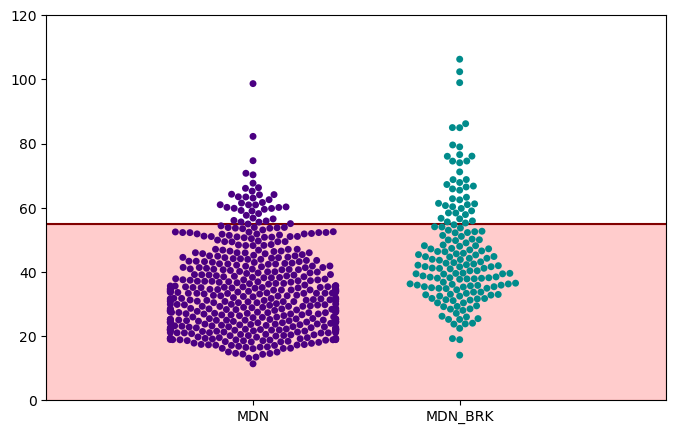

In [ ]:
plt.rcParams['figure.figsize'] = (8,5)
swing_init_ang = pd.concat([pd.DataFrame([(reset_ang_MDN_L3 + reset_ang_MDN_R3)]).T , pd.DataFrame([(reset_ang_MDN_Stop1_L3 + reset_ang_MDN_Stop1_R3)]).T], axis = 1)

swing_init_ang.columns = ['MDN', 'MDN_BRK']
sns.swarmplot(swing_init_ang, palette=  ['indigo', 'darkcyan'])
plt.axhline (y = 55, color = 'maroon')
plt.xlim(-1,  2)
plt.ylim(0, 120)
plt.fill_between( [-1,  2], y1 = 0, y2 = 55, color = 'r',alpha = 0.2)
# plt.savefig(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Hind\swing_init_ang.svg', dpi = 300)

# swing_init_ang.to_csv(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Hind\swing_init_ang.csv', index = False)

In [ ]:
# def flatten_extend(matrix):
#     flat_list = []
#     for row in matrix:
#          flat_list.extend(row)
#     return flat_list


# def get_stepping_params_Hleg (df,leg , angle):
#     range_lim = 53.6 #C_flex (less than)

#     if leg == 'L3':
#         sc = 'L-H_stepcycle'
#     if leg == 'R3':
#         sc = 'R-H_stepcycle'
    
#     count_SIZ_reached = []
#     swing_events_within_SIZ = []
#     percentage_swings_per_trial = []
#     dwell_time = []


#     for n in df['flynum'].unique().tolist():
#         for t in df.groupby('flynum').get_group(n)['tnum'].unique().tolist():
#             data = df.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)
            
#             sc_df_temp = data[sc]
#             ang = data[angle]

#             ang_diff = pd.DataFrame(np.diff(ang))
#             ang_diff_resets = ang_diff.loc[ang_diff[0] > 3].index.tolist() #index from diff ==> add idx = 1
#             try:
#                 ang_diff_resets = [x+1 for x in ang_diff_resets] # indexing fixed

#                 temp_ang = pd.DataFrame(data[angle][400:1000])
#                 list_in_range = temp_ang.loc[(temp_ang[angle] <range_lim)].index.tolist() #time indices of all events when ang is in the reset rang
#                 if len(list_in_range) > 0:
#                     break_pt = np.split(list_in_range, np.where(np.diff(list_in_range)>1)[0]+1) #breaking time indices into events---> number of times when the ang is reached
#                     range_count_temp = len(break_pt) # number of times the SIZ was achieved in trial
#                     count_SIZ_reached.append(range_count_temp)
                    
#                     swing_events_temp = [] 
#                     for event in break_pt:
#                         # print(event)
#                         leg_state = sc_df_temp.iloc[event+1].tolist()
#                         dwell_time.append(len(event))
#                         # print(leg_state)
#                         if (False in leg_state):
#                             # print('swing detected!!')
#                             temp_arr = [i for i in event if i in ang_diff_resets]
#                             if len(temp_arr)>0:
#                                 swing_events_temp.append('True')
                                
#                     #             plt.plot(temp_ang)
#                     #             for i in temp_arr:
#                     #                 plt.axvline(x = i, color = 'r', ls = '--', alpha = 0.3)
#                     # plt.show()
#                     swing_events_within_SIZ.append(len(swing_events_temp))
#                     percentage_swings_per_trial.append((len(swing_events_temp)/range_count_temp)*100)
#                 else:
#                     count_SIZ_reached.append(len(list_in_range))
#             except:
#                 print('no sharp change detected in', (n,t))
#     return count_SIZ_reached, swing_events_within_SIZ, percentage_swings_per_trial, dwell_time

In [ ]:
def get_stepping_params_Hleg (df,leg , angle, leg_swing_ts):
    
    range_lim = 55

    if leg == 'L3':
        sc = 'L-H_stepcycle'

    if leg == 'R3':
        sc = 'R-H_stepcycle'
    
    count_SIZ_reached = [] # per trial
    swing_events_within_SIZ = [] # per trial
    percentage_swings_per_trial = []  # per trial
    dwell_time = [] # per SIZ event

    for n in df['flynum'].unique().tolist():
        for t in df.groupby('flynum').get_group(n)['tnum'].unique().tolist():
            swing_events_temp = []
            
            data = df.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)
            ang = data[angle]
            # plt.plot(ang)
            ang = pd.DataFrame(scipy.ndimage.gaussian_filter(ang, sigma= 10))
            ang.columns = [angle]
            
            
            # plt.plot (ang)
            

            try:
                sc_df_temp = leg_swing_ts.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)
                swing_ts = sc_df_temp['swing_ts'].tolist()
            except:
                ## no swings in the trial
                swing_ts = []

            temp_ang = pd.DataFrame(ang[430:1000])
            list_in_range = temp_ang.loc[(temp_ang[angle] <range_lim)].index.tolist() #time index when leg is in SIZ

            if len(list_in_range) > 0: 
                ## if the leg ever enters the SIZ
                break_pt = np.split(list_in_range, np.where(np.diff(list_in_range)>20)[0]+1) #breaking time indices into events---> number of times when the ang is reached

                print('Filtering last event:',break_pt[-1][-1], len(break_pt[-1])  )
                if (break_pt[-1][-1] == 999 and len(break_pt[-1])<25):
                    print('removing last event of length', len(break_pt[-1]))
                    break_pt = break_pt[:-1]
                else:
                    print('valid end point')
                


                break_pt_filt = []
                for event in break_pt:
                    if len(event) <20:
                        continue
                    else:
                        break_pt_filt.append(event)

                
                range_count_temp = len(break_pt_filt) # number of times the SIZ was achieved in trial
                count_SIZ_reached.append(range_count_temp)
                print(n,t,len(break_pt_filt))

                if len(break_pt_filt)>0:
                    plt.rcParams['figure.figsize'] = (10,2)
                    plt.axhline(y = range_lim, color = 'grey' )
                    plt.plot (ang)

                    for i in break_pt_filt:
                        plt.axvline(x = i[0], color = 'g')
                        plt.axvline(x = i[-1], color = 'r')

                    # dwell_time_temp = []
                    for event in break_pt_filt: # for each time the leg enters SIZ
                        
                        dwell_time.append(len(event)) 
                        swing_count = 0
                        
                        for swing in swing_ts:
                            if swing_count == 0:
                                if swing in event or swing in [x+10 for x in event]:
                                    # if there was a swing in this stretch of time
                                    swing_events_temp.append('True')
                                    plt.axvline(x = swing, color = 'k', ls = '--')
                                    swing_count+=1

                    swing_events_within_SIZ.append(len(swing_events_temp))
                    # dwell_time. append(np.mean(dwell_time_temp))
                    percentage_swings_per_trial.append((len(swing_events_temp)/range_count_temp)*100)
                    # print(n,t,((len(swing_events_temp), range_count_temp, (len(swing_events_temp)/range_count_temp)*100)))
                    plt.xlim(300,1100)
                    plt.show()
                # else:
                #     plt.xlim(300,1100)
                #     plt.show()
            else:
                count_SIZ_reached.append(len(list_in_range)) # appends zero
                # plt.xlim(300,1100)
                # plt.show()

    return count_SIZ_reached, swing_events_within_SIZ, percentage_swings_per_trial, dwell_time

Filtering last event: 999 71
valid end point
1 1 2


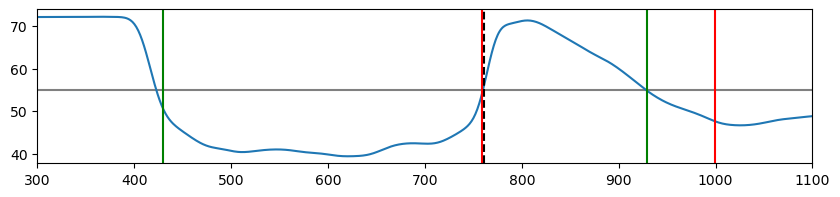

Filtering last event: 999 220
valid end point
1 2 2


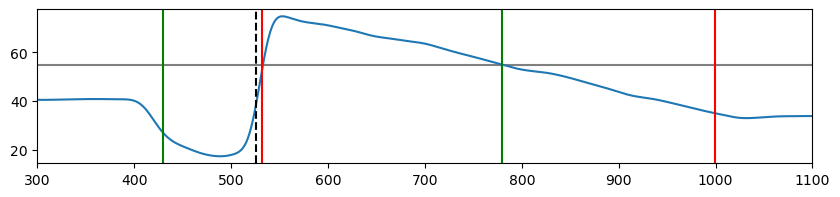

Filtering last event: 999 203
valid end point
1 3 2


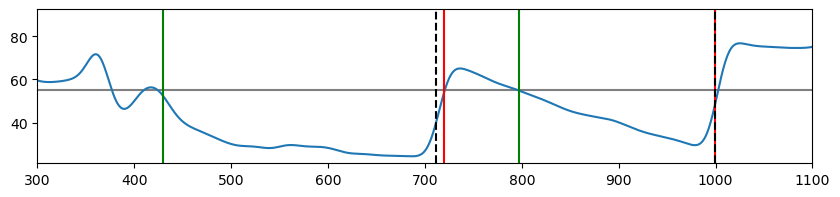

Filtering last event: 999 20
removing last event of length 20
1 4 2


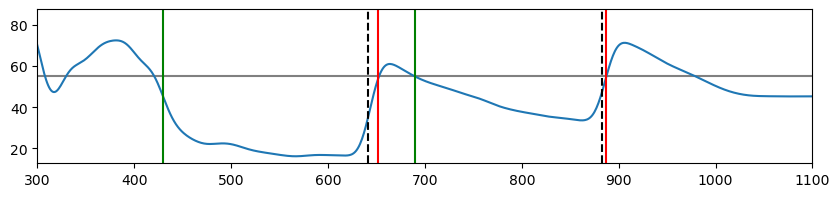

Filtering last event: 999 86
valid end point
1 5 2


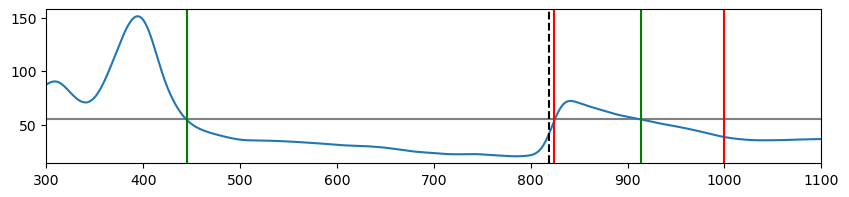

Filtering last event: 974 192
valid end point
1 6 2


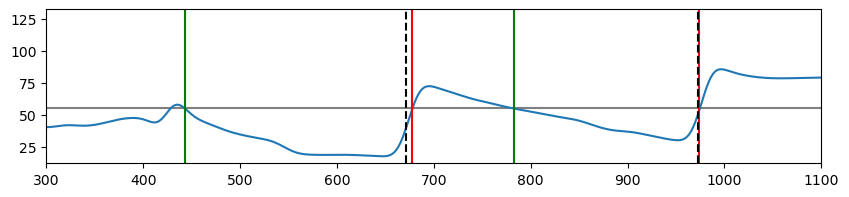

Filtering last event: 999 50
valid end point
1 7 3


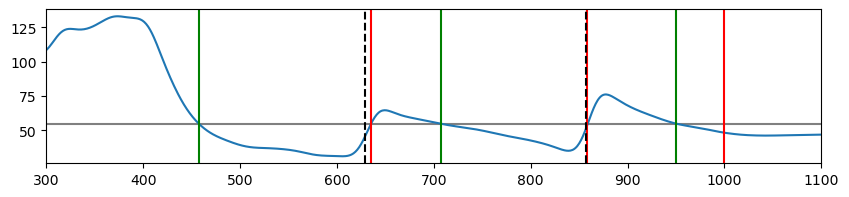

Filtering last event: 986 42
valid end point
1 8 3


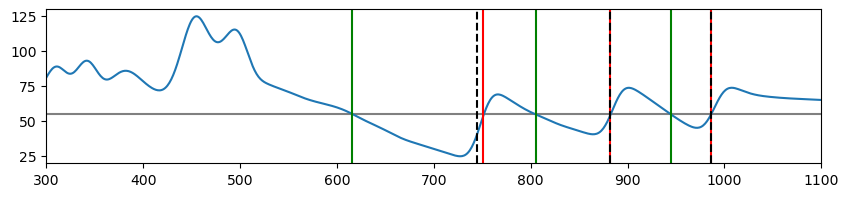

Filtering last event: 948 62
valid end point
1 9 3


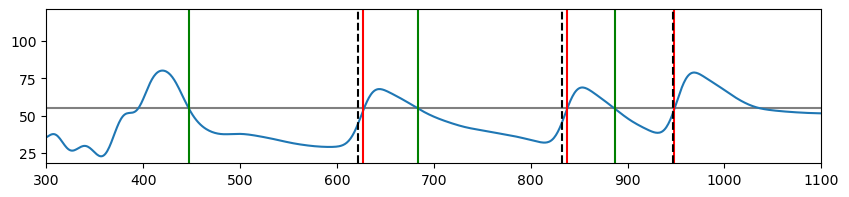

Filtering last event: 999 29
valid end point
1 10 5


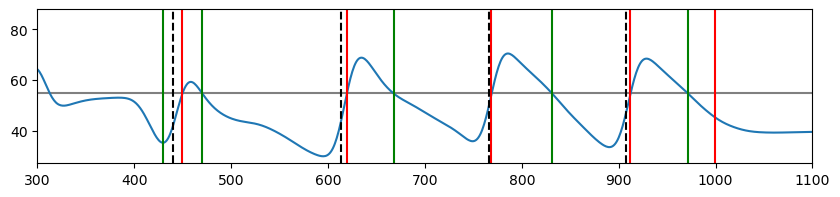

Filtering last event: 636 7
valid end point
2 1 1


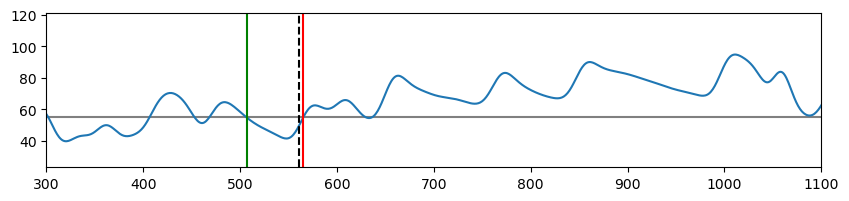

Filtering last event: 745 67
valid end point
2 2 3


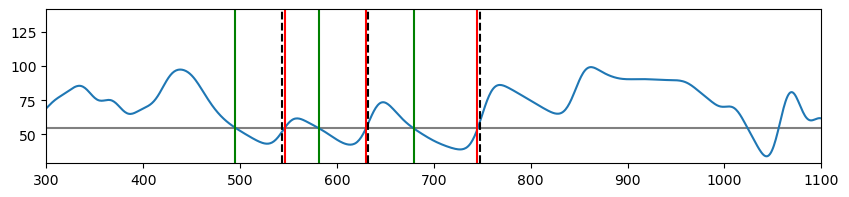

Filtering last event: 840 75
valid end point
2 3 3


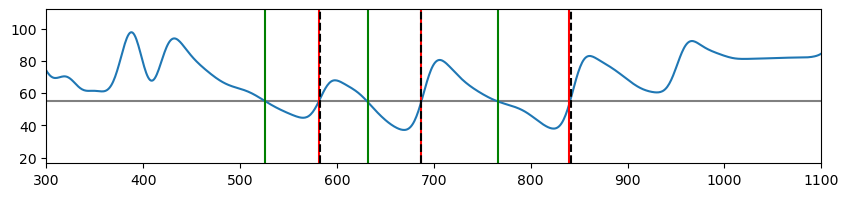

Filtering last event: 842 68
valid end point
2 4 2


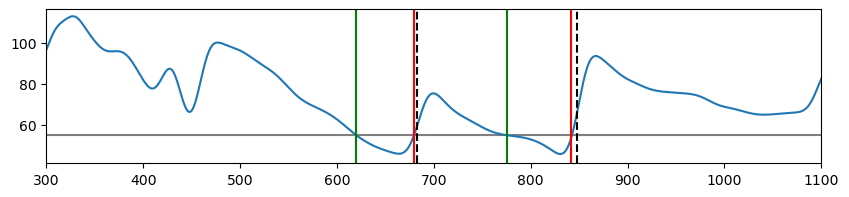

Filtering last event: 770 192
valid end point
2 5 2


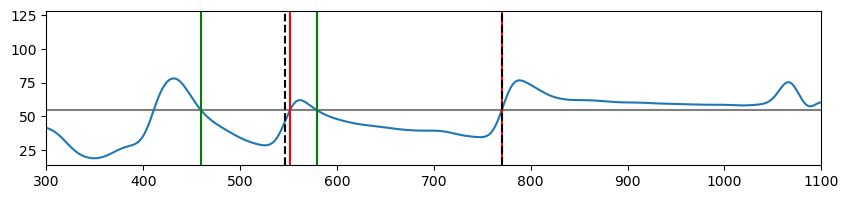

Filtering last event: 999 257
valid end point
2 6 2


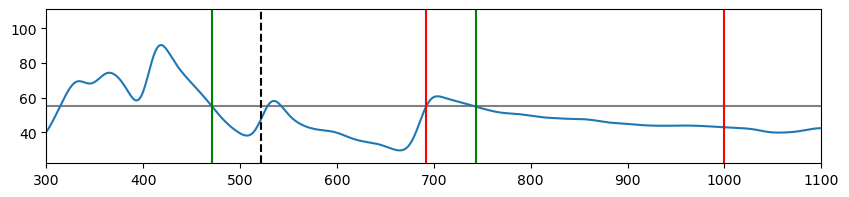

Filtering last event: 858 236
valid end point
2 7 2


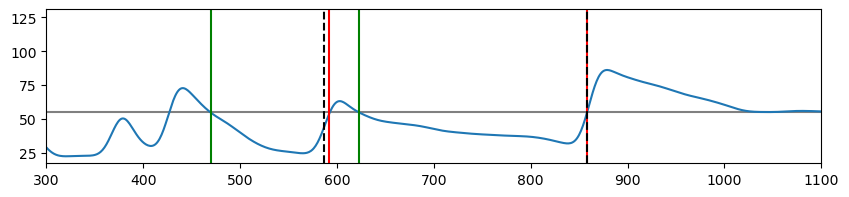

Filtering last event: 933 153
valid end point
2 8 2


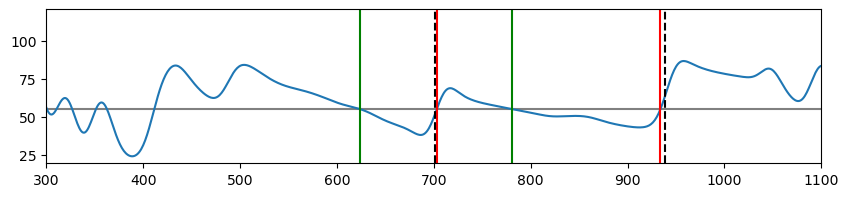

Filtering last event: 923 57
valid end point
2 9 3


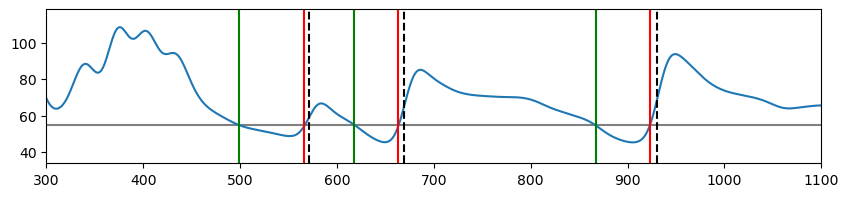

Filtering last event: 952 244
valid end point
2 10 2


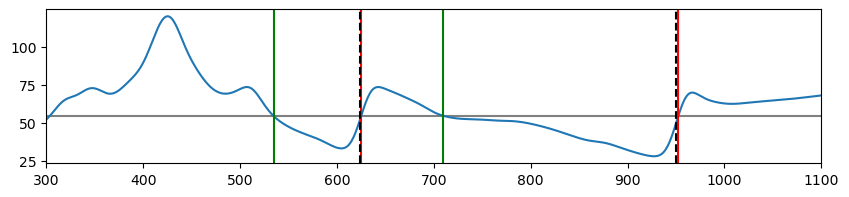

Filtering last event: 999 243
valid end point
3 1 2


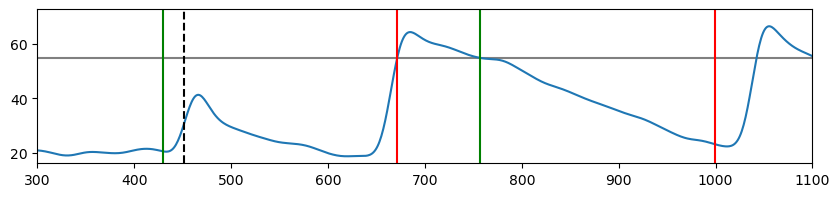

Filtering last event: 999 112
valid end point
3 2 3


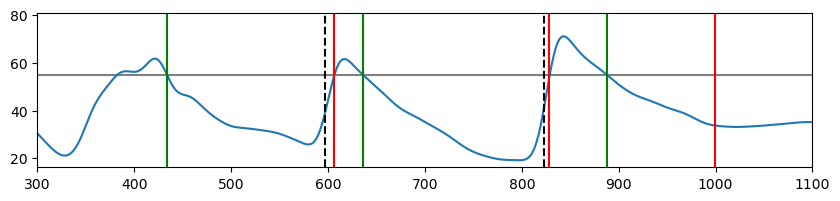

Filtering last event: 856 181
valid end point
3 3 2


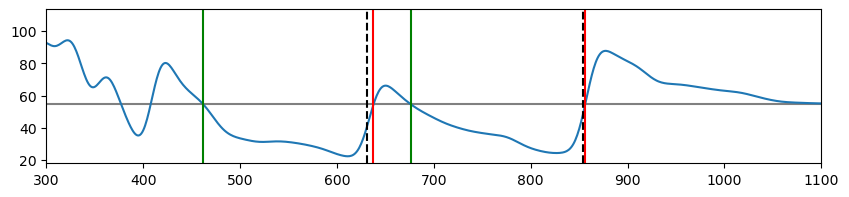

Filtering last event: 999 341
valid end point
3 4 2


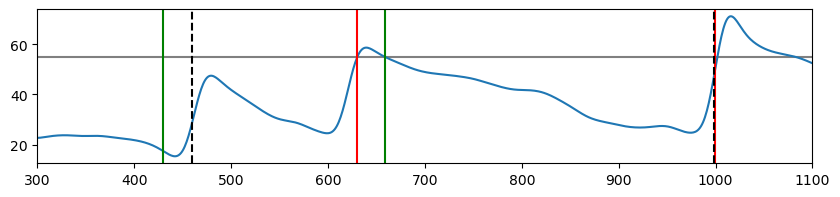

Filtering last event: 999 125
valid end point
3 5 2


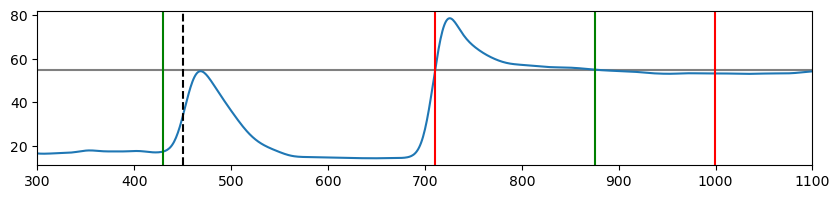

Filtering last event: 999 19
removing last event of length 19
3 6 1


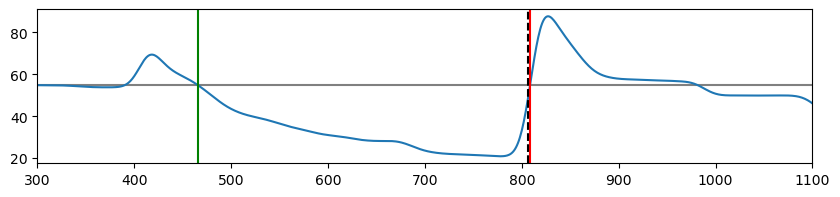

Filtering last event: 860 431
valid end point
3 7 1


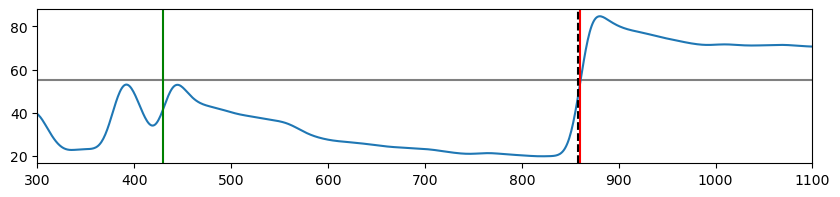

Filtering last event: 999 2
removing last event of length 2
3 8 1


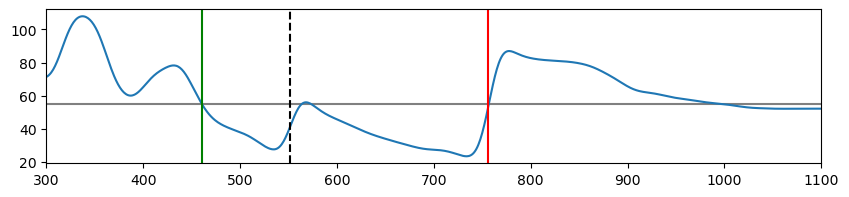

Filtering last event: 999 293
valid end point
3 9 2


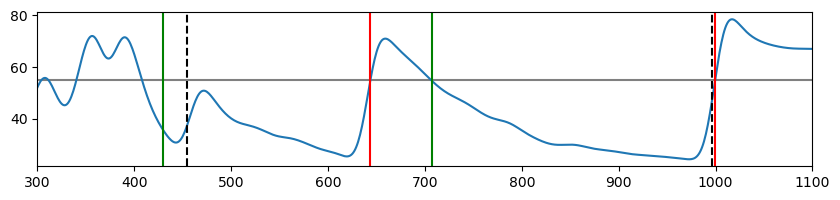

Filtering last event: 856 402
valid end point
3 10 1


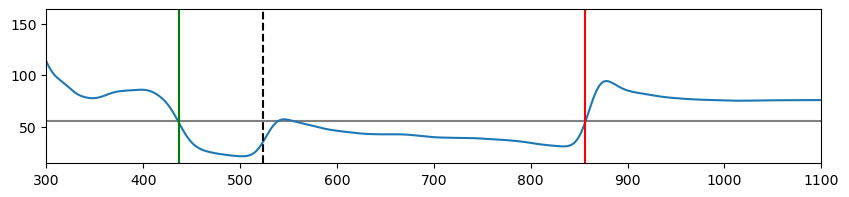

Filtering last event: 999 38
valid end point
4 1 3


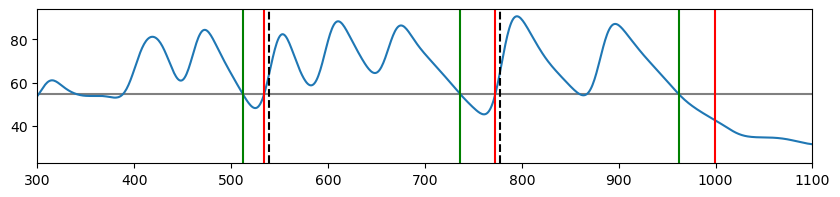

Filtering last event: 999 24
removing last event of length 24
4 2 2


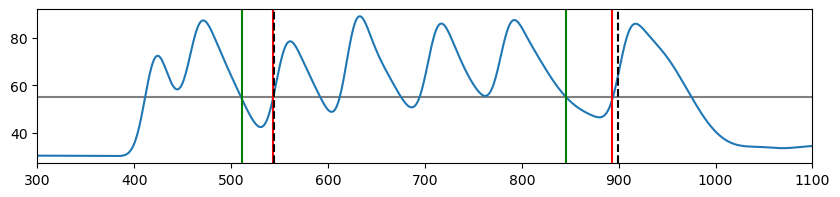

Filtering last event: 999 46
valid end point
4 3 5


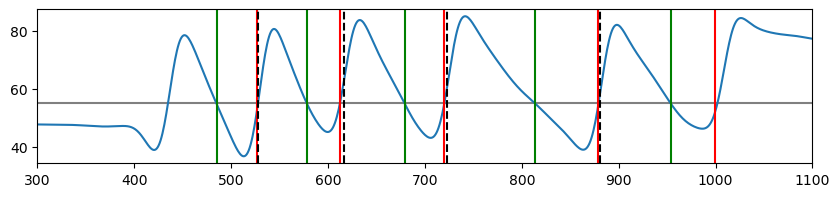

Filtering last event: 848 35
valid end point
4 4 1


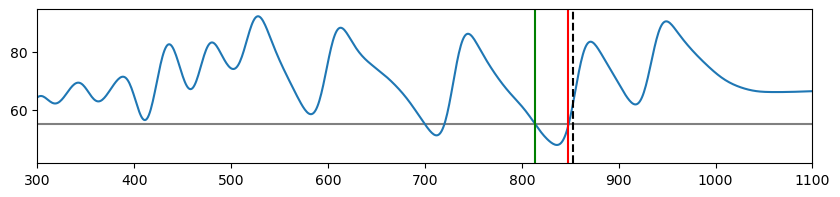

Filtering last event: 983 63
valid end point
4 5 2


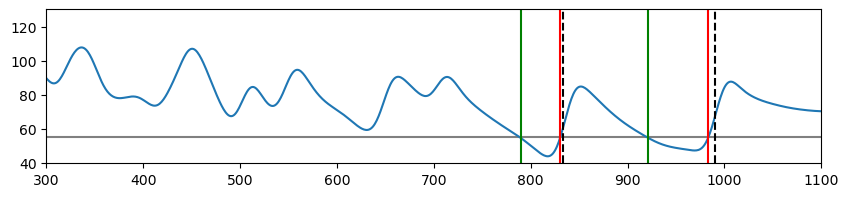

Filtering last event: 836 51
valid end point
4 6 1


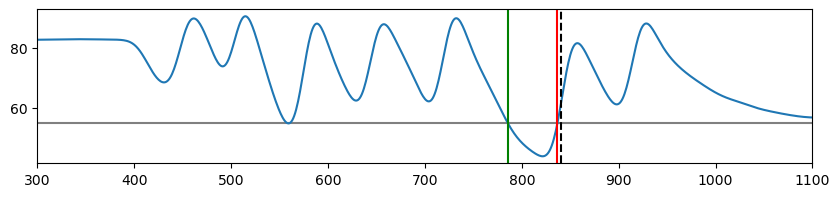

Filtering last event: 950 106
valid end point
4 7 3


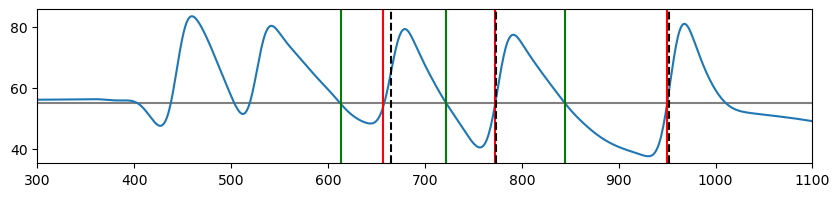

Filtering last event: 915 7
valid end point
4 8 3


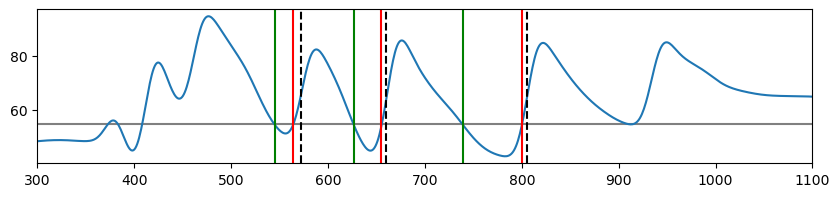

Filtering last event: 961 18
valid end point
4 9 1


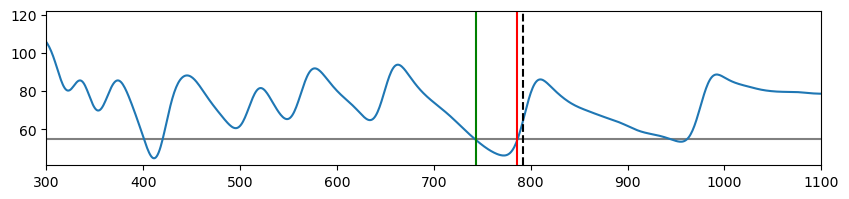

Filtering last event: 999 15
removing last event of length 15
4 10 0
Filtering last event: 999 127
valid end point
5 1 5


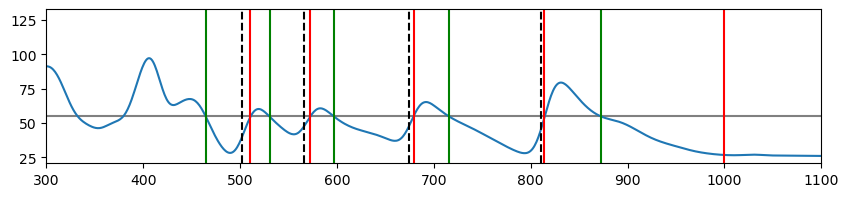

Filtering last event: 999 100
valid end point
5 2 3


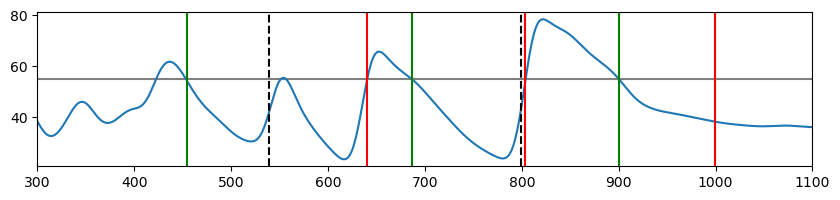

Filtering last event: 923 287
valid end point
5 3 2


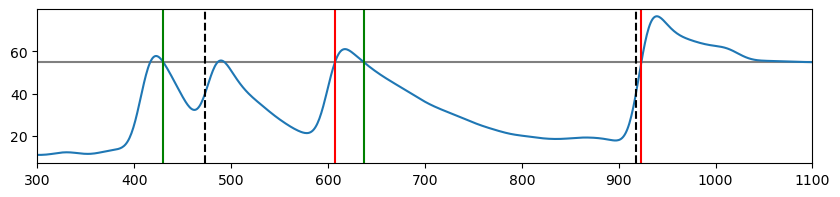

Filtering last event: 999 178
valid end point
5 4 3


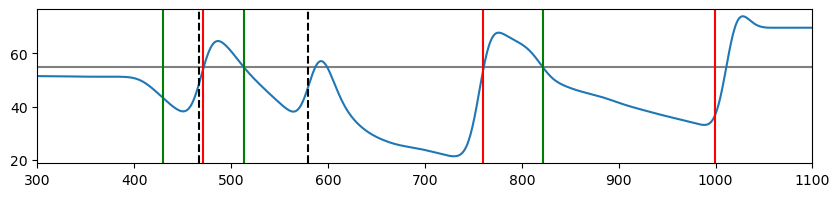

Filtering last event: 861 304
valid end point
5 5 2


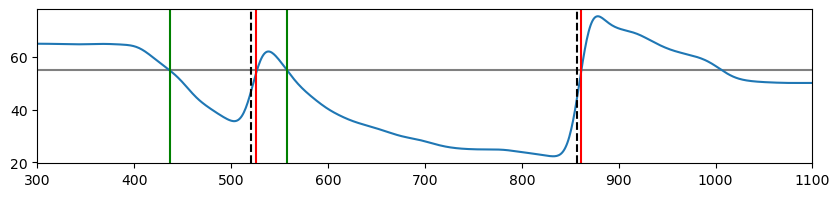

Filtering last event: 999 260
valid end point
5 6 3


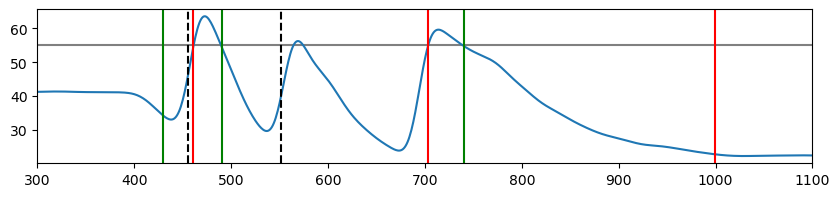

Filtering last event: 999 173
valid end point
5 7 3


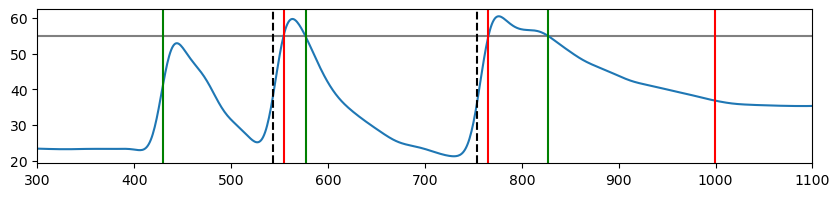

Filtering last event: 999 245
valid end point
5 8 3


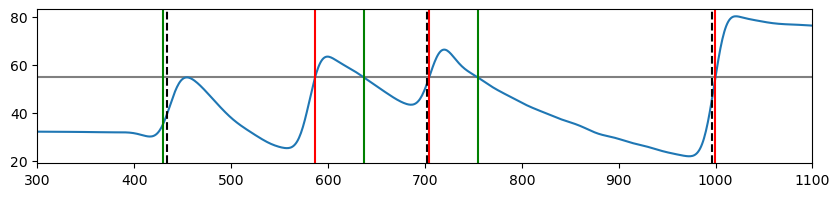

Filtering last event: 999 362
valid end point
5 9 3


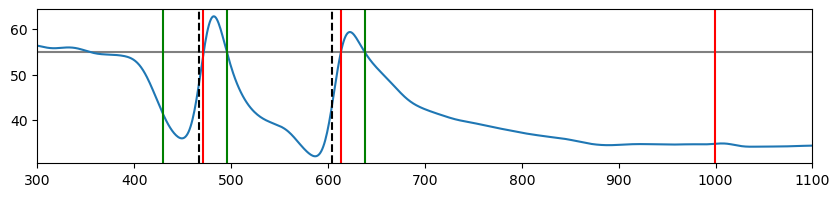

Filtering last event: 999 151
valid end point
5 10 3


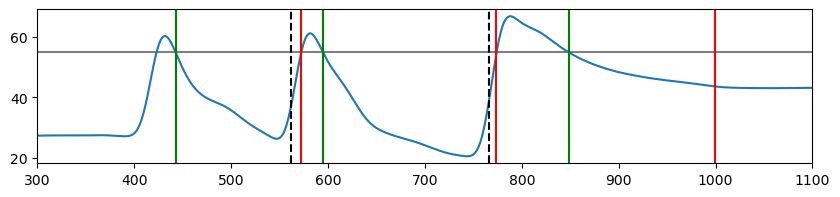

Filtering last event: 850 308
valid end point
6 1 2


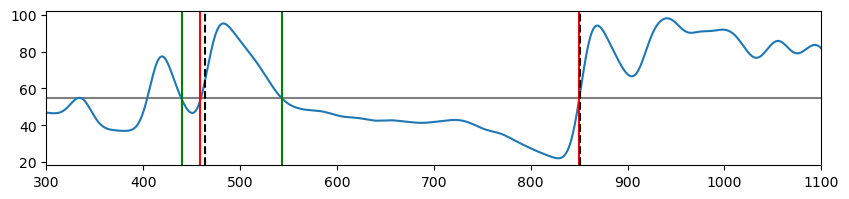

Filtering last event: 977 59
valid end point
6 2 4


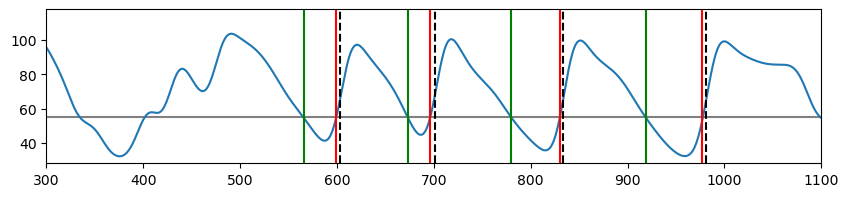

Filtering last event: 738 48
valid end point
6 4 2


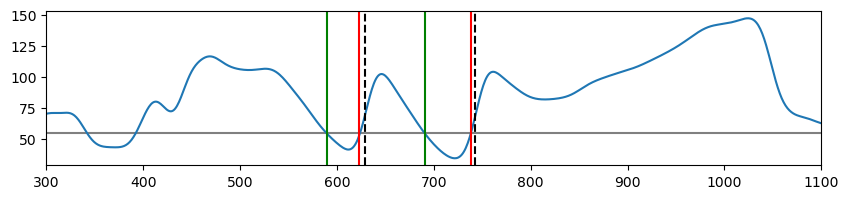

Filtering last event: 999 34
valid end point
6 5 4


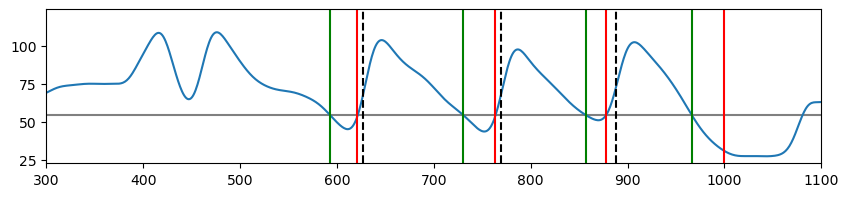

Filtering last event: 953 73
valid end point
6 6 2


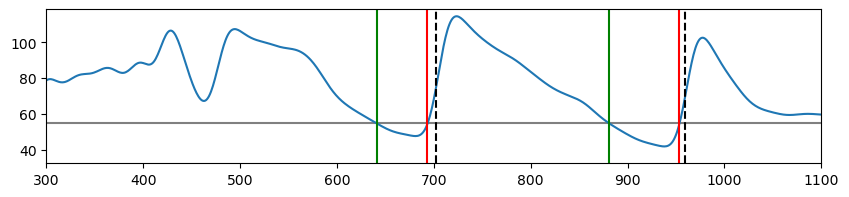

Filtering last event: 908 22
valid end point
6 7 1


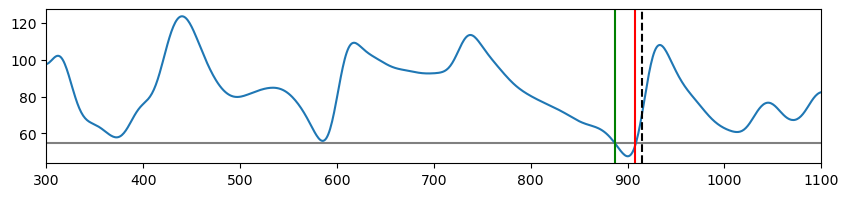

Filtering last event: 536 49
valid end point
6 8 1


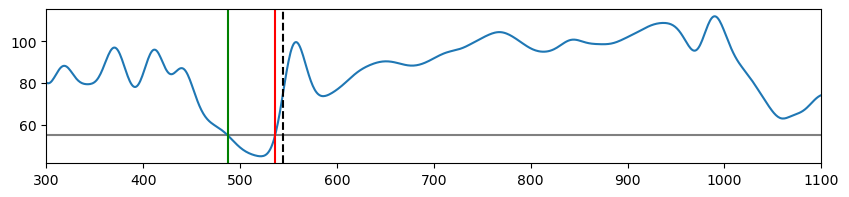

Filtering last event: 999 183
valid end point
6 9 1


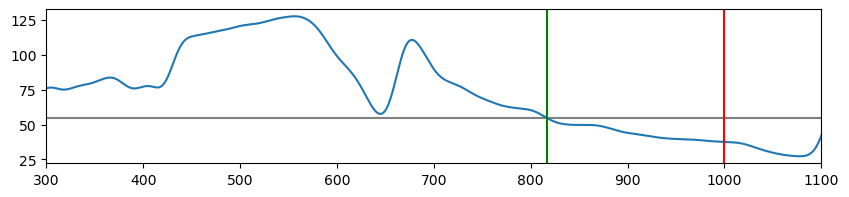

Filtering last event: 999 28
valid end point
7 1 3


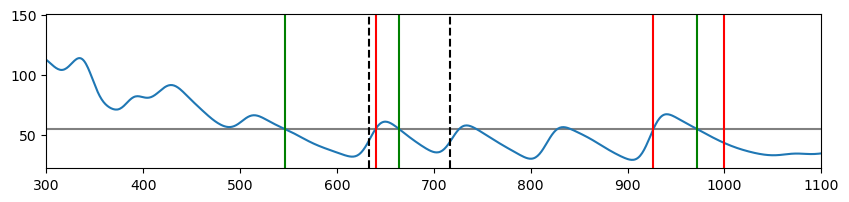

Filtering last event: 999 410
valid end point
7 2 1


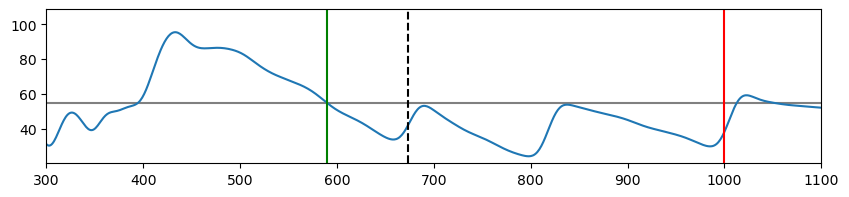

Filtering last event: 999 3
removing last event of length 3
7 3 2


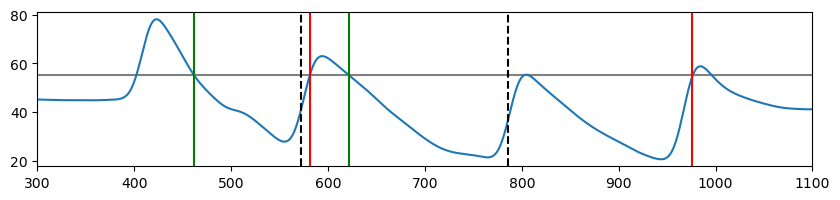

Filtering last event: 999 302
valid end point
7 4 2


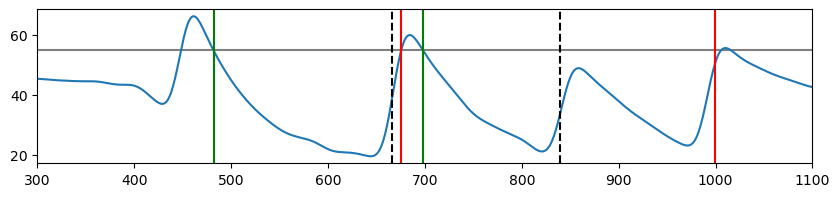

Filtering last event: 991 143
valid end point
7 5 2


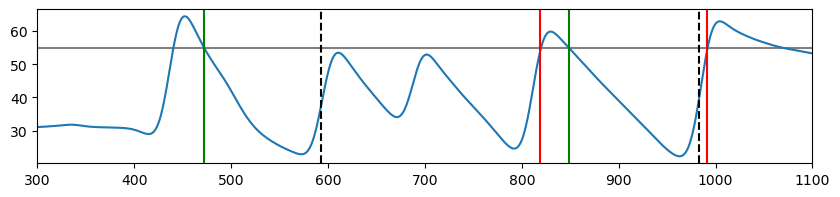

Filtering last event: 999 521
valid end point
7 6 2


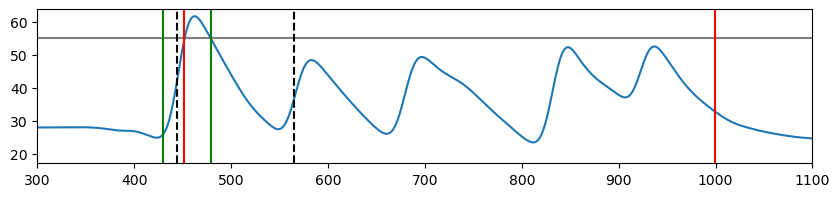

Filtering last event: 999 535
valid end point
7 7 1


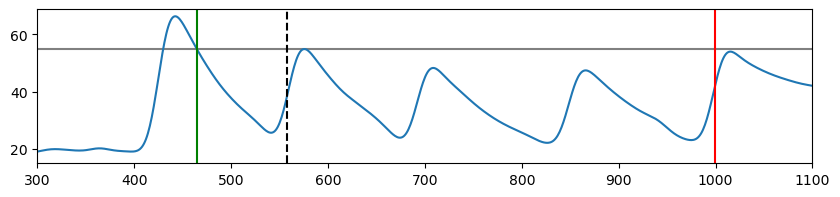

Filtering last event: 999 505
valid end point
7 8 2


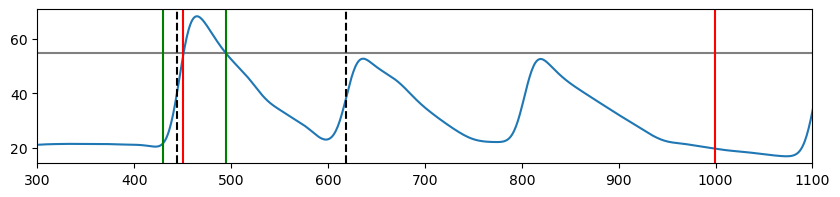

Filtering last event: 999 551
valid end point
7 9 1


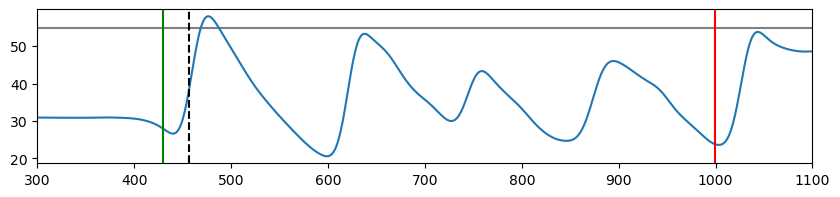

Filtering last event: 999 536
valid end point
7 10 1


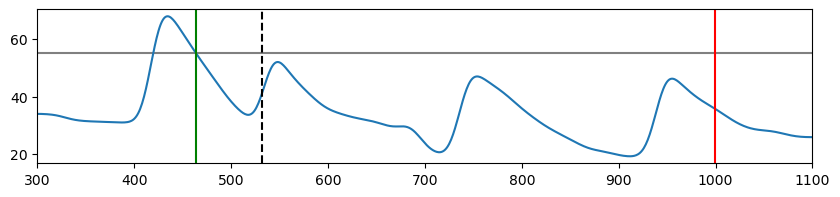

Filtering last event: 999 54
valid end point
1 1 3


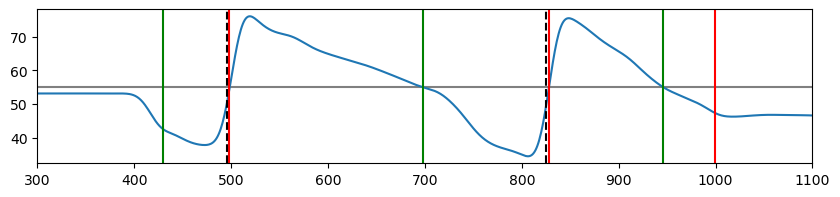

Filtering last event: 999 76
valid end point
1 2 3


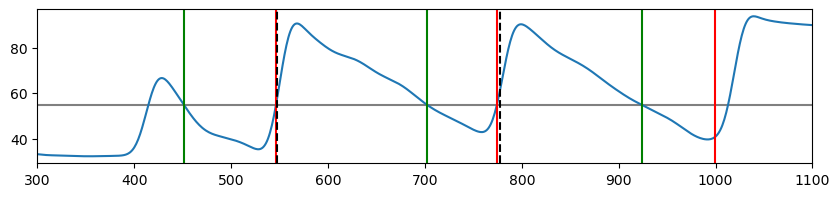

Filtering last event: 956 22
valid end point
1 3 3


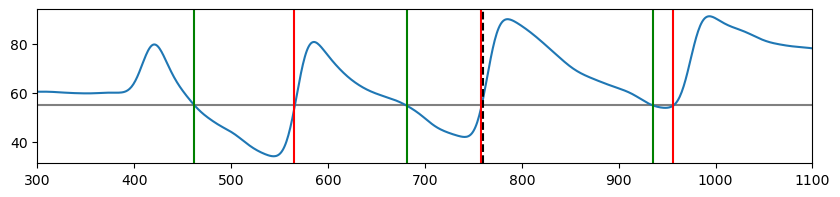

Filtering last event: 999 46
valid end point
1 4 3


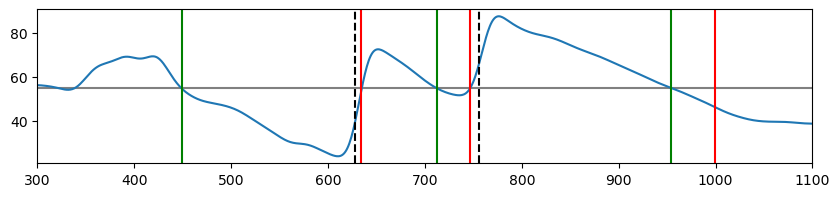

Filtering last event: 865 50
valid end point
1 5 2


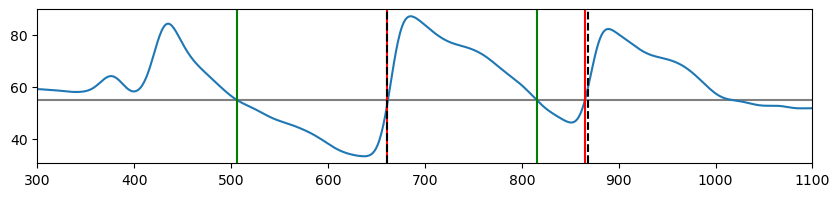

Filtering last event: 868 157
valid end point
1 6 2


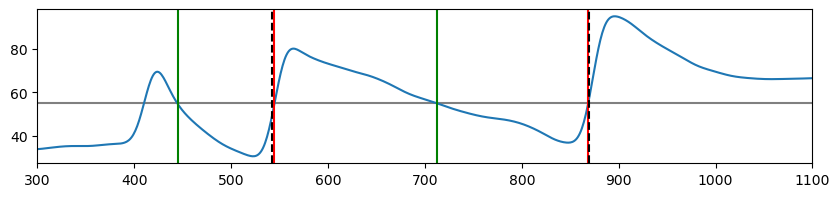

Filtering last event: 820 47
valid end point
1 7 2


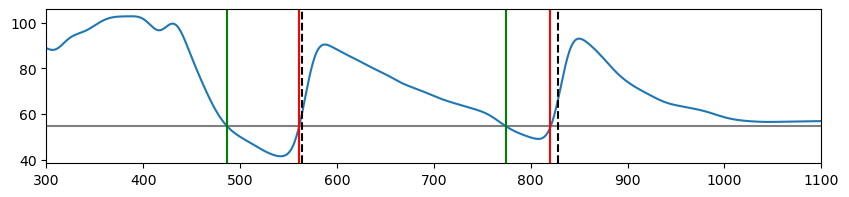

Filtering last event: 814 35
valid end point
1 8 2


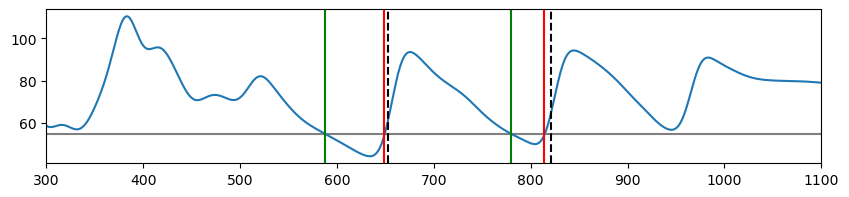

Filtering last event: 800 15
valid end point
1 9 1


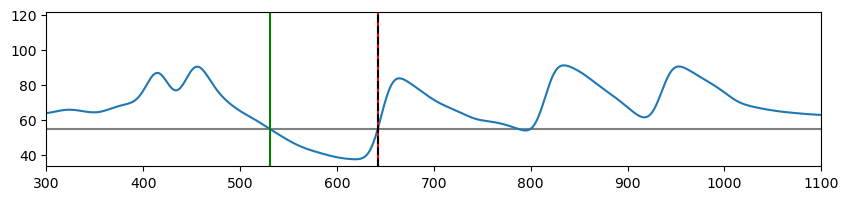

Filtering last event: 880 15
valid end point
1 10 1


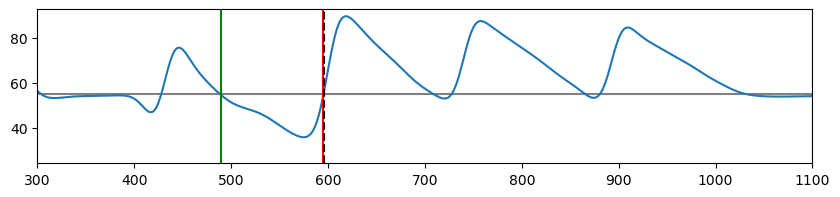

Filtering last event: 631 162
valid end point
2 1 1


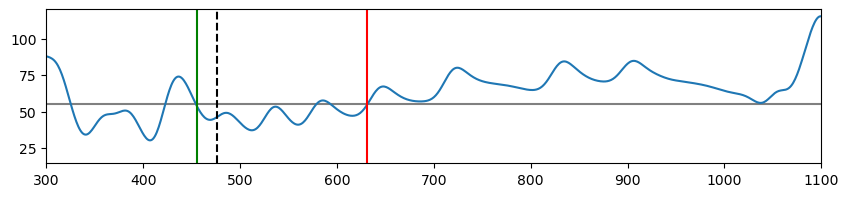

Filtering last event: 858 46
valid end point
2 2 3


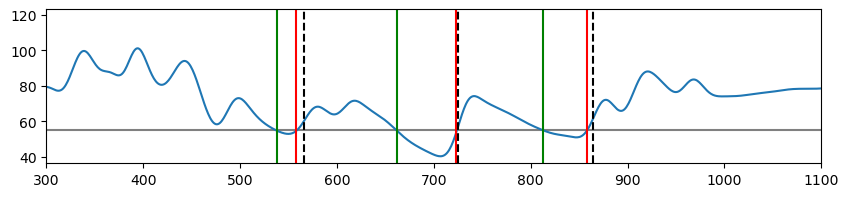

Filtering last event: 999 127
valid end point
2 3 4


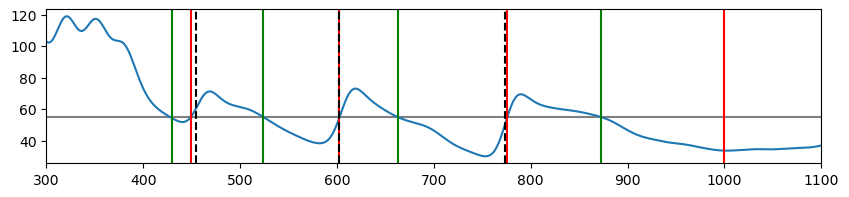

Filtering last event: 999 258
valid end point
2 4 2


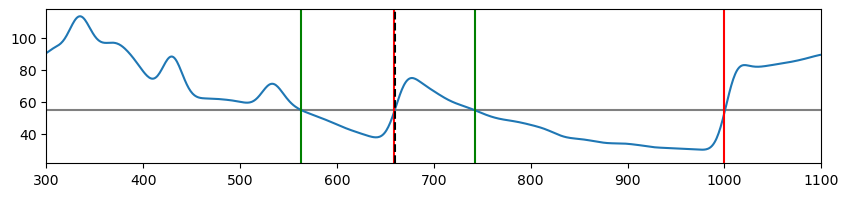

Filtering last event: 981 183
valid end point
2 5 2


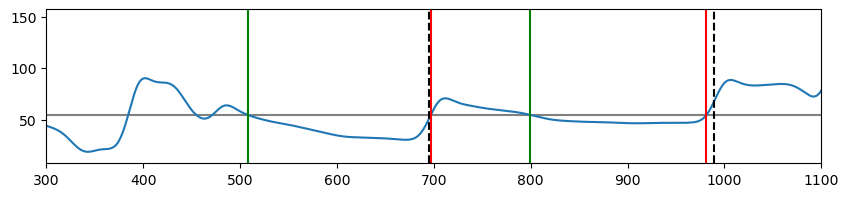

Filtering last event: 999 373
valid end point
2 6 2


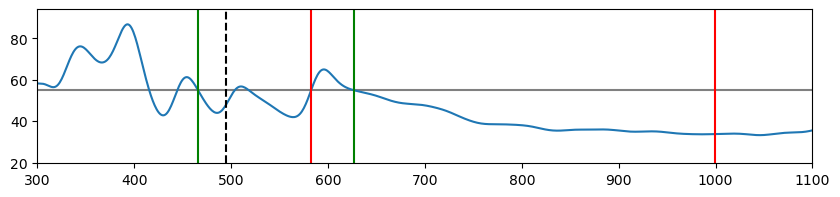

Filtering last event: 999 405
valid end point
2 7 3


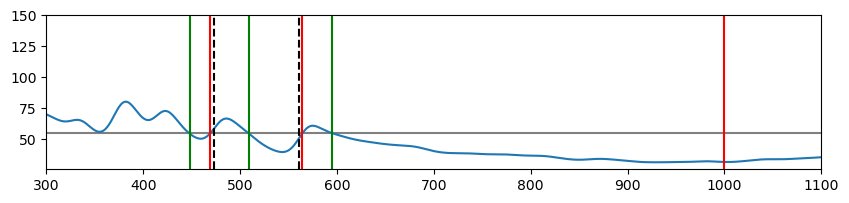

Filtering last event: 843 154
valid end point
2 8 3


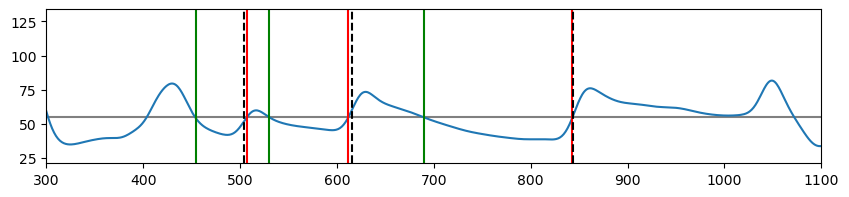

Filtering last event: 999 41
valid end point
2 9 3


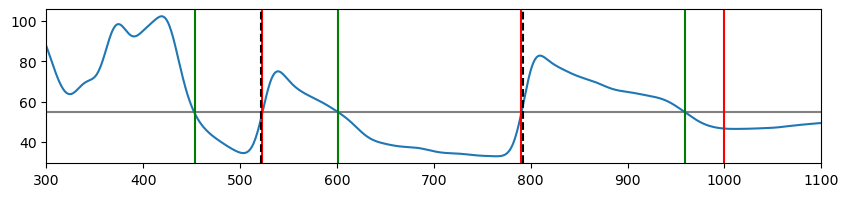

Filtering last event: 842 173
valid end point
2 10 2


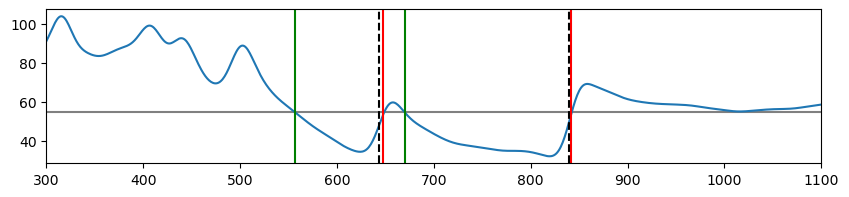

Filtering last event: 764 91
valid end point
3 1 2


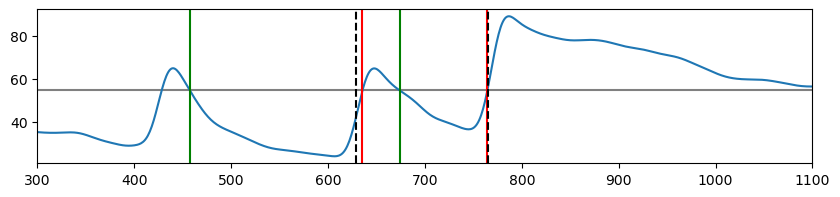

Filtering last event: 957 210
valid end point
3 2 3


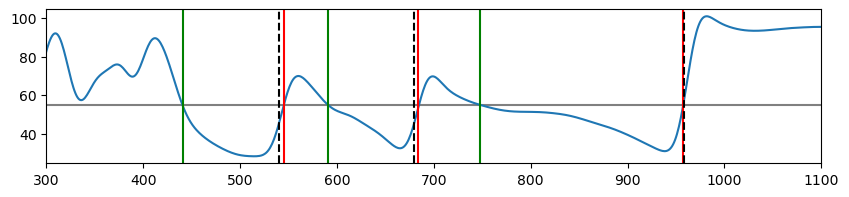

Filtering last event: 999 59
valid end point
3 3 2


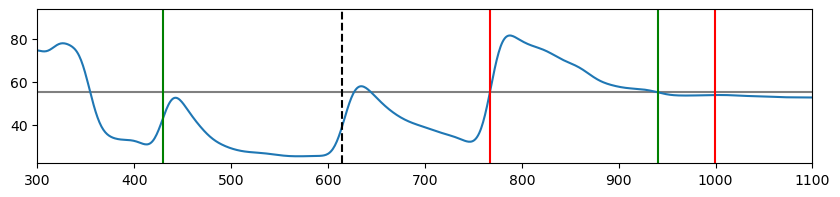

Filtering last event: 999 337
valid end point
3 4 2


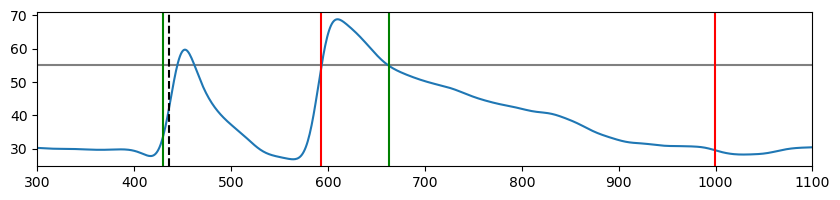

Filtering last event: 999 265
valid end point
3 5 2


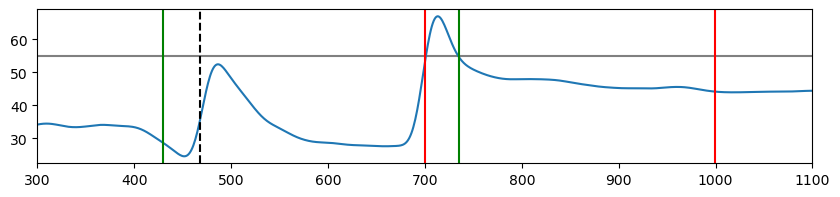

Filtering last event: 999 422
valid end point
3 6 1


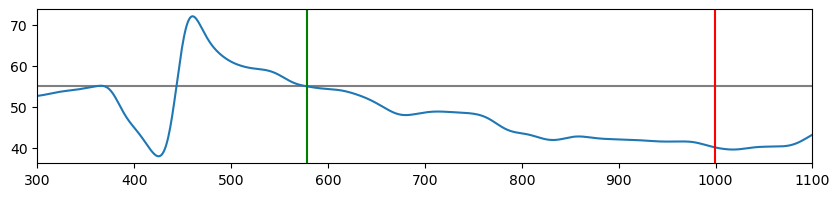

Filtering last event: 999 77
valid end point
3 7 2


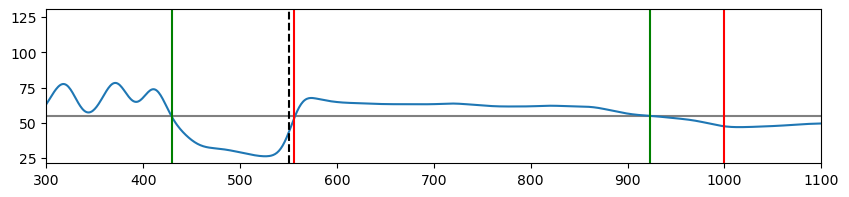

Filtering last event: 999 370
valid end point
3 8 2


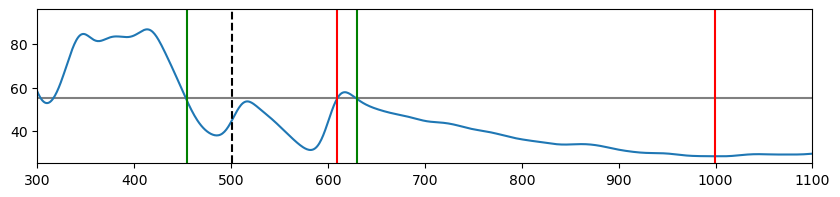

Filtering last event: 778 310
valid end point
3 9 1


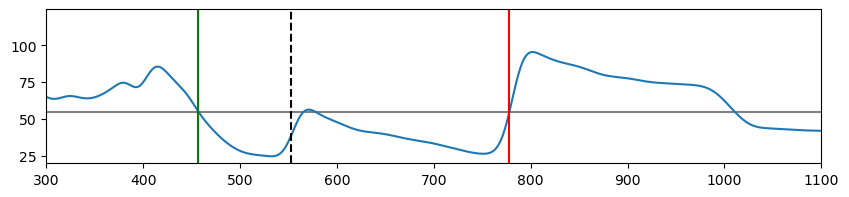

Filtering last event: 999 399
valid end point
3 10 2


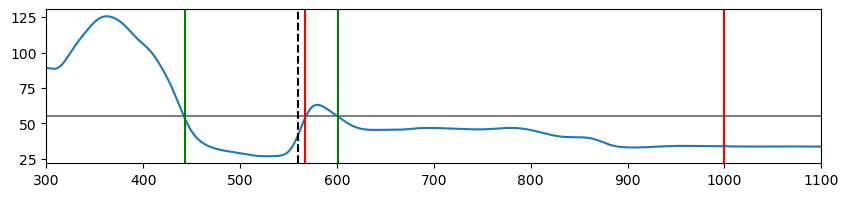

Filtering last event: 972 96
valid end point
4 1 2


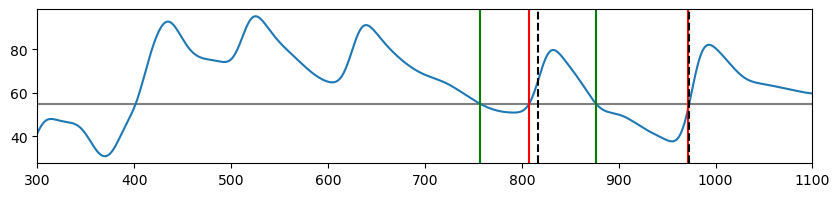

Filtering last event: 506 6
valid end point
4 2 0
Filtering last event: 972 30
valid end point
4 3 4


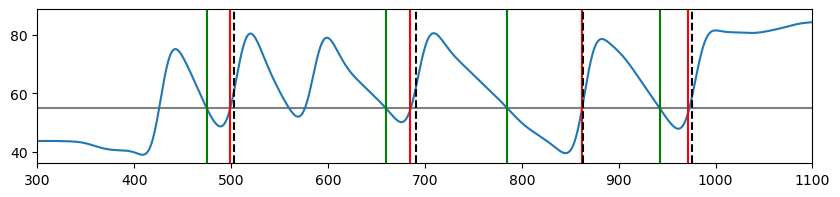

Filtering last event: 834 105
valid end point
4 4 2


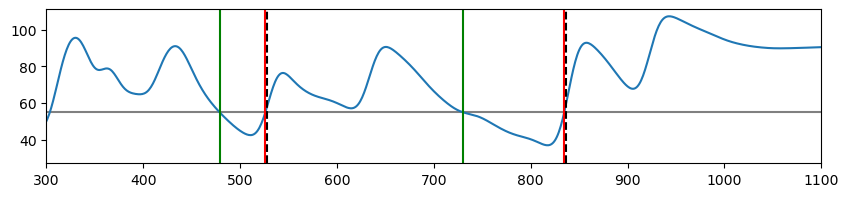

Filtering last event: 808 83
valid end point
4 5 2


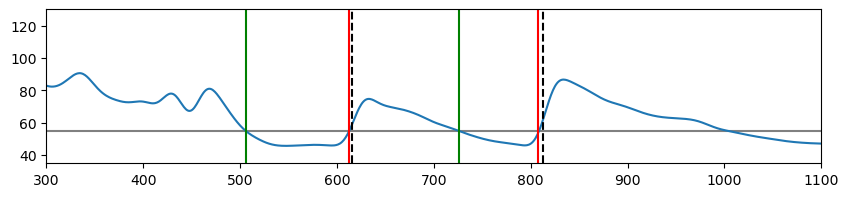

Filtering last event: 999 109
valid end point
4 6 3


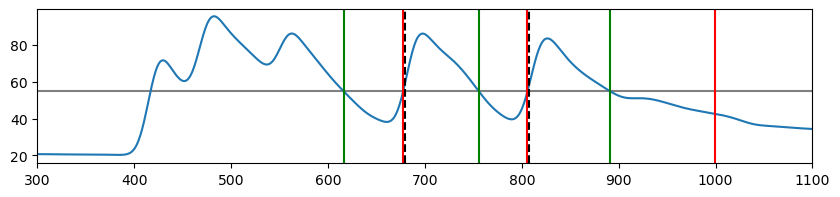

Filtering last event: 925 44
valid end point
4 7 2


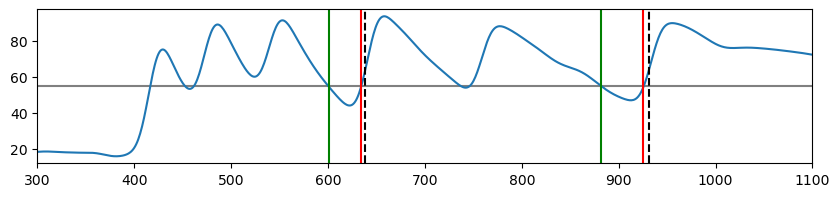

Filtering last event: 999 37
valid end point
4 8 3


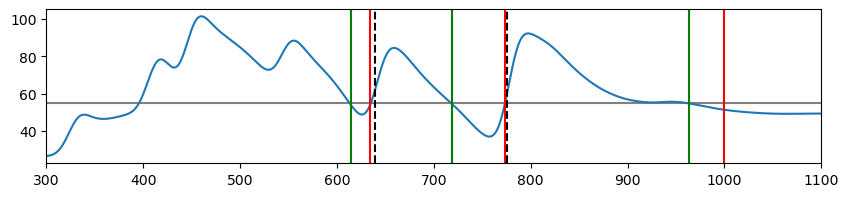

Filtering last event: 617 97
valid end point
4 9 1


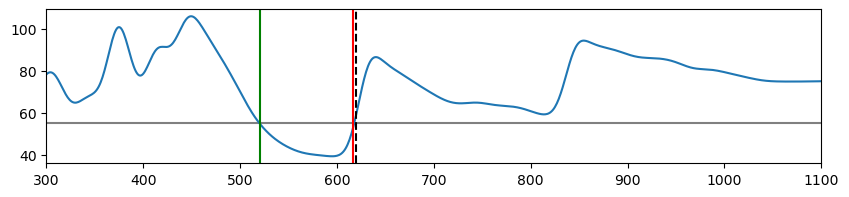

Filtering last event: 999 85
valid end point
4 10 3


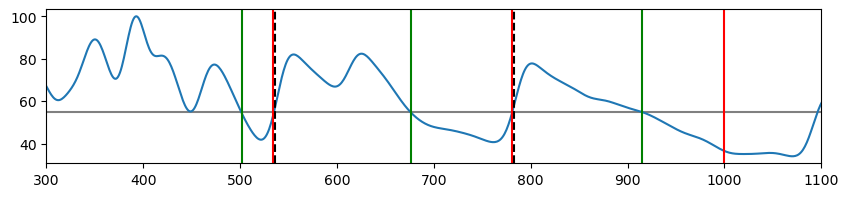

Filtering last event: 878 72
valid end point
5 1 3


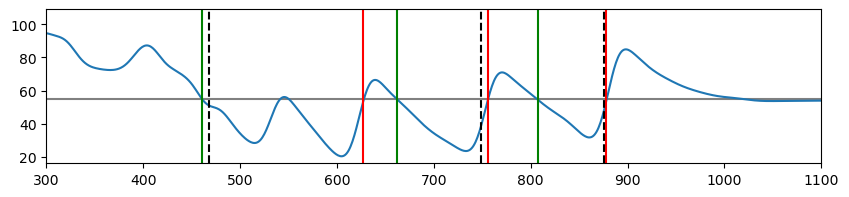

Filtering last event: 999 86
valid end point
5 2 4


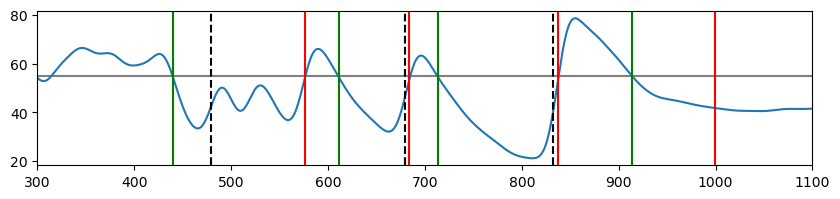

Filtering last event: 999 71
valid end point
5 3 3


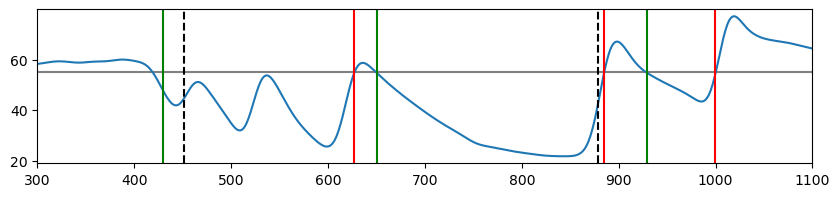

Filtering last event: 999 180
valid end point
5 4 2


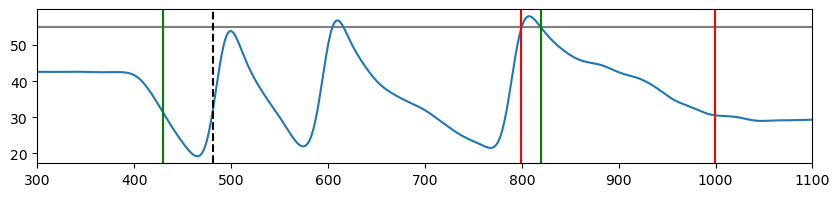

Filtering last event: 999 3
removing last event of length 3
5 5 2


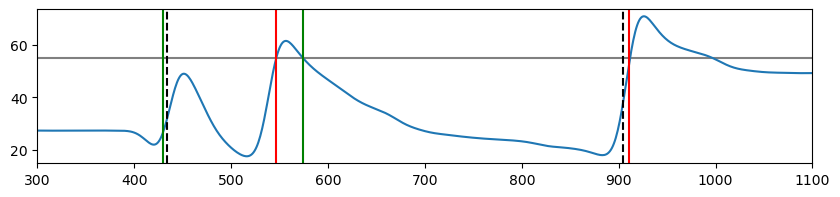

Filtering last event: 999 201
valid end point
5 6 2


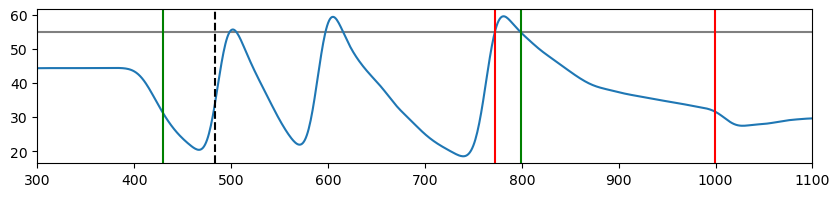

Filtering last event: 999 560
valid end point
5 7 1


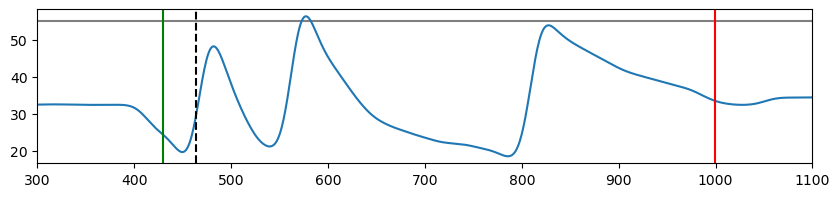

Filtering last event: 999 43
valid end point
5 8 3


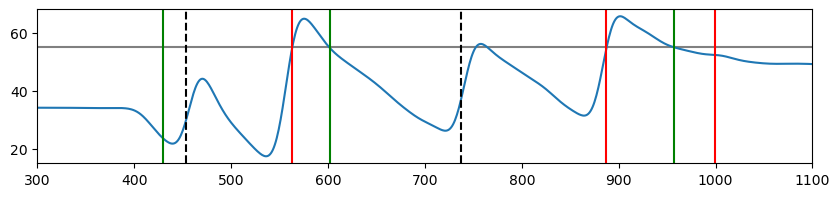

Filtering last event: 999 414
valid end point
5 9 2


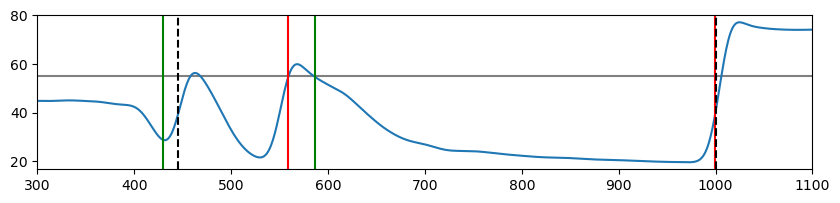

Filtering last event: 999 532
valid end point
5 10 1


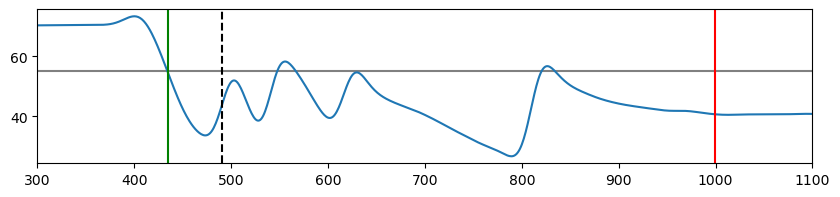

Filtering last event: 901 125
valid end point
6 1 2


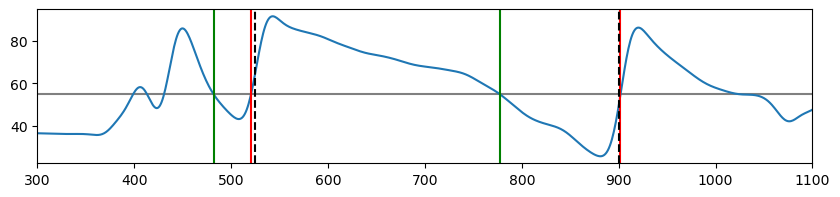

Filtering last event: 993 54
valid end point
6 2 5


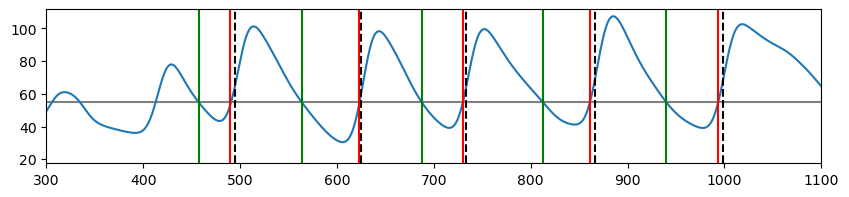

Filtering last event: 466 31
valid end point
6 3 1


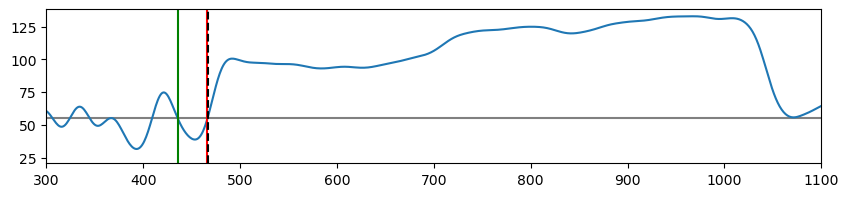

Filtering last event: 684 46
valid end point
6 4 2


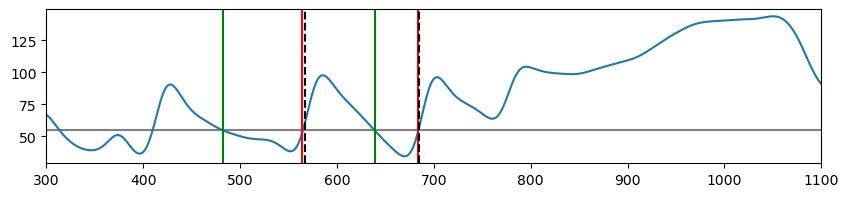

Filtering last event: 999 15
removing last event of length 15
6 5 4


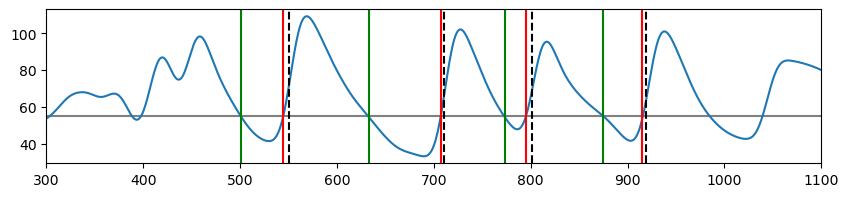

Filtering last event: 828 179
valid end point
6 6 2


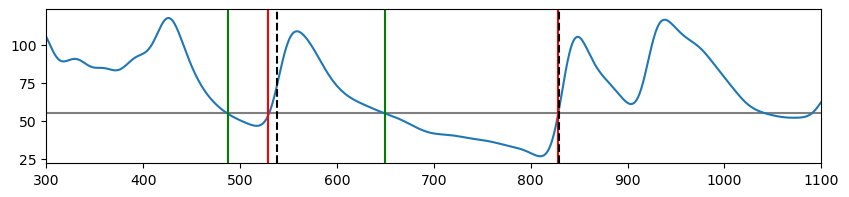

Filtering last event: 999 36
valid end point
6 7 3


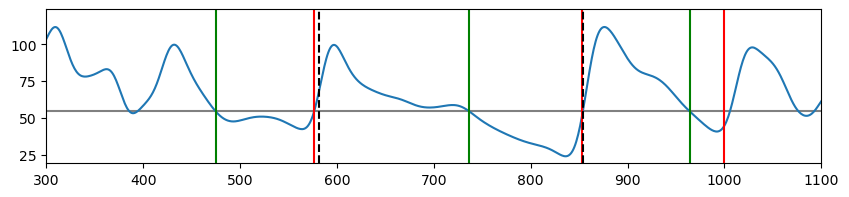

Filtering last event: 999 8
removing last event of length 8
6 8 1


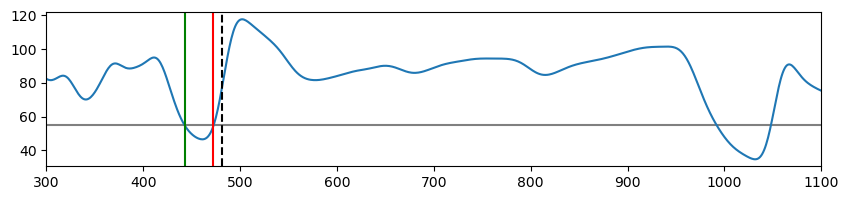

Filtering last event: 999 285
valid end point
6 9 2


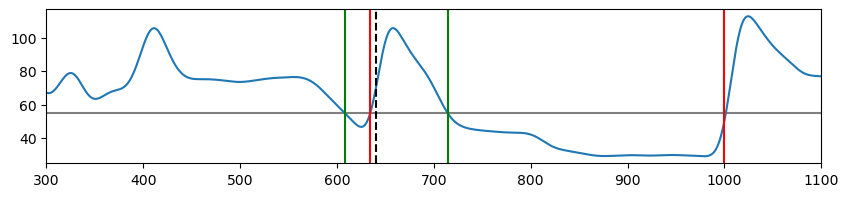

Filtering last event: 751 38
valid end point
6 10 1


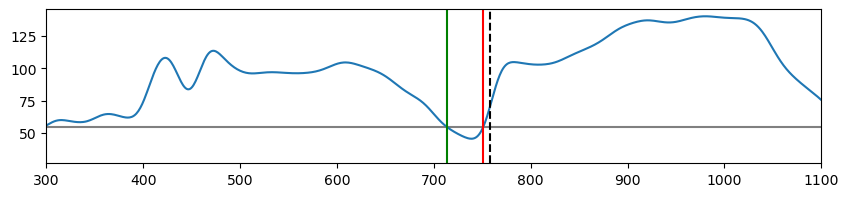

Filtering last event: 996 102
valid end point
7 1 2


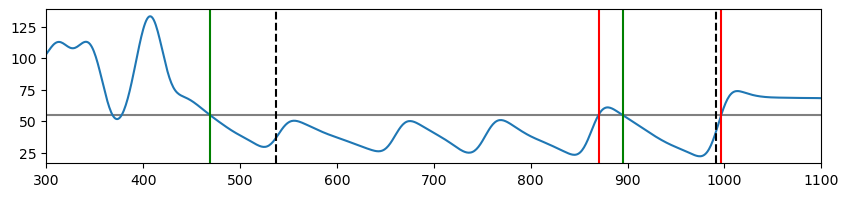

Filtering last event: 999 466
valid end point
7 2 1


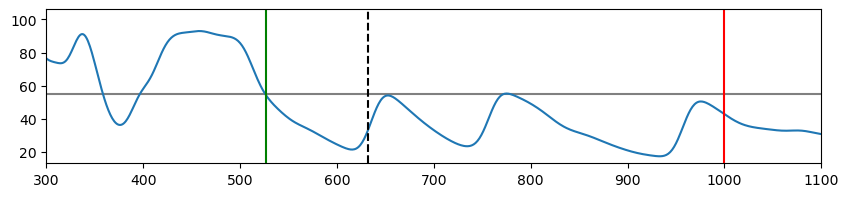

Filtering last event: 999 14
removing last event of length 14
7 3 2


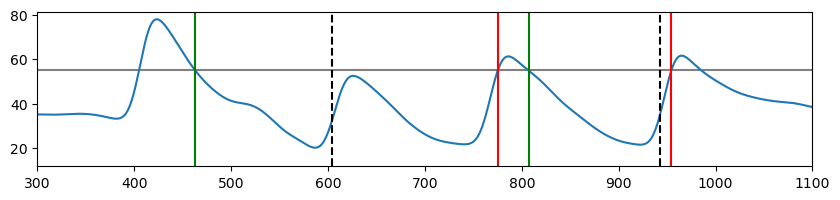

Filtering last event: 999 525
valid end point
7 4 1


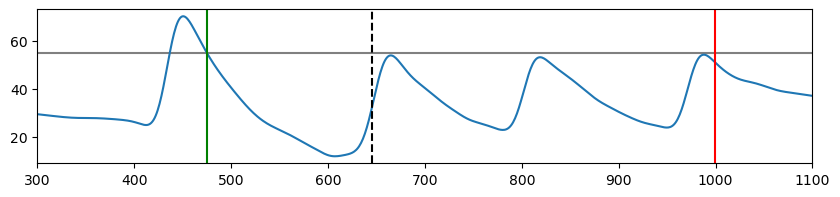

Filtering last event: 999 531
valid end point
7 5 1


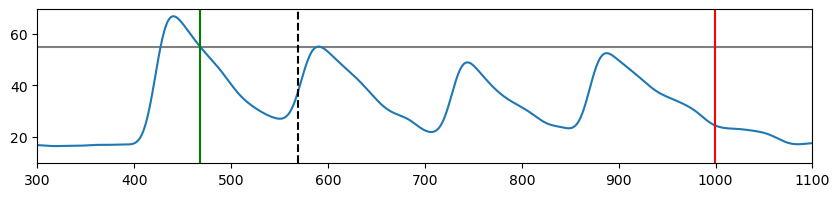

Filtering last event: 999 537
valid end point
7 6 1


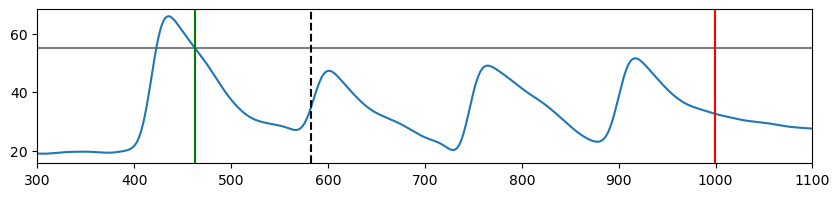

Filtering last event: 999 543
valid end point
7 7 1


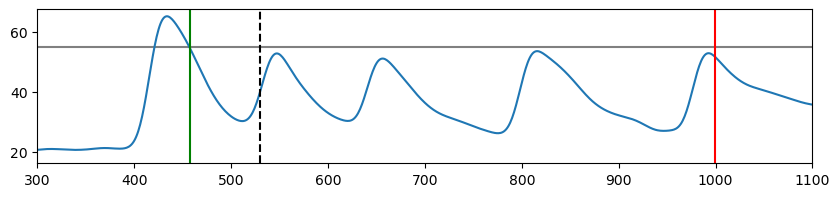

Filtering last event: 999 511
valid end point
7 8 1


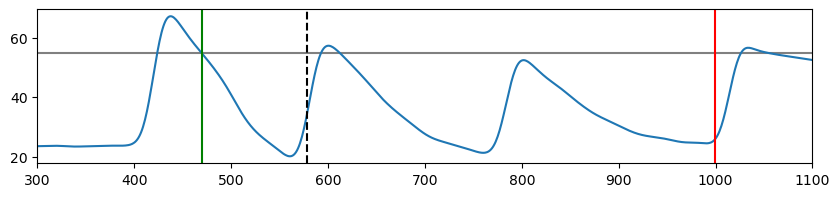

Filtering last event: 999 541
valid end point
7 9 1


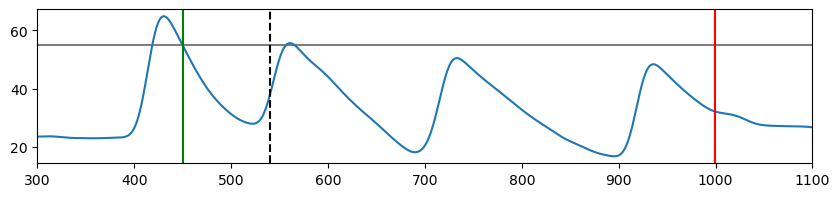

Filtering last event: 999 494
valid end point
7 10 2


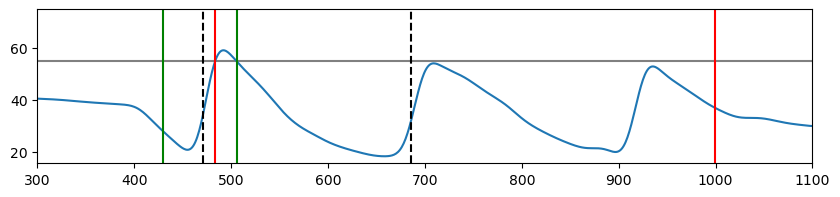

In [ ]:
ang_name = 'C_flex'
count_SIZ_reached_MDN_L3, swing_events_within_SIZ_MDN_L3, percentage_MDN_L3, dwell_time_MDN_L3 = get_stepping_params_Hleg(MDN,'L3','L3'+ang_name, swing_ts_MDN_L3 )
count_SIZ_reached_MDN_R3, swing_events_within_SIZ_MDN_R3, percentage_MDN_R3, dwell_time_MDN_R3 = get_stepping_params_Hleg(MDN,'R3','R3'+ang_name, swing_ts_MDN_R3 )

Filtering last event: 999 510
valid end point
2 1 1


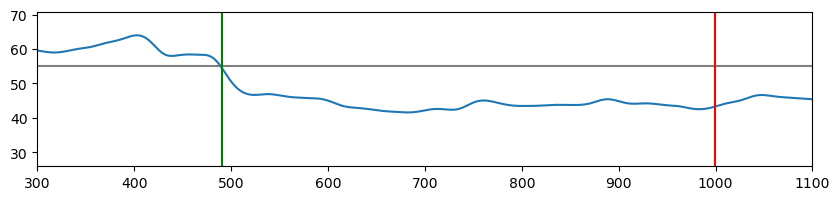

Filtering last event: 999 563
valid end point
2 2 1


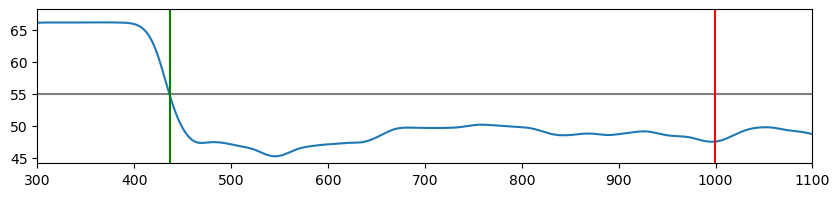

Filtering last event: 999 570
valid end point
2 3 1


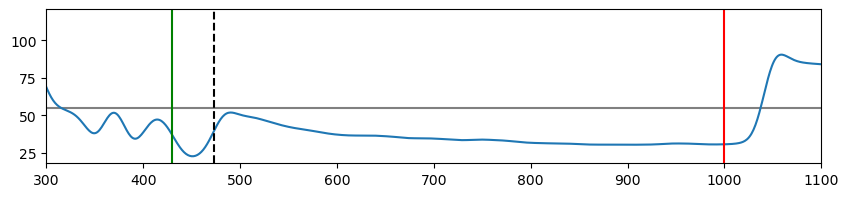

Filtering last event: 577 148
valid end point
2 4 1


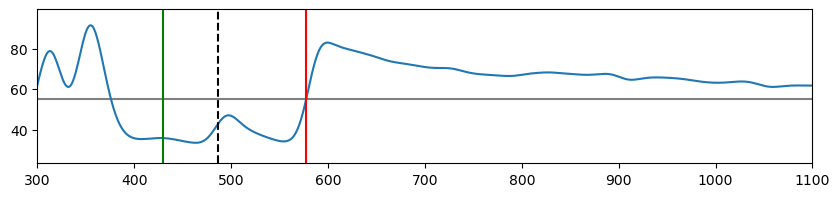

Filtering last event: 999 556
valid end point
2 5 1


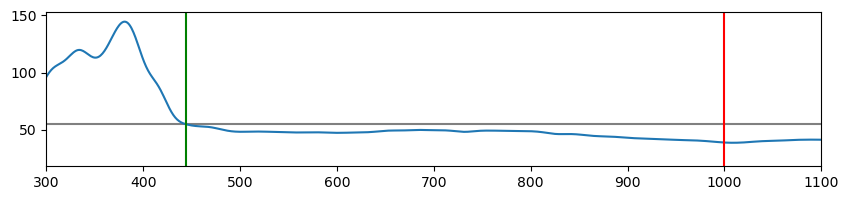

Filtering last event: 679 250
valid end point
2 6 1


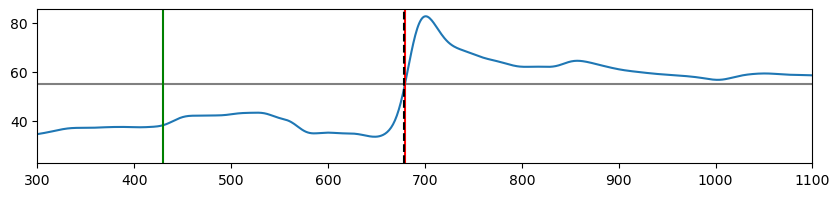

Filtering last event: 818 244
valid end point
2 7 2


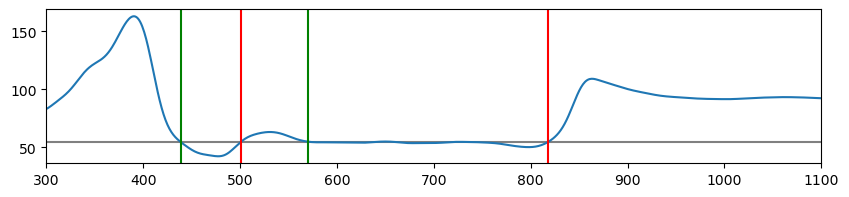

Filtering last event: 736 174
valid end point
2 8 1


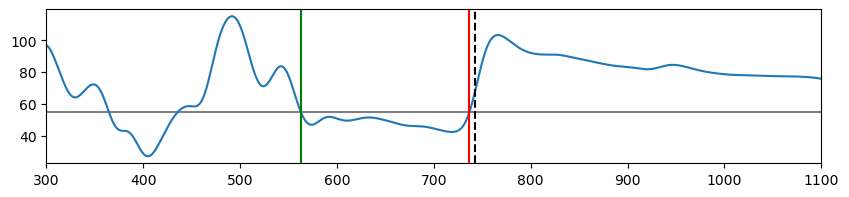

Filtering last event: 999 570
valid end point
2 9 1


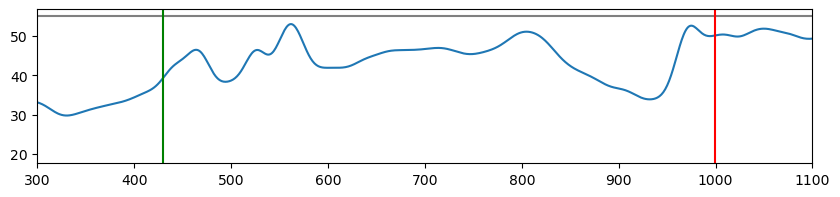

Filtering last event: 999 542
valid end point
2 10 1


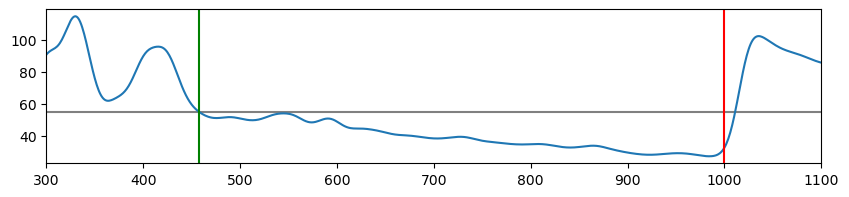

Filtering last event: 515 38
valid end point
3 1 1


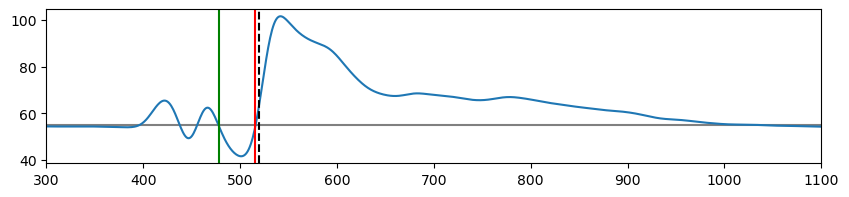

Filtering last event: 999 233
valid end point
3 2 2


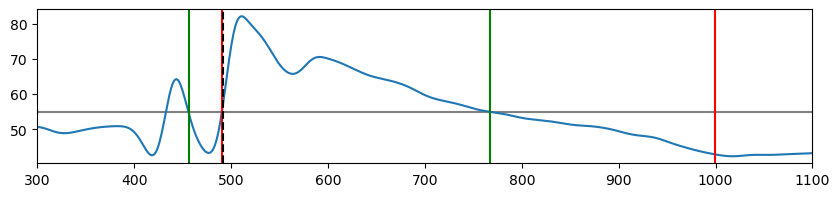

Filtering last event: 999 262
valid end point
3 3 2


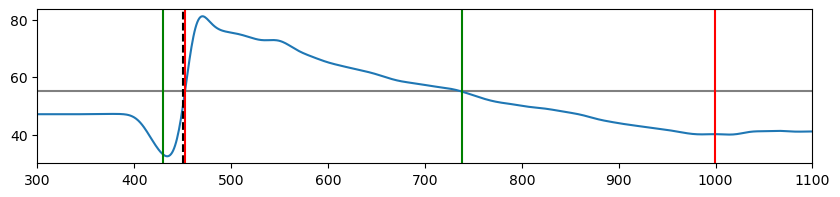

Filtering last event: 718 196
valid end point
3 4 1


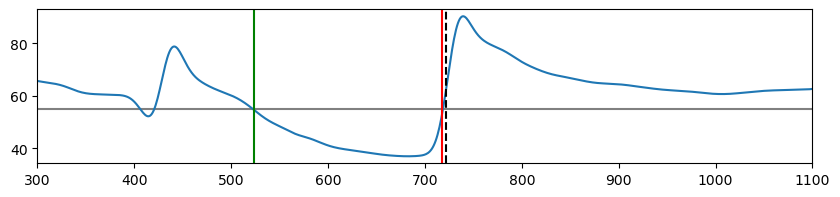

Filtering last event: 513 79
valid end point
3 5 1


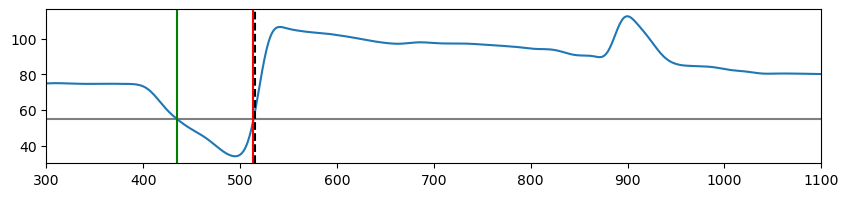

Filtering last event: 687 43
valid end point
3 6 1


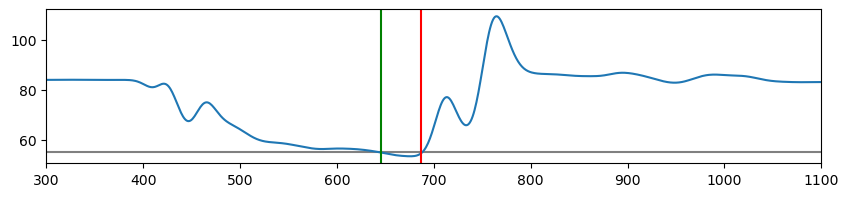

Filtering last event: 864 284
valid end point
3 7 1


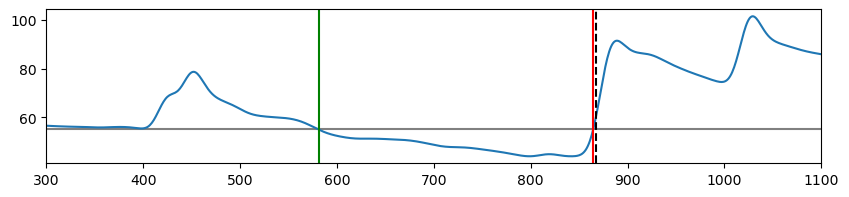

Filtering last event: 992 65
valid end point
3 8 2


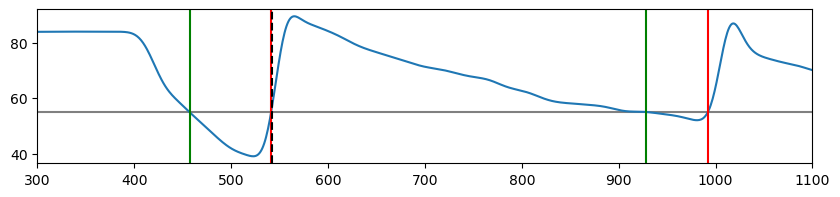

Filtering last event: 772 99
valid end point
3 9 2


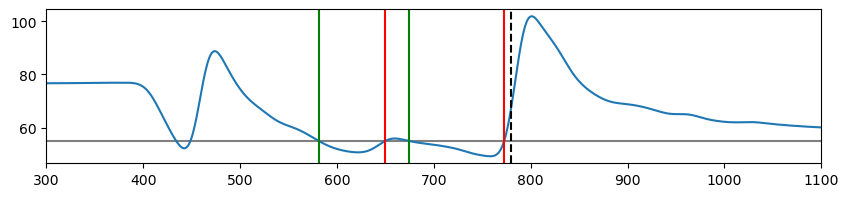

Filtering last event: 979 176
valid end point
3 10 2


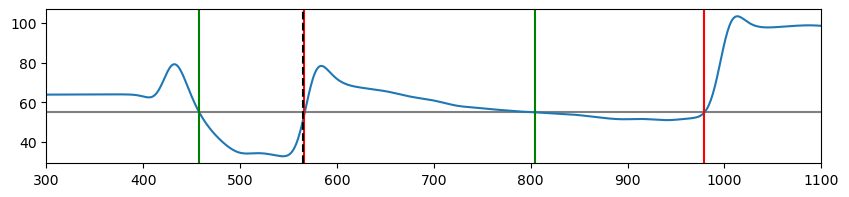

Filtering last event: 980 118
valid end point
5 1 3


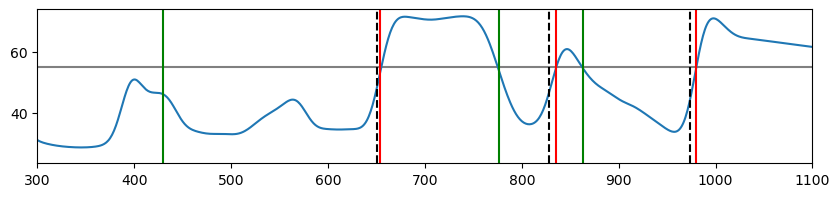

Filtering last event: 999 570
valid end point
5 2 1


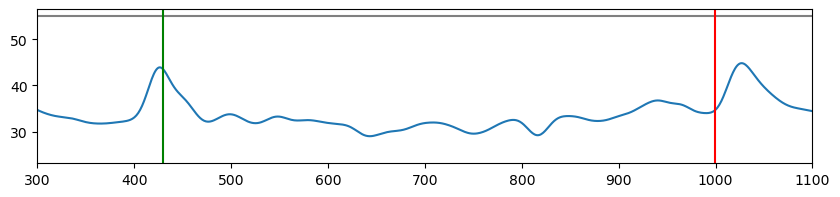

Filtering last event: 999 570
valid end point
5 3 1


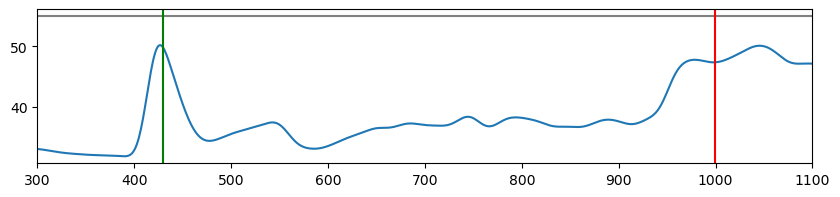

Filtering last event: 999 570
valid end point
5 4 1


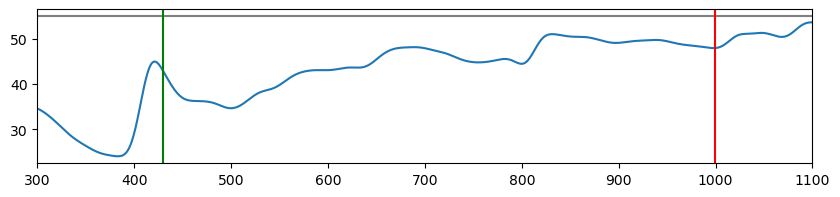

Filtering last event: 999 570
valid end point
5 5 1


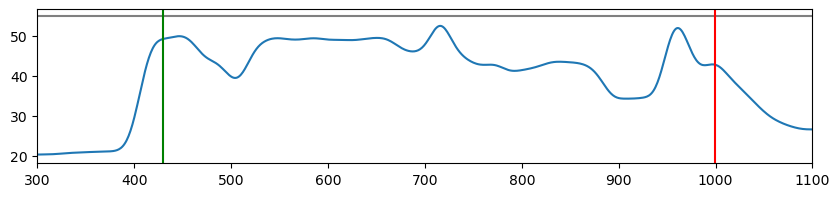

Filtering last event: 813 39
valid end point
5 7 2


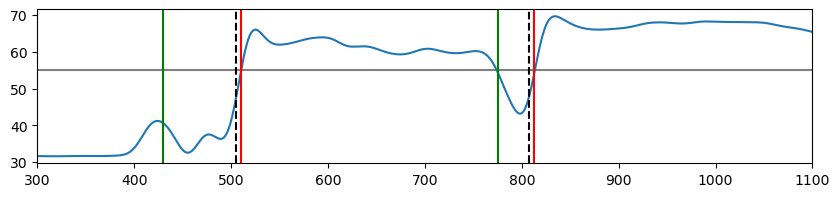

Filtering last event: 592 163
valid end point
5 8 1


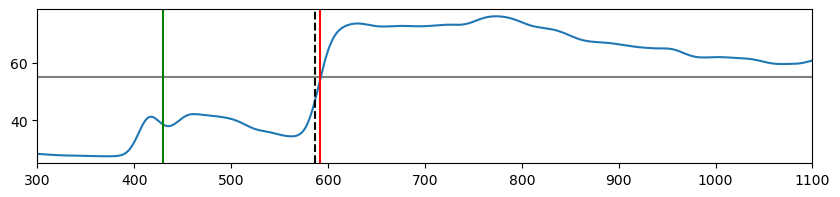

Filtering last event: 999 570
valid end point
5 9 1


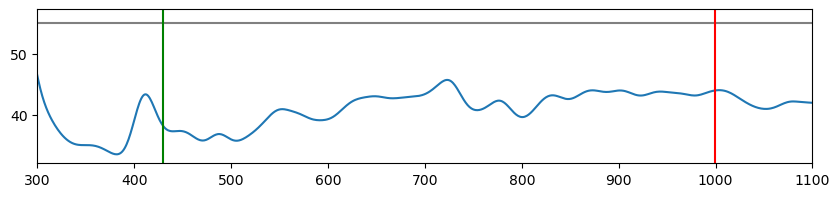

Filtering last event: 764 335
valid end point
5 10 1


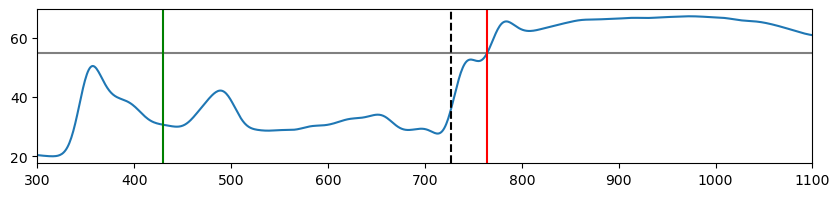

Filtering last event: 536 99
valid end point
6 1 1


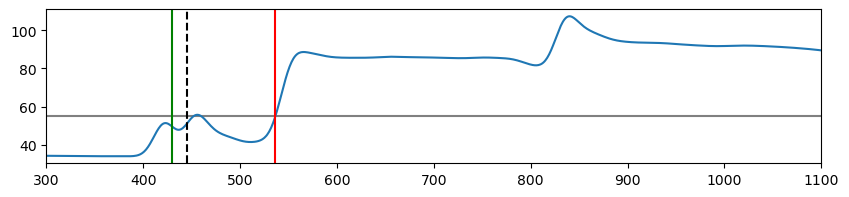

Filtering last event: 622 40
valid end point
6 2 2


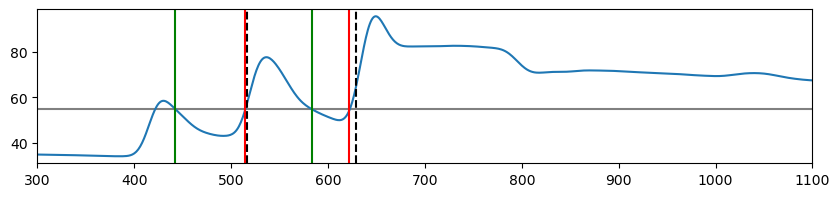

Filtering last event: 489 21
valid end point
6 3 1


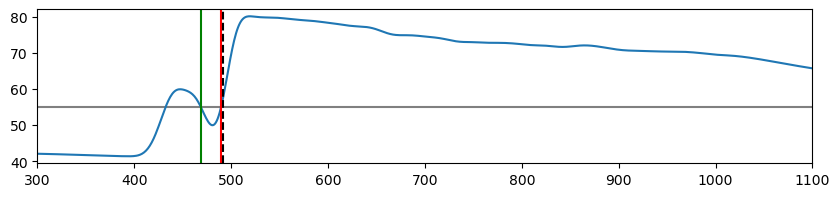

Filtering last event: 956 507
valid end point
6 4 1


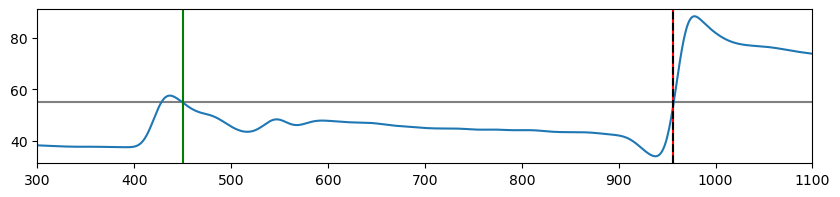

Filtering last event: 999 219
valid end point
6 5 2


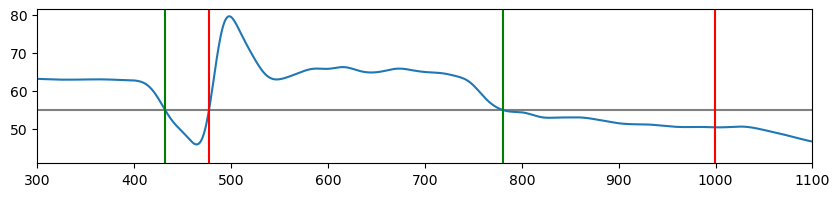

Filtering last event: 458 17
valid end point
6 6 0
Filtering last event: 999 404
valid end point
6 7 3


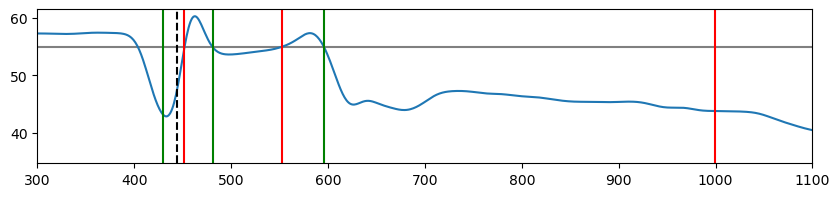

Filtering last event: 999 264
valid end point
6 8 1


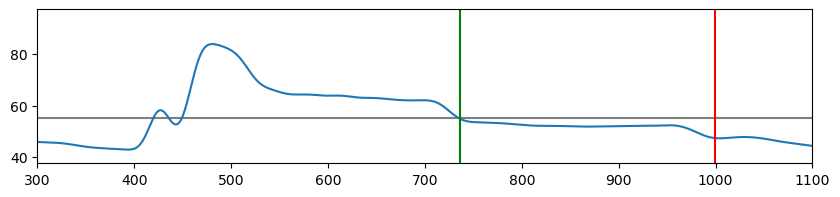

Filtering last event: 999 511
valid end point
6 9 1


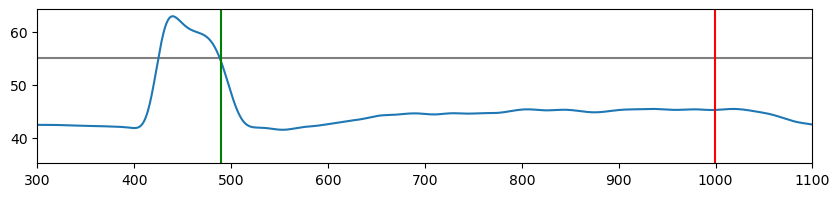

Filtering last event: 789 342
valid end point
6 10 1


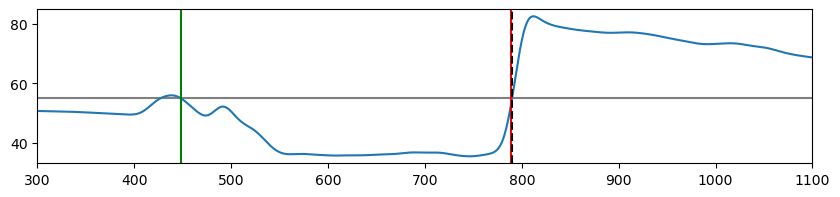

Filtering last event: 628 199
valid end point
7 1 1


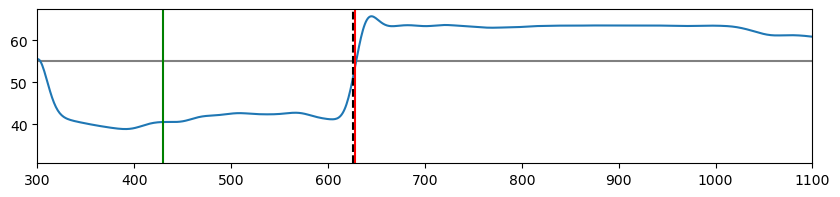

Filtering last event: 999 570
valid end point
7 3 1


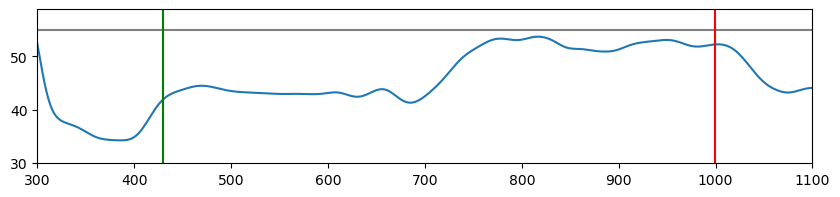

Filtering last event: 999 570
valid end point
7 4 1


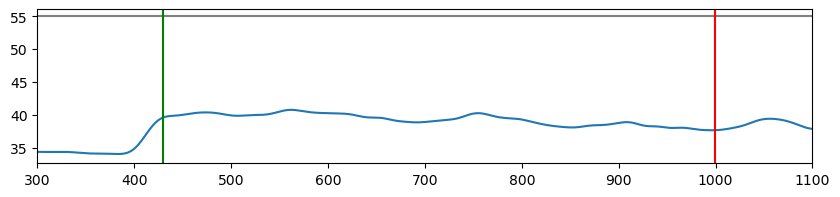

Filtering last event: 745 73
valid end point
7 6 2


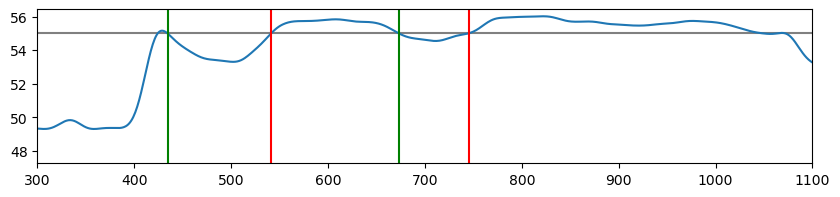

Filtering last event: 999 570
valid end point
7 8 1


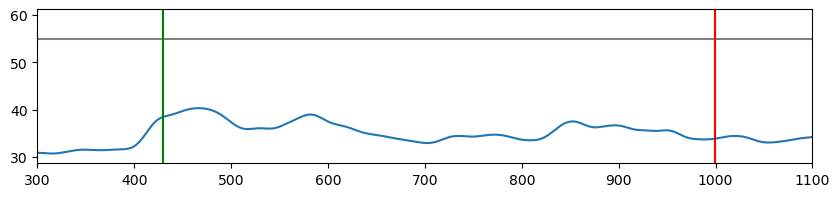

Filtering last event: 999 229
valid end point
7 9 2


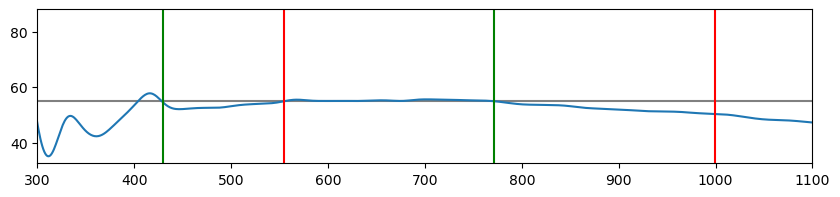

Filtering last event: 445 16
valid end point
8 4 0
Filtering last event: 512 83
valid end point
2 1 1


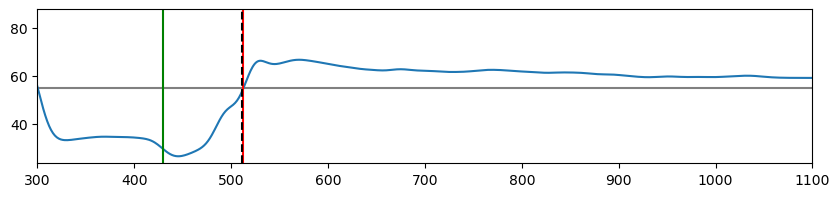

Filtering last event: 473 44
valid end point
2 2 1


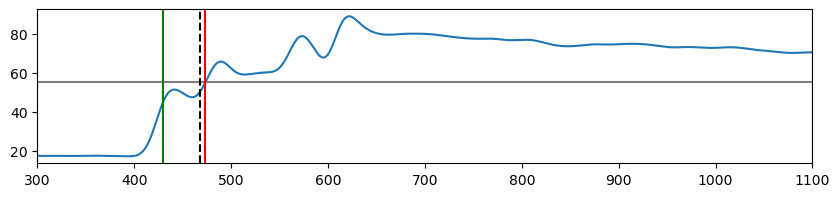

Filtering last event: 999 456
valid end point
2 3 2


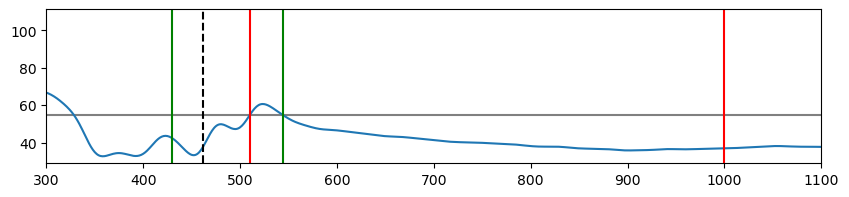

Filtering last event: 888 5
valid end point
2 4 1


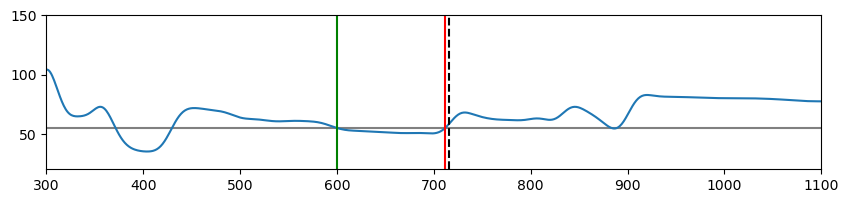

Filtering last event: 704 19
valid end point
2 5 1


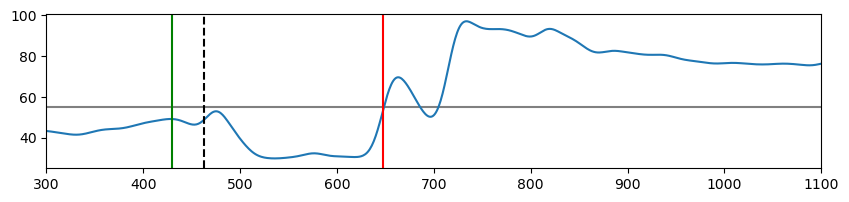

Filtering last event: 840 106
valid end point
2 6 1


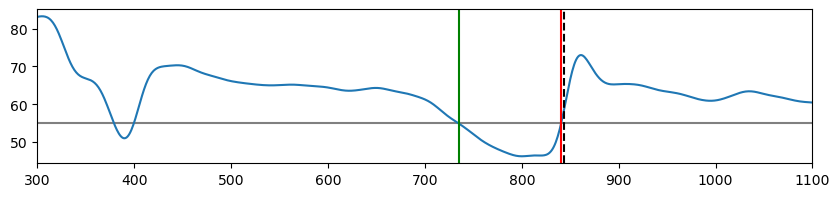

Filtering last event: 826 51
valid end point
2 7 1


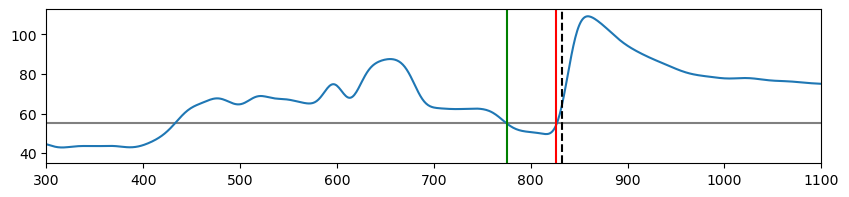

Filtering last event: 810 42
valid end point
2 8 2


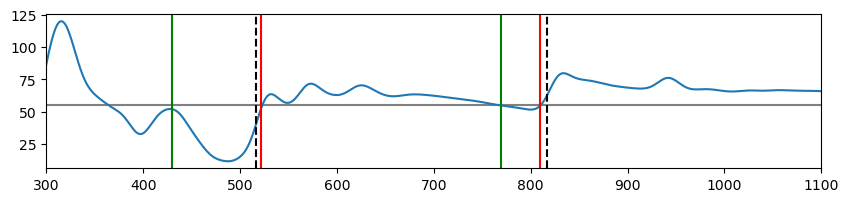

Filtering last event: 736 27
valid end point
2 10 2


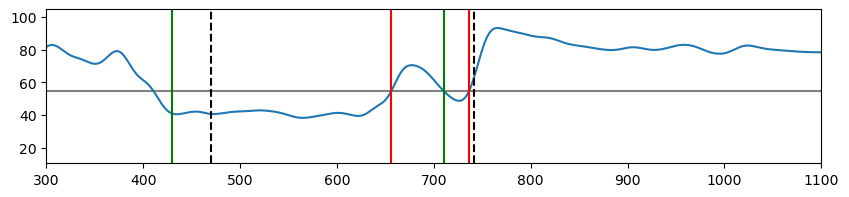

Filtering last event: 543 114
valid end point
3 1 1


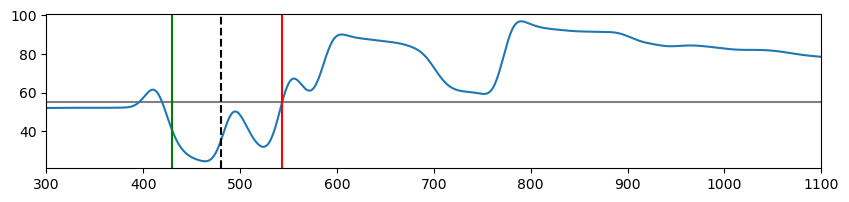

Filtering last event: 999 48
valid end point
3 2 2


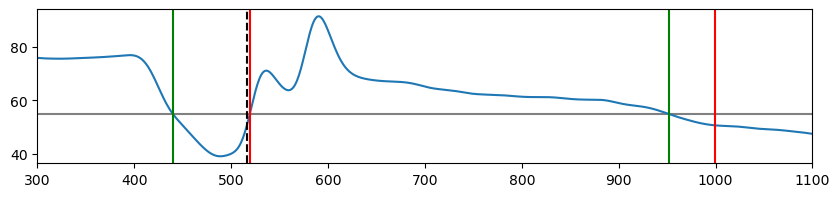

Filtering last event: 999 302
valid end point
3 3 2


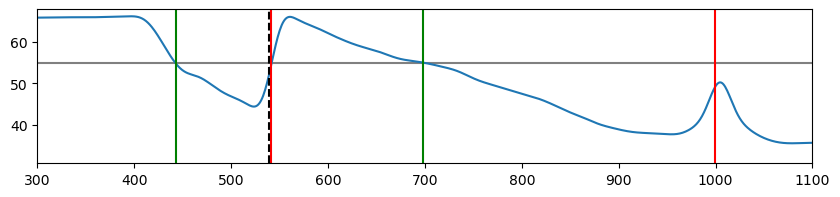

Filtering last event: 999 166
valid end point
3 4 2


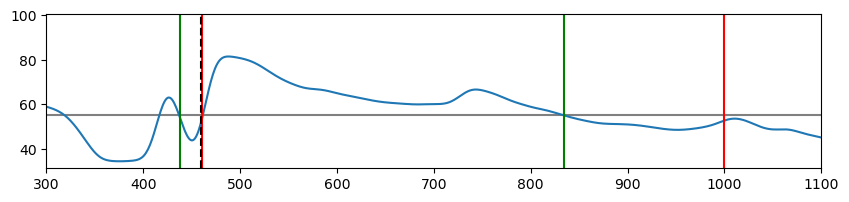

Filtering last event: 667 140
valid end point
3 5 2


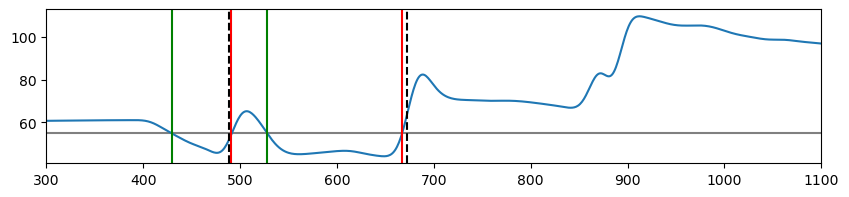

Filtering last event: 810 184
valid end point
3 7 2


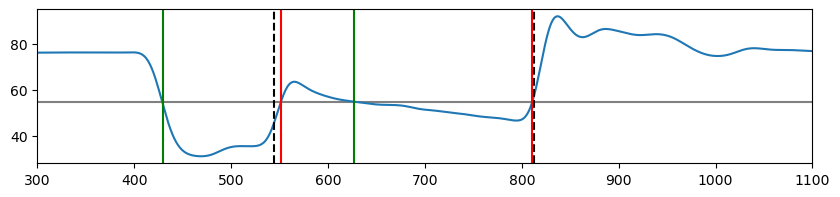

Filtering last event: 908 122
valid end point
3 8 2


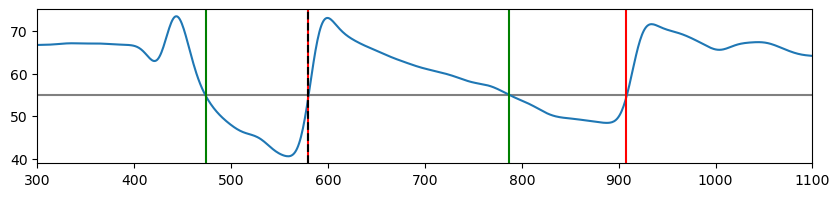

Filtering last event: 999 6
removing last event of length 6
3 9 2


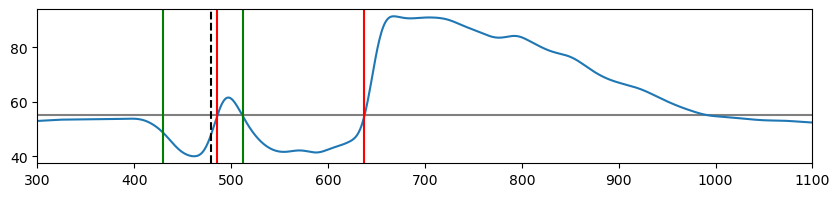

Filtering last event: 507 78
valid end point
3 10 1


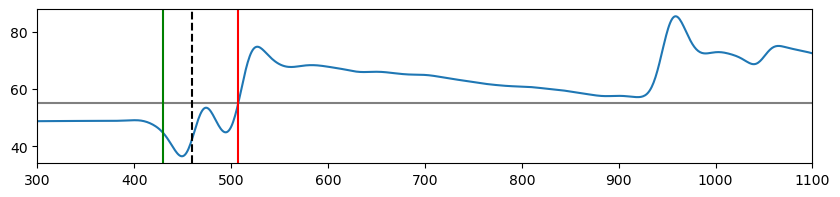

Filtering last event: 563 134
valid end point
5 1 1


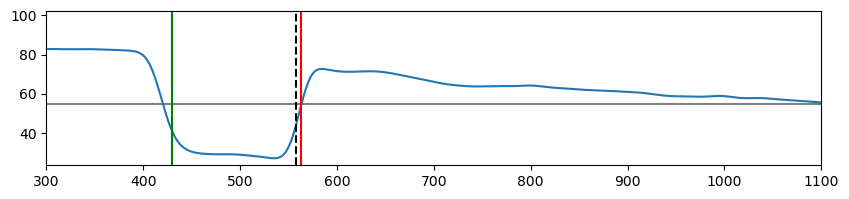

Filtering last event: 999 447
valid end point
5 2 1


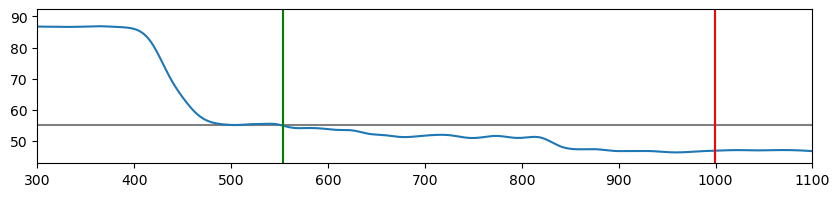

Filtering last event: 923 494
valid end point
5 3 1


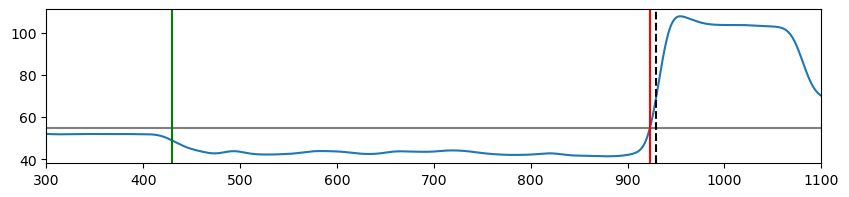

Filtering last event: 794 365
valid end point
5 4 1


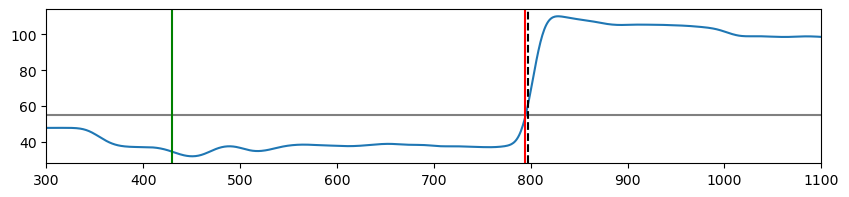

Filtering last event: 999 477
valid end point
5 7 1


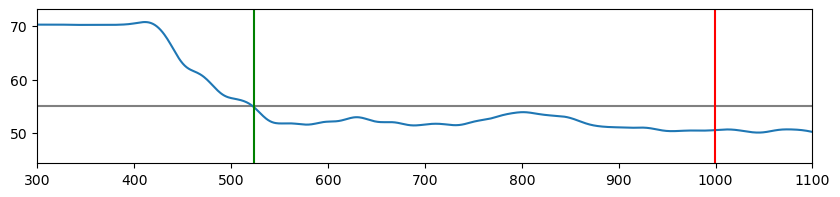

Filtering last event: 762 333
valid end point
5 8 1


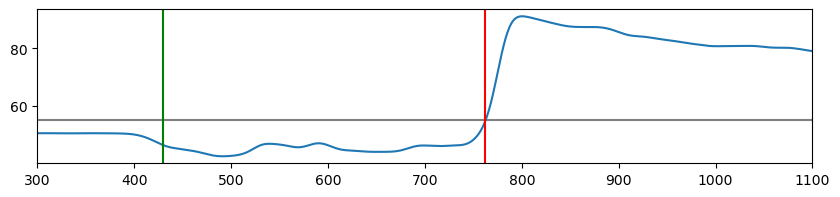

Filtering last event: 989 55
valid end point
5 9 2


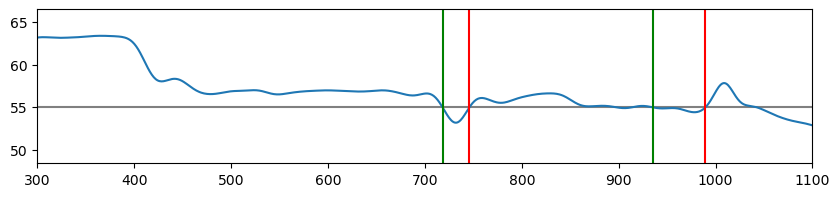

Filtering last event: 999 197
valid end point
5 10 2


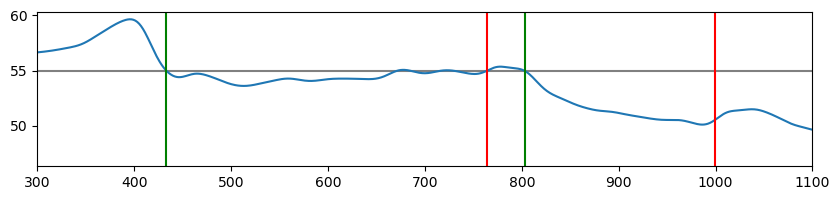

Filtering last event: 454 25
valid end point
6 1 1


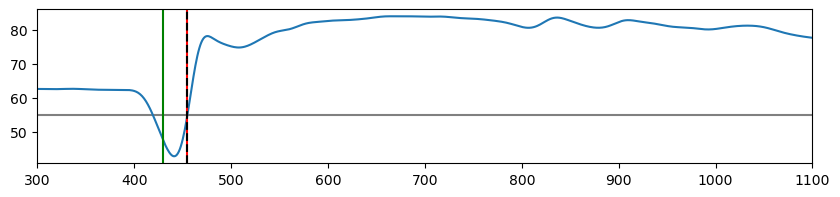

Filtering last event: 491 62
valid end point
6 2 1


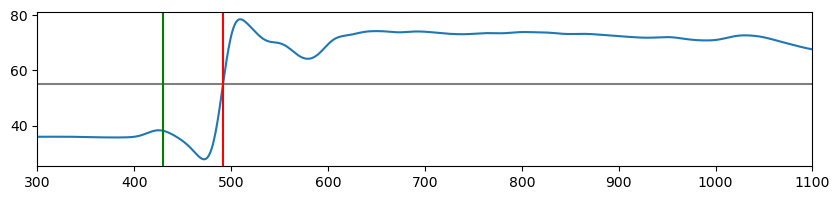

Filtering last event: 999 6
removing last event of length 6
6 4 1


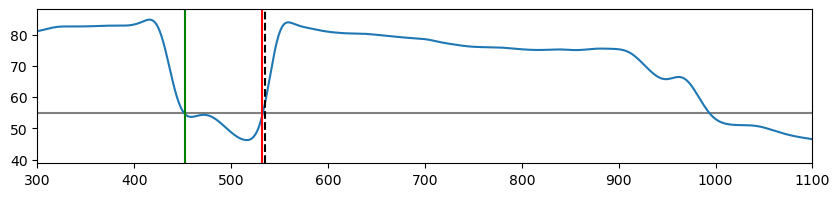

Filtering last event: 999 240
valid end point
6 5 2


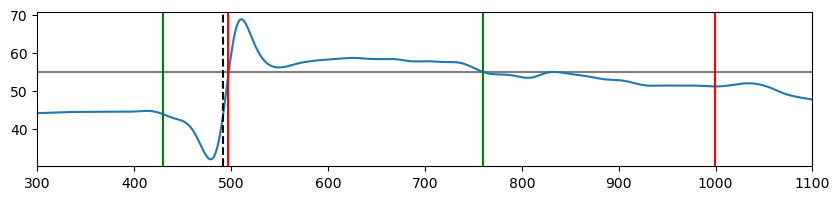

Filtering last event: 560 89
valid end point
6 6 1


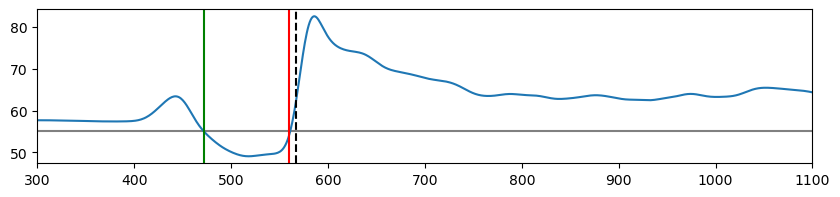

Filtering last event: 577 147
valid end point
6 7 1


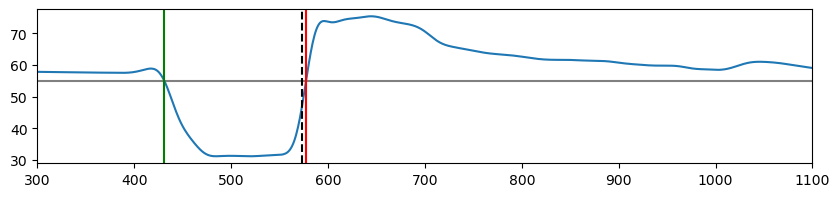

Filtering last event: 708 279
valid end point
6 8 1


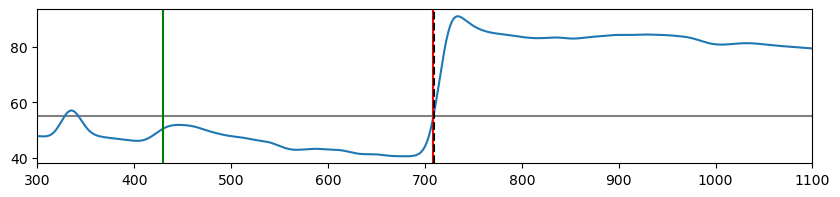

Filtering last event: 999 506
valid end point
6 9 1


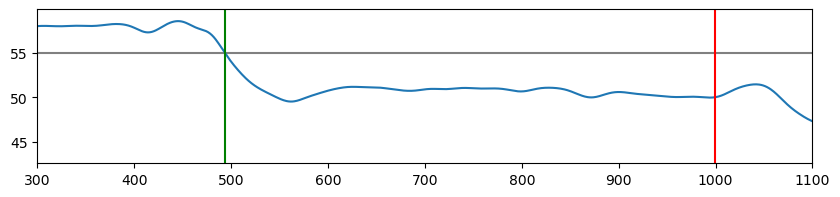

Filtering last event: 451 22
valid end point
7 1 1


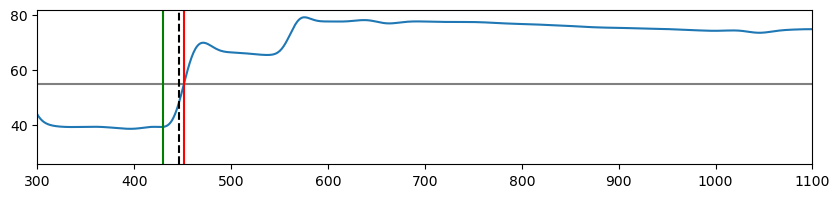

Filtering last event: 438 9
valid end point
7 6 0
Filtering last event: 999 570
valid end point
8 1 1


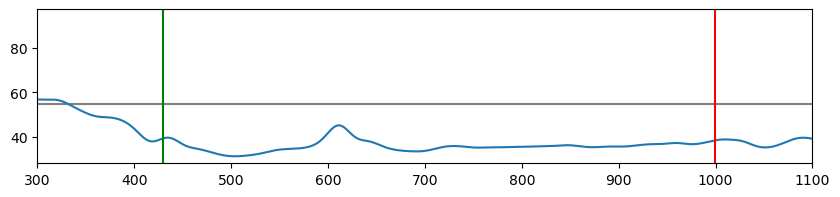

Filtering last event: 625 196
valid end point
8 2 1


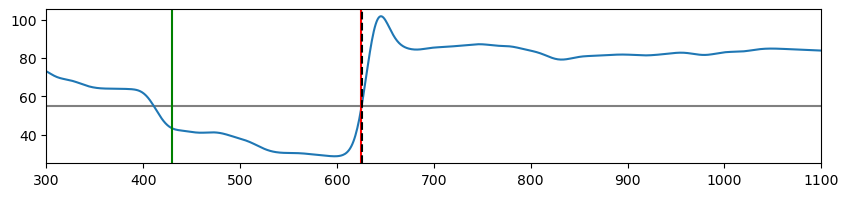

Filtering last event: 547 44
valid end point
8 3 2


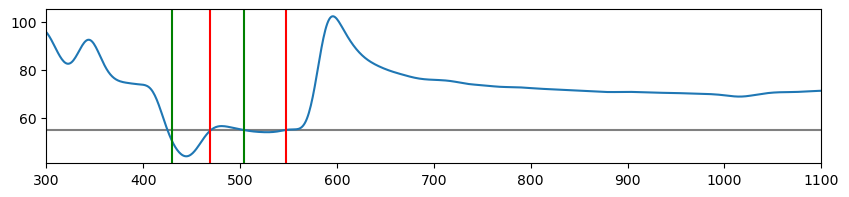

Filtering last event: 999 160
valid end point
8 4 2


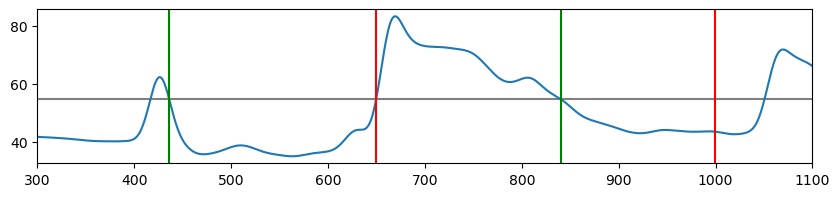

Filtering last event: 512 76
valid end point
8 6 1


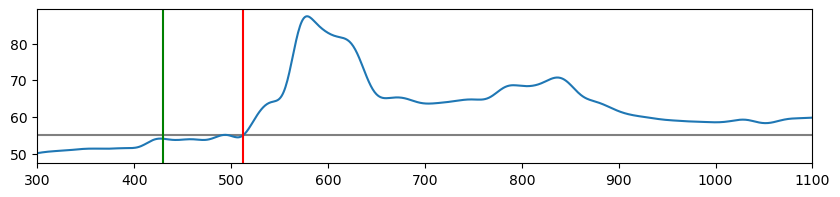

Filtering last event: 899 32
valid end point
8 7 2


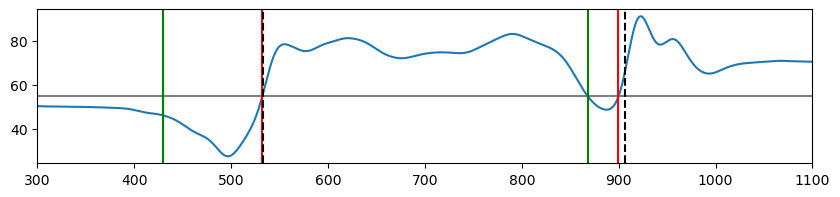

Filtering last event: 999 521
valid end point
8 8 1


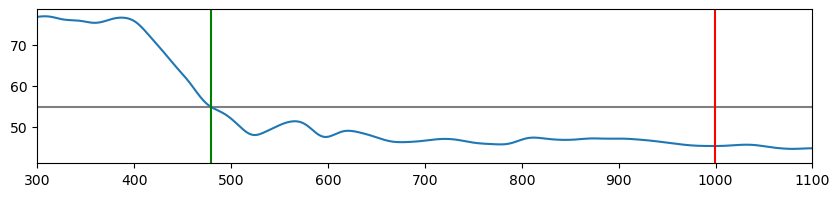

Filtering last event: 896 21
valid end point
8 9 2


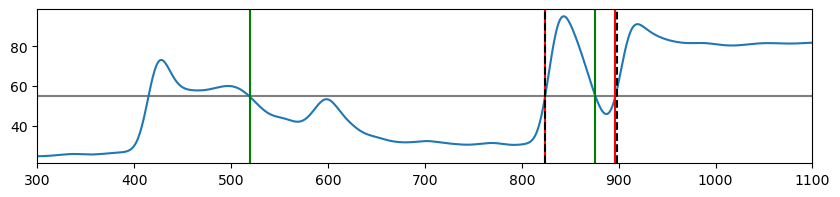

Filtering last event: 690 84
valid end point
8 10 2


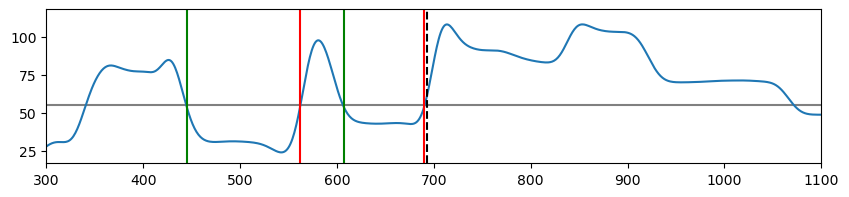

In [ ]:
count_SIZ_reached_MDN_Stop1_L3, swing_events_within_SIZ_MDN_Stop1_L3, percentage_MDN_Stop1_L3, dwell_time_MDN_Stop1_L3 = get_stepping_params_Hleg(MDN_Stop1,'L3','L3'+ang_name, swing_ts_MDN_Stop1_L3 )
count_SIZ_reached_MDN_Stop1_R3, swing_events_within_SIZ_MDN_Stop1_R3, percentage_MDN_Stop1_R3, dwell_time_MDN_Stop1_R3 = get_stepping_params_Hleg(MDN_Stop1,'R3','R3'+ang_name, swing_ts_MDN_Stop1_R3 )

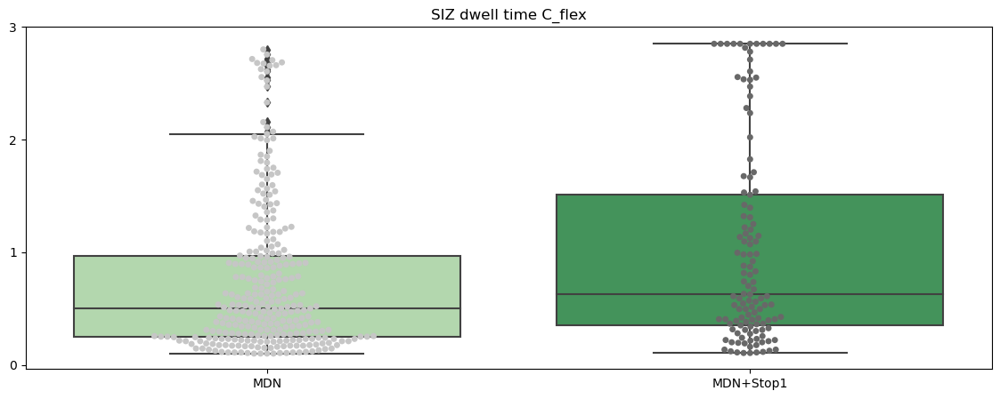

In [ ]:
dwell_time_Hlegs_pooled = pd.concat([pd.concat([pd.DataFrame(dwell_time_MDN_L3),pd.DataFrame(dwell_time_MDN_R3)]).reset_index(drop=True),
                                    pd.concat([pd.DataFrame(dwell_time_MDN_Stop1_L3),pd.DataFrame(dwell_time_MDN_Stop1_R3)]).reset_index(drop=True)], axis =1)
dwell_time_Hlegs_pooled.columns = header      
# dwell_time_Hlegs_pooled.to_csv(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Hind\DT_'+ang_name+'.csv')  

plt.rcParams['figure.figsize'] = (14,5)
sns.boxplot(dwell_time_Hlegs_pooled, palette= 'Greens')
sns.swarmplot(dwell_time_Hlegs_pooled, size = 5, palette= 'Greys')
plt.yticks(np.arange(0,800,200), np.arange(0,4,1))
plt.title('SIZ dwell time '+ ang_name)
# plt.savefig(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Hind\DwellTime_'+ang_name+'.svg', dpi = 300)

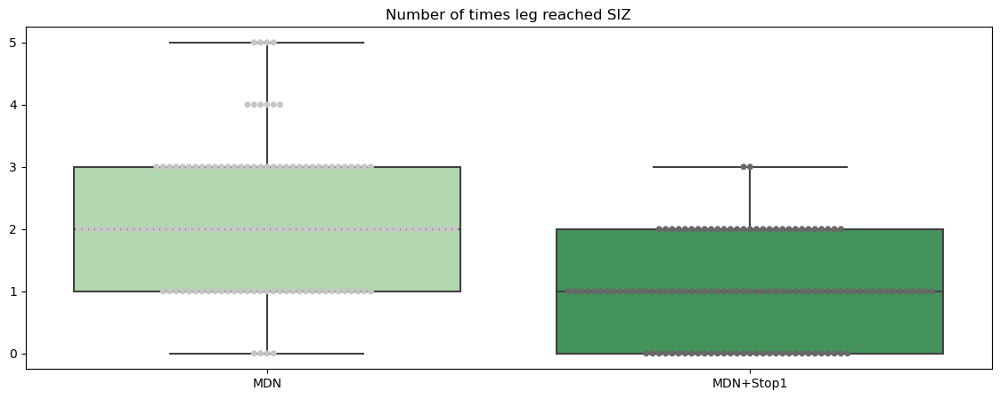

In [ ]:
count_SIZ_Hlegs_pooled = pd.concat([pd.concat([pd.DataFrame(count_SIZ_reached_MDN_L3),pd.DataFrame(count_SIZ_reached_MDN_R3)]).reset_index(drop=True),
                                    pd.concat([pd.DataFrame(count_SIZ_reached_MDN_Stop1_L3),pd.DataFrame(count_SIZ_reached_MDN_Stop1_R3)]).reset_index(drop=True)], axis =1)
count_SIZ_Hlegs_pooled.columns = header      
# count_SIZ_Hlegs_pooled.to_csv(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Hind\Count_'+ang_name+'.csv') 

plt.rcParams['figure.figsize'] = (14,5)

sns.boxplot(count_SIZ_Hlegs_pooled, palette= 'Greens')
sns.swarmplot(count_SIZ_Hlegs_pooled, size = 5, palette= 'Greys')
# plt.yticks(np.arange(0,13,2))
plt.title('Number of times leg reached SIZ')
# plt.savefig(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Hind\SIZ_Count_'+ang_name+'.svg', dpi = 300)

c:\Users\SthanuKumarD\Anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 20.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
c:\Users\SthanuKumarD\Anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 22.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


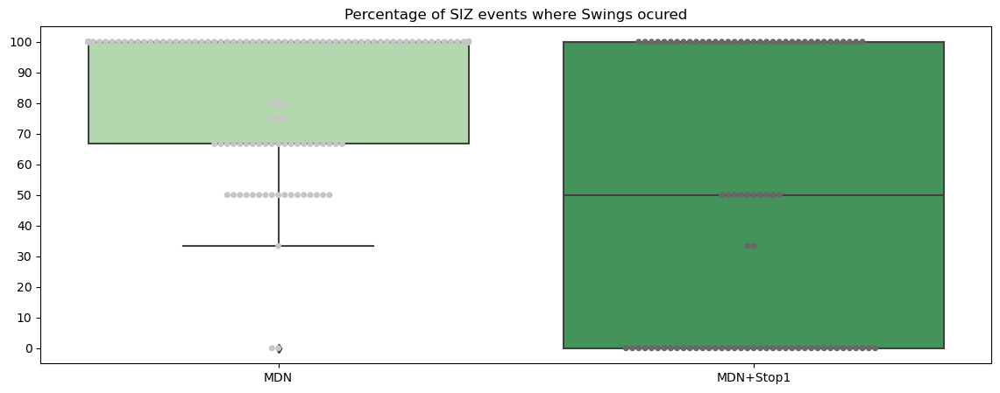

In [ ]:
percentage_swings_SIZ_Hlegs_pooled = pd.concat([pd.concat([pd.DataFrame(percentage_MDN_L3),pd.DataFrame(percentage_MDN_R3)]).reset_index(drop=True),
                                    pd.concat([pd.DataFrame(percentage_MDN_Stop1_L3),pd.DataFrame(percentage_MDN_Stop1_L3)]).reset_index(drop=True)], axis =1)
percentage_swings_SIZ_Hlegs_pooled.columns = header       
# percentage_swings_SIZ_Hlegs_pooled.to_csv(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Hind\PS_'+ang_name+'.csv') 

plt.rcParams['figure.figsize'] = (14,5)


sns.boxplot(percentage_swings_SIZ_Hlegs_pooled, palette= 'Greens')
sns.swarmplot(percentage_swings_SIZ_Hlegs_pooled, size = 5, palette= 'Greys')

plt.yticks(np.arange(0,110,10))
plt.title('Percentage of SIZ events where Swings ocured')
# plt.savefig(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Hind\Percent_Swings_'+ang_name+'.svg', dpi = 300)

In [ ]:
raise TypeError('end of section')

TypeError: end of section

# Mid Legs

In [ ]:
# def get_reset_ang_Mleg (df, leg):
#     if leg == 'L2':
#         sc = 'L-M_stepcycle'
#         angle = 'L2C_flex'
#     if leg =='R2':
#         sc = 'R-M_stepcycle'
#         angle = 'R2C_flex'
#     reset_ang = []
#     reset_timepts = pd.DataFrame()
#     swing_count = [] # number of separate events predicted to be swings from ball prediction and accompanied by a sudden, large change in angle

#     for n in df['flynum'].unique().tolist():
#         for t in df.groupby('flynum').get_group(n)['tnum'].unique().tolist():
#             data = df.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)

#             sc_temp = pd.DataFrame(data[sc])
#             ang = data[angle]

#             sc_diff = pd.DataFrame(np.diff(sc_temp[sc].astype(int)))
#             swing_init =sc_diff.loc[sc_diff[0] == -1].index.tolist() # index from diff ==> add idx = 1 
#             swing_idx  =sc_temp.loc[sc_temp[sc] == False].index.tolist() # swing frames from ball prediction

#             ang_diff = pd.DataFrame(np.diff(ang))
#             ang_diff_resets = ang_diff.loc[abs(ang_diff[0]) > 2].index.tolist() #index from diff ==> add idx = 1
#             ang_diff_resets = [x+1 for x in ang_diff_resets] # indexing fixed

#             real_swing = []
#             for temp_swing in swing_idx:
#                 if ((temp_swing <1001) & (temp_swing> 400)):
#                     if temp_swing in ang_diff_resets:
#                         real_swing.append(temp_swing)
#             break_pt = np.split(real_swing, np.where(np.diff(real_swing)>1)[0]+1)
#             swing_count.append(len(break_pt))
#             try:
#                 for i in break_pt:
#                     reset_timepts = pd.concat([reset_timepts, pd.DataFrame([n , t, i[0]]).T], axis = 0)
#                     temp_ang = ang[i[0]]
#                     reset_ang.append(temp_ang)
#                     # if(temp_ang > 70):
#                     #     print(n,t,i)
#             except:
#                 continue
#     reset_timepts.columns = ['flynum', 'tnum', 'swing_ts']
#     return reset_ang, swing_count, reset_timepts

In [ ]:
def get_reset_ang_Mleg (df, leg):
    if leg == 'L2':
        sc = 'L-M_stepcycle'
        angle = 'L2C_flex'
    if leg =='R2':
        sc = 'R-M_stepcycle'
        angle = 'R2C_flex'

    reset_ang = []
    swing_count = [] # number of separate events predicted to be swings from ball prediction and accompanied by a sudden, large change in angle
    reset_timepts = pd.DataFrame()

    for n in df['flynum'].unique().tolist():
        for t in df.groupby('flynum').get_group(n)['tnum'].unique().tolist():
            print((n,t))
            data = df.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)
            sc_temp = pd.DataFrame(data[sc])
            ang = data[angle]

            plt.rcParams['figure.figsize'] = (10,2)
            plt.plot (ang)
            
            sc_diff = pd.DataFrame(np.diff(sc_temp[sc].astype(int)))
            swing_init =sc_diff.loc[sc_diff[0] == -1].index.tolist() # index from diff ==> add idx = 1 
            
            if len(swing_init)>0:
                swing_init = [x+1 for x in swing_init]
            
                print((n,t,swing_init))
                for i in swing_init:
                    plt.plot(i, ang[i], 'oy', alpha = 1, label = 'predicted')

                # swing_idx  =sc_temp.loc[sc_temp[sc] == False].index.tolist() # swing frames from ball prediction

                ang_diff = pd.DataFrame(np.diff(ang))

                ang_diff_resets = ang_diff.loc[(ang_diff[0]) > 0.5].index.tolist() #index from diff ==> add idx = 1
                ang_diff_resets = [x+1 for x in ang_diff_resets] # indexing fixed

                # ang_diff_resets_toext = ang_diff.loc[(ang_diff[0]) > 0.5].index.tolist() #index from diff ==> add idx = 1
                # ang_diff_resets_toext = [x+1 for x in ang_diff_resets_toext] # indexing fixed

                # ang_diff_resets_tocont = ang_diff.loc[(ang_diff[0]) < -0.5].index.tolist() #index from diff ==> add idx = 1
                # ang_diff_resets_tocont = [x+1 for x in ang_diff_resets_tocont] # indexing fixed

                for i in ang_diff_resets:
                    plt.plot(i, ang[i], 'ob', alpha = 0.2)

                # for i in  ang_diff_resets_tocont:
                #     plt.plot(i, ang[i], 'og', alpha = 0.2)

                # all_ang_resets = ang_diff_resets_toext + ang_diff_resets_tocont

                real_swing_temp = []
                for temp_swing in swing_init:
                    reset_within = 0
                    if ((temp_swing <1001) & (temp_swing> 400)):
                        
                        for ang_reset in ang_diff_resets:
                            if reset_within == 0 :
                                if ang_reset in range(temp_swing,temp_swing+5):
                                    real_swing_temp.append(temp_swing)
                                    reset_within+=1
                real_swing = []
                for i in real_swing_temp:
                    all_peaks = scipy.signal.find_peaks(-1 *ang[i-20:i],prominence=0.5)[0].tolist()
                    all_peaks = [x + i-20 for x in all_peaks]

                    if len(all_peaks) == 1:
                        print(' shifting peakusing peak finding to : ' ,all_peaks[0])
                        real_swing.append(all_peaks[0])
                    elif len(all_peaks) == 0:
                        real_swing.append(i)
                    else:
                        print('more than one peak found for ', (n,t))
                        real_swing.append(i)


                print((n,t,real_swing))
                temp_df = pd.DataFrame(real_swing)
                temp_df.insert(0, 'tnum', t)
                temp_df.insert(0, 'flynum', n)
                reset_timepts = pd.concat([reset_timepts, temp_df], axis = 0).reset_index(drop= True)

                for i in real_swing:
                    plt.plot(real_swing, ang[real_swing], 'or', label = 'real_swing')
                    
                swing_count.append(len(real_swing))

                for i in real_swing:
                    temp_ang = ang[i]
                    reset_ang.append(temp_ang)

                plt.xlim(400,1000)
                plt.show()

            else:
                print('no swing found')
                plt.xlim(400,1000)
                plt.show()


    reset_timepts.columns = ['flynum', 'tnum', 'swing_ts']
    return reset_ang, swing_count, reset_timepts

(1, 1)
(1, 1, [417, 448, 643, 843, 876, 946, 997])
 shifting peakusing peak finding to :  638
 shifting peakusing peak finding to :  870
 shifting peakusing peak finding to :  994
(1, 1, [638, 870, 994])


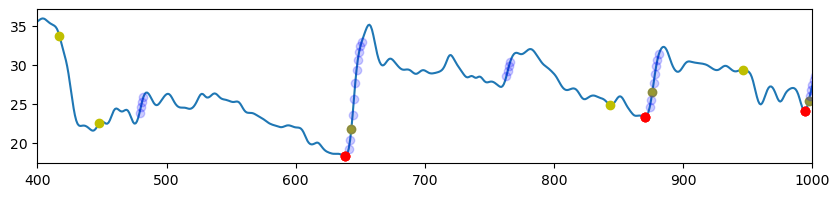

(1, 2)
(1, 2, [428, 474, 591, 648, 738, 830, 899, 987, 1266, 1349, 1360])
 shifting peakusing peak finding to :  586
 shifting peakusing peak finding to :  645
 shifting peakusing peak finding to :  827
(1, 2, [474, 586, 645, 738, 827, 987])


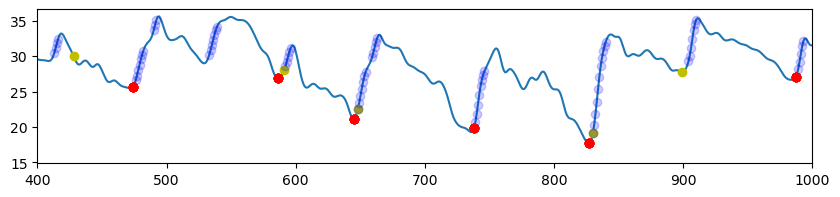

(1, 3)
(1, 3, [117, 140, 248, 259, 274, 294, 401, 443, 492, 544, 599, 642, 792, 846, 925, 934, 1051, 1116])
 shifting peakusing peak finding to :  429
 shifting peakusing peak finding to :  540
 shifting peakusing peak finding to :  634
 shifting peakusing peak finding to :  927
(1, 3, [429, 540, 634, 927])


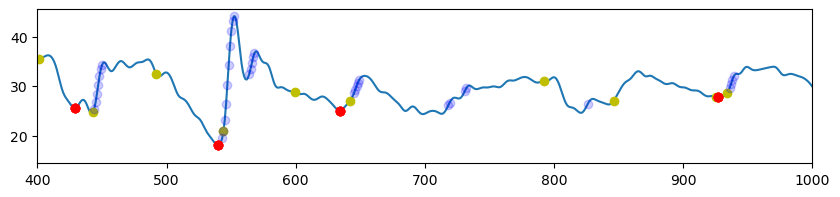

(1, 4)
(1, 4, [98, 277, 301, 331, 423, 451, 508, 543, 576, 664, 719, 811, 977])
 shifting peakusing peak finding to :  442
 shifting peakusing peak finding to :  806
(1, 4, [442, 806])


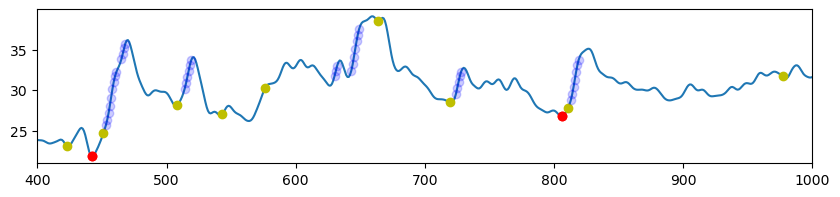

(1, 5)
(1, 5, [459, 504, 630, 727, 777, 845, 920, 987])
more than one peak found for  (1, 5)
 shifting peakusing peak finding to :  773
(1, 5, [630, 727, 773, 987])


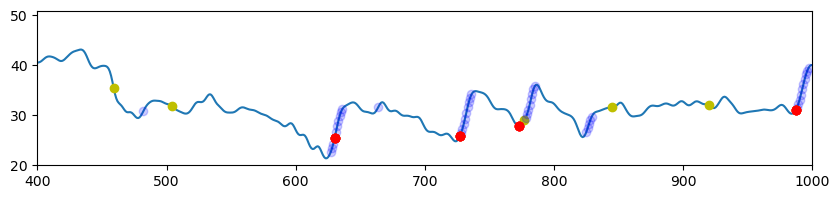

(1, 6)
(1, 6, [442, 568, 746, 830, 951])
 shifting peakusing peak finding to :  938
(1, 6, [568, 830, 938])


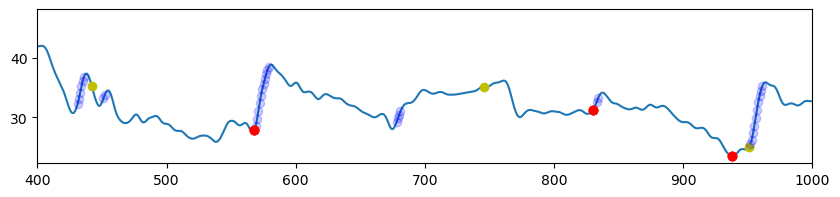

(1, 7)
(1, 7, [478, 529, 626, 669, 783, 933])
 shifting peakusing peak finding to :  524
 shifting peakusing peak finding to :  620
(1, 7, [524, 620, 783])


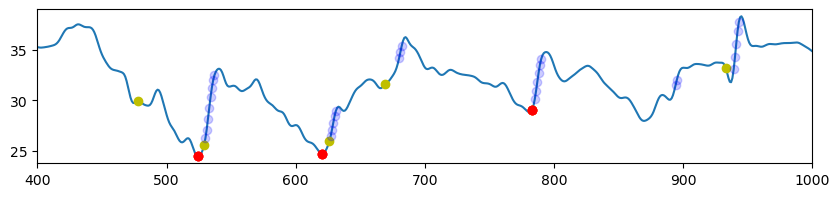

(1, 8)
(1, 8, [5, 105, 136, 173, 247, 280, 347, 537, 607, 694, 741, 808, 828, 893, 933])
 shifting peakusing peak finding to :  529
 shifting peakusing peak finding to :  738
 shifting peakusing peak finding to :  916
(1, 8, [529, 694, 738, 916])


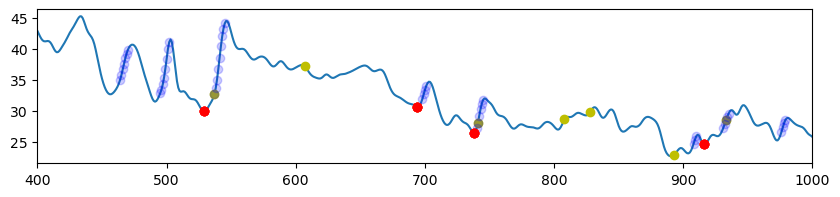

(1, 9)
(1, 9, [54, 89, 176, 480, 605, 696, 738, 793, 904, 1007])
more than one peak found for  (1, 9)
 shifting peakusing peak finding to :  786
(1, 9, [605, 738, 786])


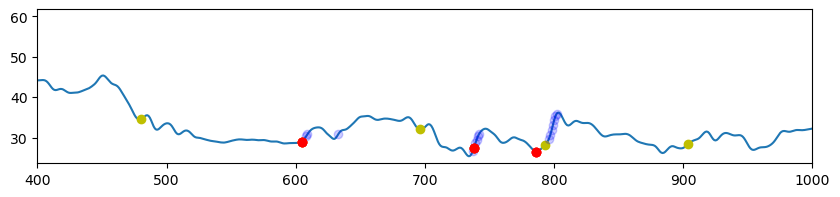

(1, 10)
(1, 10, [500, 573, 643, 706, 831, 929, 991])
 shifting peakusing peak finding to :  562
(1, 10, [562])


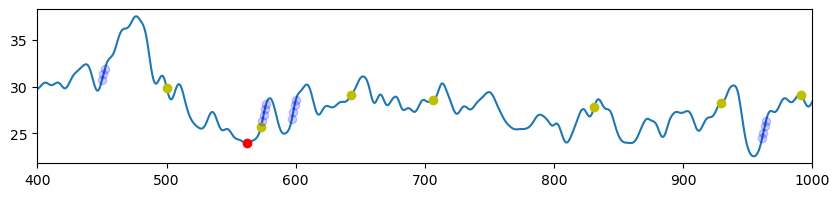

(2, 1)
(2, 1, [510, 550, 597, 619, 649, 693])
 shifting peakusing peak finding to :  496
 shifting peakusing peak finding to :  616
 shifting peakusing peak finding to :  690
(2, 1, [496, 550, 597, 616, 649, 690])


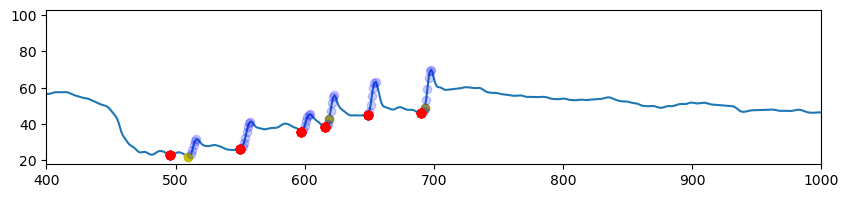

(2, 2)
(2, 2, [658, 689, 713, 774, 806, 828, 994])
 shifting peakusing peak finding to :  992
(2, 2, [658, 689, 713, 774, 806, 828, 992])


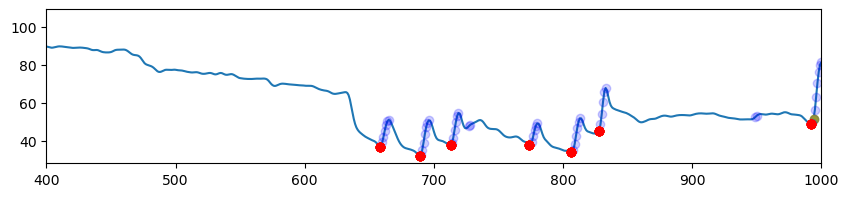

(2, 3)
(2, 3, [750, 843, 874, 914, 983, 1034, 1075])
(2, 3, [750, 843, 874, 914, 983])


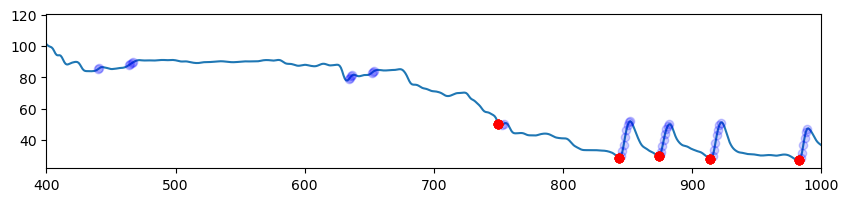

(2, 4)
(2, 4, [613, 637, 720, 749, 777, 808, 889, 912, 937, 979, 1078, 1097])
(2, 4, [613, 637, 720, 749, 777, 808, 889, 912, 937, 979])


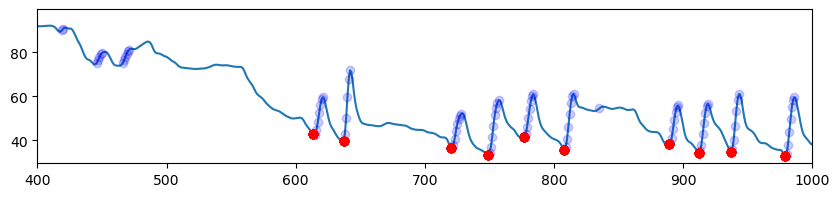

(2, 5)
(2, 5, [541, 588, 655, 677, 706, 751, 786, 826, 877, 908, 936, 969, 1040, 1184, 1218])
(2, 5, [541, 588, 655, 677, 706, 751, 786, 826, 877, 908, 936, 969])


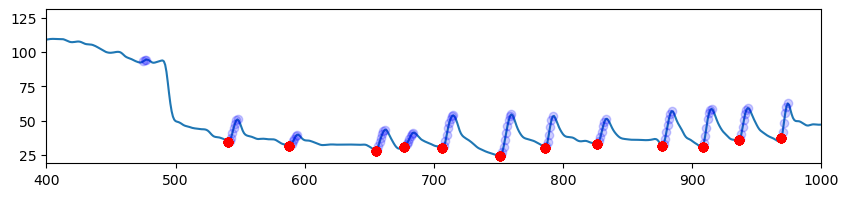

(2, 6)
(2, 6, [338, 476, 519, 560, 599, 629, 662, 698, 733, 776, 823, 872, 904, 951, 1080, 1173, 1216, 1248, 1295, 1328])
 shifting peakusing peak finding to :  510
(2, 6, [476, 510, 560, 599, 629, 662, 698, 733, 776, 823, 872, 904, 951])


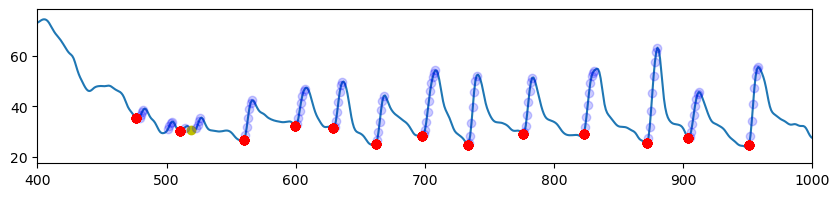

(2, 7)
(2, 7, [506, 539, 601, 640, 684, 739, 787, 822, 852, 904, 958, 1004, 1073, 1140, 1164, 1188, 1225, 1244, 1265, 1319])
(2, 7, [506, 539, 601, 640, 684, 739, 787, 822, 852, 904, 958])


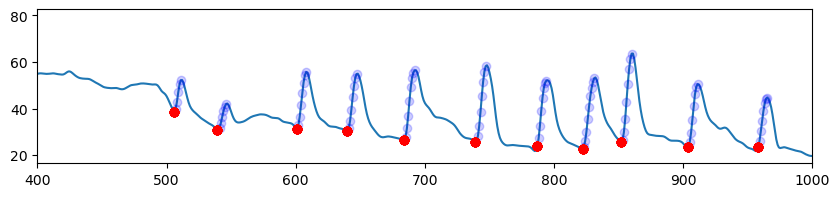

(2, 8)
(2, 8, [471, 491, 536, 576, 646, 724, 777, 810, 908, 943, 1012])
 shifting peakusing peak finding to :  487
(2, 8, [471, 487, 536, 576, 646, 724, 777, 810, 908, 943])


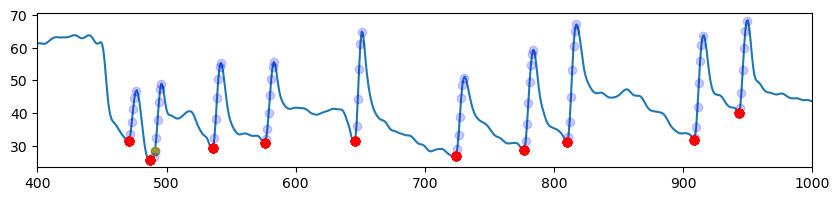

(2, 9)
(2, 9, [445, 475, 505, 555, 588, 658, 692, 730, 765, 814, 878, 926, 990, 1059, 1096, 1126, 1145, 1177])
 shifting peakusing peak finding to :  752
(2, 9, [445, 475, 505, 555, 588, 658, 692, 730, 752, 814, 878, 926, 990])


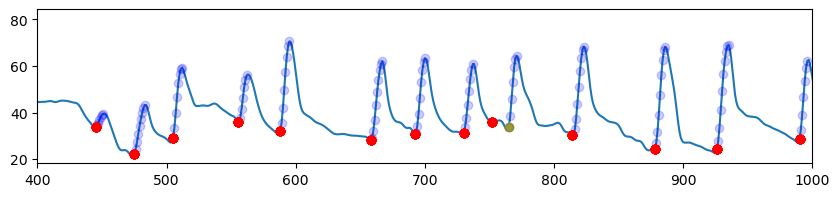

(2, 10)
(2, 10, [111, 158, 500, 530, 574, 610, 670, 716, 761, 819, 872, 911, 964, 1000, 1079, 1126, 1196, 1243, 1375])
 shifting peakusing peak finding to :  607
(2, 10, [500, 530, 574, 607, 670, 716, 761, 819, 872, 911, 964, 1000])


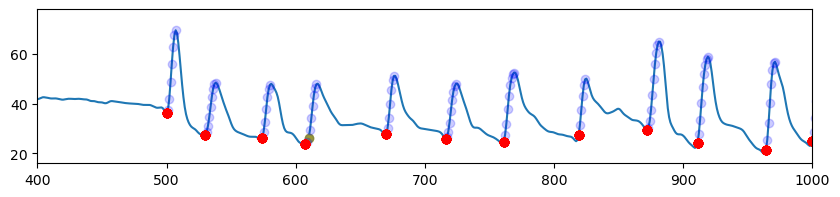

(3, 1)
(3, 1, [259, 350, 442, 520, 604, 1027, 1260])
 shifting peakusing peak finding to :  439
(3, 1, [439, 520, 604])


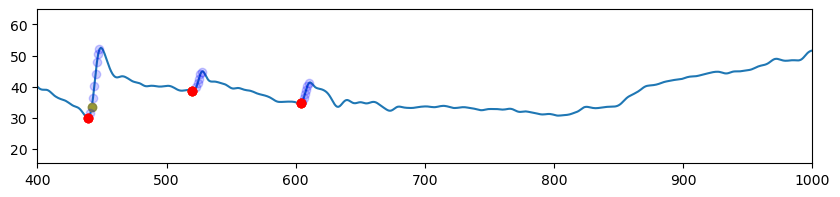

(3, 2)
(3, 2, [110, 731, 805, 910, 1340])
(3, 2, [731, 805, 910])


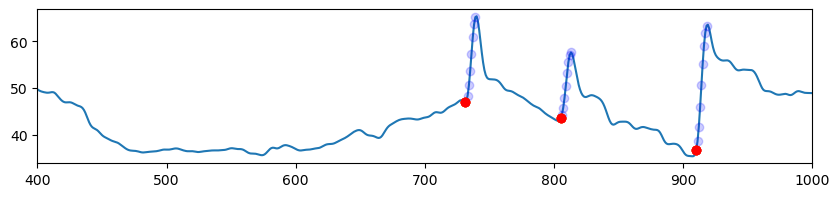

(3, 3)
(3, 3, [1, 20, 78, 478, 638, 699, 1293, 1314, 1349, 1361])
 shifting peakusing peak finding to :  474
(3, 3, [474, 699])


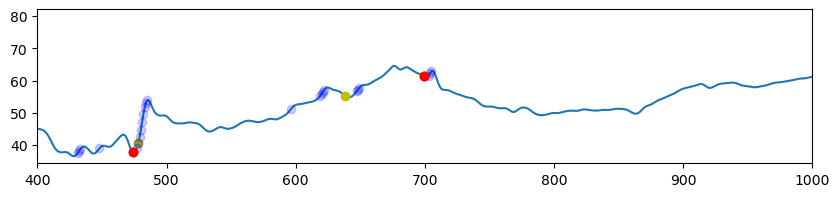

(3, 4)
(3, 4, [186, 419, 572, 991, 1008])
(3, 4, [419])


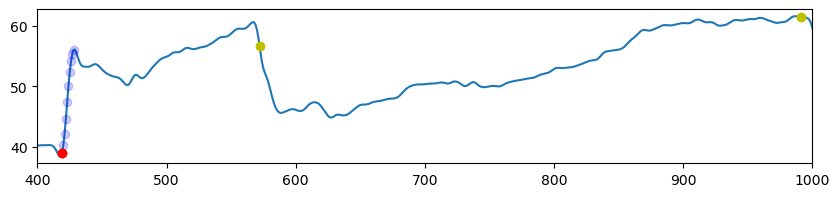

(3, 5)
(3, 5, [440, 534, 663, 756, 1189])
(3, 5, [440, 756])


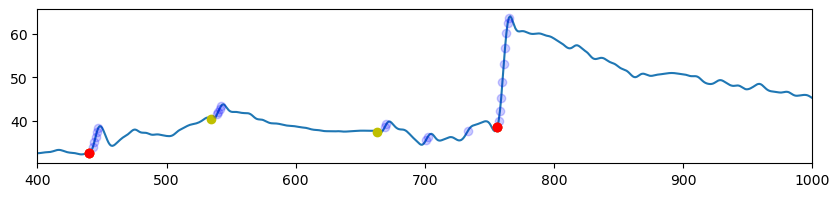

(3, 6)
(3, 6, [143, 306, 685, 794])
(3, 6, [685, 794])


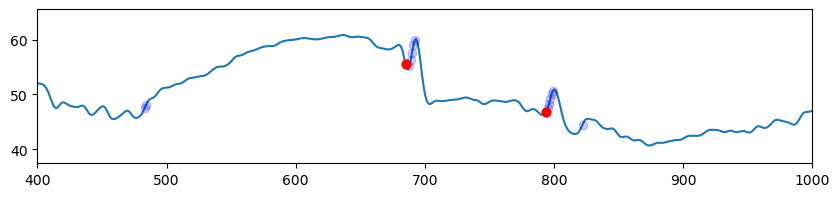

(3, 7)
(3, 7, [103, 183, 707, 809])
 shifting peakusing peak finding to :  796
(3, 7, [796])


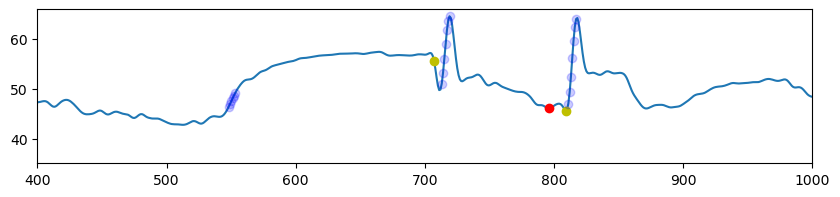

(3, 8)
(3, 8, [76, 238, 586, 667, 895, 1009, 1170])
(3, 8, [586, 667, 895])


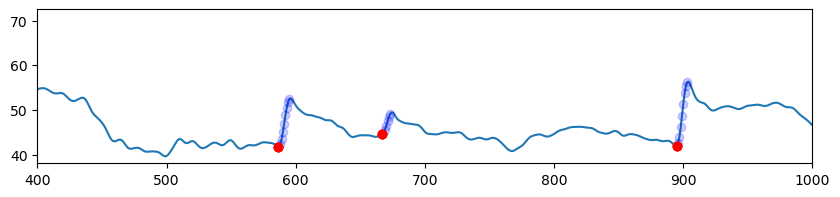

(3, 9)
(3, 9, [620, 632, 753])
(3, 9, [753])


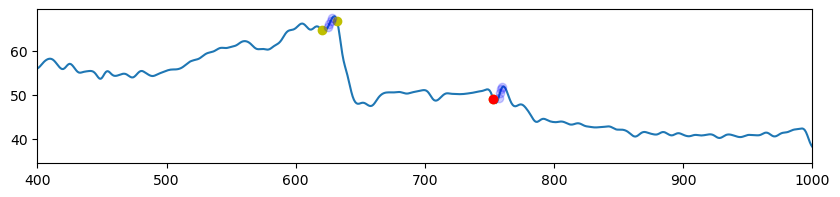

(3, 10)
(3, 10, [444, 1341])
 shifting peakusing peak finding to :  442
(3, 10, [442])


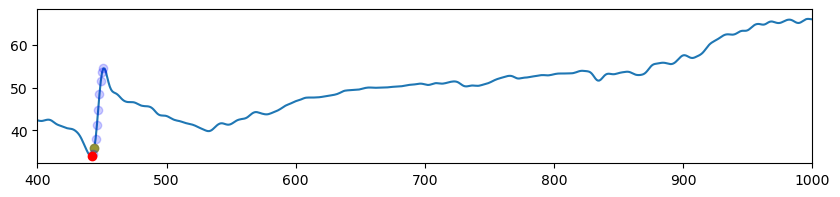

(4, 1)
(4, 1, [438, 536, 602, 674, 754, 956])
 shifting peakusing peak finding to :  436
 shifting peakusing peak finding to :  942
(4, 1, [436, 942])


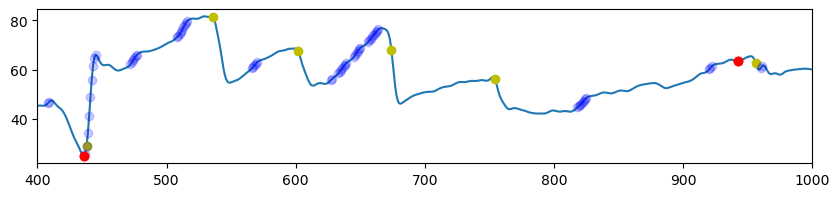

(4, 2)
(4, 2, [421, 488, 540, 675, 780, 866])
(4, 2, [421])


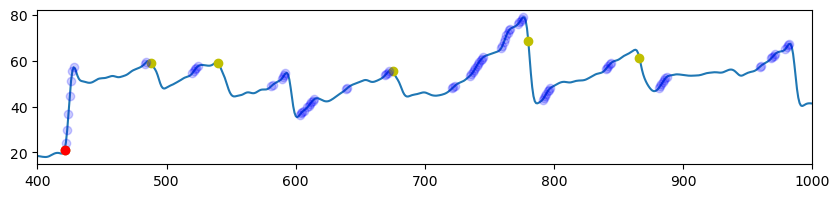

(4, 3)
(4, 3, [356, 414, 490, 570, 677, 852, 1094])
 shifting peakusing peak finding to :  406
(4, 3, [406, 490])


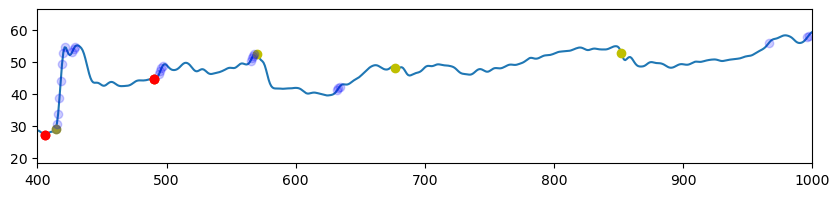

(4, 4)
(4, 4, [86, 376, 391, 466, 572, 808, 1156])
 shifting peakusing peak finding to :  461
(4, 4, [461])


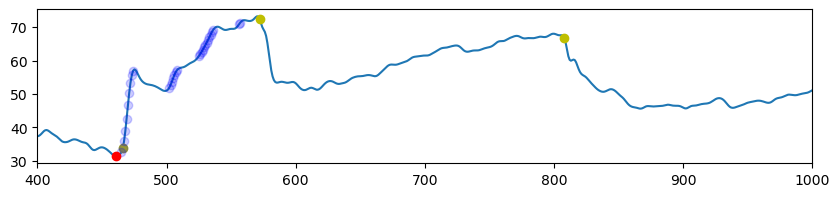

(4, 5)
(4, 5, [515, 772, 969])
(4, 5, [515])


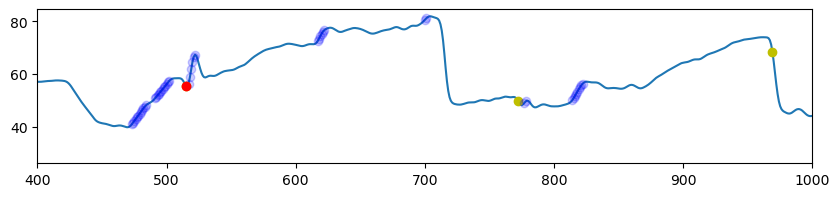

(4, 6)
(4, 6, [432, 535, 632, 779, 1033])
(4, 6, [432])


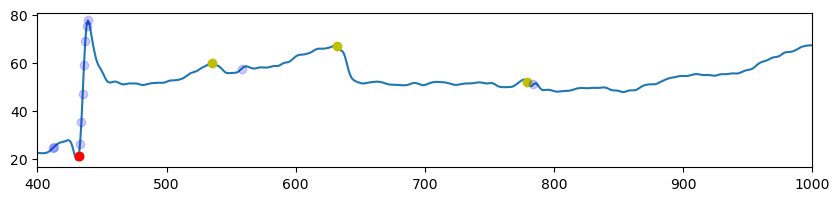

(4, 7)
(4, 7, [437, 502, 609, 739, 988])
 shifting peakusing peak finding to :  490
(4, 7, [437, 490, 609, 739])


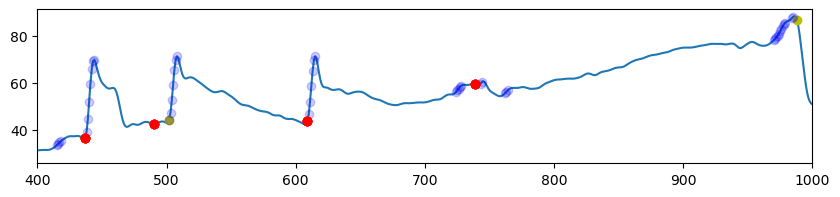

(4, 8)
(4, 8, [191, 423, 516, 610, 739, 1098])
 shifting peakusing peak finding to :  420
(4, 8, [420, 516, 610])


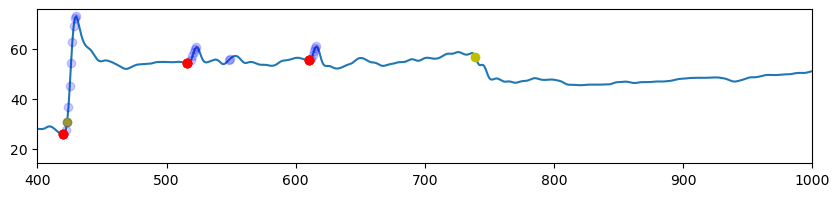

(4, 9)
(4, 9, [402, 453, 549, 720, 1027])
(4, 9, [453])


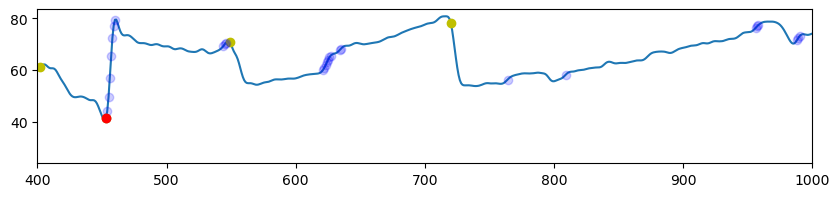

(4, 10)
(4, 10, [49, 160, 236, 327, 384, 555, 691, 1000])
(4, 10, [555])


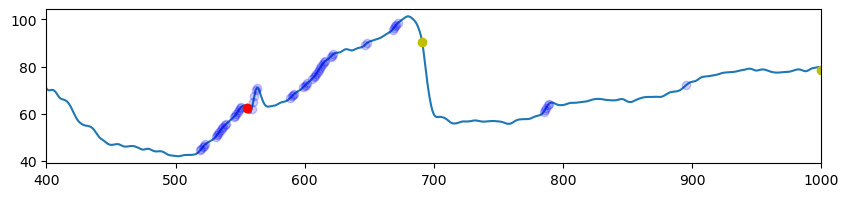

(5, 1)
(5, 1, [469, 512, 609, 820])
 shifting peakusing peak finding to :  509
(5, 1, [509])


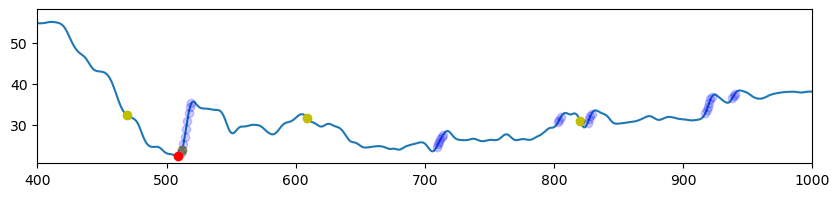

(5, 2)
(5, 2, [549, 646, 915])
(5, 2, [])


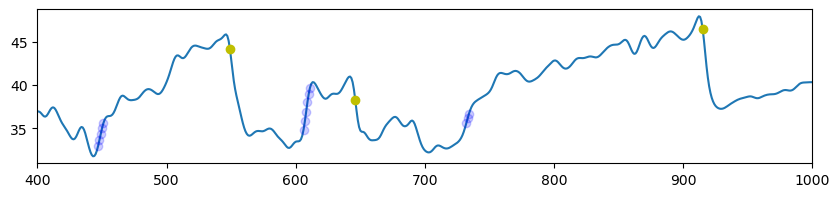

(5, 3)
(5, 3, [486, 750, 869])
(5, 3, [])


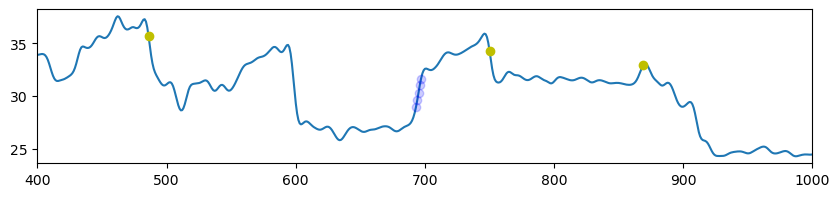

(5, 4)
(5, 4, [567, 899])
(5, 4, [])


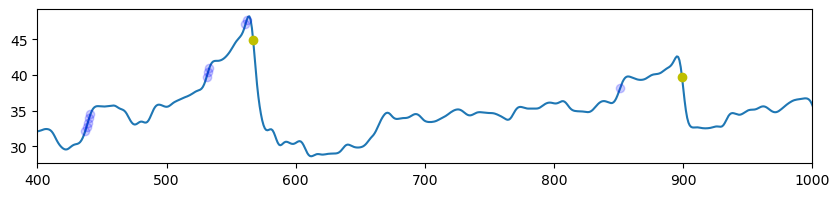

(5, 5)
(5, 5, [509, 885])
(5, 5, [])


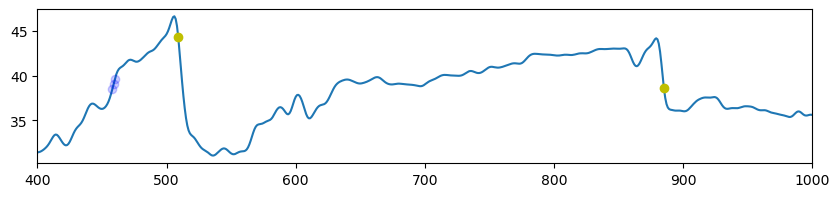

(5, 6)
(5, 6, [473, 572, 741])
(5, 6, [])


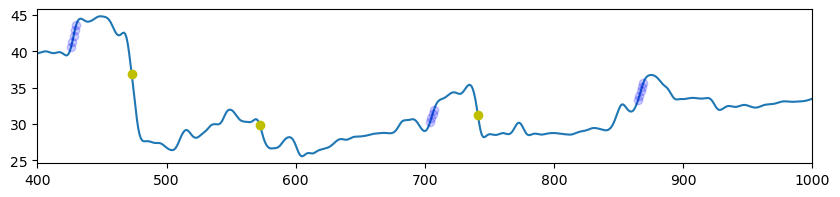

(5, 7)
(5, 7, [517, 857])
(5, 7, [])


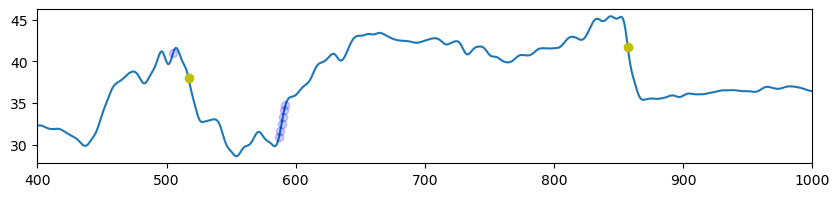

(5, 8)
(5, 8, [534, 717])
(5, 8, [])


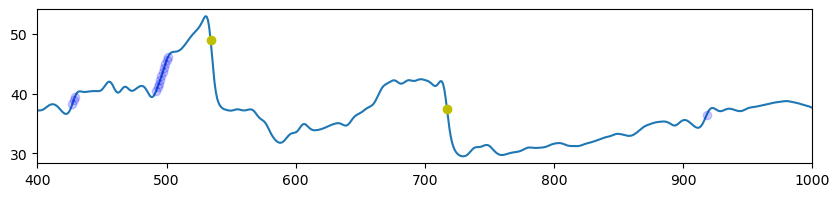

(5, 9)
(5, 9, [255, 425, 605])
(5, 9, [])


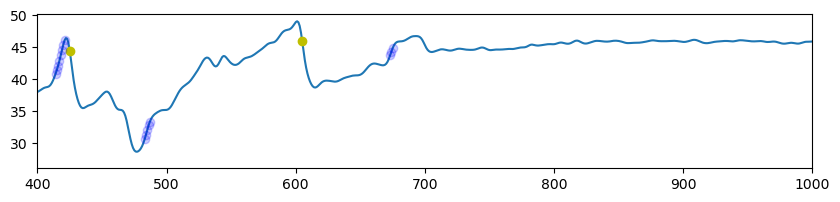

(5, 10)
(5, 10, [385, 576, 769])
(5, 10, [])


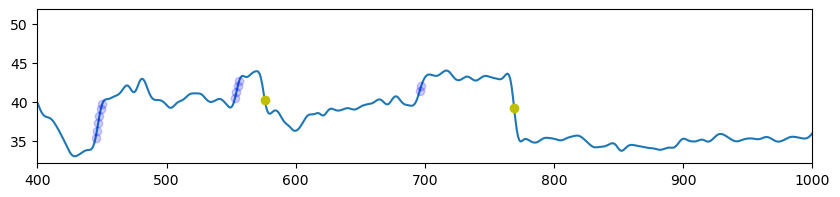

(6, 1)
(6, 1, [156, 274, 466, 507, 613, 750, 881, 937, 953, 991, 1004, 1040, 1061, 1072, 1116, 1152, 1313])
 shifting peakusing peak finding to :  454
 shifting peakusing peak finding to :  492
(6, 1, [454, 492, 613, 750])


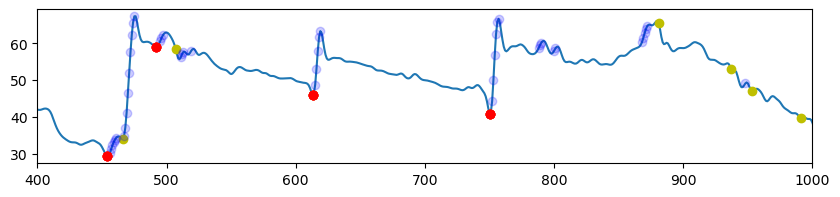

(6, 2)
(6, 2, [3, 17, 86, 152, 190, 255, 307, 333, 386, 450, 537, 590, 689, 773, 836, 944, 1035])
 shifting peakusing peak finding to :  441
 shifting peakusing peak finding to :  757
 shifting peakusing peak finding to :  829
(6, 2, [441, 537, 590, 689, 757, 829, 944])


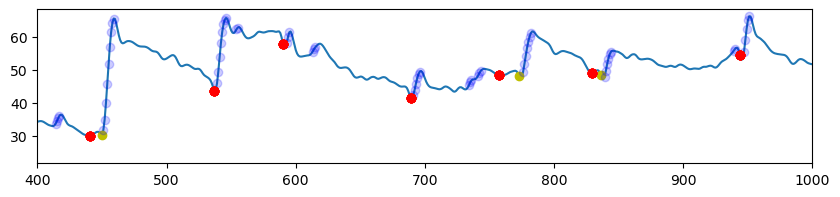

(6, 3)
(6, 3, [499, 609, 722, 750, 767, 802, 812, 840, 862, 874, 937, 969, 980, 993, 1038, 1093, 1109, 1380])
more than one peak found for  (6, 3)
 shifting peakusing peak finding to :  593
 shifting peakusing peak finding to :  758
 shifting peakusing peak finding to :  784
 shifting peakusing peak finding to :  837
 shifting peakusing peak finding to :  871
(6, 3, [499, 593, 722, 758, 784, 812, 837, 871])


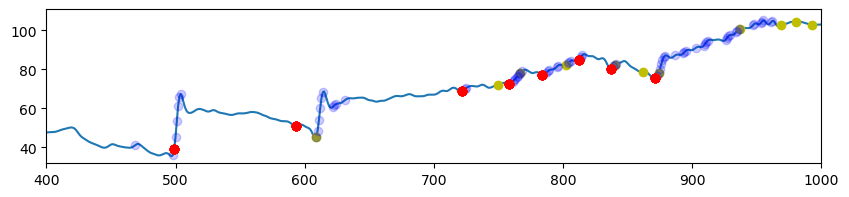

(6, 4)
(6, 4, [494, 594, 669, 731, 844, 903, 1038, 1114, 1380])
 shifting peakusing peak finding to :  481
 shifting peakusing peak finding to :  716
 shifting peakusing peak finding to :  831
(6, 4, [481, 594, 669, 716, 831])


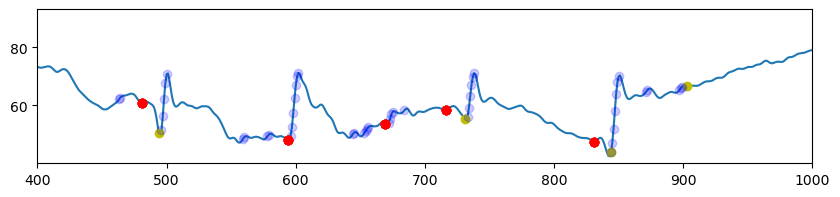

(6, 5)
(6, 5, [180, 193, 232, 477, 616, 760, 867, 976, 1022])
 shifting peakusing peak finding to :  464
more than one peak found for  (6, 5)
 shifting peakusing peak finding to :  961
(6, 5, [464, 616, 760, 867, 961])


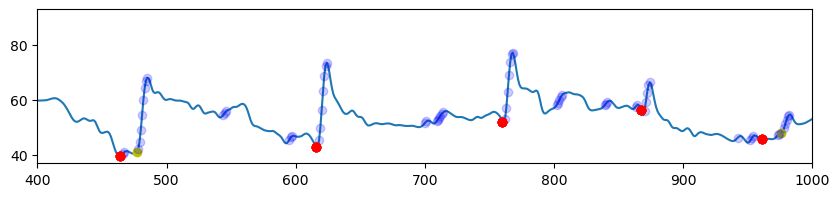

(6, 6)
(6, 6, [484, 651, 816, 1075])
 shifting peakusing peak finding to :  639
 shifting peakusing peak finding to :  807
(6, 6, [484, 639, 807])


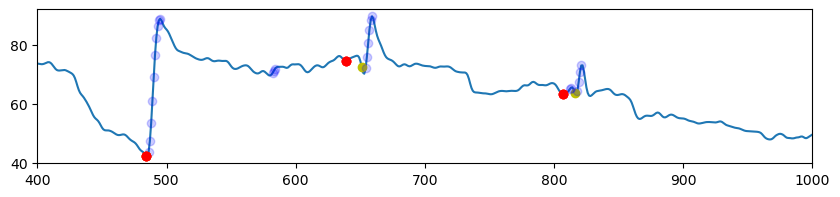

(6, 7)
(6, 7, [189, 559, 653, 910, 995])
 shifting peakusing peak finding to :  543
more than one peak found for  (6, 7)
(6, 7, [543, 653, 910, 995])


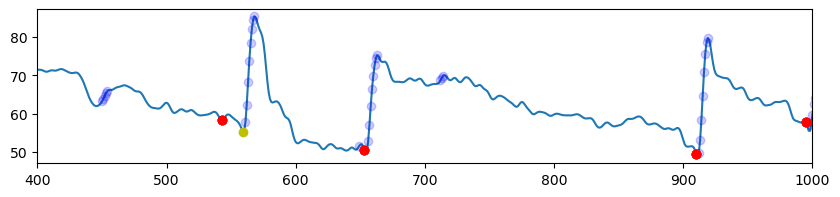

(6, 8)
(6, 8, [205, 270, 299, 578, 999])
 shifting peakusing peak finding to :  571
 shifting peakusing peak finding to :  982
(6, 8, [571, 982])


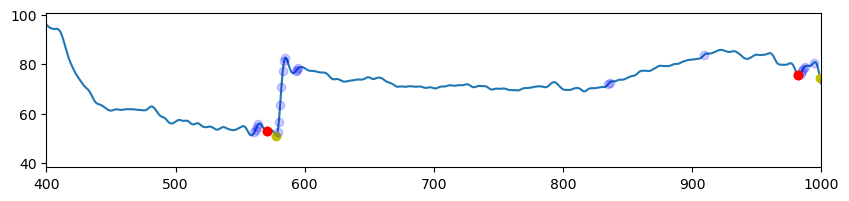

(6, 9)
(6, 9, [586, 700, 821, 845, 886, 1105])
 shifting peakusing peak finding to :  568
(6, 9, [568, 700])


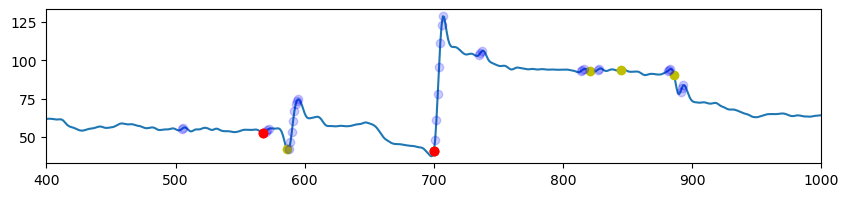

(6, 10)
(6, 10, [570, 727, 887, 938])
 shifting peakusing peak finding to :  552
(6, 10, [552, 727, 887, 938])


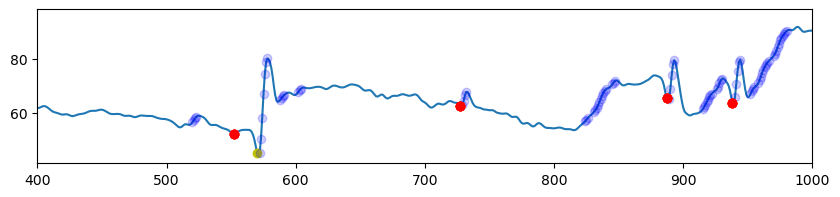

(7, 1)
(7, 1, [411, 447, 477, 521, 561, 678, 780, 880, 893, 985])
(7, 1, [477, 880])


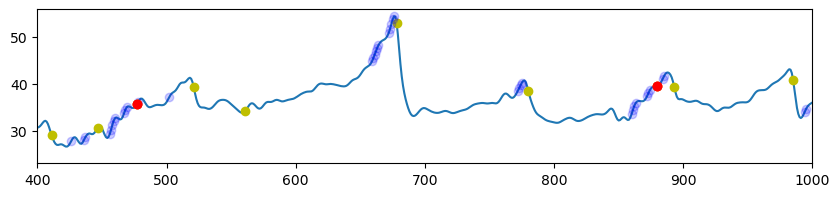

(7, 2)
(7, 2, [50, 70, 97, 450, 511, 542, 678, 724, 900])
 shifting peakusing peak finding to :  538
more than one peak found for  (7, 2)
(7, 2, [538, 900])


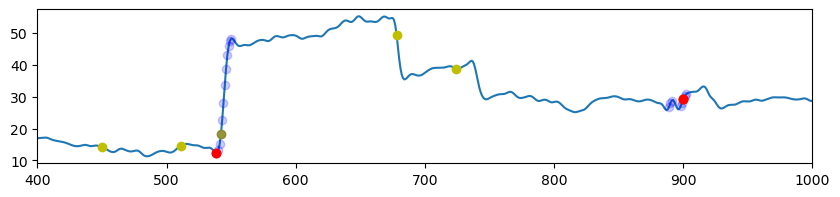

(7, 3)
(7, 3, [431, 561, 711, 866])
 shifting peakusing peak finding to :  556
(7, 3, [556])


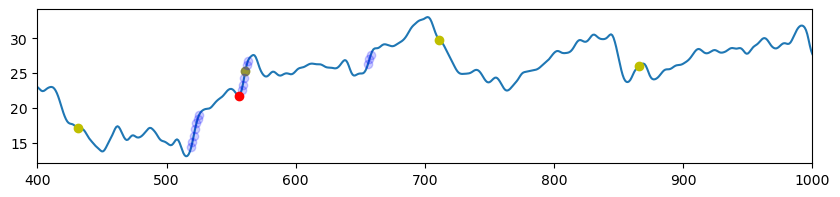

(7, 4)
(7, 4, [71, 87, 122, 145, 186, 228, 275, 315, 483, 635, 652, 670, 748, 758, 1027, 1052])
 shifting peakusing peak finding to :  648
 shifting peakusing peak finding to :  755
(7, 4, [648, 755])


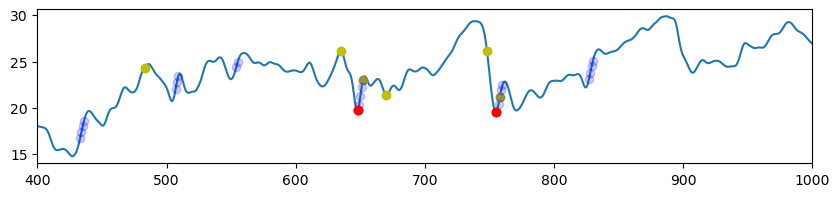

(7, 5)
(7, 5, [455, 547, 631, 713, 721, 738])
(7, 5, [])


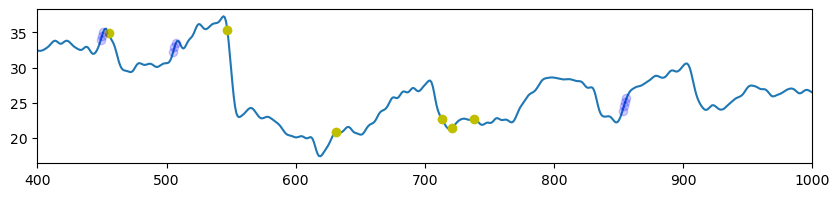

(7, 6)
(7, 6, [465, 525, 972])
(7, 6, [])


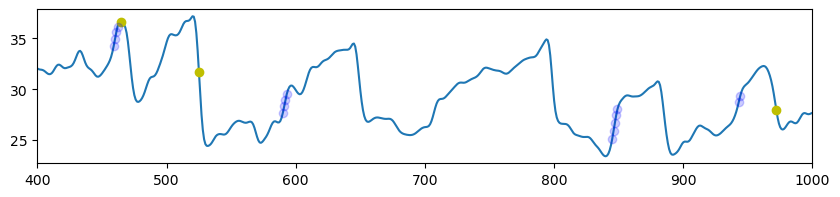

(7, 7)
(7, 7, [450, 505, 608, 961, 1001])
(7, 7, [])


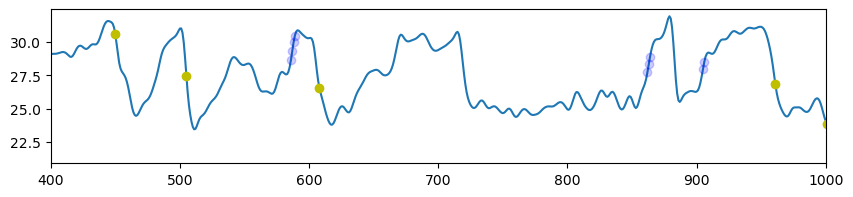

(7, 8)
(7, 8, [448, 567, 834, 913])
 shifting peakusing peak finding to :  443
(7, 8, [443])


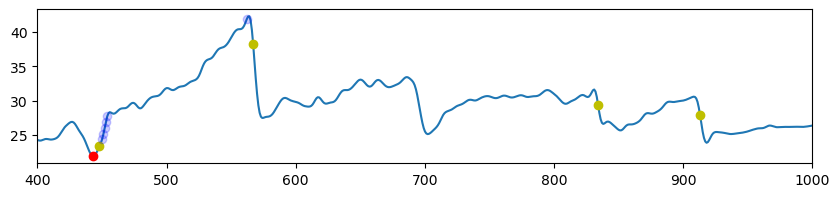

(7, 9)
(7, 9, [478, 623, 637, 994])
(7, 9, [])


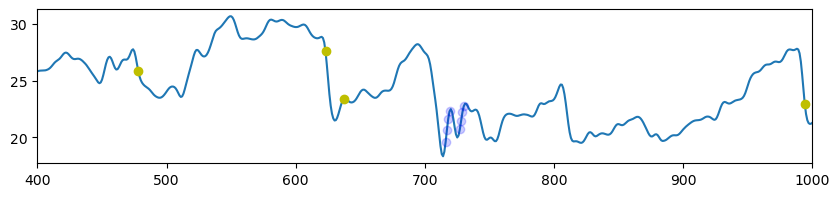

(7, 10)
(7, 10, [467, 508, 561, 582, 775, 996])
 shifting peakusing peak finding to :  464
 shifting peakusing peak finding to :  504
(7, 10, [464, 504])


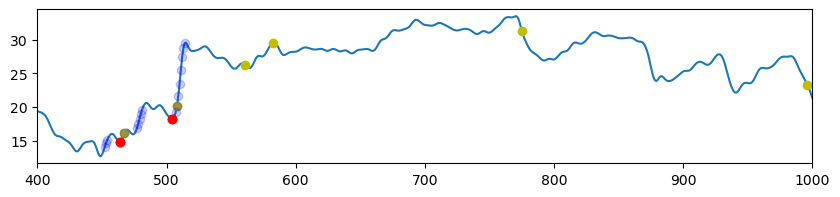

(1, 1)
(1, 1, [691, 710, 881, 902, 911])
(1, 1, [])


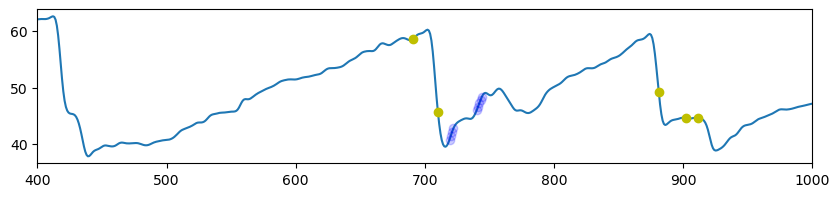

(1, 2)
(1, 2, [233, 421, 494, 591, 638, 778, 794, 806, 933, 954, 984])
(1, 2, [421])


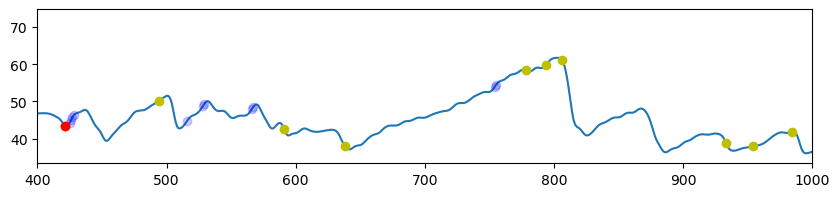

(1, 3)
(1, 3, [331, 345, 436, 559, 693, 743, 846, 939])
(1, 3, [559])


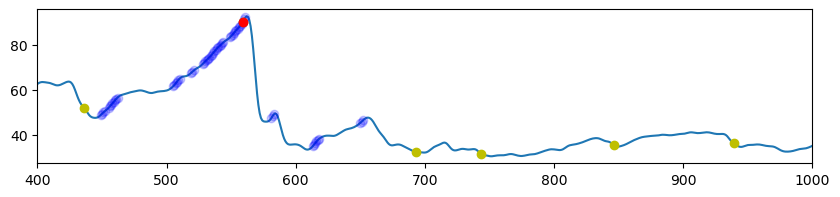

(1, 4)
(1, 4, [1, 11, 65, 134, 177, 277, 438, 484, 563, 577, 836])
(1, 4, [])


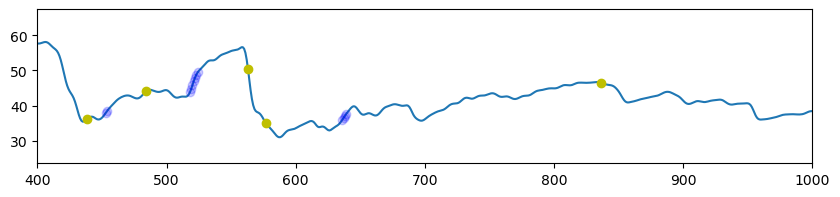

(1, 5)
(1, 5, [10, 440, 572, 589, 601, 635, 849, 898, 996, 1399])
(1, 5, [440])


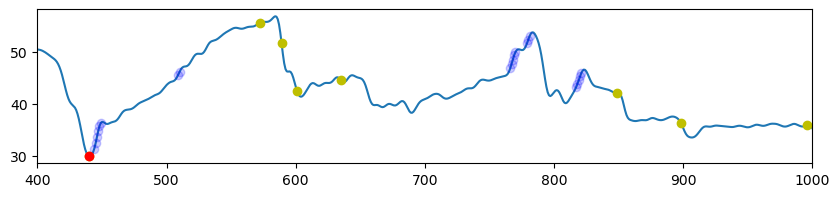

(1, 6)
(1, 6, [33, 64, 161, 203, 317, 448, 603, 649, 717, 791, 961])
 shifting peakusing peak finding to :  438
(1, 6, [438])


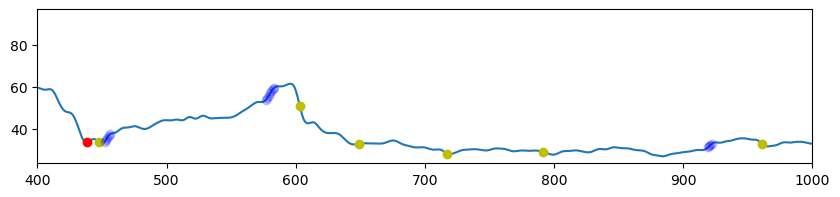

(1, 7)
(1, 7, [518, 546, 656, 784, 886, 944, 988, 1320, 1341, 1393])
(1, 7, [])


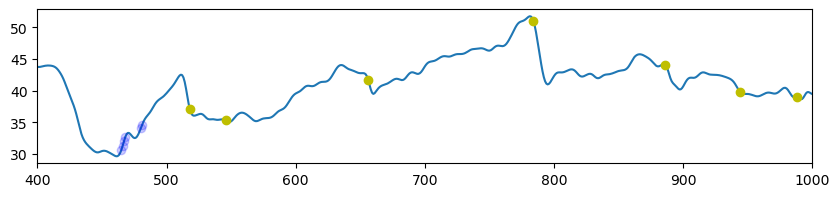

(1, 8)
(1, 8, [502, 534, 617, 700, 792, 846, 878, 911, 955])
(1, 8, [])


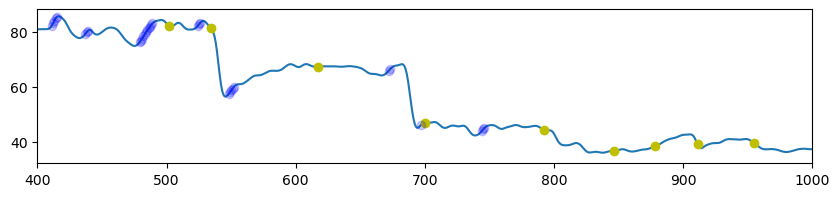

(1, 9)
(1, 9, [181, 453, 485, 502, 517, 539, 690, 718, 801, 900, 1037])
(1, 9, [])


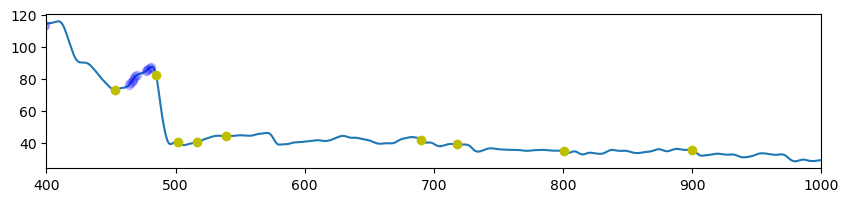

(1, 10)
(1, 10, [151, 286, 323, 393, 416, 497, 584, 665, 707, 801, 872, 1004])
 shifting peakusing peak finding to :  413
(1, 10, [413])


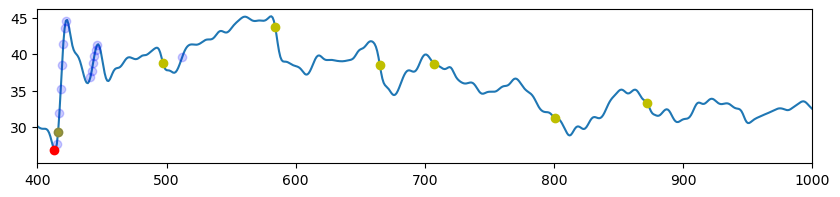

(2, 1)
(2, 1, [548, 634, 795, 966])
 shifting peakusing peak finding to :  963
(2, 1, [548, 634, 795, 963])


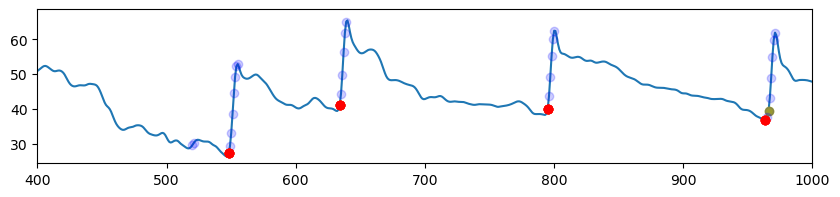

(2, 2)
(2, 2, [36, 614, 700, 813])
(2, 2, [614, 700, 813])


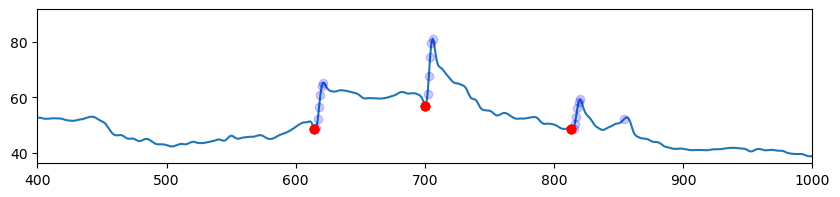

(2, 3)
(2, 3, [429, 616, 738, 790, 932])
 shifting peakusing peak finding to :  411
(2, 3, [411, 616, 738, 790, 932])


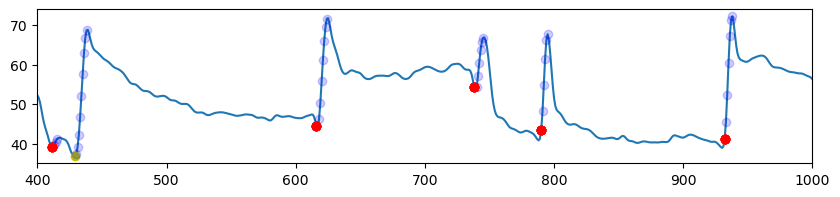

(2, 4)
(2, 4, [27, 435, 638, 876, 1061, 1121])
 shifting peakusing peak finding to :  632
 shifting peakusing peak finding to :  868
(2, 4, [435, 632, 868])


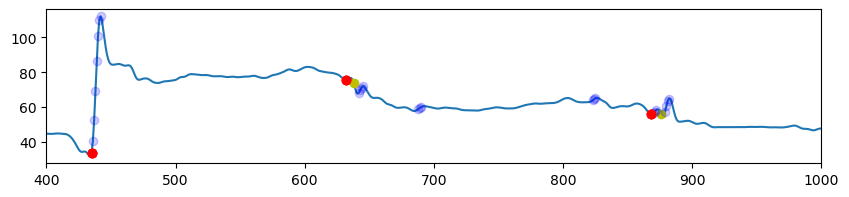

(2, 5)
(2, 5, [283, 294, 445, 599, 740, 898, 1191])
(2, 5, [445, 599, 740, 898])


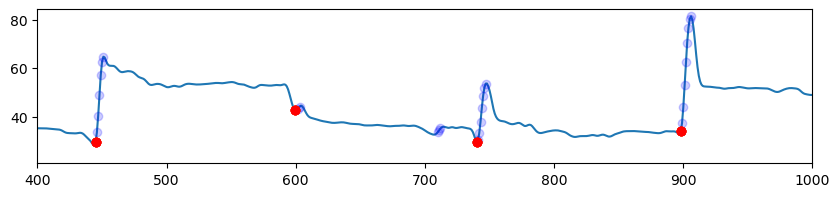

(2, 6)
(2, 6, [188, 493, 750, 885, 1093])
(2, 6, [493, 750, 885])


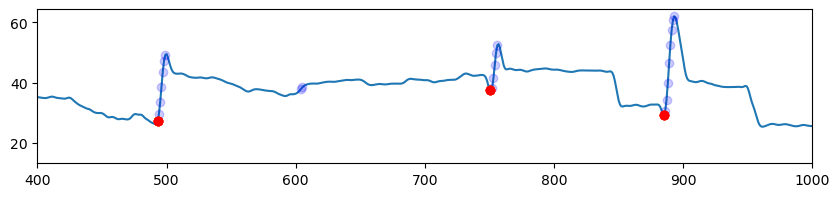

(2, 7)
(2, 7, [255, 413, 446, 541, 876, 997, 1116])
 shifting peakusing peak finding to :  403
 shifting peakusing peak finding to :  983
(2, 7, [403, 446, 541, 876, 983])


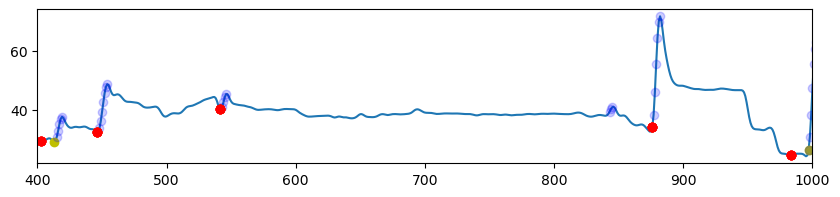

(2, 8)
(2, 8, [299, 502, 671, 758, 844, 919])
 shifting peakusing peak finding to :  842
(2, 8, [502, 671, 758, 842, 919])


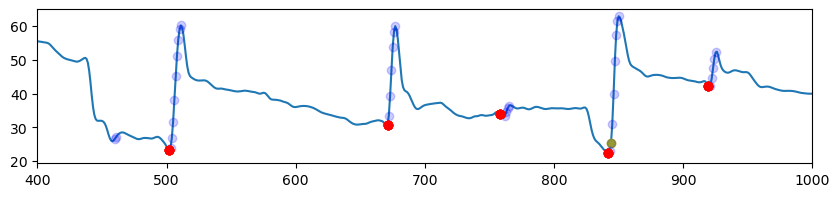

(2, 9)
(2, 9, [628, 881, 1025, 1232])
(2, 9, [628, 881])


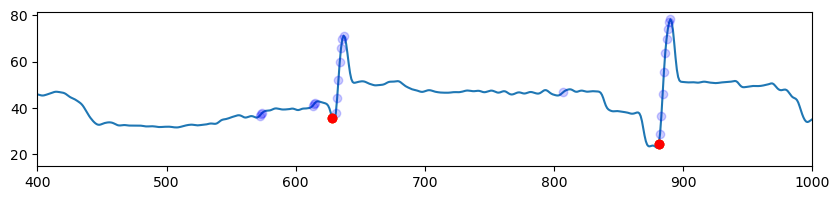

(2, 10)
(2, 10, [113, 523, 600, 838, 927, 1195])
 shifting peakusing peak finding to :  925
(2, 10, [523, 600, 838, 925])


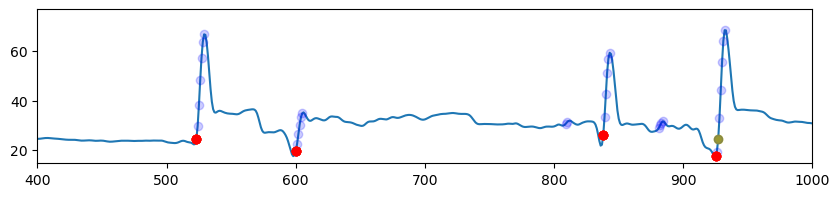

(3, 1)
(3, 1, [364, 644, 722, 767, 830, 975])
 shifting peakusing peak finding to :  635
(3, 1, [635, 722, 767, 830, 975])


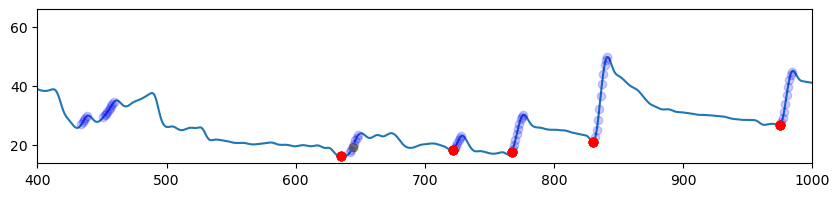

(3, 2)
(3, 2, [198, 262, 917, 1252])
(3, 2, [917])


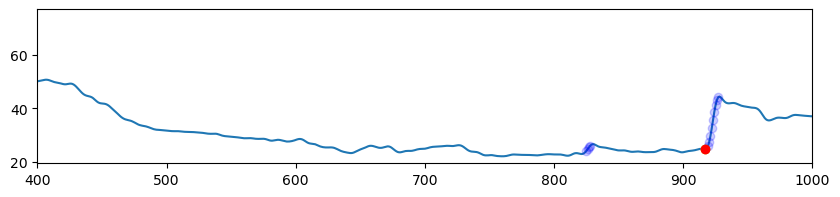

(3, 3)
(3, 3, [441, 493, 528, 601, 763, 825, 941])
(3, 3, [441, 528, 601, 763, 825, 941])


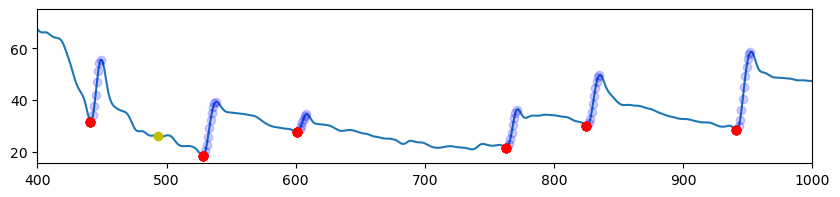

(3, 4)
(3, 4, [420, 517, 559, 737, 792, 924, 1042])
 shifting peakusing peak finding to :  778
(3, 4, [420, 559, 737, 778, 924])


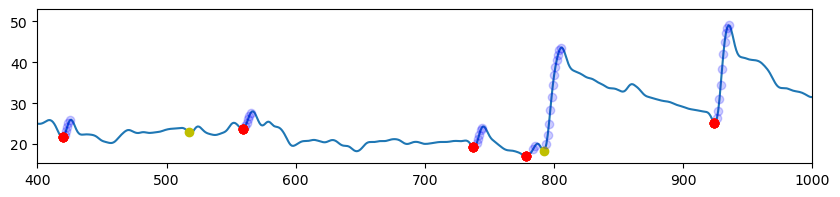

(3, 5)
(3, 5, [690])
(3, 5, [])


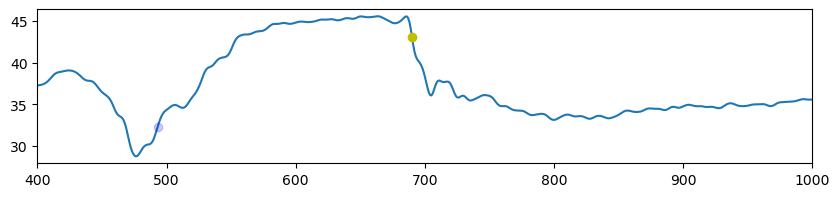

(3, 6)
(3, 6, [117, 331, 449, 658, 777])
 shifting peakusing peak finding to :  446
(3, 6, [446, 658, 777])


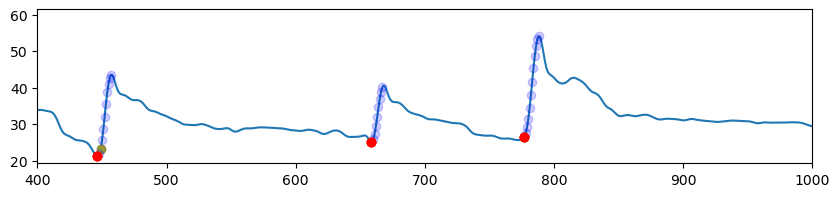

(3, 7)
(3, 7, [76, 165, 509, 994])
(3, 7, [509, 994])


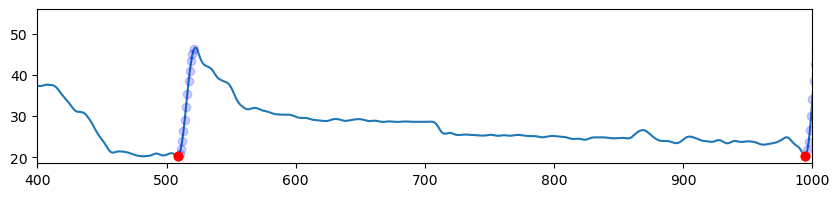

(3, 8)
(3, 8, [619, 696, 832, 916, 1161, 1326, 1341])
 shifting peakusing peak finding to :  609
(3, 8, [609, 696, 832, 916])


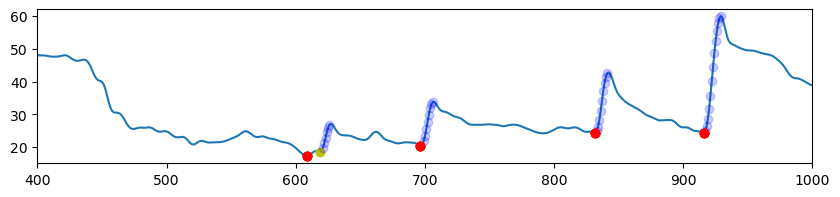

(3, 9)
(3, 9, [569, 610, 735, 844])
 shifting peakusing peak finding to :  837
(3, 9, [569, 610, 735, 837])


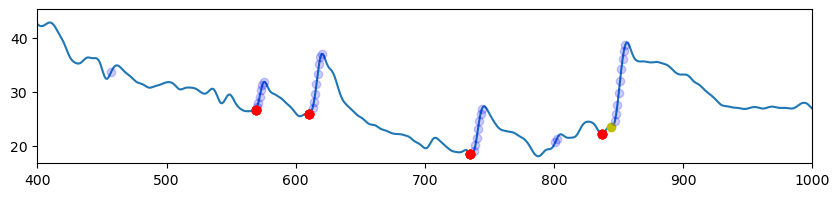

(3, 10)
(3, 10, [727, 823])
(3, 10, [727, 823])


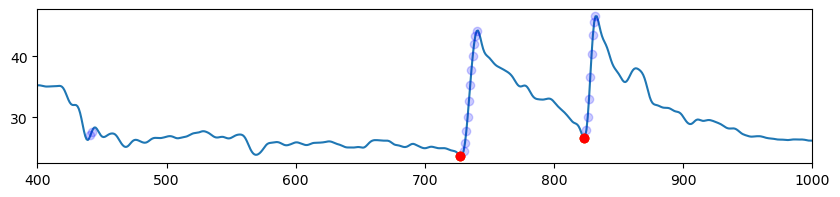

(4, 1)
(4, 1, [40, 324, 366, 390, 433, 529, 627, 744, 952])
 shifting peakusing peak finding to :  430
 shifting peakusing peak finding to :  520
(4, 1, [430, 520, 627, 744, 952])


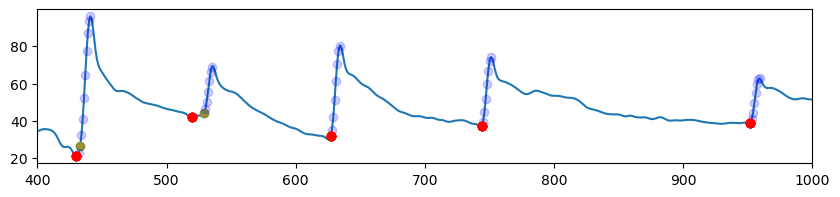

(4, 2)
(4, 2, [49, 176, 244, 381, 435, 528, 569, 654, 746, 811, 942])
(4, 2, [435, 528, 569, 654, 746, 811, 942])


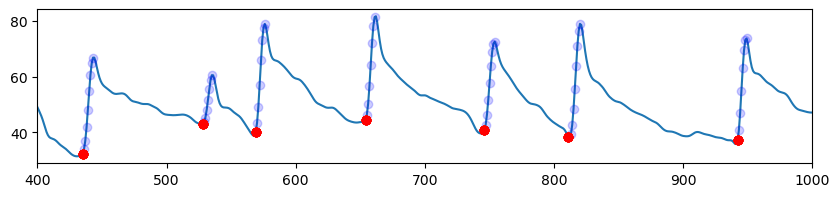

(4, 3)
(4, 3, [414, 458, 518, 602, 664, 833, 982])
 shifting peakusing peak finding to :  599
(4, 3, [414, 458, 518, 599, 664, 833, 982])


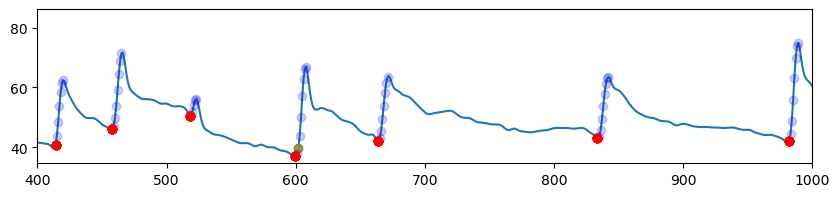

(4, 4)
(4, 4, [64, 74, 487, 556, 654, 1176])
(4, 4, [487, 556, 654])


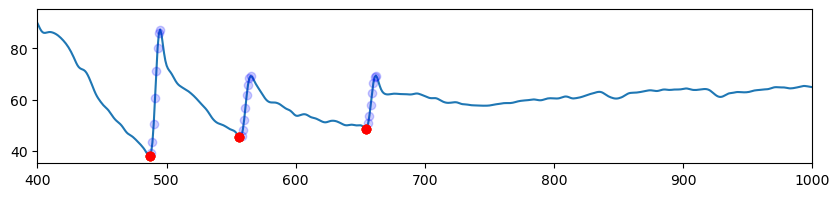

(4, 5)
(4, 5, [132, 457, 523, 602, 680, 779, 860, 974, 1279])
(4, 5, [457, 523, 602, 680, 779, 860, 974])


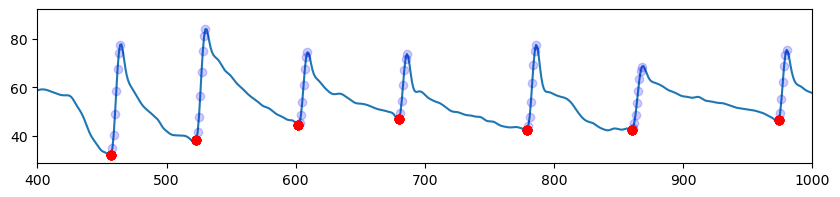

(4, 6)
(4, 6, [424, 472, 560, 753, 1025])
 shifting peakusing peak finding to :  460
 shifting peakusing peak finding to :  544
(4, 6, [424, 460, 544, 753])


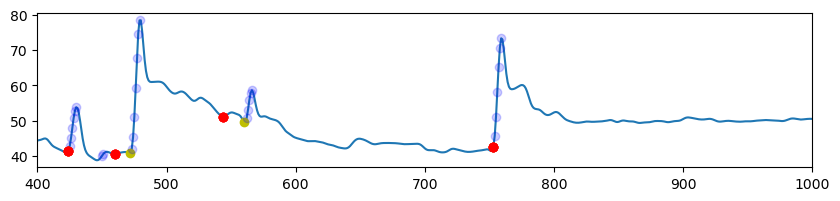

(4, 7)
(4, 7, [429, 508, 633, 752, 823, 934, 998, 1255])
(4, 7, [429, 508, 752, 823, 934, 998])


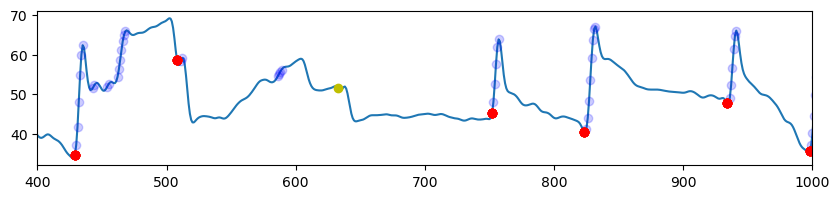

(4, 8)
(4, 8, [438, 554, 606, 731, 1120])
 shifting peakusing peak finding to :  431
(4, 8, [431, 554, 606, 731])


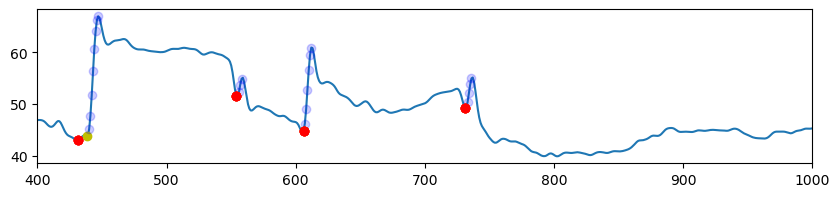

(4, 9)
(4, 9, [374, 527, 616, 717, 887])
 shifting peakusing peak finding to :  511
 shifting peakusing peak finding to :  709
(4, 9, [511, 616, 709, 887])


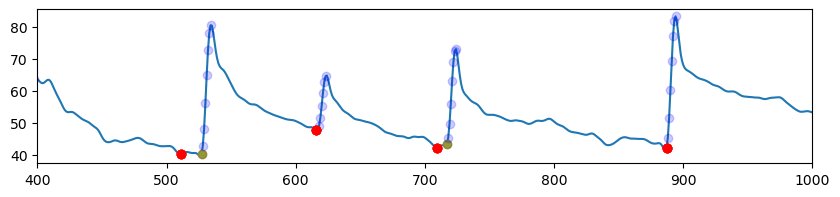

(4, 10)
(4, 10, [3, 104, 147, 190, 202, 226, 452, 574, 652, 752, 847])
(4, 10, [574, 652, 752, 847])


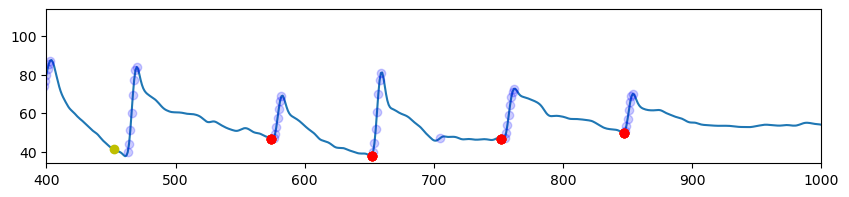

(5, 1)
(5, 1, [545, 599, 708, 875, 992])
(5, 1, [875])


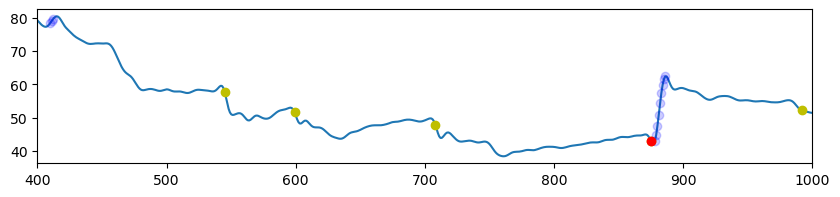

(5, 2)
(5, 2, [181, 522, 618, 773, 1341])
(5, 2, [])


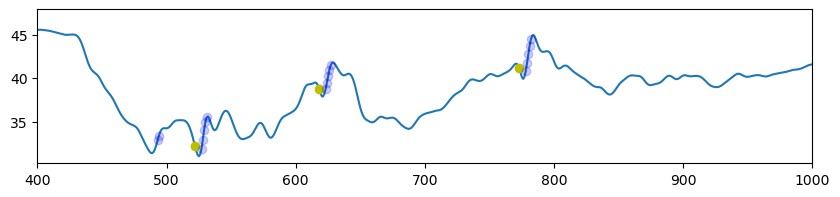

(5, 3)
(5, 3, [506, 563, 744])
(5, 3, [])


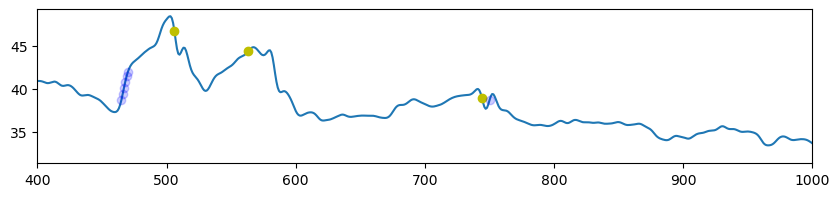

(5, 4)
(5, 4, [123, 453, 561, 727])
(5, 4, [561])


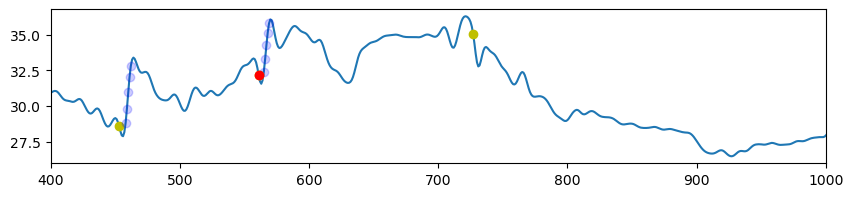

(5, 5)
(5, 5, [416, 499, 667])
(5, 5, [416, 499])


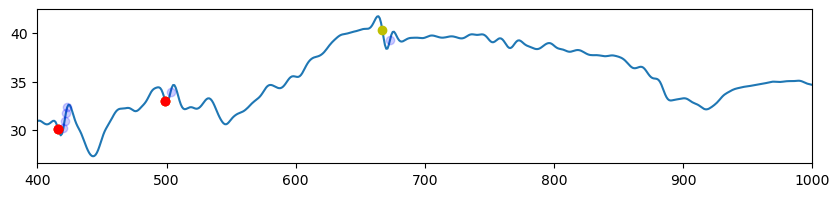

(5, 6)
(5, 6, [445, 537, 663])
 shifting peakusing peak finding to :  654
(5, 6, [654])


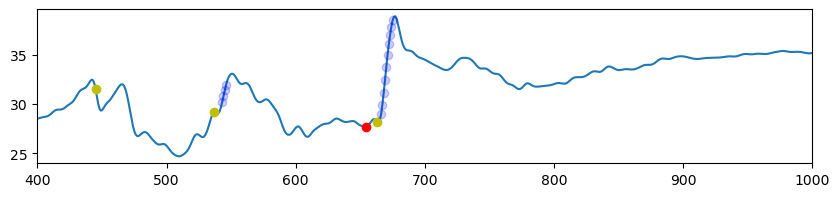

(5, 7)
(5, 7, [523, 713])
(5, 7, [])


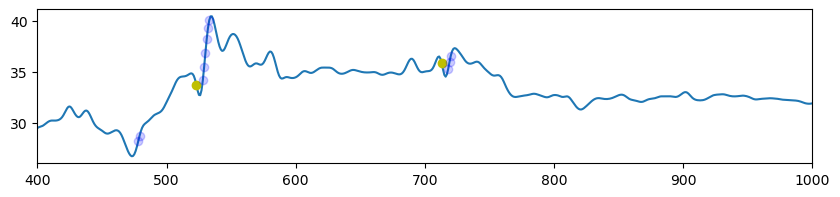

(5, 8)
(5, 8, [413, 516, 686, 935, 1399])
(5, 8, [686, 935])


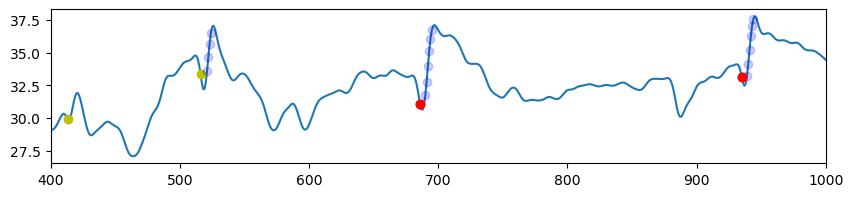

(5, 9)
(5, 9, [99, 269, 302, 432, 540])
(5, 9, [432, 540])


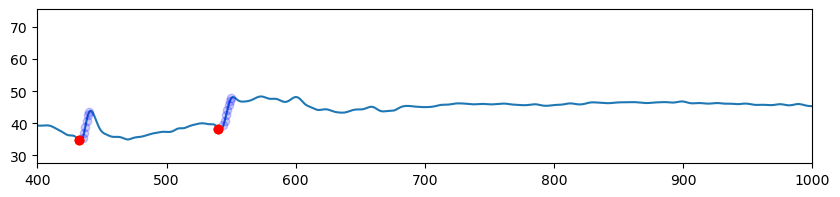

(5, 10)
(5, 10, [31, 47, 65, 283, 393, 545, 727, 750])
(5, 10, [545])


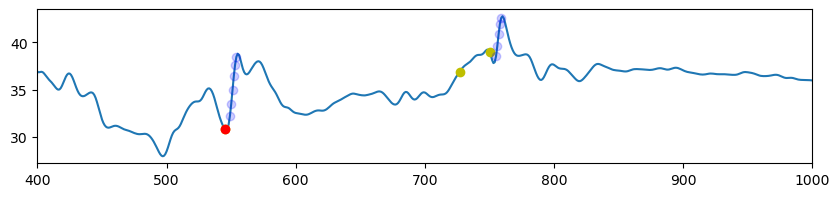

(6, 1)
(6, 1, [272, 450, 568, 661, 899])
 shifting peakusing peak finding to :  442
(6, 1, [442, 899])


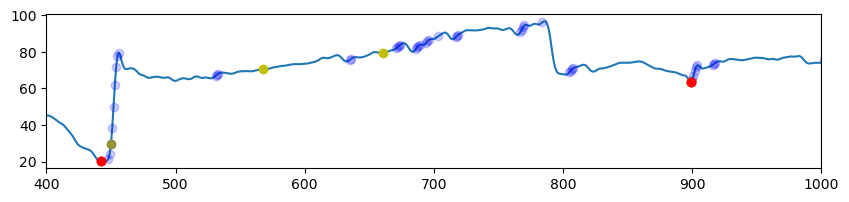

(6, 2)
(6, 2, [66, 115, 189, 344, 584, 822, 1047])
 shifting peakusing peak finding to :  574
(6, 2, [574])


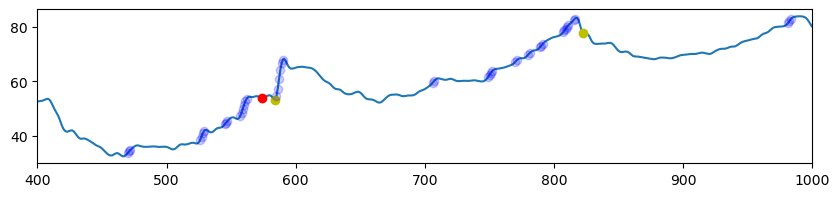

(6, 3)
(6, 3, [312, 1340, 1363])
(6, 3, [])


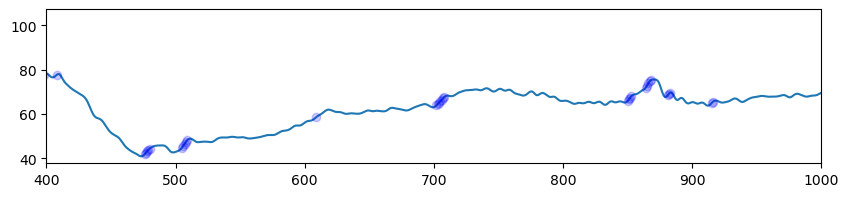

(6, 4)
(6, 4, [566, 601, 612, 729, 907, 943, 969, 1017, 1035])
 shifting peakusing peak finding to :  930
(6, 4, [601, 612, 930])


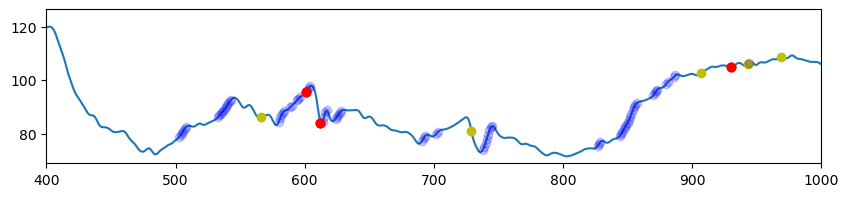

(6, 5)
(6, 5, [611, 854])
(6, 5, [854])


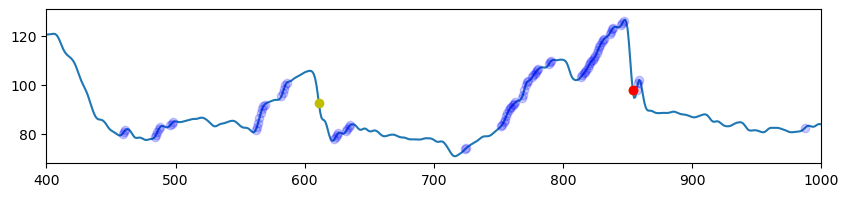

(6, 6)
(6, 6, [3, 29, 67, 110, 798, 1081])
 shifting peakusing peak finding to :  785
(6, 6, [785])


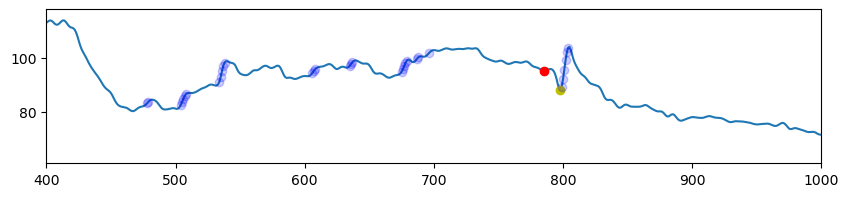

(6, 7)
(6, 7, [677, 747, 754, 782])
(6, 7, [677])


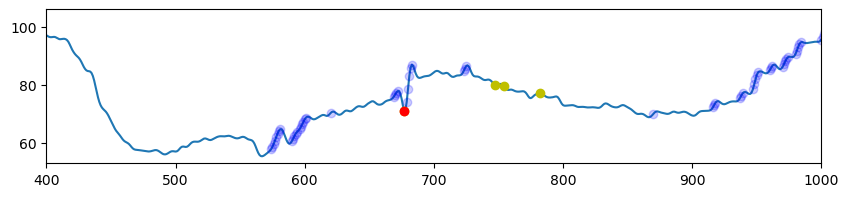

(6, 8)
no swing found


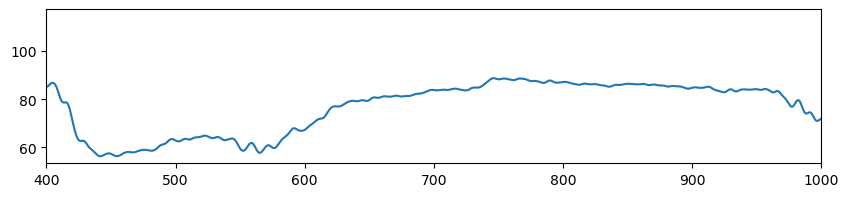

(6, 9)
(6, 9, [471, 864])
(6, 9, [471, 864])


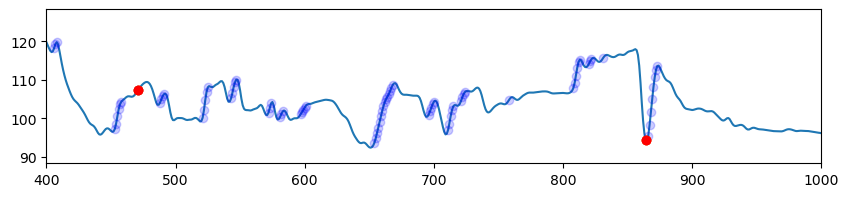

(6, 10)
(6, 10, [289, 399, 814, 836, 1053])
 shifting peakusing peak finding to :  803
(6, 10, [803])


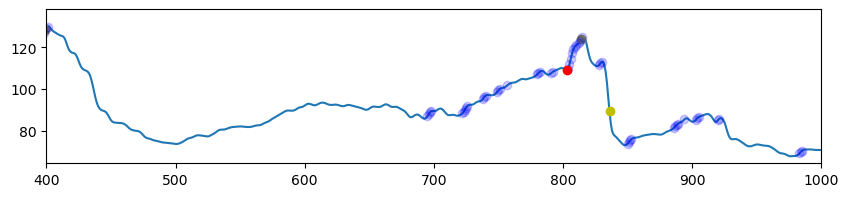

(7, 1)
(7, 1, [41, 381, 416, 481, 533, 617, 699, 789, 912, 1023])
 shifting peakusing peak finding to :  402
(7, 1, [402, 789])


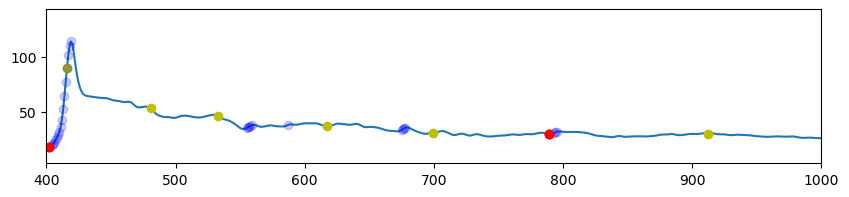

(7, 2)
(7, 2, [43, 86, 123, 162, 253, 258, 293, 334, 370, 496, 530, 575, 590, 699, 980])
(7, 2, [530])


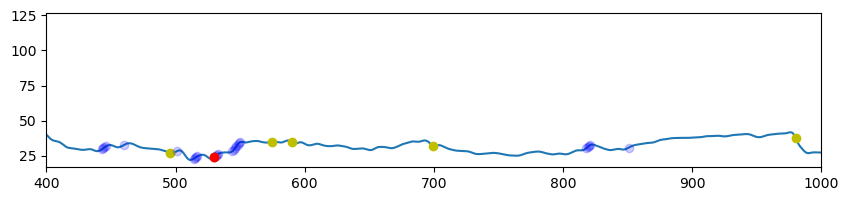

(7, 3)
(7, 3, [42, 308, 502, 671, 1012])
(7, 3, [502])


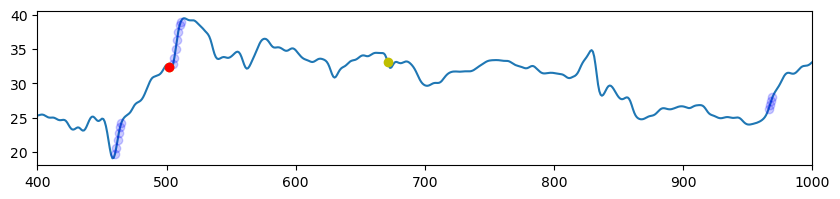

(7, 4)
(7, 4, [416, 503, 697, 880])
(7, 4, [416])


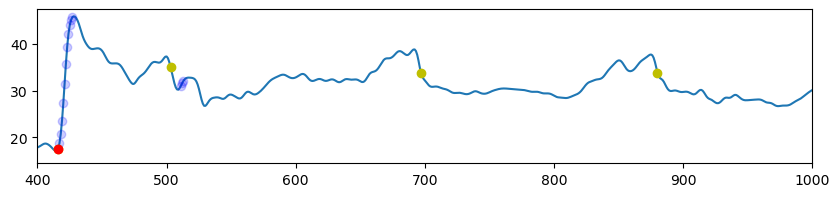

(7, 5)
(7, 5, [418, 484, 648, 798, 967])
 shifting peakusing peak finding to :  412
(7, 5, [412, 484])


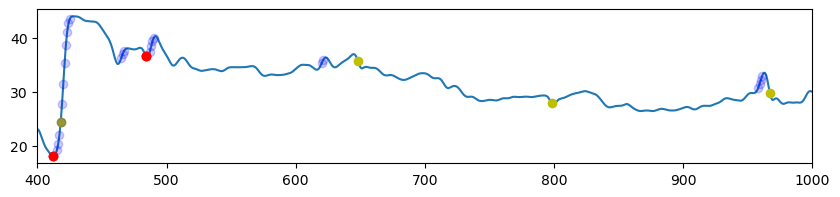

(7, 6)
(7, 6, [466, 544, 658, 813, 1009])
(7, 6, [813])


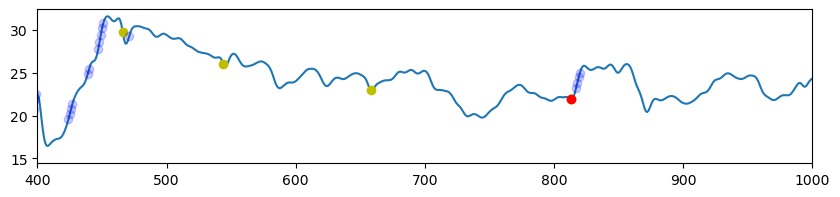

(7, 7)
(7, 7, [461, 615, 756, 947])
(7, 7, [461])


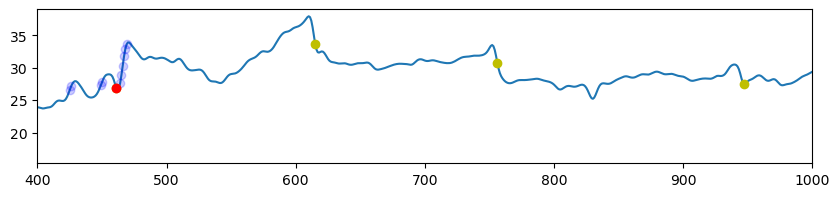

(7, 8)
(7, 8, [437, 502, 653, 846])
(7, 8, [502, 653])


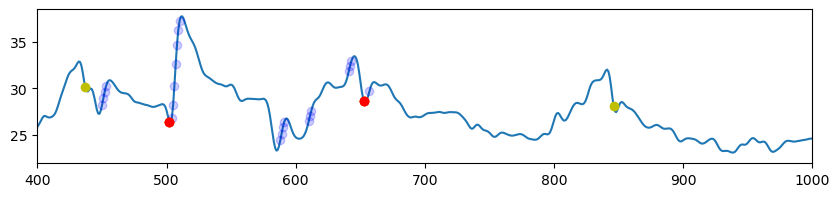

(7, 9)
(7, 9, [443, 515, 608, 787, 991])
(7, 9, [])


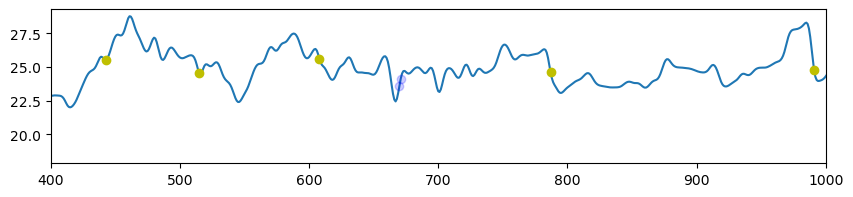

(7, 10)
(7, 10, [493, 787, 986])
(7, 10, [493])


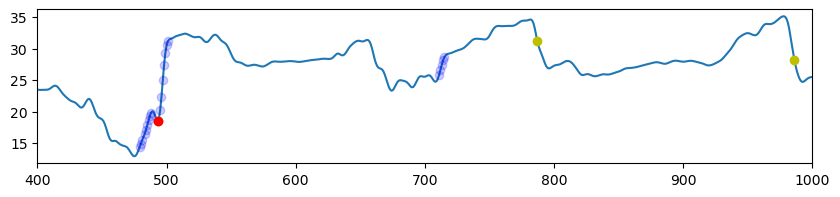

In [ ]:
reset_ang_MDN_R2, swing_count_MDN_R2, swing_ts_MDN_R2 = get_reset_ang_Mleg(MDN, 'R2')
reset_ang_MDN_L2, swing_count_MDN_L2, swing_ts_MDN_L2 = get_reset_ang_Mleg(MDN, 'L2')

(2, 1)
(2, 1, [253, 421, 443])
 shifting peakusing peak finding to :  406
(2, 1, [406, 443])


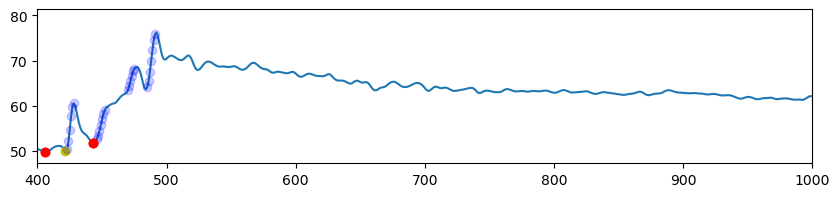

(2, 2)
no swing found


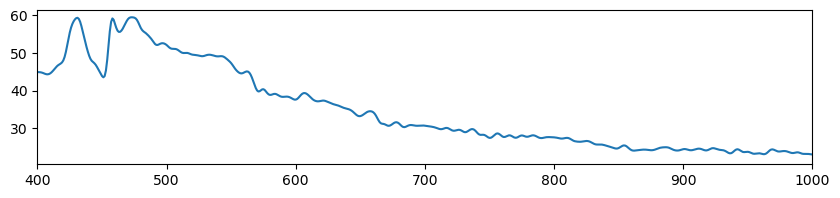

(2, 3)
(2, 3, [261, 282, 530, 1350])
(2, 3, [530])


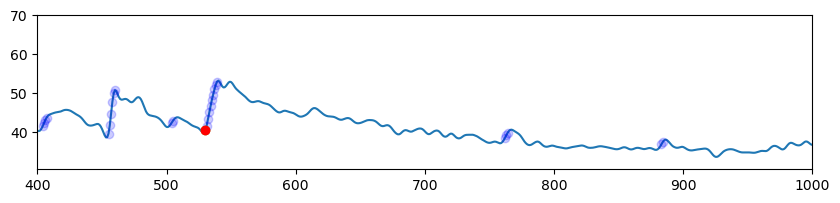

(2, 4)
(2, 4, [57, 377, 461, 615, 1303])
 shifting peakusing peak finding to :  458
(2, 4, [458, 615])


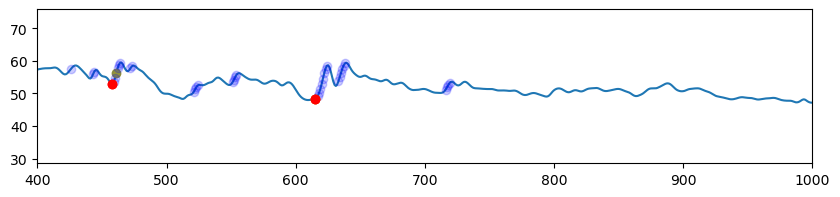

(2, 5)
(2, 5, [907, 1348])
(2, 5, [])


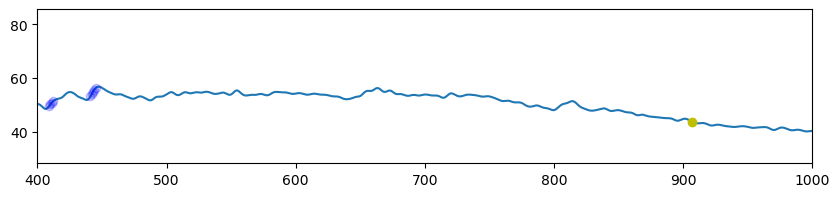

(2, 6)
(2, 6, [9, 221, 237, 432, 543, 609, 719, 744, 1321])
 shifting peakusing peak finding to :  734
(2, 6, [432, 719, 734])


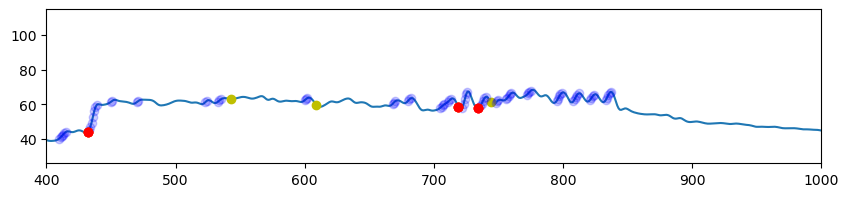

(2, 7)
(2, 7, [812, 1327])
(2, 7, [812])


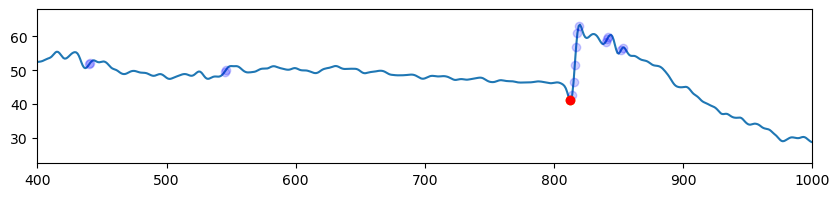

(2, 8)
(2, 8, [540])
(2, 8, [])


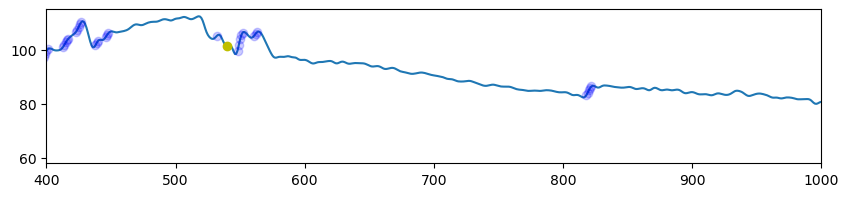

(2, 9)
(2, 9, [312, 1399])
(2, 9, [])


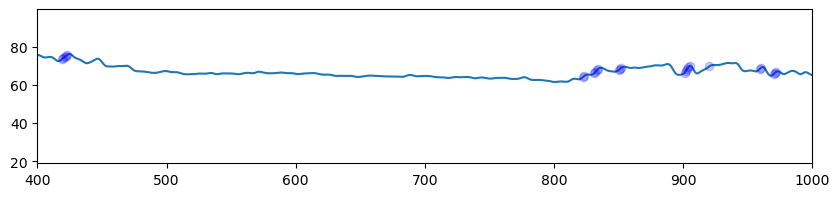

(2, 10)
(2, 10, [208, 222, 271, 448, 479, 673, 726, 883, 905])
 shifting peakusing peak finding to :  437
 shifting peakusing peak finding to :  466
(2, 10, [437, 466, 726, 883])


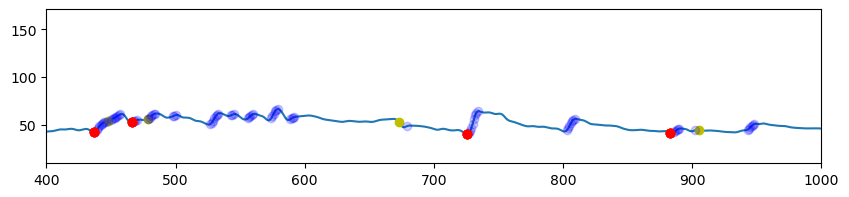

(3, 1)
(3, 1, [548, 897])
(3, 1, [548])


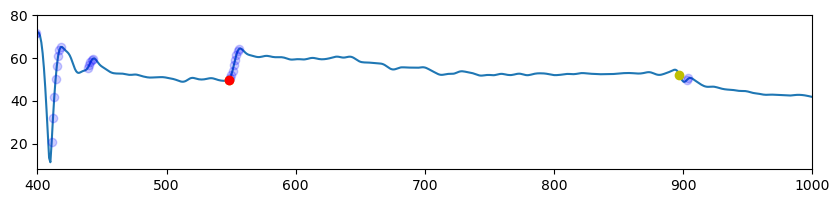

(3, 2)
(3, 2, [409, 486, 881])
(3, 2, [486, 881])


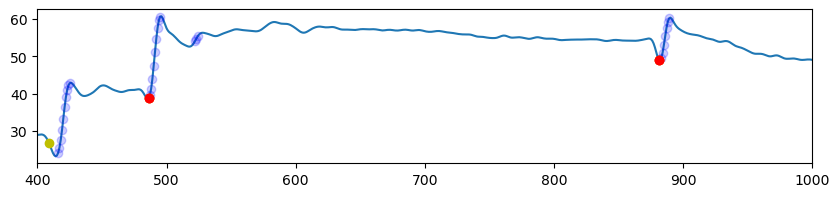

(3, 3)
(3, 3, [440, 549, 961])
 shifting peakusing peak finding to :  543
(3, 3, [440, 543, 961])


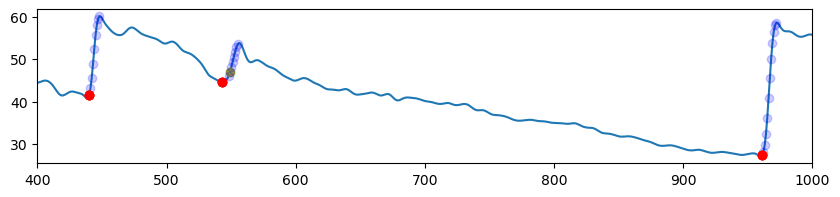

(3, 4)
(3, 4, [489])
(3, 4, [489])


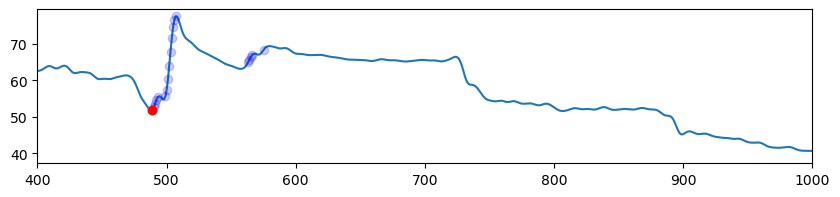

(3, 5)
(3, 5, [452, 806, 969])
 shifting peakusing peak finding to :  446
(3, 5, [446, 806, 969])


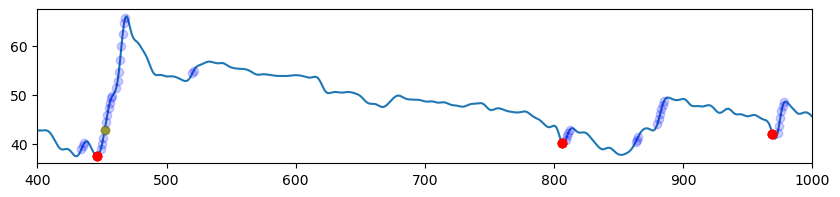

(3, 6)
(3, 6, [436, 493, 537, 586, 616, 708, 739, 760, 849, 863, 925])
 shifting peakusing peak finding to :  432
 shifting peakusing peak finding to :  525
 shifting peakusing peak finding to :  583
 shifting peakusing peak finding to :  852
 shifting peakusing peak finding to :  910
(3, 6, [432, 493, 525, 583, 616, 708, 852, 910])


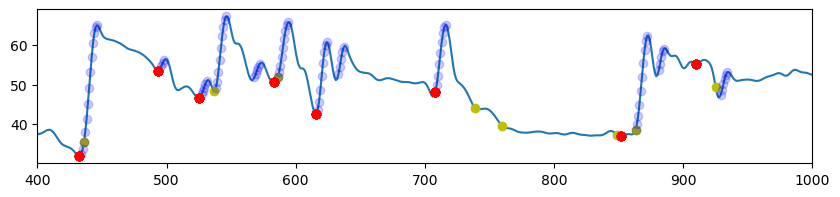

(3, 7)
(3, 7, [480, 557, 942])
 shifting peakusing peak finding to :  551
(3, 7, [480, 551, 942])


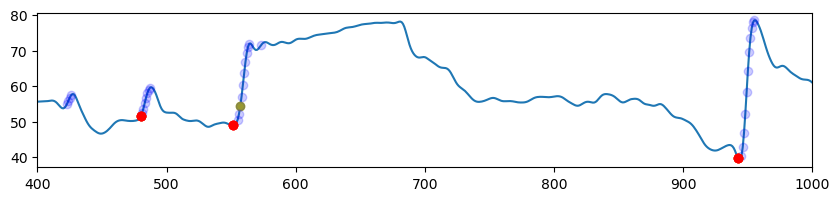

(3, 8)
(3, 8, [476, 880, 990])
(3, 8, [476, 880, 990])


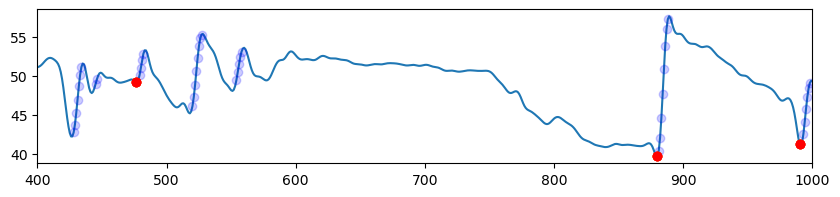

(3, 9)
(3, 9, [450, 465, 488, 502, 557, 627, 870])
 shifting peakusing peak finding to :  485
more than one peak found for  (3, 9)
 shifting peakusing peak finding to :  623
(3, 9, [450, 485, 502, 557, 623])


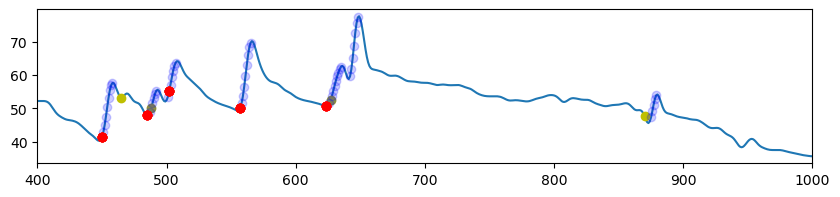

(3, 10)
(3, 10, [435, 489, 605, 688, 727, 765])
 shifting peakusing peak finding to :  418
 shifting peakusing peak finding to :  685
(3, 10, [418, 489, 685])


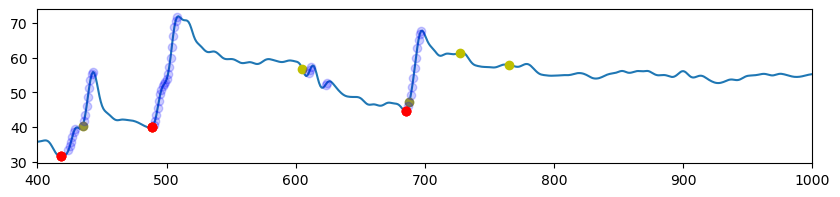

(5, 1)
(5, 1, [416, 797])
(5, 1, [416, 797])


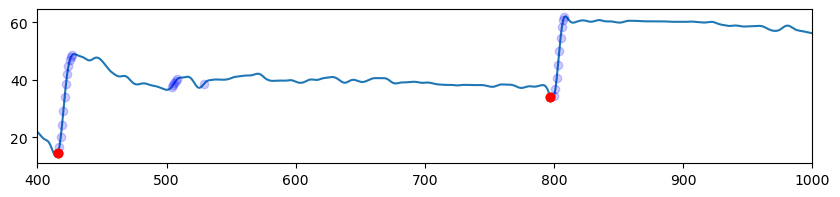

(5, 2)
(5, 2, [441])
 shifting peakusing peak finding to :  427
(5, 2, [427])


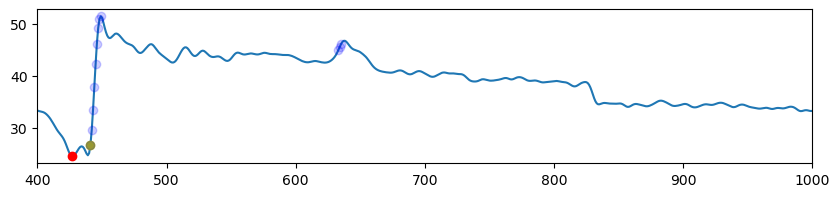

(5, 3)
(5, 3, [471])
 shifting peakusing peak finding to :  460
(5, 3, [460])


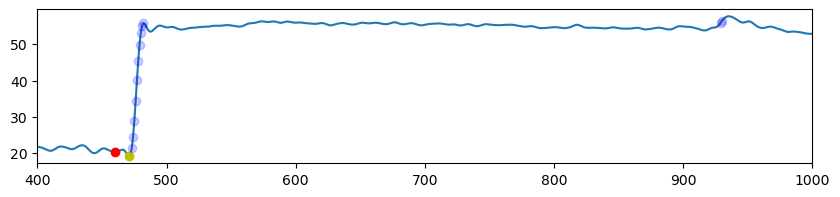

(5, 4)
(5, 4, [458])
 shifting peakusing peak finding to :  448
(5, 4, [448])


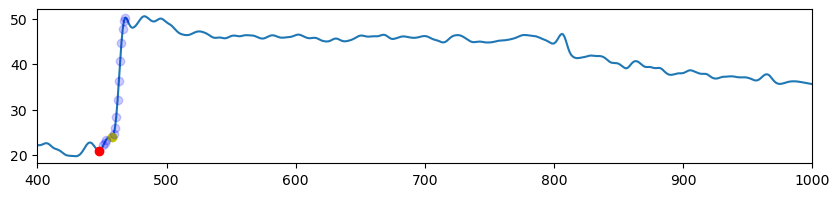

(5, 5)
(5, 5, [446, 538])
 shifting peakusing peak finding to :  535
(5, 5, [446, 535])


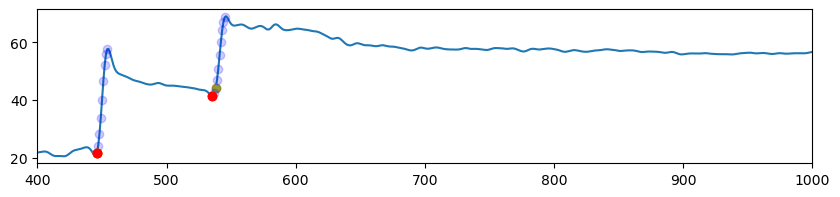

(5, 6)
(5, 6, [363, 445])
 shifting peakusing peak finding to :  430
(5, 6, [430])


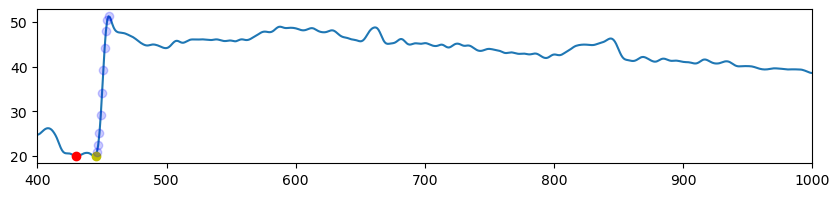

(5, 7)
(5, 7, [457])
(5, 7, [457])


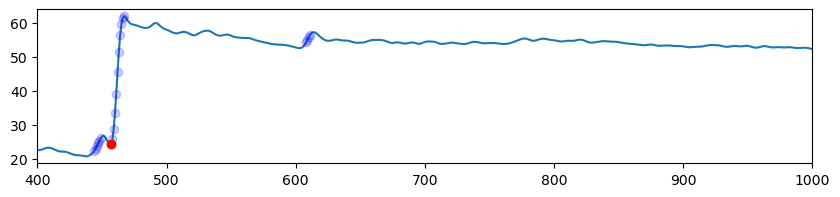

(5, 8)
(5, 8, [460])
 shifting peakusing peak finding to :  446
(5, 8, [446])


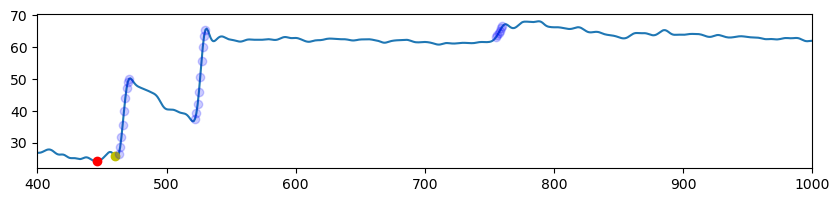

(5, 9)
no swing found


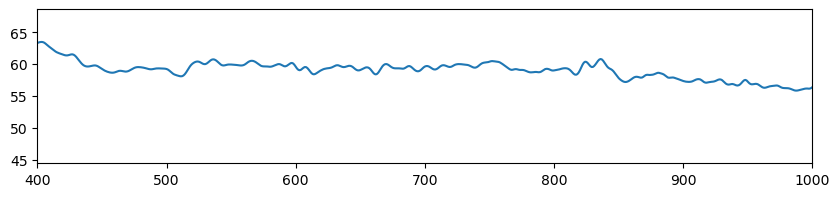

(5, 10)
(5, 10, [1001])
(5, 10, [])


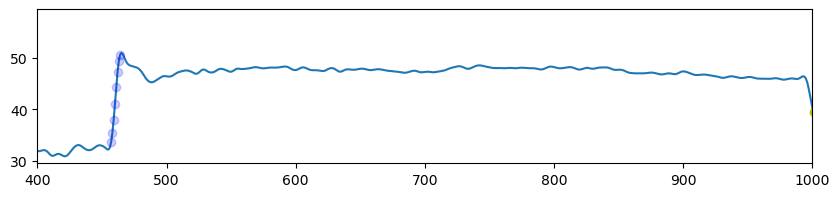

(6, 1)
(6, 1, [417, 462, 489, 543, 566, 599, 626, 680, 713, 738, 768, 826, 956, 991, 1131])
(6, 1, [417, 462, 489, 738, 991])


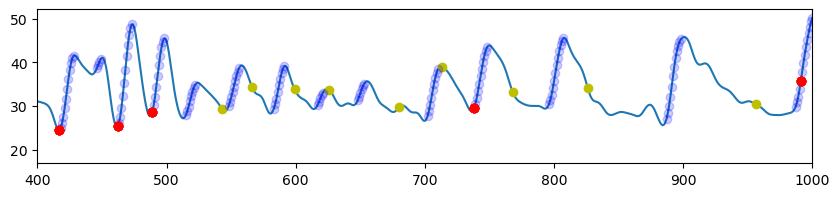

(6, 2)
(6, 2, [425, 441, 476, 502, 591, 613, 671, 736, 772, 838, 875, 908, 1007])
more than one peak found for  (6, 2)
(6, 2, [441, 502, 875])


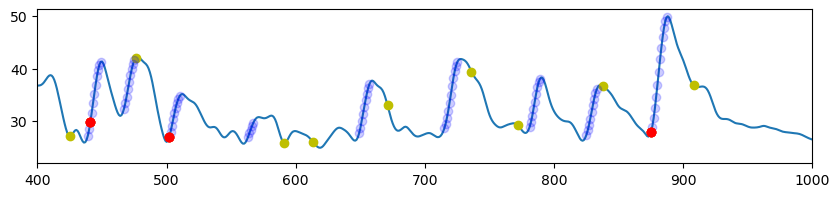

(6, 3)
(6, 3, [495, 770, 923, 994, 1021, 1041])
(6, 3, [])


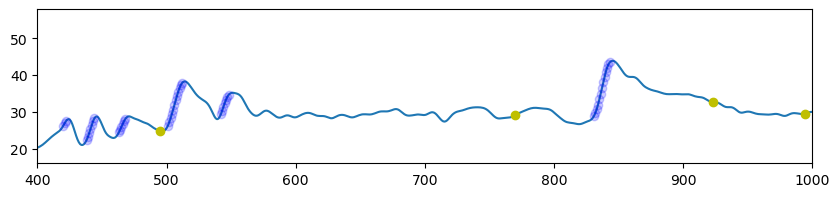

(6, 4)
(6, 4, [445, 465, 501, 542, 571, 636, 931, 973, 1002])
 shifting peakusing peak finding to :  442
 shifting peakusing peak finding to :  922
(6, 4, [442, 922])


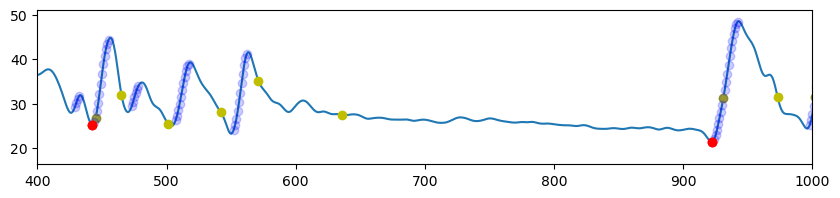

(6, 5)
(6, 5, [64, 118, 140, 463, 510, 543, 580, 597, 760, 808, 1198, 1225, 1239, 1271, 1338, 1367])
 shifting peakusing peak finding to :  460
 shifting peakusing peak finding to :  507
(6, 5, [460, 507, 808])


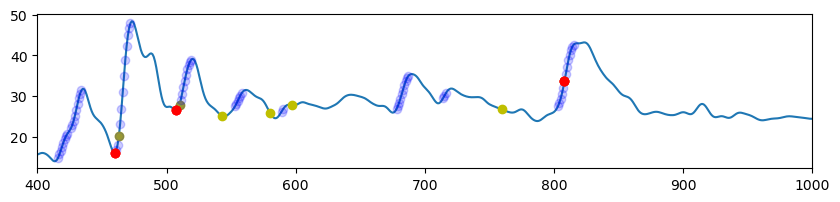

(6, 6)
(6, 6, [457, 561, 586, 610, 773, 793, 998])
 shifting peakusing peak finding to :  443
(6, 6, [443])


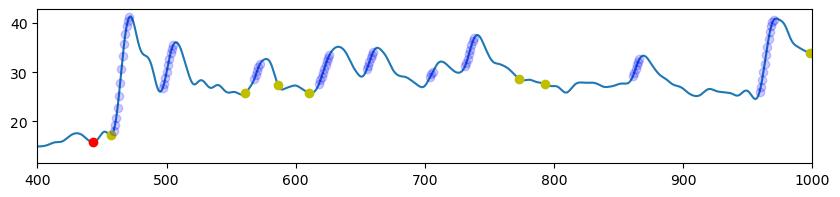

(6, 7)
(6, 7, [425, 583, 615, 637, 722, 767, 841, 946])
(6, 7, [])


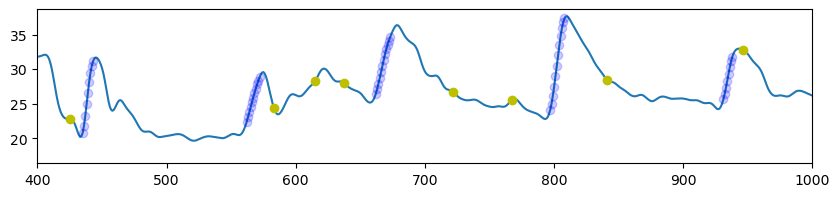

(6, 8)
(6, 8, [9])
(6, 8, [])


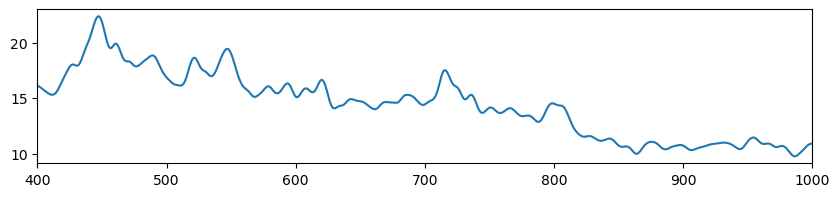

(6, 9)
(6, 9, [436, 719, 1048, 1084])
 shifting peakusing peak finding to :  710
(6, 9, [710])


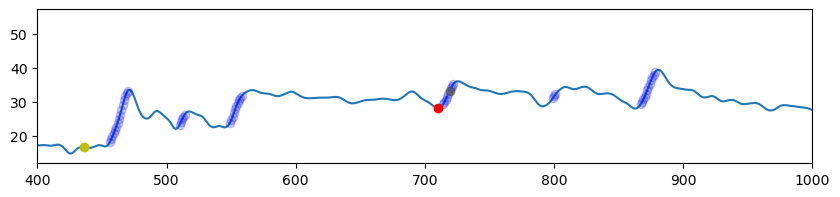

(6, 10)
(6, 10, [105, 419, 446, 521, 678, 701, 837, 1059, 1204, 1279])
more than one peak found for  (6, 10)
 shifting peakusing peak finding to :  827
(6, 10, [446, 827])


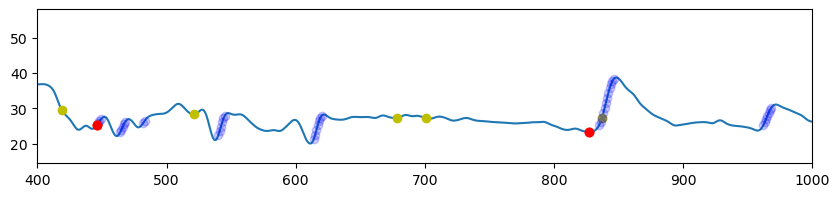

(7, 1)
(7, 1, [421])
(7, 1, [421])


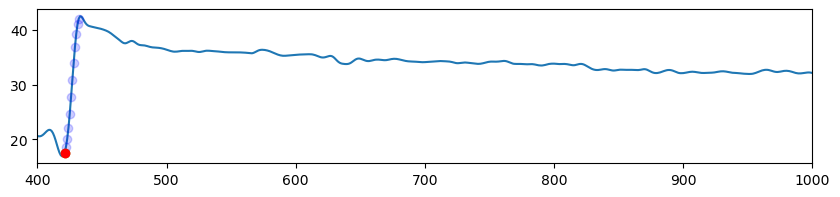

(7, 2)
no swing found


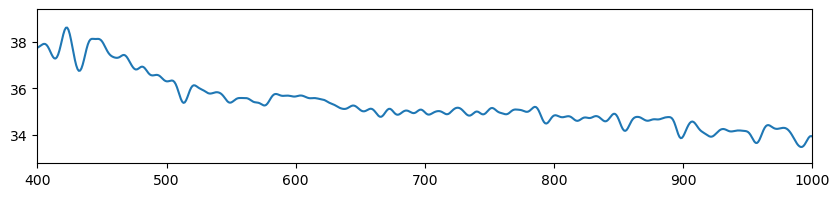

(7, 3)
(7, 3, [287, 424])
(7, 3, [424])


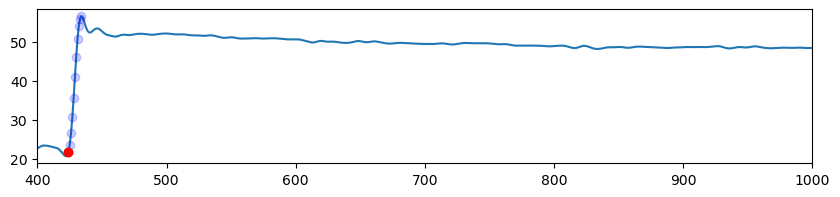

(7, 4)
no swing found


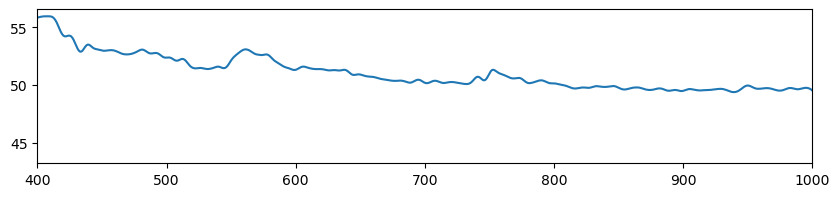

(7, 5)
(7, 5, [617])
(7, 5, [617])


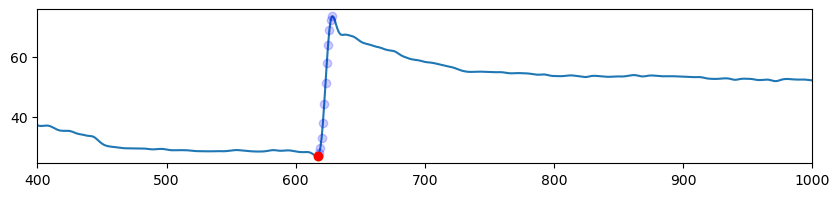

(7, 6)
no swing found


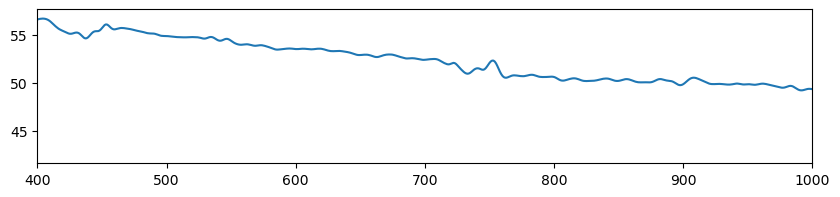

(7, 7)
(7, 7, [546])
(7, 7, [546])


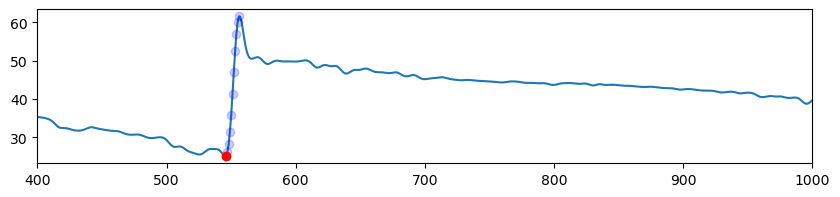

(7, 8)
no swing found


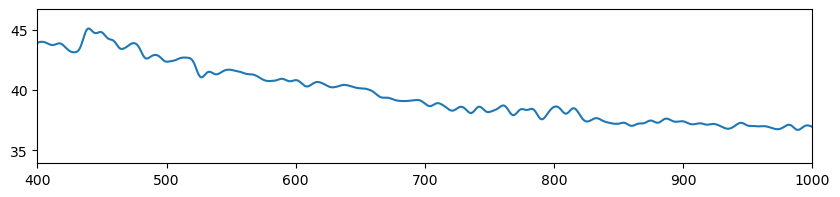

(7, 9)
(7, 9, [1254, 1353])
(7, 9, [])


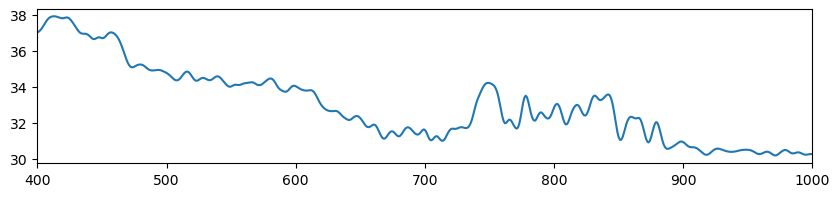

(7, 10)
(7, 10, [912, 1029, 1172, 1249, 1328])
(7, 10, [])


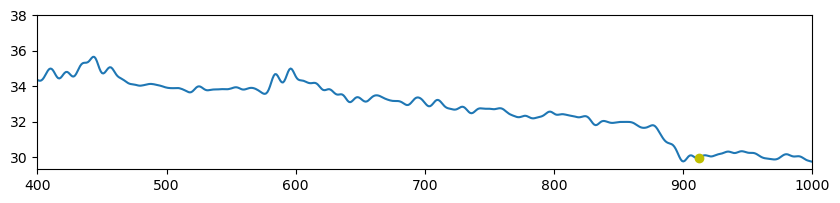

(8, 1)
(8, 1, [78, 159, 214, 368, 708, 734, 744, 790, 947, 972, 1179, 1245, 1260])
(8, 1, [])


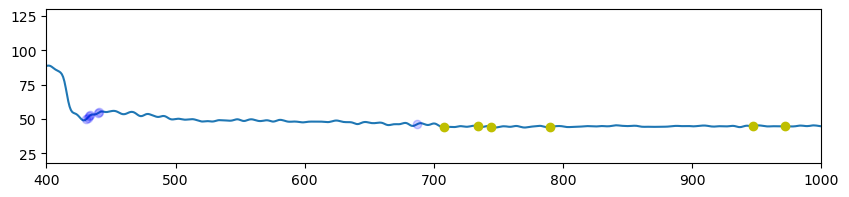

(8, 2)
(8, 2, [614, 637, 648, 689, 725, 755, 1355])
more than one peak found for  (8, 2)
(8, 2, [614])


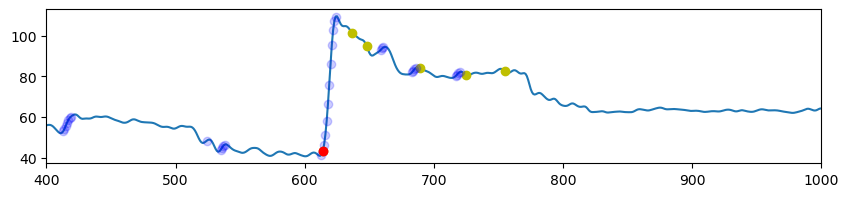

(8, 3)
(8, 3, [30, 167, 304, 401, 601])
 shifting peakusing peak finding to :  598
(8, 3, [598])


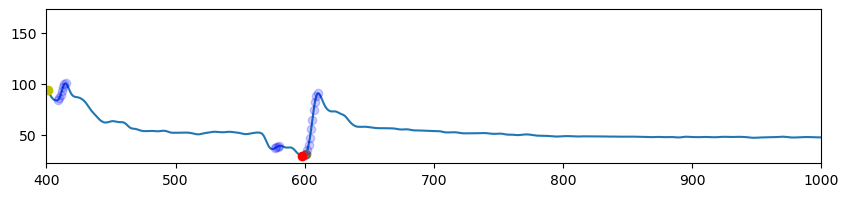

(8, 4)
(8, 4, [498, 768])
 shifting peakusing peak finding to :  488
 shifting peakusing peak finding to :  765
(8, 4, [488, 765])


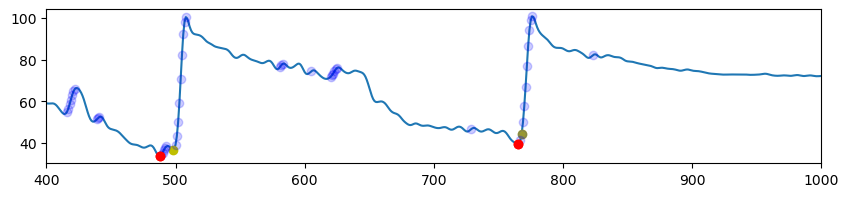

(8, 5)
no swing found


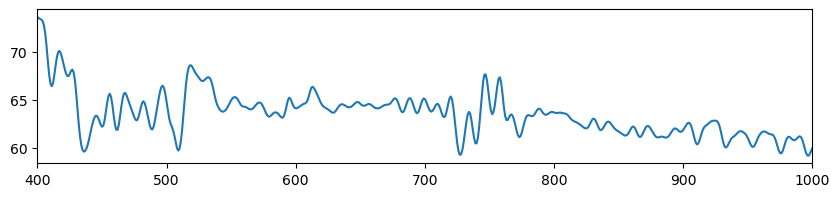

(8, 6)
(8, 6, [990, 1154, 1185, 1214, 1231, 1286])
(8, 6, [])


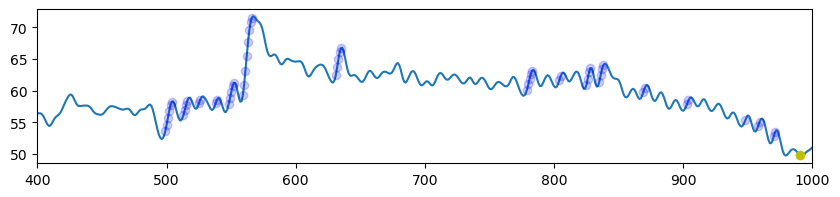

(8, 7)
(8, 7, [518, 630, 925])
(8, 7, [630, 925])


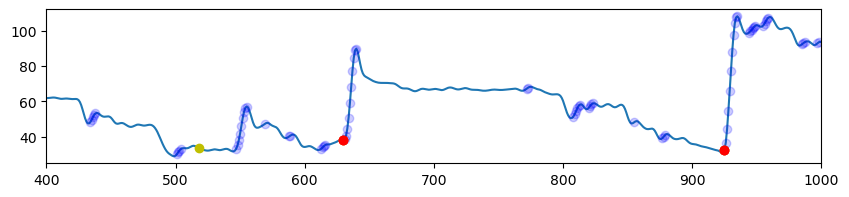

(8, 8)
(8, 8, [479])
(8, 8, [479])


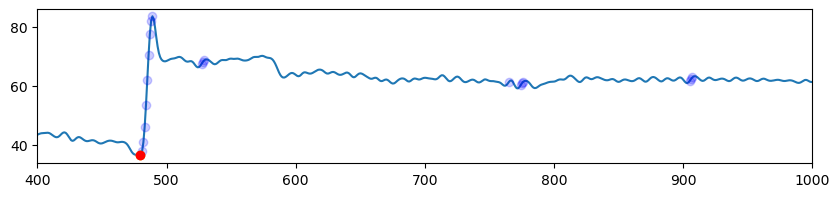

(8, 9)
(8, 9, [459, 494])
 shifting peakusing peak finding to :  489
(8, 9, [489])


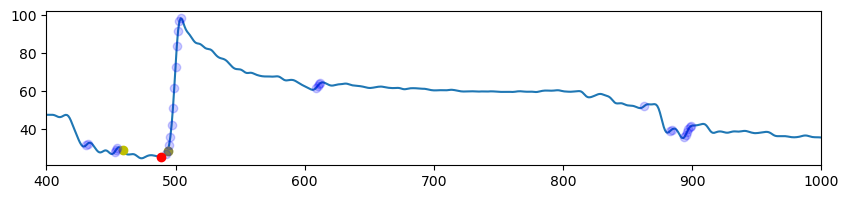

(8, 10)
(8, 10, [549, 766])
more than one peak found for  (8, 10)
 shifting peakusing peak finding to :  754
(8, 10, [549, 754])


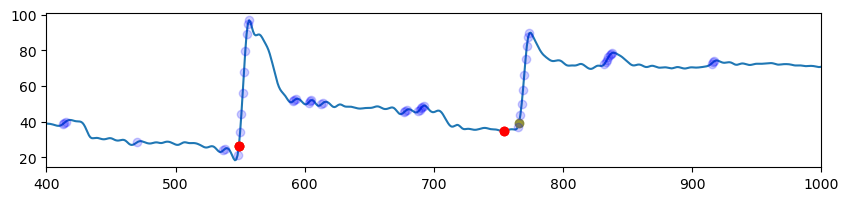

(2, 1)
(2, 1, [75, 270, 545, 1179])
(2, 1, [])


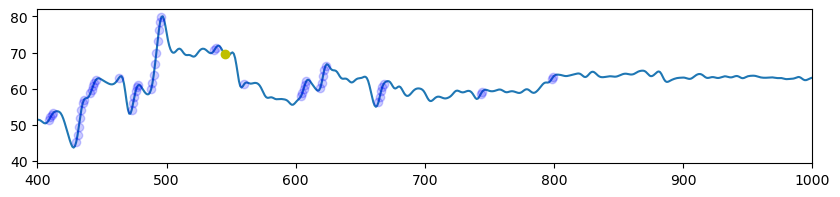

(2, 2)
(2, 2, [418, 1073])
 shifting peakusing peak finding to :  415
(2, 2, [415])


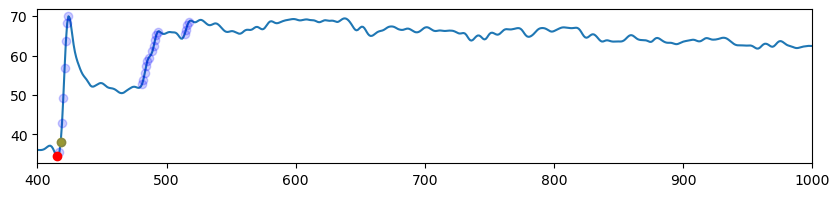

(2, 3)
(2, 3, [277, 312])
(2, 3, [])


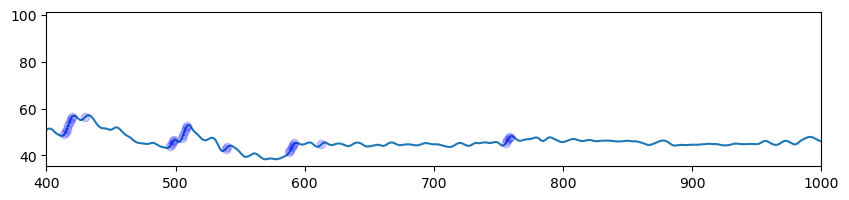

(2, 4)
no swing found


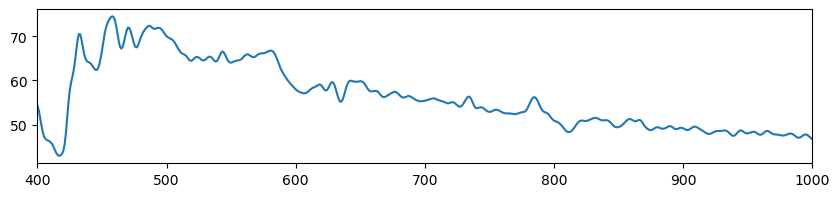

(2, 5)
(2, 5, [430, 445, 482])
 shifting peakusing peak finding to :  414
 shifting peakusing peak finding to :  429
(2, 5, [414, 429, 482])


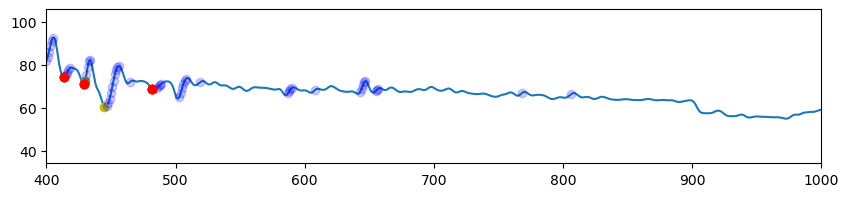

(2, 6)
(2, 6, [26, 137, 429, 449, 543])
(2, 6, [429, 449, 543])


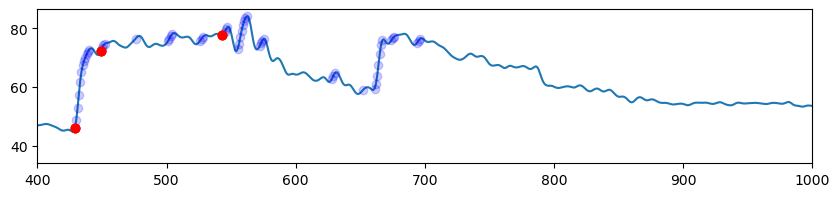

(2, 7)
(2, 7, [433, 651])
 shifting peakusing peak finding to :  417
(2, 7, [417])


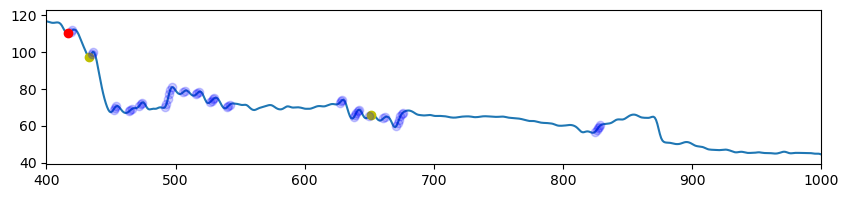

(2, 8)
(2, 8, [284, 440, 889, 917])
more than one peak found for  (2, 8)
(2, 8, [440])


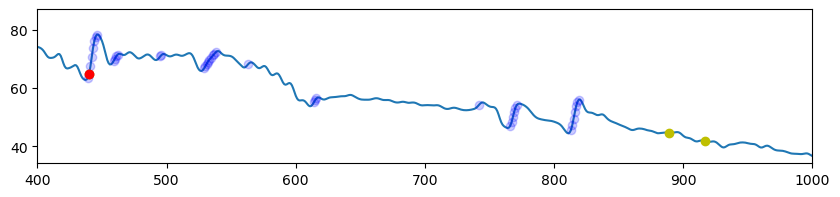

(2, 9)
(2, 9, [427, 439, 478, 514, 533, 566, 819])
 shifting peakusing peak finding to :  412
 shifting peakusing peak finding to :  428
 shifting peakusing peak finding to :  464
more than one peak found for  (2, 9)
more than one peak found for  (2, 9)
 shifting peakusing peak finding to :  813
(2, 9, [412, 428, 464, 514, 566, 813])


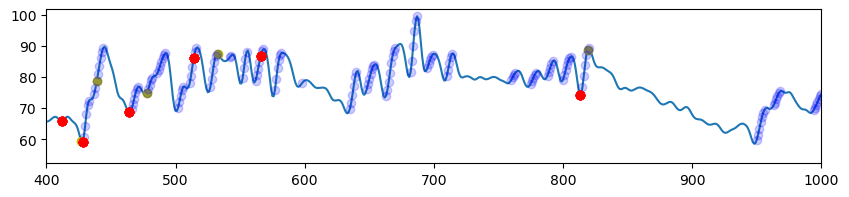

(2, 10)
no swing found


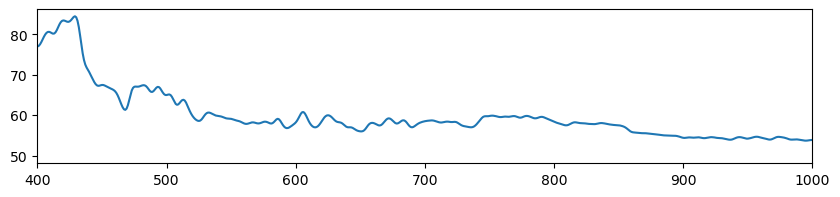

(3, 1)
(3, 1, [426, 457, 524])
(3, 1, [])


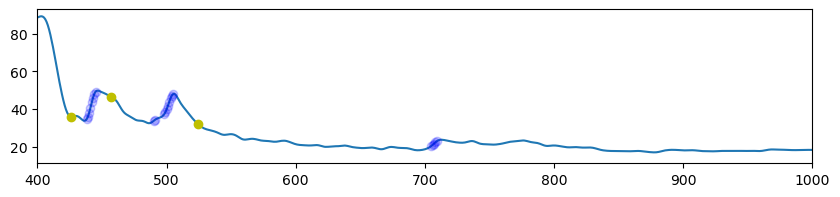

(3, 2)
(3, 2, [339])
(3, 2, [])


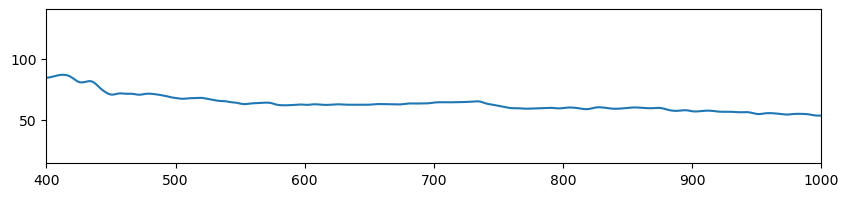

(3, 3)
no swing found


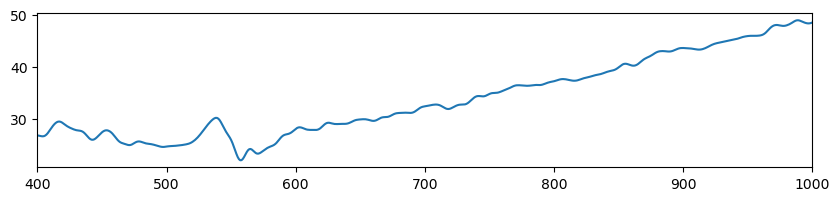

(3, 4)
no swing found


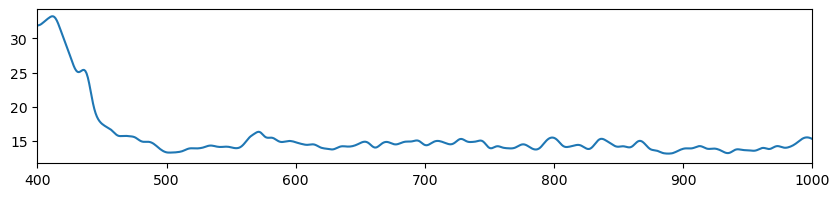

(3, 5)
no swing found


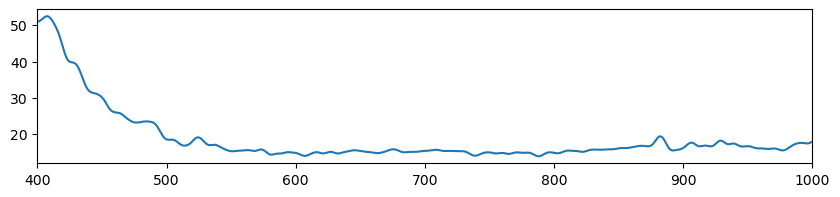

(3, 6)
no swing found


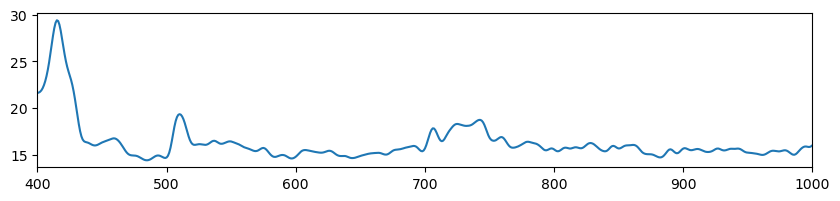

(3, 7)
(3, 7, [420, 442, 504, 560, 570, 1017])
 shifting peakusing peak finding to :  550
(3, 7, [550])


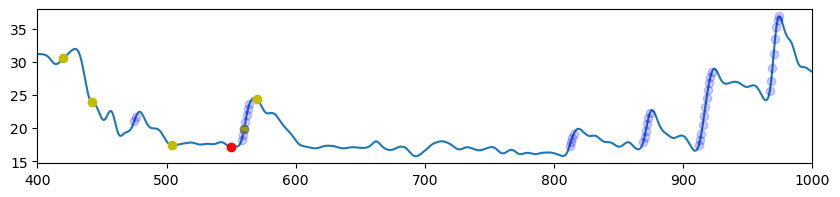

(3, 8)
(3, 8, [362, 393, 462])
(3, 8, [])


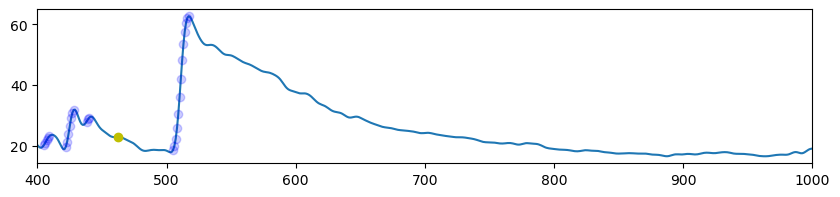

(3, 9)
(3, 9, [167, 204])
(3, 9, [])


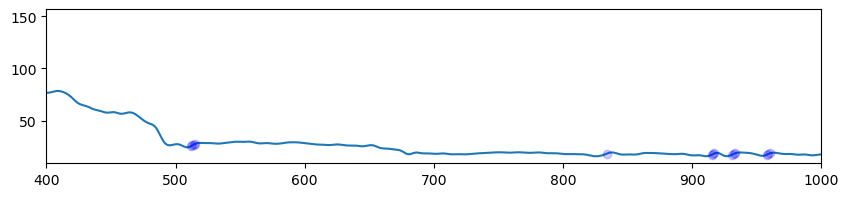

(3, 10)
(3, 10, [1019])
(3, 10, [])


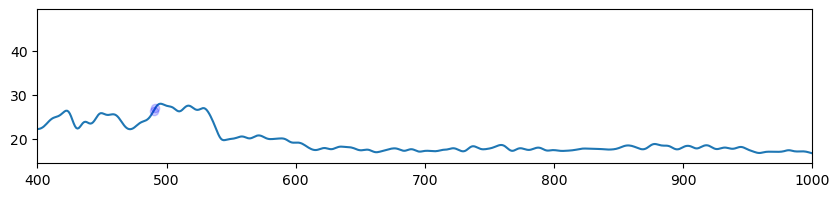

(5, 1)
(5, 1, [82, 417, 615, 703, 788, 828, 892, 1399])
 shifting peakusing peak finding to :  408
 shifting peakusing peak finding to :  819
(5, 1, [408, 819])


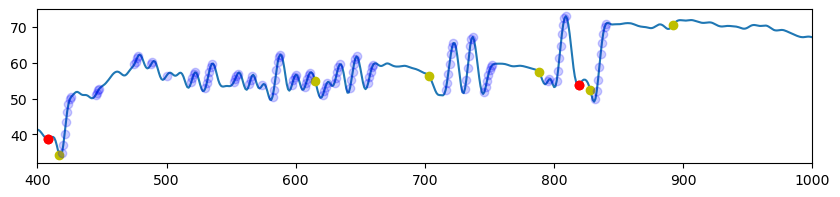

(5, 2)
(5, 2, [277, 420, 729, 768, 787, 821, 835, 850, 878, 900, 917, 956, 986, 1000, 1206, 1391])
 shifting peakusing peak finding to :  826
 shifting peakusing peak finding to :  881
 shifting peakusing peak finding to :  974
 shifting peakusing peak finding to :  987
(5, 2, [420, 729, 787, 826, 881, 974, 987])


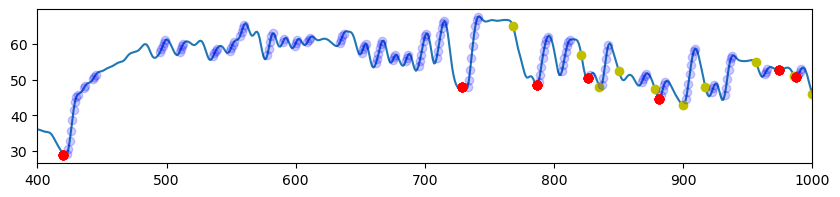

(5, 3)
(5, 3, [428, 593, 722, 736, 775, 787, 804, 885, 904, 953])
 shifting peakusing peak finding to :  727
 shifting peakusing peak finding to :  780
 shifting peakusing peak finding to :  878
(5, 3, [727, 780, 804, 878, 953])


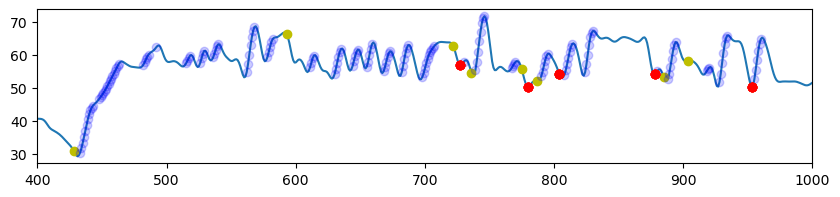

(5, 4)
(5, 4, [418, 432, 608, 639, 674, 687, 707, 841, 886, 921, 935, 1001, 1053, 1114, 1130])
 shifting peakusing peak finding to :  417
 shifting peakusing peak finding to :  661
 shifting peakusing peak finding to :  676
(5, 4, [418, 417, 661, 676, 841, 935])


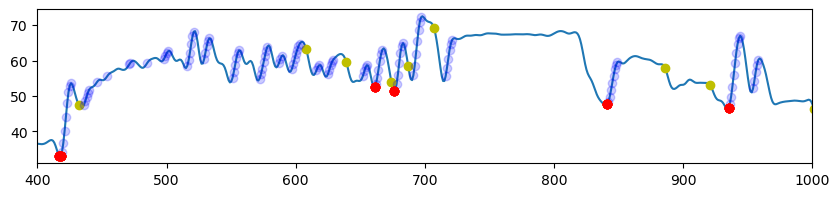

(5, 5)
(5, 5, [428, 675, 721, 736, 762, 779, 814, 865, 878, 905, 933, 988])
 shifting peakusing peak finding to :  728
 shifting peakusing peak finding to :  749
 shifting peakusing peak finding to :  763
 shifting peakusing peak finding to :  868
(5, 5, [728, 749, 763, 868, 988])


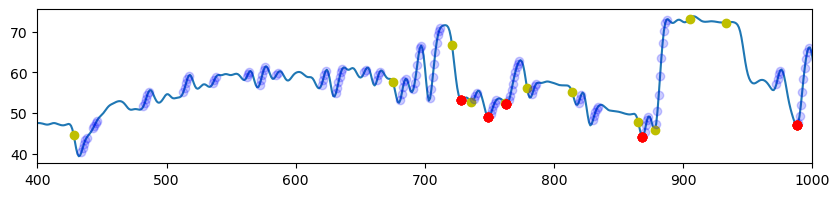

(5, 6)
(5, 6, [420, 649, 669, 686, 698, 815, 886, 906])
(5, 6, [420, 886, 906])


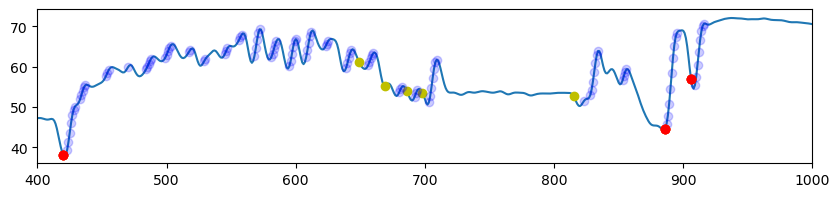

(5, 7)
(5, 7, [420, 641, 661, 692, 744, 758, 773, 824, 910, 968, 1191])
 shifting peakusing peak finding to :  953
(5, 7, [420, 758, 953])


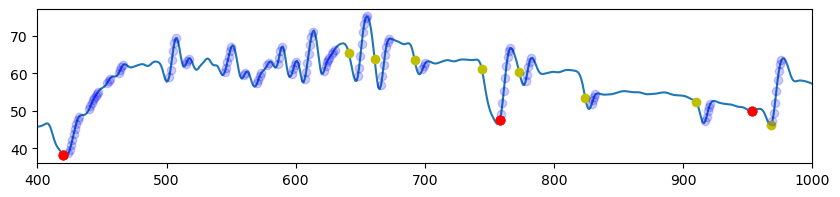

(5, 8)
(5, 8, [418, 619, 662, 786, 851, 918, 947, 961, 1002])
 shifting peakusing peak finding to :  908
(5, 8, [418, 908, 961])


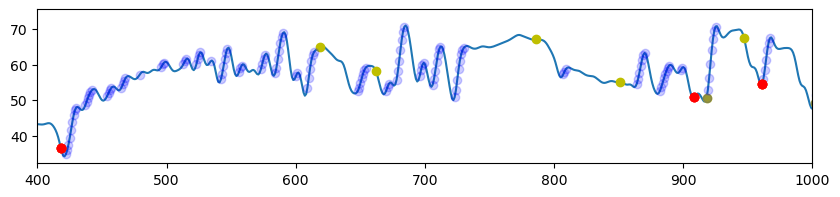

(5, 9)
(5, 9, [428, 535, 796, 851, 873, 899, 912, 946, 965, 994, 1012])
 shifting peakusing peak finding to :  522
 shifting peakusing peak finding to :  860
(5, 9, [522, 860, 912, 946, 965, 994])


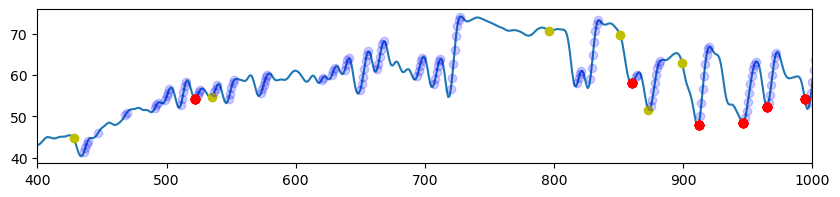

(5, 10)
(5, 10, [415, 678, 692, 849, 923, 949, 1017])
(5, 10, [415, 923, 949])


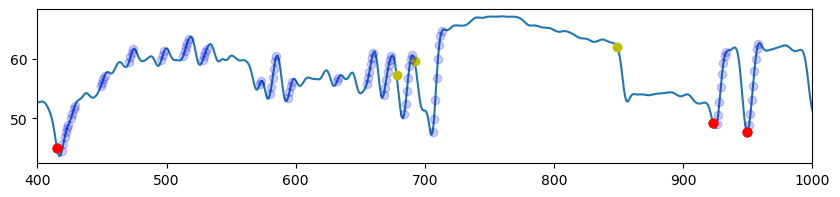

(6, 1)
(6, 1, [433])
 shifting peakusing peak finding to :  427
(6, 1, [427])


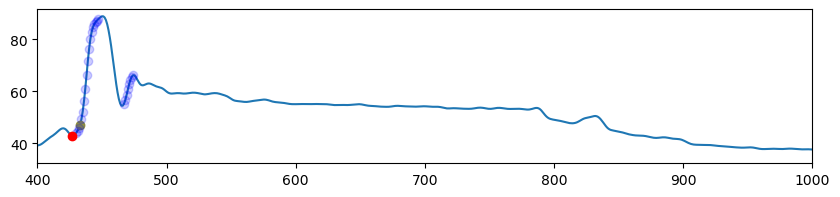

(6, 2)
(6, 2, [457, 495, 522, 552, 581])
 shifting peakusing peak finding to :  578
(6, 2, [457, 495, 578])


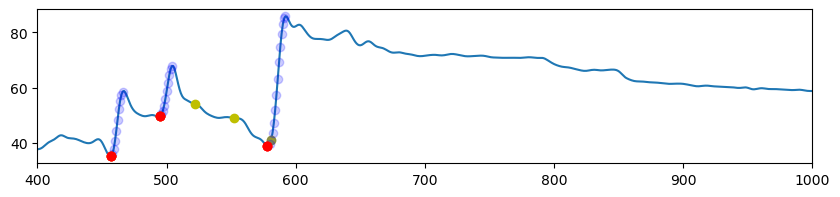

(6, 3)
no swing found


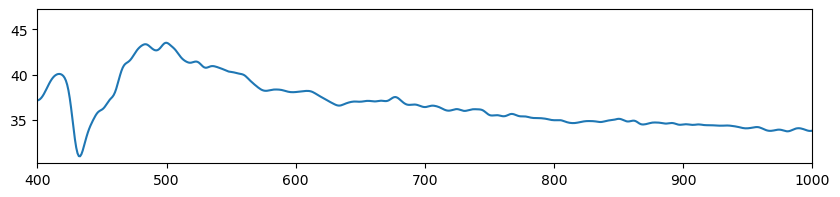

(6, 4)
(6, 4, [986])
(6, 4, [986])


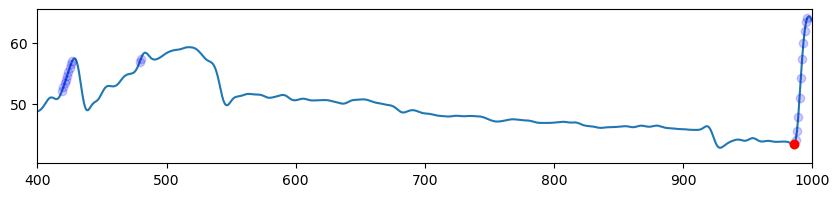

(6, 5)
no swing found


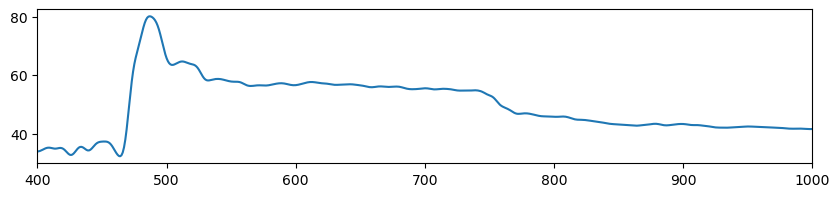

(6, 6)
(6, 6, [414, 581, 640])
 shifting peakusing peak finding to :  411
 shifting peakusing peak finding to :  577
(6, 6, [411, 577])


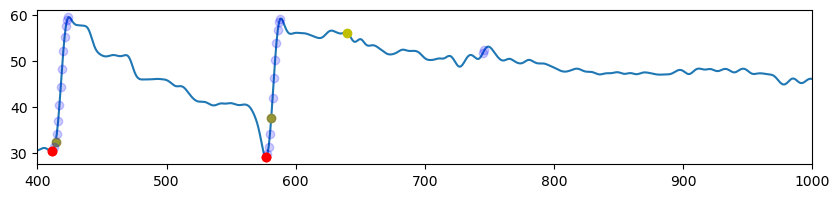

(6, 7)
(6, 7, [437])
 shifting peakusing peak finding to :  434
(6, 7, [434])


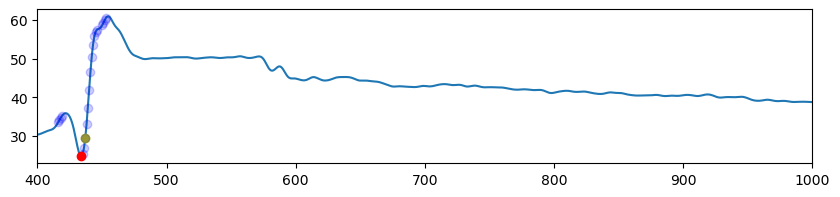

(6, 8)
(6, 8, [34])
(6, 8, [])


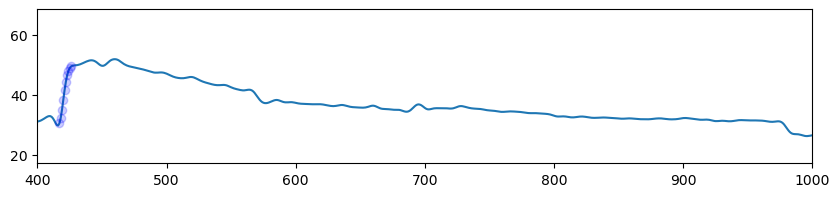

(6, 9)
no swing found


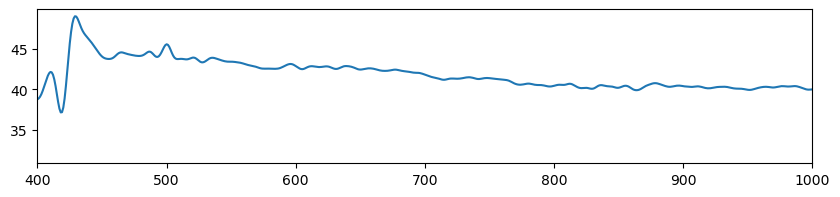

(6, 10)
(6, 10, [421, 941])
 shifting peakusing peak finding to :  418
(6, 10, [418])


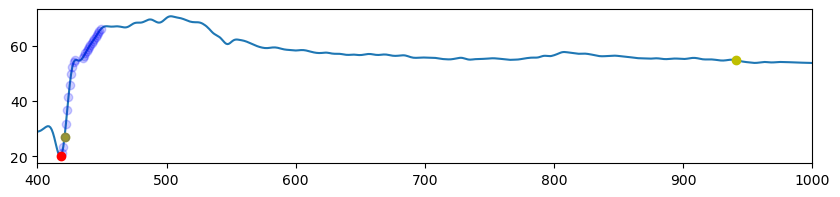

(7, 1)
(7, 1, [25, 421])
(7, 1, [421])


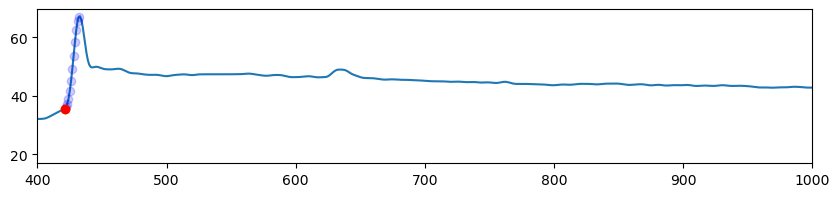

(7, 2)
(7, 2, [434])
 shifting peakusing peak finding to :  430
(7, 2, [430])


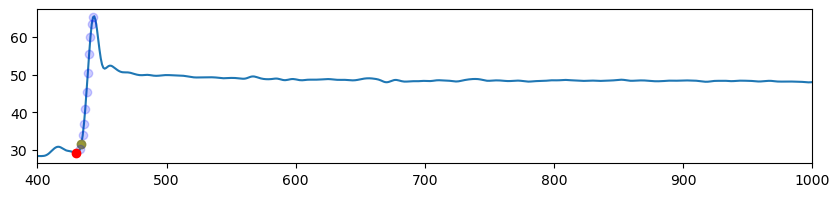

(7, 3)
(7, 3, [439, 600, 747])
 shifting peakusing peak finding to :  592
(7, 3, [439, 592])


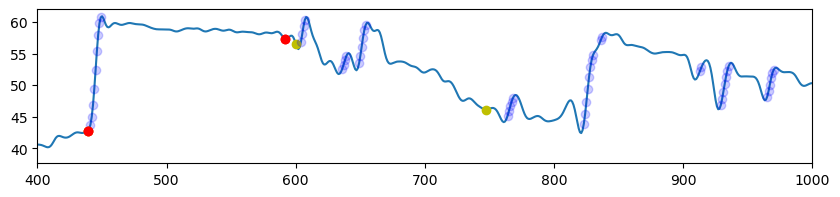

(7, 4)
(7, 4, [433])
(7, 4, [433])


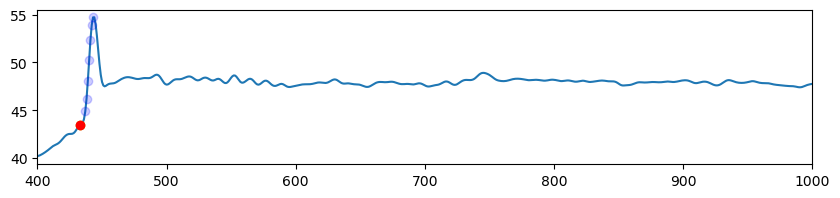

(7, 5)
(7, 5, [663])
(7, 5, [663])


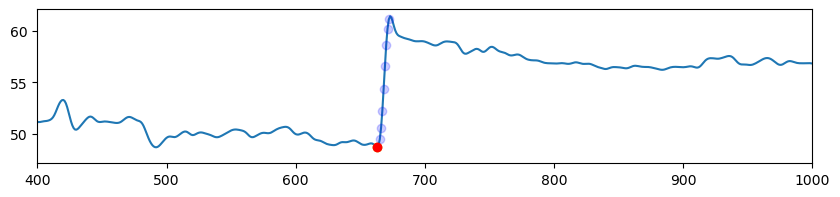

(7, 6)
(7, 6, [426])
(7, 6, [426])


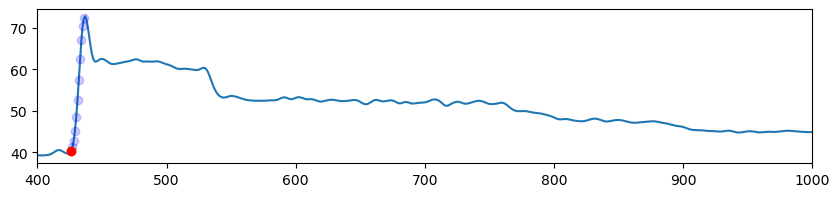

(7, 7)
(7, 7, [548])
(7, 7, [548])


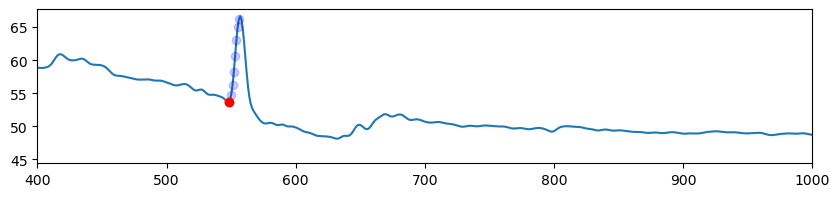

(7, 8)
(7, 8, [476])
 shifting peakusing peak finding to :  469
(7, 8, [469])


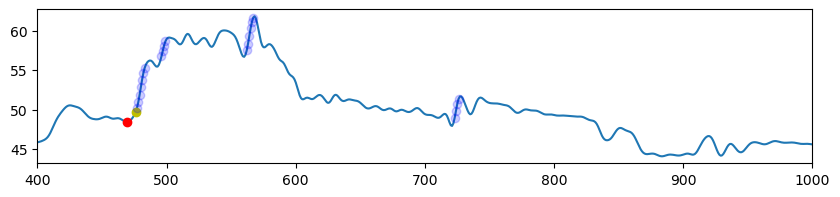

(7, 9)
(7, 9, [564, 673, 705])
 shifting peakusing peak finding to :  689
(7, 9, [564, 673, 689])


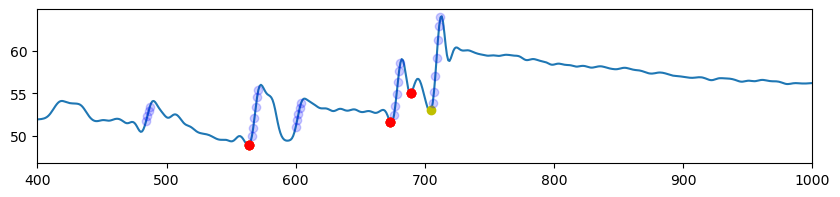

(7, 10)
(7, 10, [582])
(7, 10, [582])


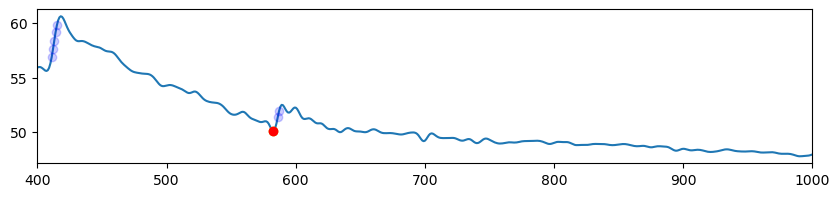

(8, 1)
(8, 1, [113, 445])
 shifting peakusing peak finding to :  441
(8, 1, [441])


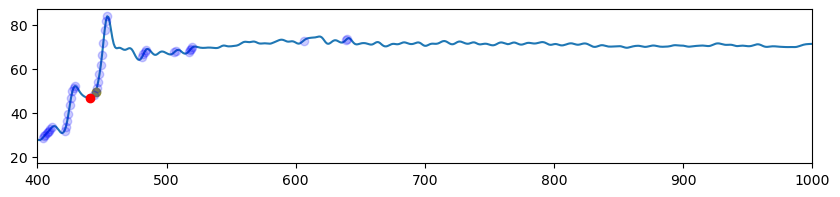

(8, 2)
(8, 2, [437])
 shifting peakusing peak finding to :  425
(8, 2, [425])


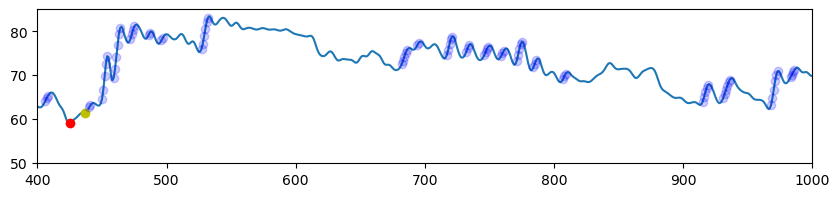

(8, 3)
(8, 3, [498, 514, 531, 563])
(8, 3, [])


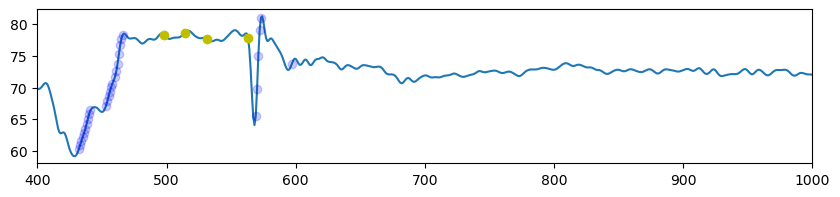

(8, 4)
(8, 4, [582, 594, 616])
 shifting peakusing peak finding to :  606
(8, 4, [606])


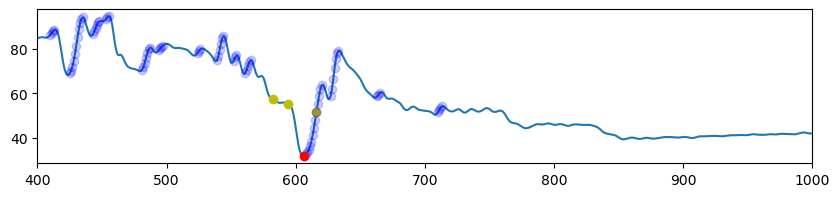

(8, 5)
(8, 5, [433, 460, 472, 585, 721])
 shifting peakusing peak finding to :  423
more than one peak found for  (8, 5)
 shifting peakusing peak finding to :  576
(8, 5, [423, 472, 576])


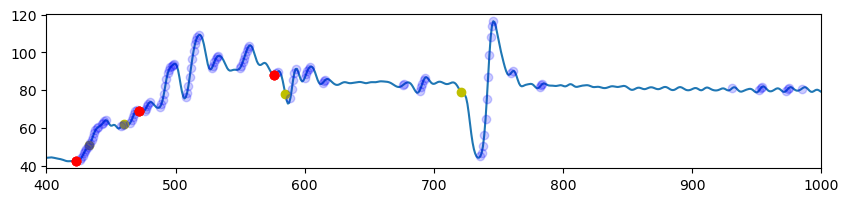

(8, 6)
(8, 6, [492, 529, 619, 742, 764, 829, 914, 957, 1329])
 shifting peakusing peak finding to :  513
more than one peak found for  (8, 6)
(8, 6, [513, 829])


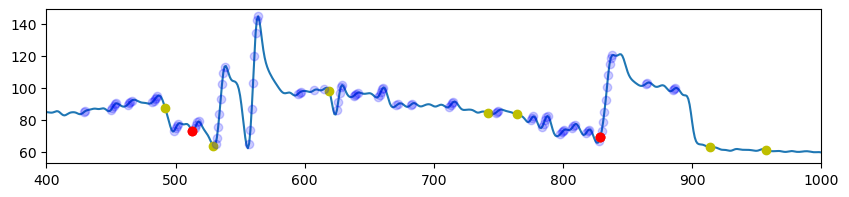

(8, 7)
(8, 7, [492, 527, 568, 788])
(8, 7, [])


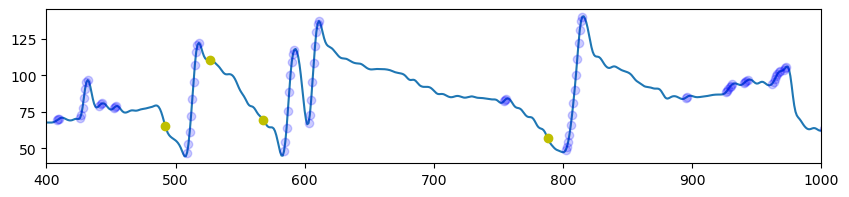

(8, 8)
(8, 8, [13, 410, 424, 459, 529, 548, 567, 581])
 shifting peakusing peak finding to :  520
(8, 8, [520])


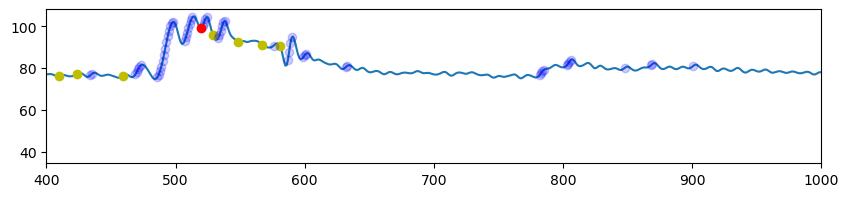

(8, 9)
(8, 9, [443, 497])
(8, 9, [497])


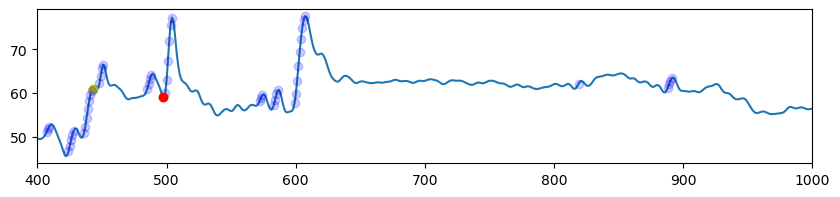

(8, 10)
(8, 10, [668])
(8, 10, [668])


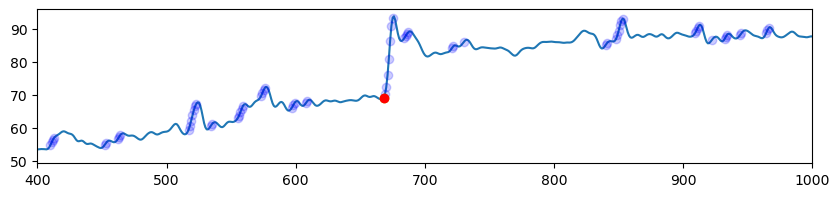

In [ ]:
reset_ang_MDN_Stop1_R2, swing_count_MDN_Stop1_R2, swing_ts_MDN_Stop1_R2 = get_reset_ang_Mleg(MDN_Stop1, 'R2')
reset_ang_MDN_Stop1_L2, swing_count_MDN_Stop1_L2, swing_ts_MDN_Stop1_L2 = get_reset_ang_Mleg(MDN_Stop1, 'L2')

<AxesSubplot:>

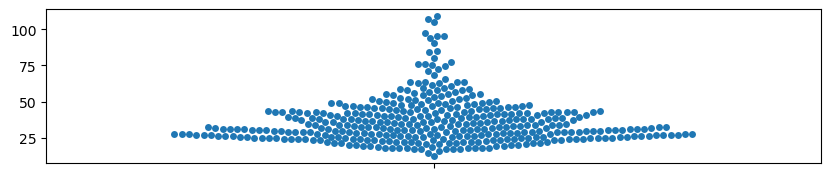

In [ ]:
sns.swarmplot(reset_ang_MDN_R2 + reset_ang_MDN_L2)

In [ ]:
np.percentile(np.array(reset_ang_MDN_L2 + reset_ang_MDN_R2), [90, 95,75, 50])

array([55.44277142, 65.15159133, 43.28019696, 33.02119328])

<AxesSubplot:>

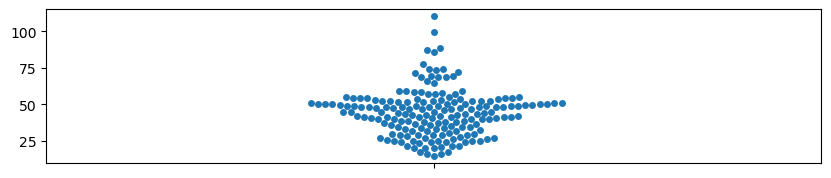

In [ ]:
sns.swarmplot(reset_ang_MDN_Stop1_R2 + reset_ang_MDN_Stop1_L2)

In [ ]:
np.percentile(np.array(reset_ang_MDN_Stop1_R2 + reset_ang_MDN_Stop1_L2), [90, 95])

array([60.80725385, 72.50594467])

c:\Users\SthanuKumarD\Anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 11.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


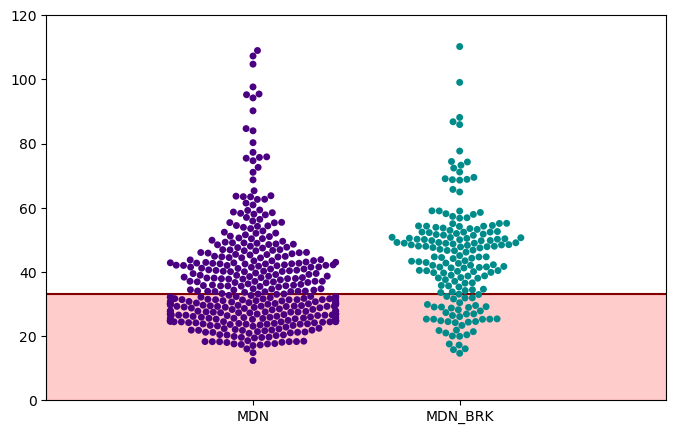

In [ ]:
plt.rcParams['figure.figsize'] = (8,5)
swing_init_ang = pd.concat([pd.DataFrame([(reset_ang_MDN_L2 + reset_ang_MDN_R2)]).T , pd.DataFrame([(reset_ang_MDN_Stop1_L2 + reset_ang_MDN_Stop1_R2)]).T], axis = 1)
swing_init_ang.columns = ['MDN', 'MDN_BRK']
sns.swarmplot(swing_init_ang, palette=  ['indigo', 'darkcyan'])
plt.axhline (y = 33, color = 'maroon')
plt.xlim(-1,  2)
plt.ylim(0, 120)
plt.fill_between( [-1,  2], y1 = 0, y2 = 33, color = 'r',alpha = 0.2)
# plt.savefig(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Mid\swing_init_ang.svg', dpi = 300)

# swing_init_ang.to_csv(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Mid\swing_init_ang.csv', index = False)

In [ ]:
def get_stepping_params_Mleg (df,leg , angle, leg_swing_ts):
    
    range_lim = 33

    if leg == 'L2':
        sc = 'L-M_stepcycle'

    if leg == 'R2':
        sc = 'R-M_stepcycle'
    
    count_SIZ_reached = [] # per trial
    swing_events_within_SIZ = [] # per trial
    percentage_swings_per_trial = []  # per trial
    dwell_time = [] # per SIZ event
    sd_in_SIZ = []
    sd_whole_lightON = []

    for n in df['flynum'].unique().tolist():
        for t in df.groupby('flynum').get_group(n)['tnum'].unique().tolist():
            swing_events_temp = []
            
            data = df.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)
            ang = data[angle]

            sd = np.std(ang[400:1000])
            sd_whole_lightON.append(sd)
            
            # print((n,t))
            # plt.plot(ang)

            # ang = pd.DataFrame(scipy.signal.cspline1d(ang,lamb=0.2 ))
            ang = pd.DataFrame(scipy.ndimage.gaussian_filter(ang, sigma= 5))
            ang.columns = [angle]
            slope = np.gradient(ang[angle]).tolist()
            
            # plt.plot (ang)
            # plt.axhline(y = range_lim, color = 'grey' )

            try:
                sc_df_temp = leg_swing_ts.groupby('flynum').get_group(n).groupby('tnum').get_group(t).reset_index(drop=True)
                swing_ts = sc_df_temp['swing_ts'].tolist()
            except:
                ## no swings in the trial
                swing_ts = []

            temp_ang = pd.DataFrame(ang[430:1000])
            list_in_range = temp_ang.loc[(temp_ang[angle] <range_lim)].index.tolist() #time index when leg is in SIZ

            if len(list_in_range) > 0: 
                ## if the leg ever enters the SIZ
                break_pt = np.split(list_in_range, np.where(np.diff(list_in_range)>10)[0]+1) #breaking time indices into events---> number of times when the ang is reached

                print('Filtering last event:',break_pt[-1][-1], len(break_pt[-1])  )
                if (break_pt[-1][-1] == 999 and len(break_pt[-1])<20):
                    print('removing last event of length', len(break_pt[-1]))
                    break_pt = break_pt[:-1]
                else:
                    print('valid end point')
                    
                break_pt_filt = []
                for event in break_pt:
                    if len(event) < 10:
                        continue
                    else:
                        break_pt_filt.append(event)

    

                
                if len(break_pt_filt)>0:

                    if slope[break_pt_filt[0][0]]>0 and break_pt_filt[0][0]<500 and len(break_pt_filt[0]) < 50:
                        print('remoning first event initiated during contraction', len(break_pt_filt[0]))
                        break_pt_filt = break_pt_filt[1:]
                    else:
                        print('valid beginning')


                
                range_count_temp = len(break_pt_filt) # number of times the SIZ was achieved in trial


                count_SIZ_reached.append(range_count_temp)
                # print((n,t,range_count_temp))
                # print(break_pt_filt[-1][-1])

                # if break_pt_filt[-1][-1] == 999:
                #     break_pt_filt = break_pt_filt[:-1]
                # else:
                #     print('valid end point')
                
                if len(break_pt_filt)>0 :
                    print((n,t))
                    plt.rcParams['figure.figsize'] = (10,2)
                    plt.plot(ang)
                    # plt.plot(ang_test)
                    plt.axhline(y = range_lim, color = 'grey' )

                    for i in break_pt_filt:
                        plt.axvline(x = i[0], color = 'g')
                        plt.axvline(x = i[-1], color = 'r')

                    temp_dwell_time = []
                    for event in break_pt_filt: # for each time the leg enters SIZ
                        
                        temp_dwell_time.append(len(event)) 

                        temp_sd = np.std(data[angle].iloc[event[0]: event[-1]])
                        sd_in_SIZ.append(temp_sd)

                        swing_count = 0
                        
                        for swing in swing_ts:
                            if swing_count == 0:
                                if swing in event or swing in [x+5 for x in event] :
                                    # if there was a swing in this stretch of time
                                    swing_events_temp.append('True')
                                    plt.axvline(x = swing, color = 'k', ls = '--')
                                    swing_count+=1

                    swing_events_within_SIZ.append(len(swing_events_temp))
                    dwell_time.append(np.mean(temp_dwell_time))
                    
                    percentage_swings_per_trial.append((len(swing_events_temp)/range_count_temp)*100)
                    # print(n,t,((len(swing_events_temp), range_count_temp, (len(swing_events_temp)/range_count_temp)*100)))
                    plt.xlim(300,1100)
                    plt.show()
                # else:
                    # plt.xlim(300,1100)
                    # plt.show()    
            else:
                count_SIZ_reached.append(len(list_in_range)) # appends zero


    return count_SIZ_reached, swing_events_within_SIZ, percentage_swings_per_trial, dwell_time, sd_whole_lightON


Filtering last event: 984 6
valid end point
valid beginning
(1, 3)


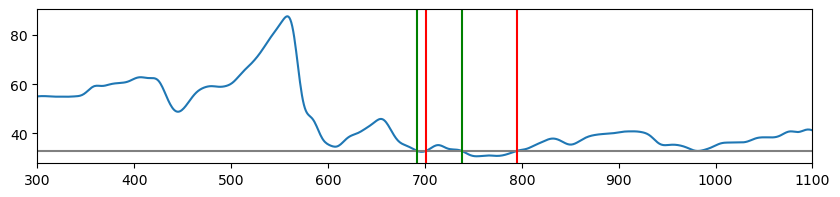

Filtering last event: 596 14
valid end point
valid beginning
(1, 4)


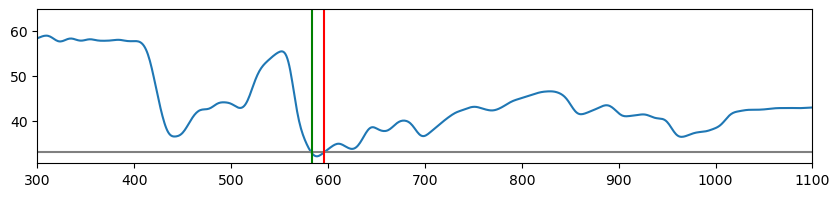

Filtering last event: 444 7
valid end point
Filtering last event: 975 14
valid end point
valid beginning
(1, 6)


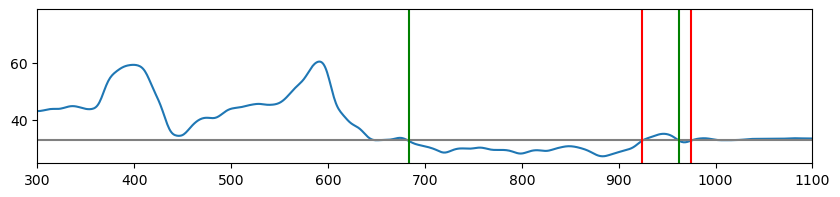

Filtering last event: 473 38
valid end point
valid beginning
(1, 7)


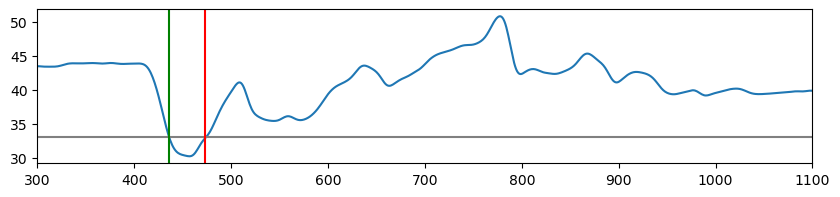

Filtering last event: 999 88
valid end point
valid beginning
(1, 9)


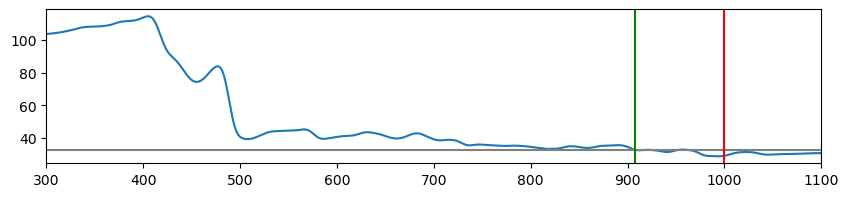

Filtering last event: 999 58
valid end point
valid beginning
(1, 10)


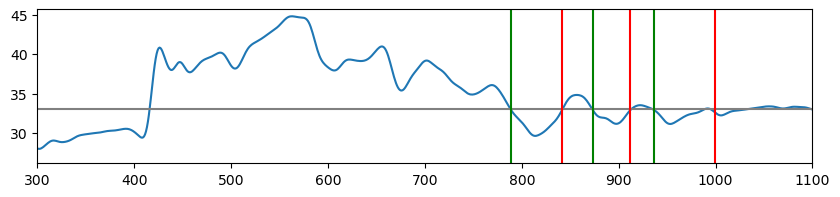

Filtering last event: 547 58
valid end point
valid beginning
(2, 1)


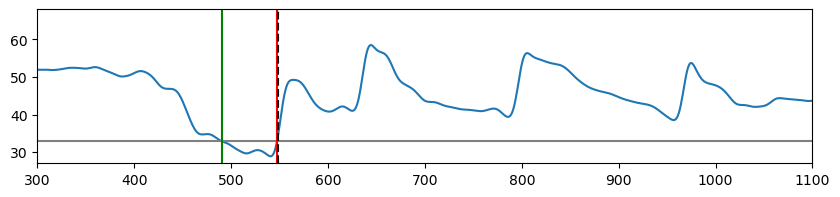

Filtering last event: 848 38
valid end point
valid beginning
(2, 5)


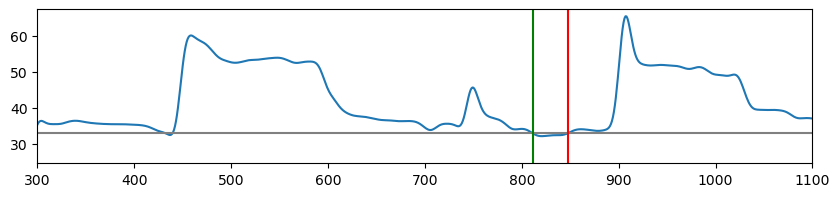

Filtering last event: 999 46
valid end point
valid beginning
(2, 6)


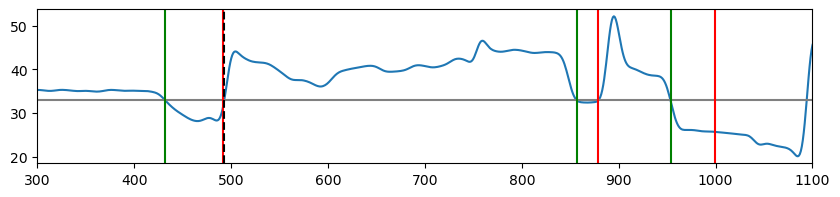

Filtering last event: 995 32
valid end point
valid beginning
(2, 7)


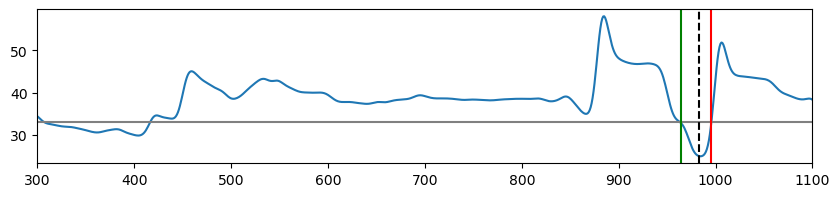

Filtering last event: 842 18
valid end point
valid beginning
(2, 8)


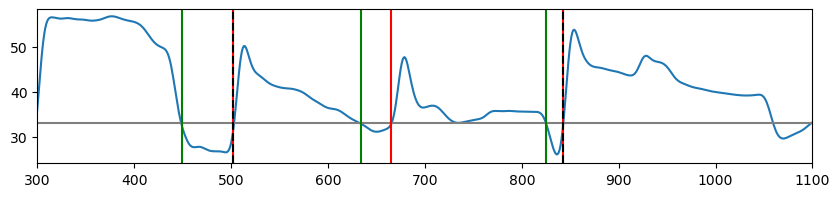

Filtering last event: 879 13
valid end point
valid beginning
(2, 9)


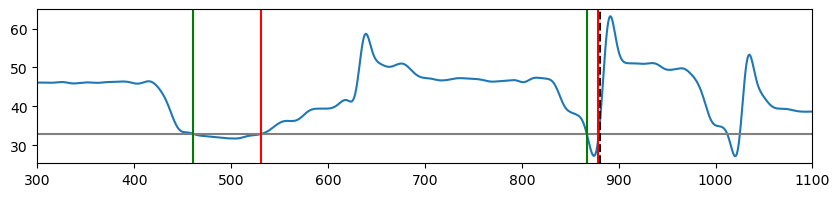

Filtering last event: 999 30
valid end point
valid beginning
(2, 10)


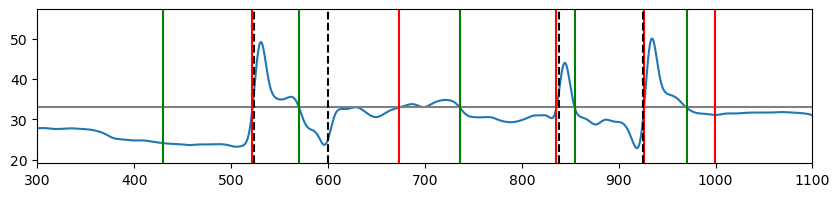

Filtering last event: 977 99
valid end point
valid beginning
(3, 1)


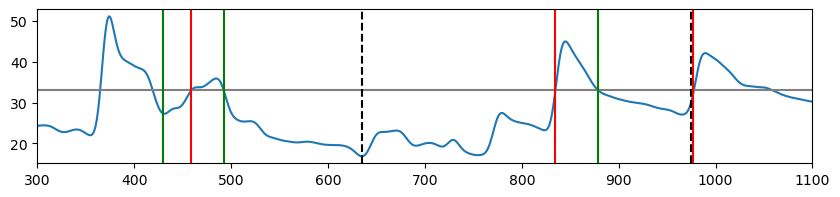

Filtering last event: 921 436
valid end point
valid beginning
(3, 2)


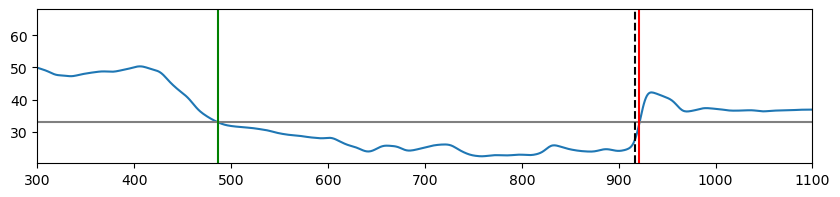

Filtering last event: 940 44
valid end point
valid beginning
(3, 3)


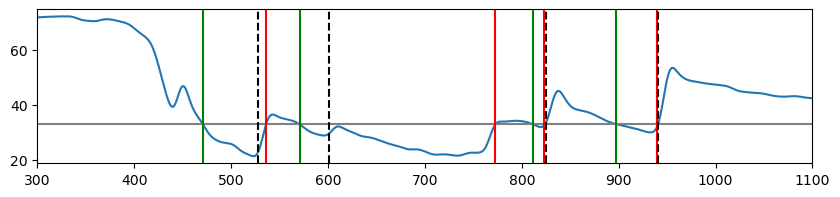

Filtering last event: 999 13
removing last event of length 13
valid beginning
(3, 4)


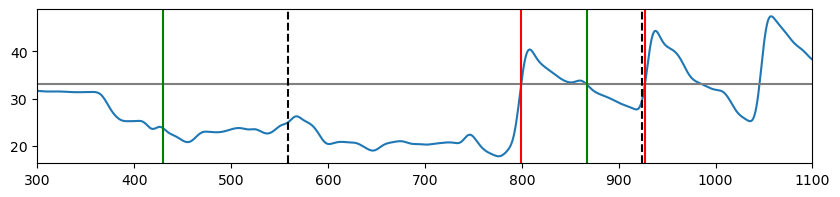

Filtering last event: 495 30
valid end point
valid beginning
(3, 5)


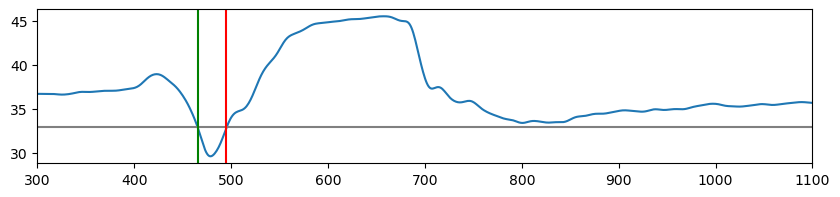

Filtering last event: 999 150
valid end point
valid beginning
(3, 6)


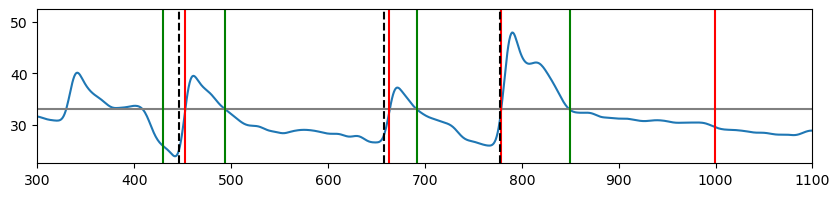

Filtering last event: 998 440
valid end point
valid beginning
(3, 7)


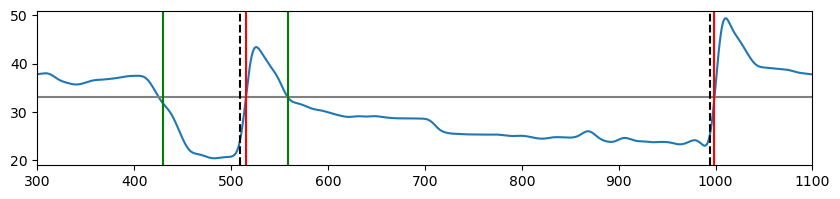

Filtering last event: 918 59
valid end point
valid beginning
(3, 8)


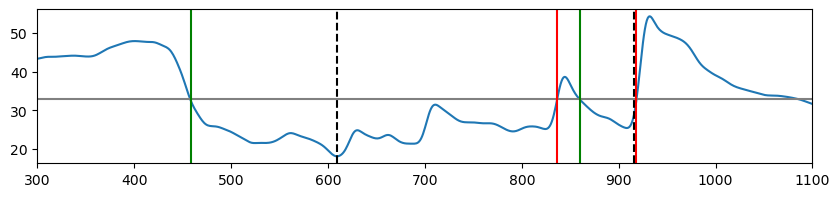

Filtering last event: 999 99
valid end point
valid beginning
(3, 9)


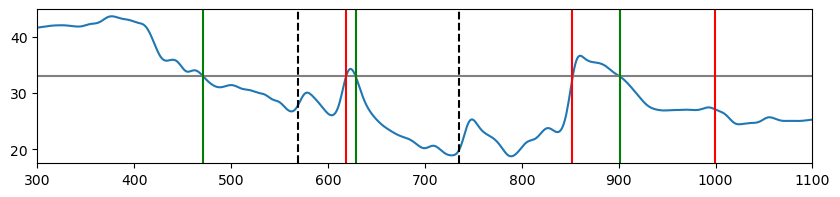

Filtering last event: 999 122
valid end point
valid beginning
(3, 10)


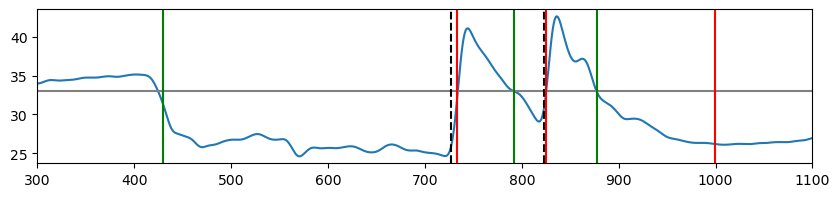

Filtering last event: 620 10
valid end point
valid beginning
(4, 1)


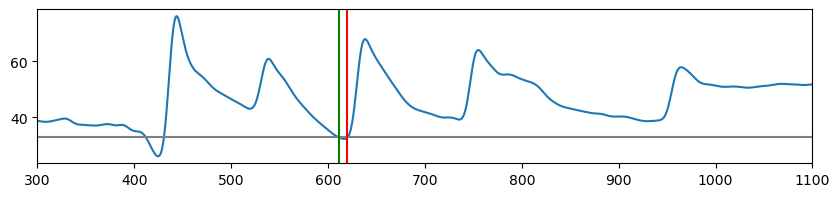

Filtering last event: 525 3
valid end point
valid beginning
(5, 2)


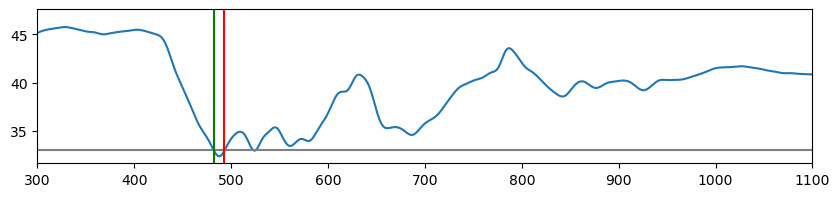

Filtering last event: 999 252
valid end point
valid beginning
(5, 4)


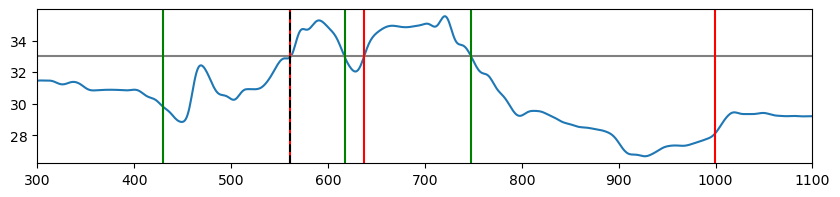

Filtering last event: 926 22
valid end point
valid beginning
(5, 5)


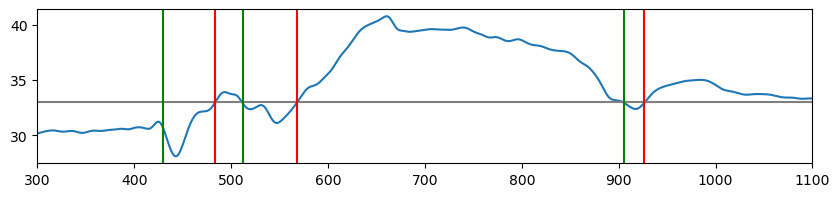

Filtering last event: 826 71
valid end point
valid beginning
(5, 6)


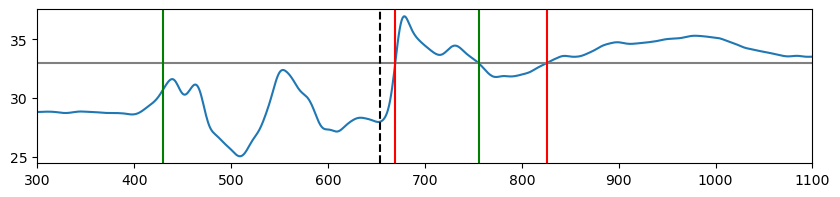

Filtering last event: 999 232
valid end point
valid beginning
(5, 7)


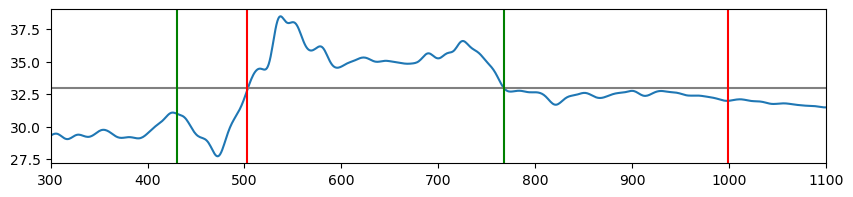

Filtering last event: 910 174
valid end point
valid beginning
(5, 8)


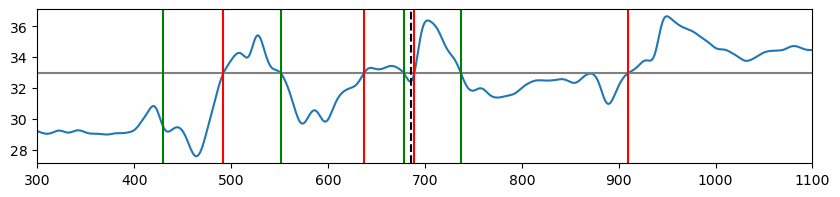

Filtering last event: 622 27
valid end point
valid beginning
(5, 10)


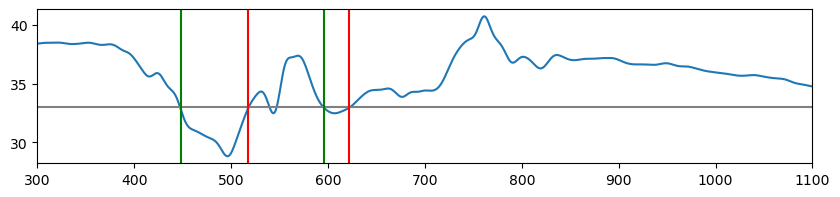

Filtering last event: 447 18
valid end point
valid beginning
(6, 1)


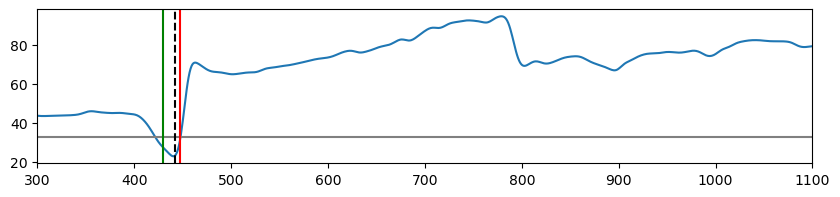

Filtering last event: 999 315
valid end point
valid beginning
(7, 1)


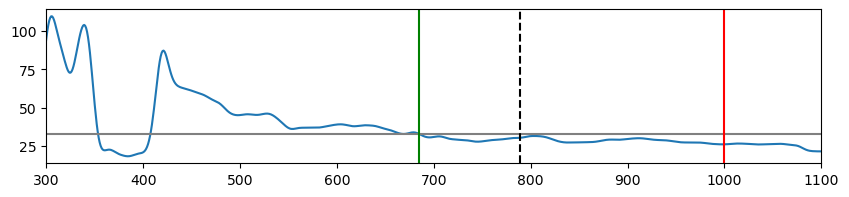

Filtering last event: 999 16
removing last event of length 16
valid beginning
(7, 2)


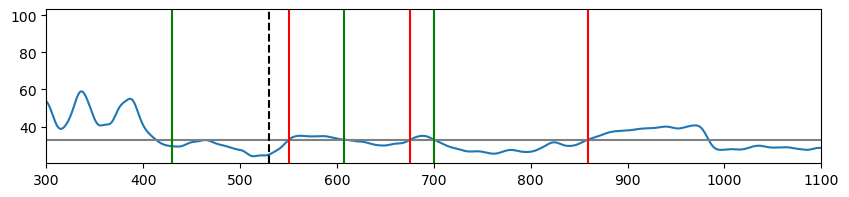

Filtering last event: 998 229
valid end point
valid beginning
(7, 3)


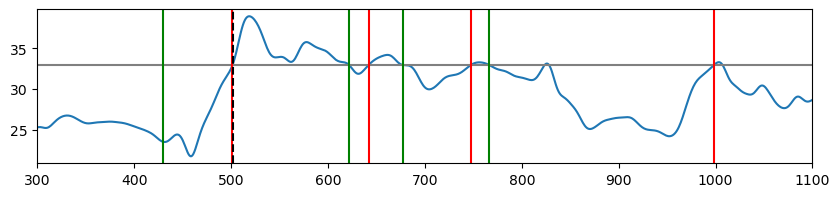

Filtering last event: 999 117
valid end point
valid beginning
(7, 4)


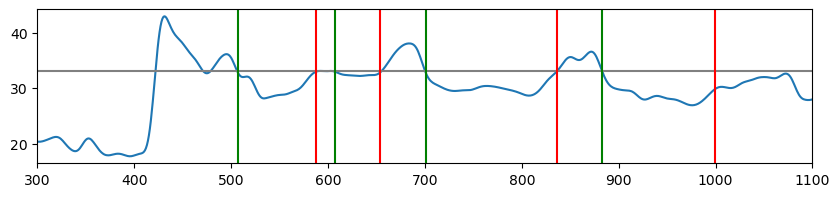

Filtering last event: 999 296
valid end point
valid beginning
(7, 5)


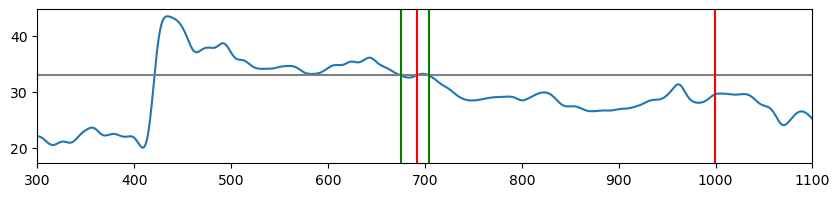

Filtering last event: 999 570
valid end point
valid beginning
(7, 6)


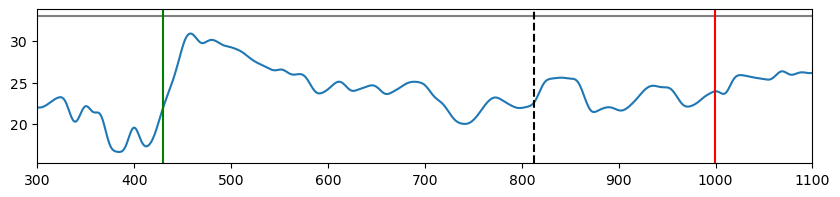

Filtering last event: 999 380
valid end point
valid beginning
(7, 7)


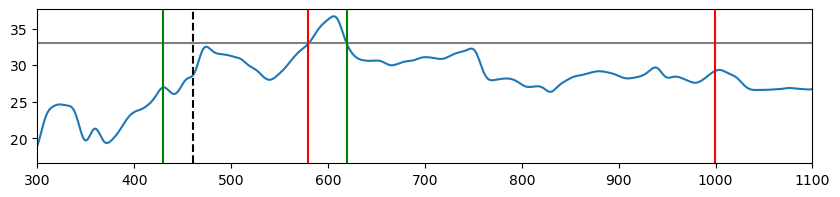

Filtering last event: 999 474
valid end point
valid beginning
(7, 8)


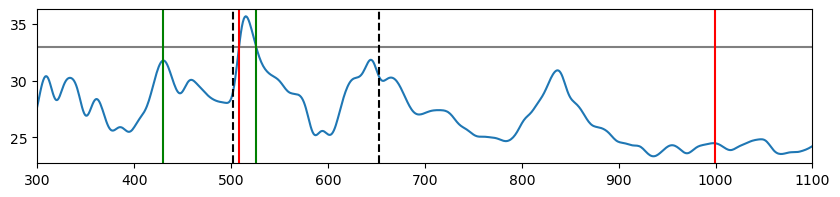

Filtering last event: 999 570
valid end point
valid beginning
(7, 9)


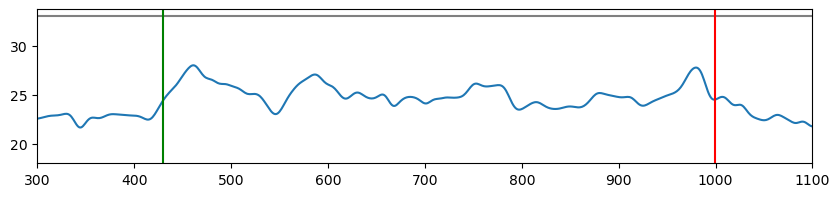

Filtering last event: 999 20
valid end point
valid beginning
(7, 10)


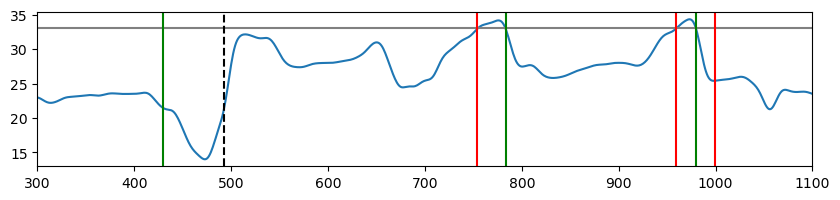

Filtering last event: 999 565
valid end point
valid beginning
(1, 1)


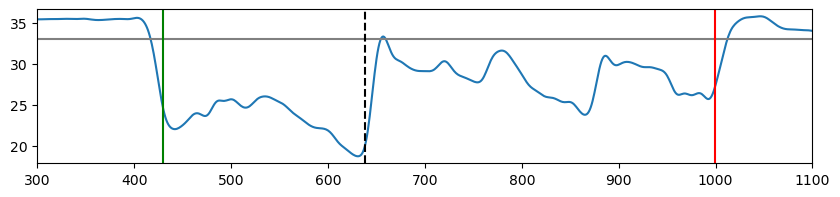

Filtering last event: 999 73
valid end point
valid beginning
(1, 2)


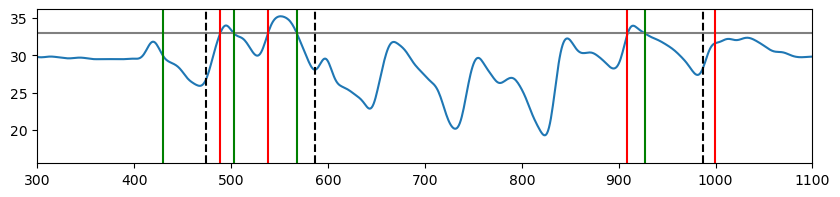

Filtering last event: 999 25
valid end point
valid beginning
(1, 3)


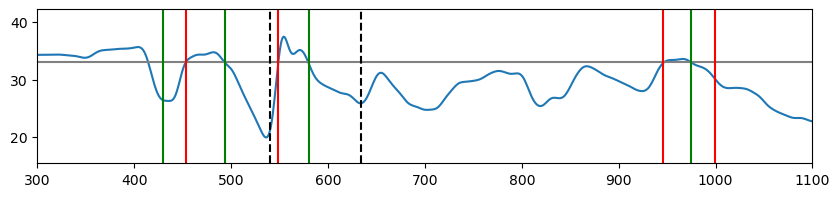

Filtering last event: 999 165
valid end point
remoning first event initiated during contraction 34
(1, 4)


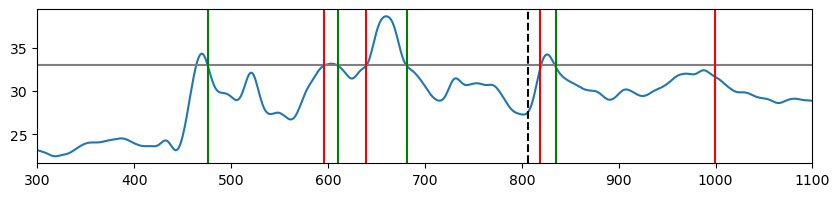

Filtering last event: 988 193
valid end point
valid beginning
(1, 5)


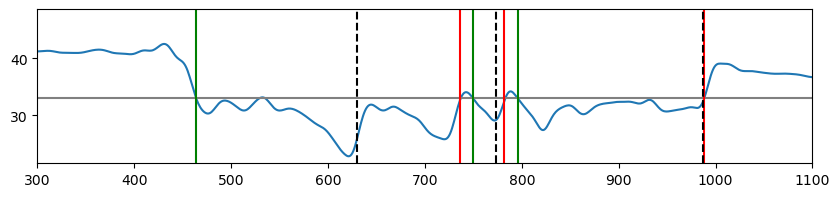

Filtering last event: 999 22
valid end point
valid beginning
(1, 6)


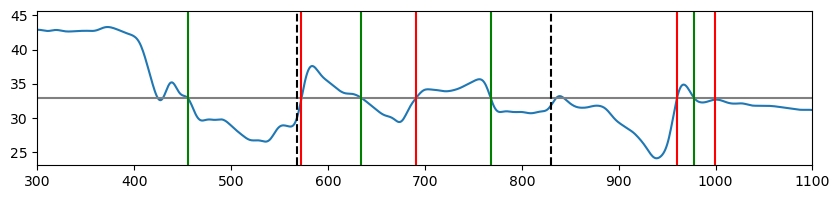

Filtering last event: 901 91
valid end point
valid beginning
(1, 7)


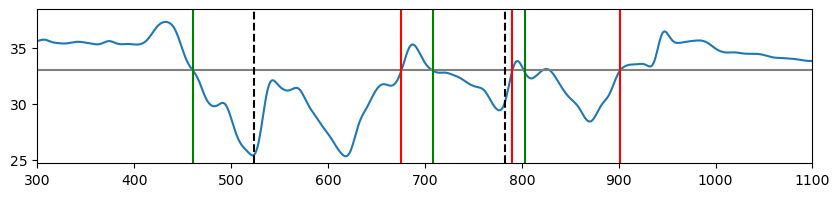

Filtering last event: 999 323
valid end point
valid beginning
(1, 8)


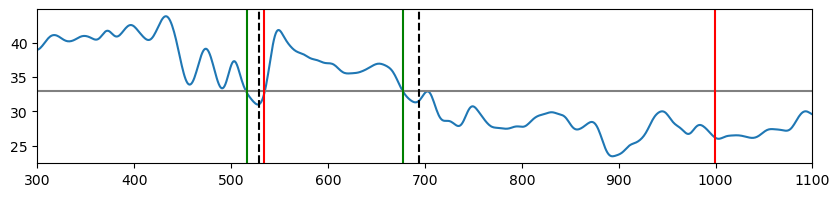

Filtering last event: 999 172
valid end point
valid beginning
(1, 9)


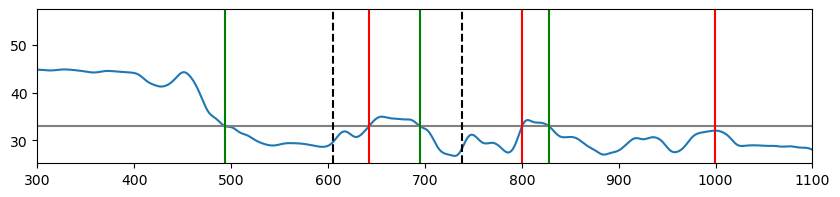

Filtering last event: 999 512
valid end point
remoning first event initiated during contraction 27
(1, 10)


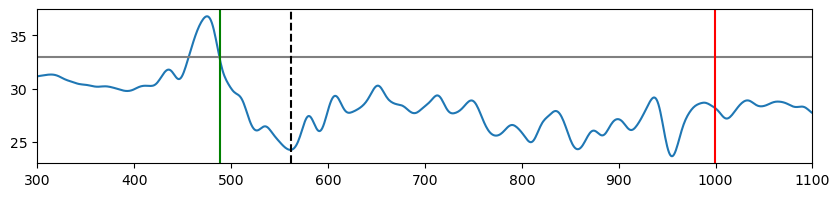

Filtering last event: 554 93
valid end point
valid beginning
(2, 1)


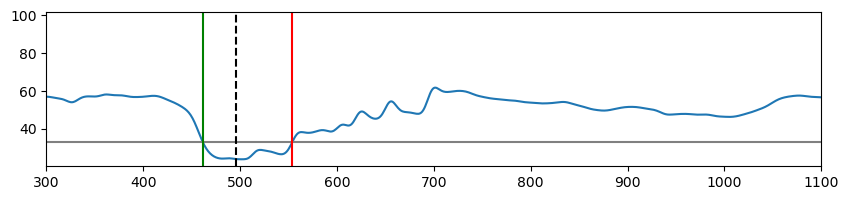

Filtering last event: 983 47
valid end point
valid beginning
(2, 3)


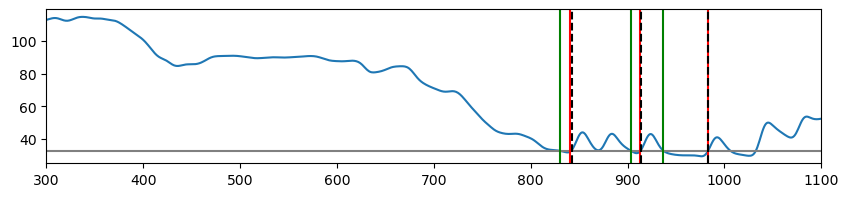

Filtering last event: 752 22
valid end point
valid beginning
(2, 5)


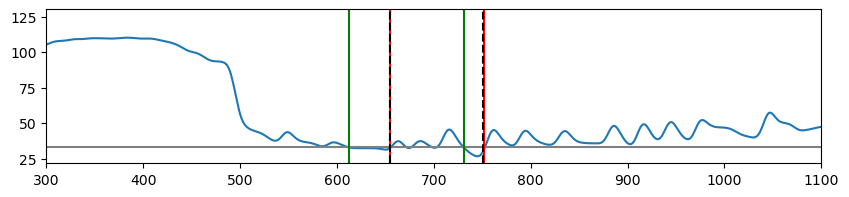

Filtering last event: 999 15
removing last event of length 15
valid beginning
(2, 6)


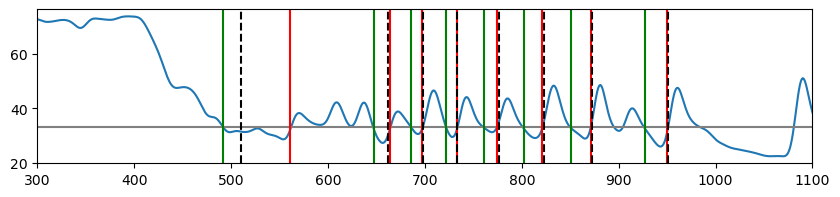

Filtering last event: 999 65
valid end point
valid beginning
(2, 7)


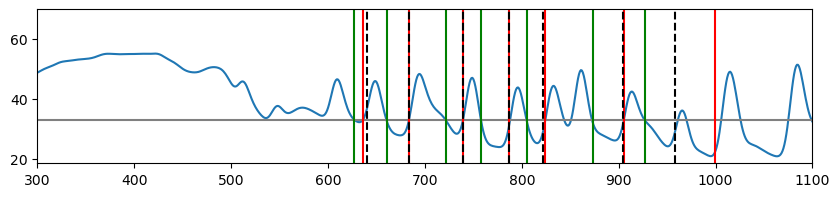

Filtering last event: 773 17
valid end point
valid beginning
(2, 8)


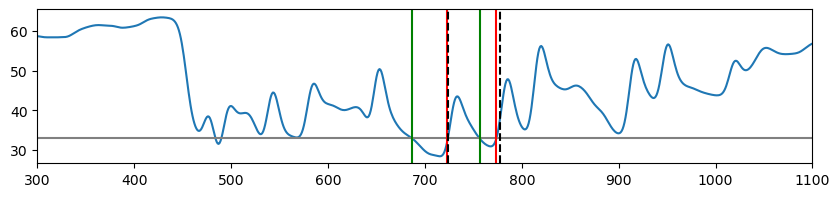

Filtering last event: 987 17
valid end point
valid beginning
(2, 9)


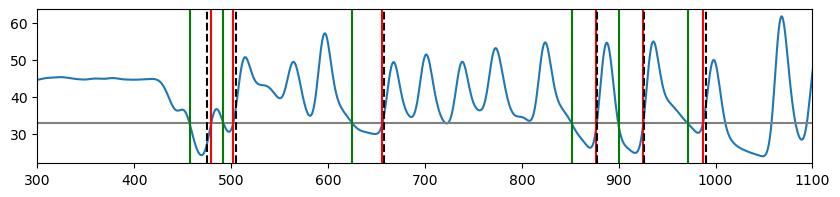

Filtering last event: 999 15
removing last event of length 15
valid beginning
(2, 10)


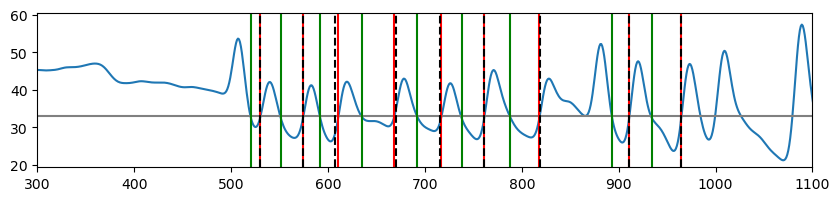

Filtering last event: 824 88
valid end point
valid beginning
(3, 1)


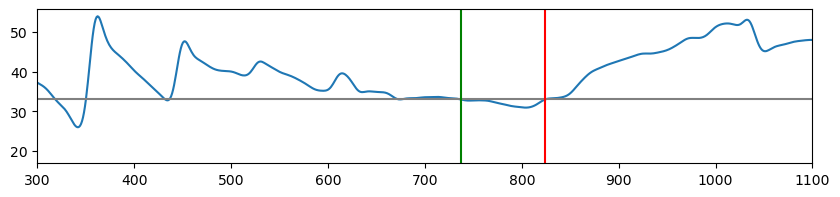

Filtering last event: 436 7
valid end point
Filtering last event: 434 5
valid end point
Filtering last event: 459 5
valid end point
Filtering last event: 430 1
valid end point
Filtering last event: 915 376
valid end point
valid beginning
(5, 1)


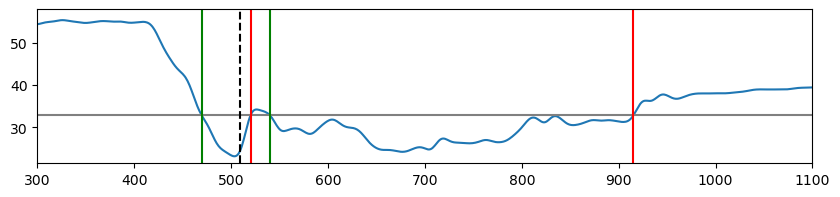

Filtering last event: 719 19
valid end point
valid beginning
(5, 2)


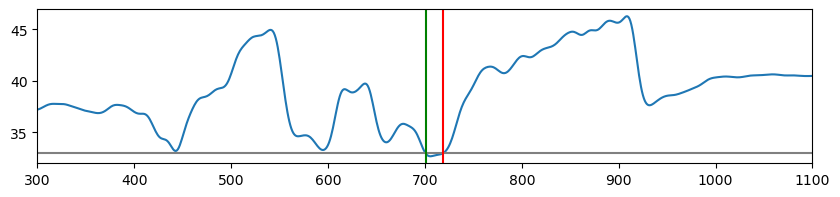

Filtering last event: 999 247
valid end point
valid beginning
(5, 3)


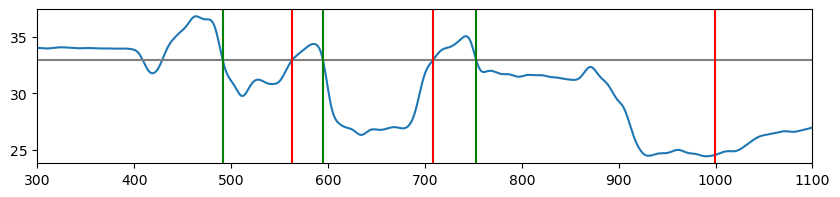

Filtering last event: 927 17
valid end point
valid beginning
(5, 4)


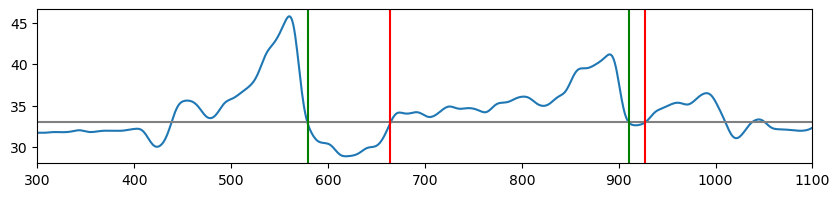

Filtering last event: 565 43
valid end point
valid beginning
(5, 5)


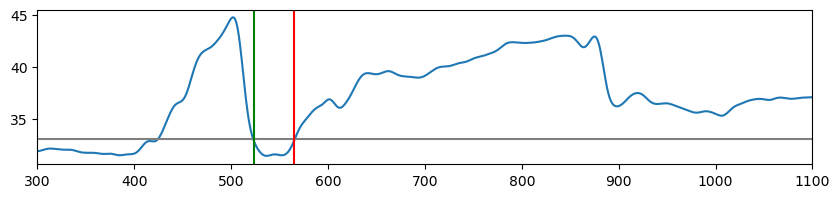

Filtering last event: 975 54
valid end point
valid beginning
(5, 6)


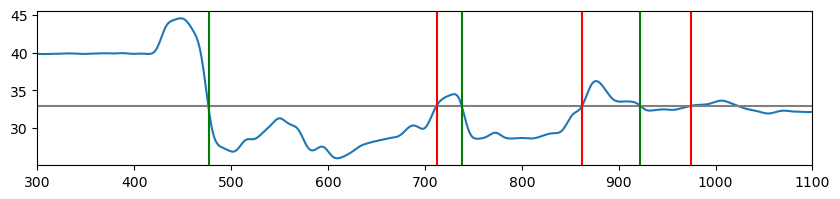

Filtering last event: 589 58
valid end point
valid beginning
(5, 7)


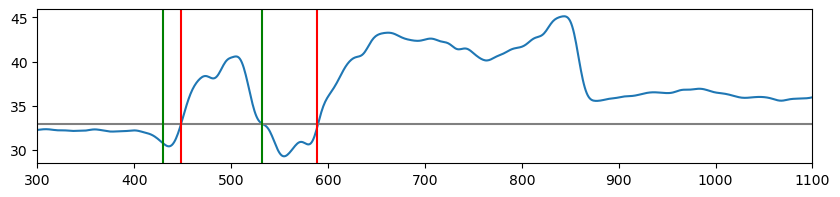

Filtering last event: 846 125
valid end point
valid beginning
(5, 8)


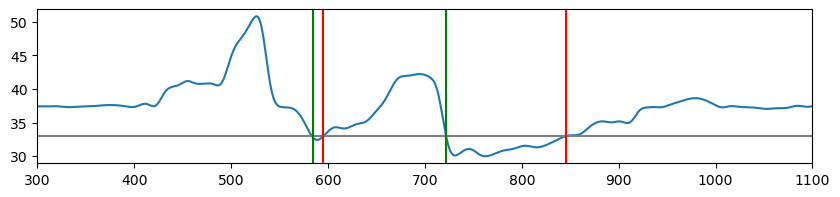

Filtering last event: 487 19
valid end point
valid beginning
(5, 9)


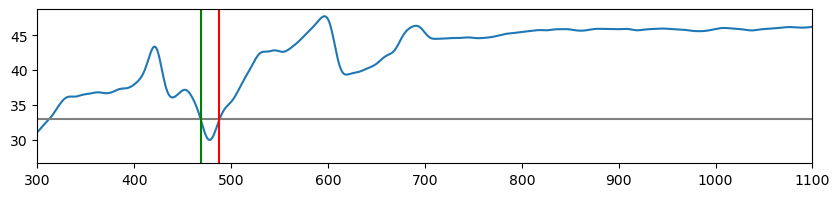

Filtering last event: 458 25
valid end point
valid beginning
(6, 1)


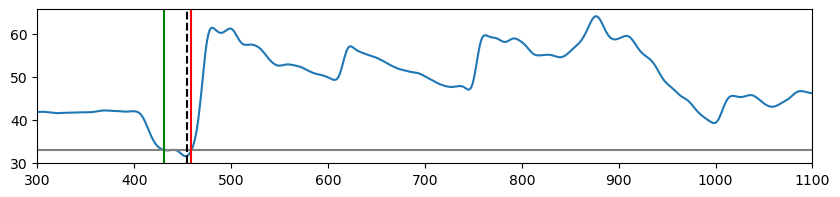

Filtering last event: 446 17
valid end point
valid beginning
(6, 2)


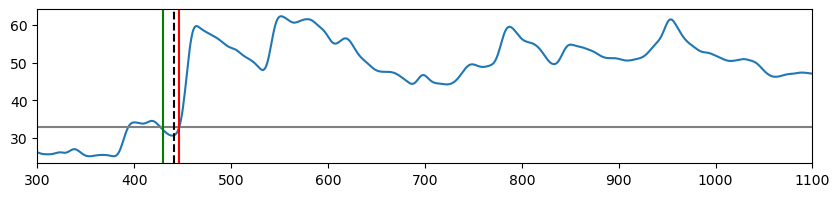

Filtering last event: 854 3
valid end point
remoning first event initiated during contraction 35
(7, 1)


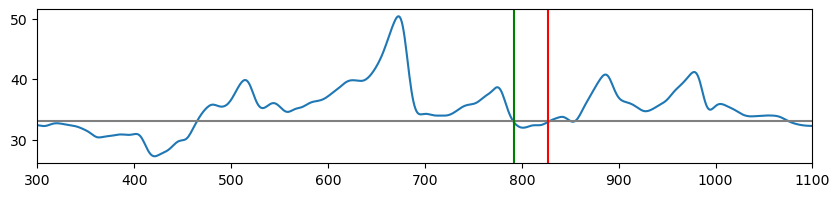

Filtering last event: 999 256
valid end point
valid beginning
(7, 2)


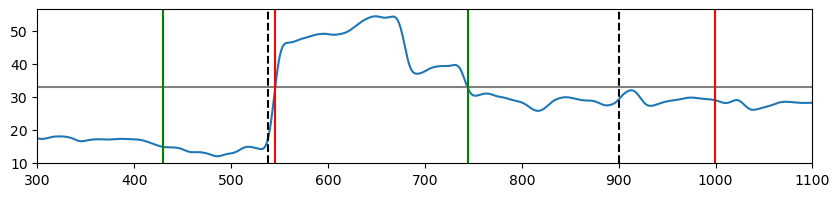

Filtering last event: 999 570
valid end point
valid beginning
(7, 3)


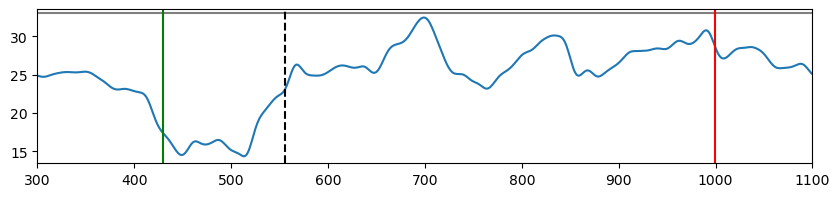

Filtering last event: 999 570
valid end point
valid beginning
(7, 4)


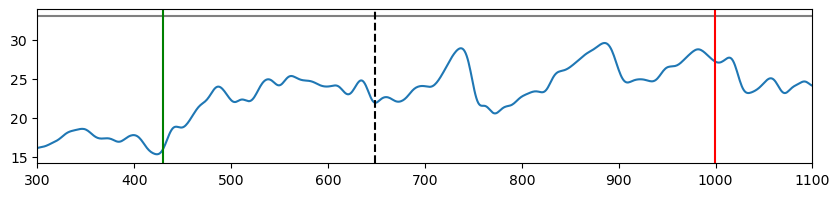

Filtering last event: 999 453
valid end point
valid beginning
(7, 5)


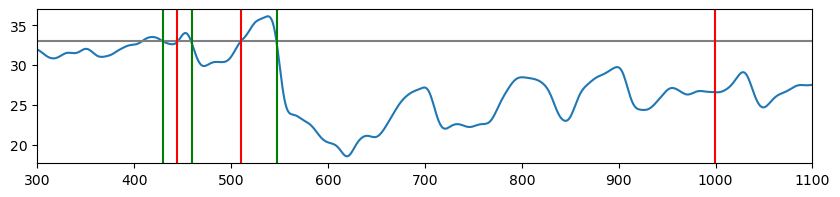

Filtering last event: 999 205
valid end point
remoning first event initiated during contraction 25
(7, 6)


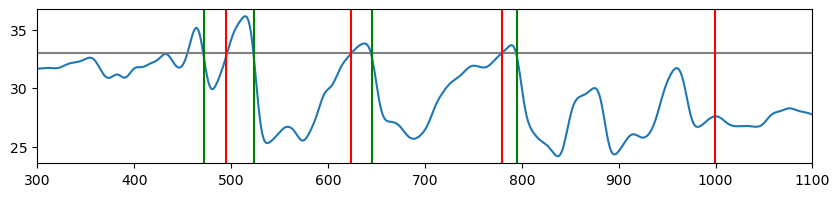

Filtering last event: 999 570
valid end point
valid beginning
(7, 7)


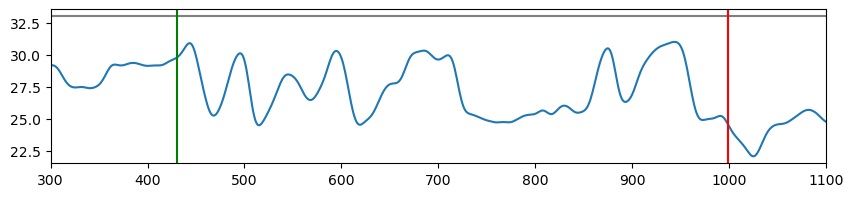

Filtering last event: 999 429
valid end point
valid beginning
(7, 8)


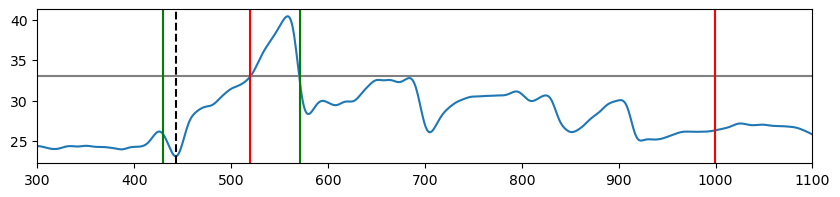

Filtering last event: 999 570
valid end point
valid beginning
(7, 9)


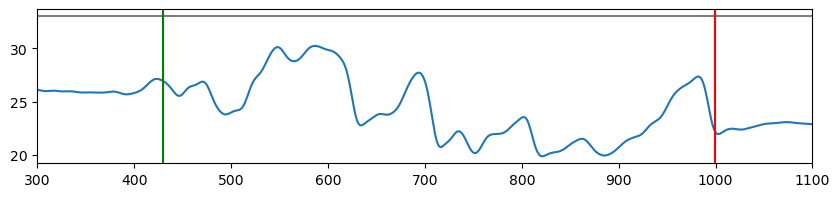

Filtering last event: 999 568
valid end point
valid beginning
(7, 10)


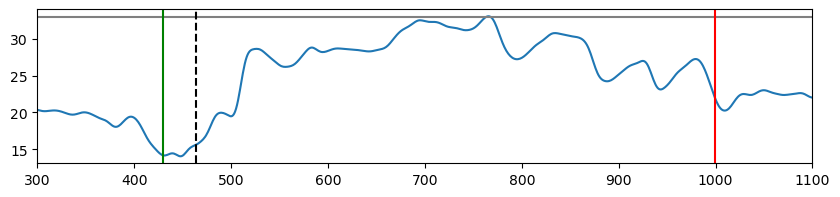

In [ ]:
ang_name = 'C_flex'
count_SIZ_reached_MDN_L2, swing_events_within_SIZ_MDN_L2, percentage_MDN_L2, dwell_time_MDN_L2, SD_MDN_L2 = get_stepping_params_Mleg(MDN,'L2','L2'+ang_name, swing_ts_MDN_L2 )
count_SIZ_reached_MDN_R2, swing_events_within_SIZ_MDN_R2, percentage_MDN_R2, dwell_time_MDN_R2, SD_MDN_R2 = get_stepping_params_Mleg(MDN,'R2','R2'+ang_name, swing_ts_MDN_R2 )

Filtering last event: 999 476
valid end point
valid beginning
(3, 1)


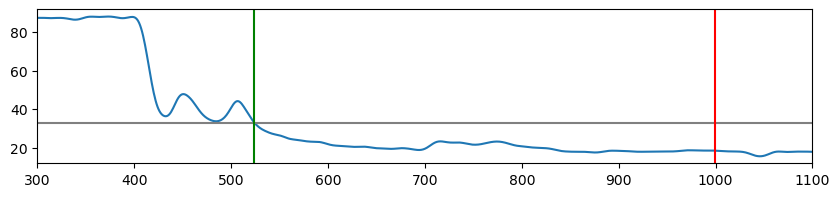

Filtering last event: 731 302
valid end point
valid beginning
(3, 3)


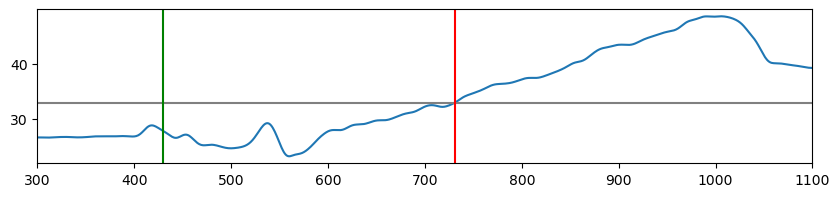

Filtering last event: 999 570
valid end point
valid beginning
(3, 4)


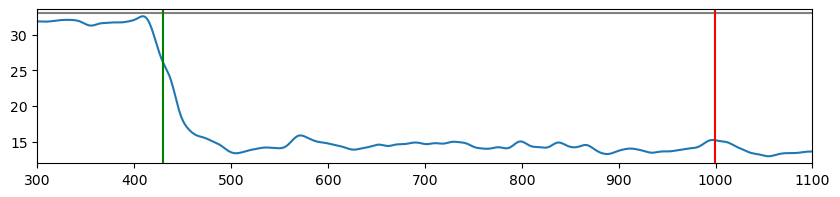

Filtering last event: 999 560
valid end point
valid beginning
(3, 5)


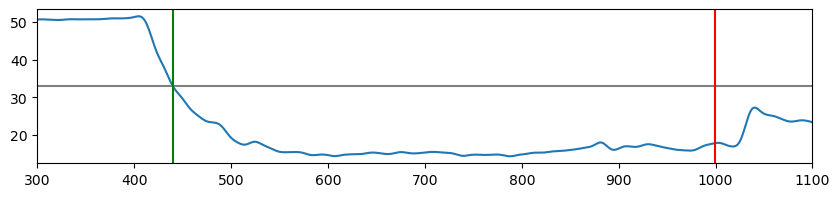

Filtering last event: 999 570
valid end point
valid beginning
(3, 6)


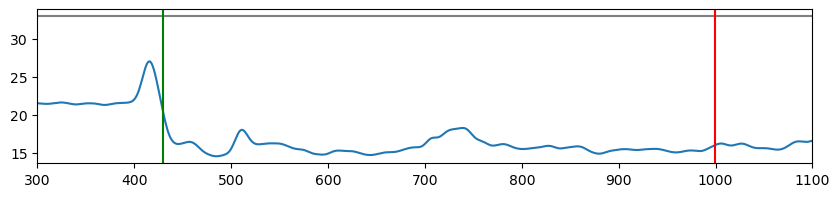

Filtering last event: 999 561
valid end point
valid beginning
(3, 7)


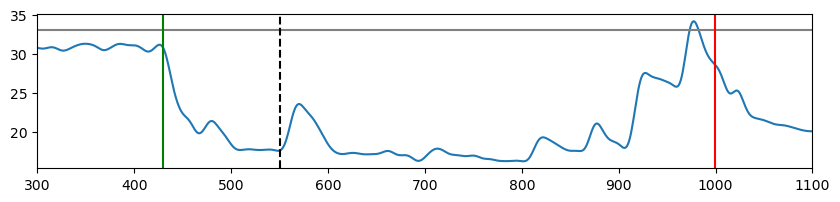

Filtering last event: 999 377
valid end point
valid beginning
(3, 8)


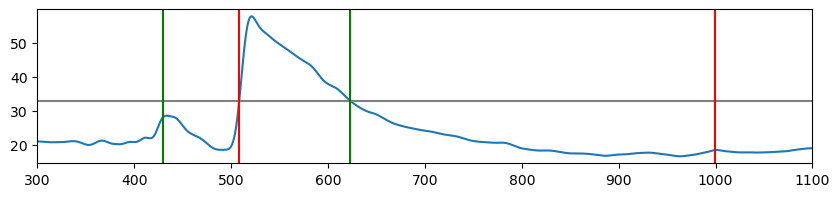

Filtering last event: 999 509
valid end point
valid beginning
(3, 9)


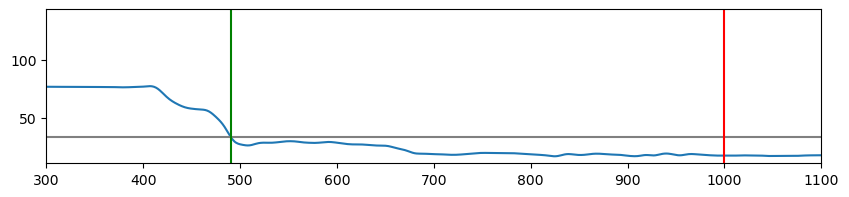

Filtering last event: 999 570
valid end point
valid beginning
(3, 10)


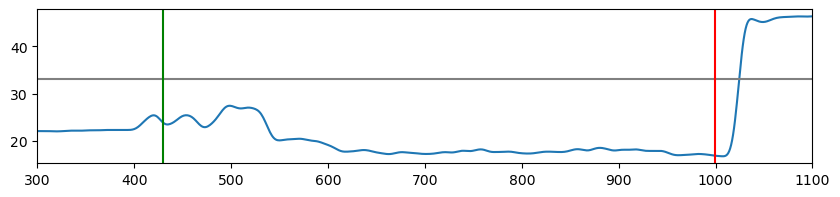

Filtering last event: 432 3
valid end point
Filtering last event: 436 4
valid end point
Filtering last event: 435 6
valid end point
Filtering last event: 999 195
valid end point
valid beginning
(6, 8)


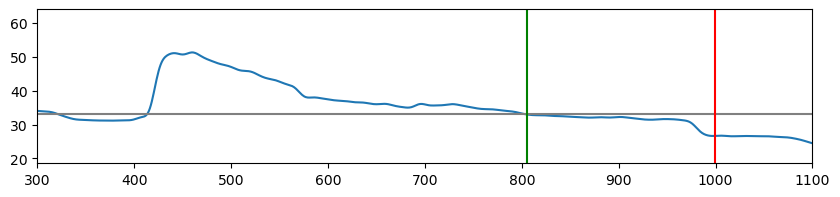

Filtering last event: 430 1
valid end point
Filtering last event: 999 338
valid end point
valid beginning
(2, 2)


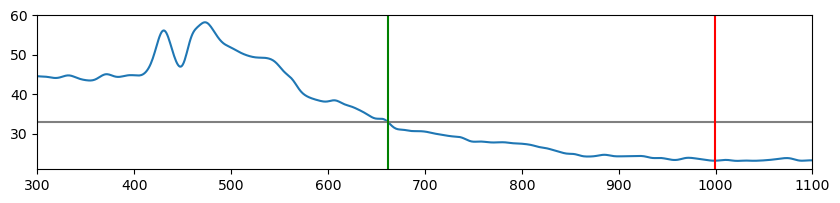

Filtering last event: 999 37
valid end point
valid beginning
(2, 7)


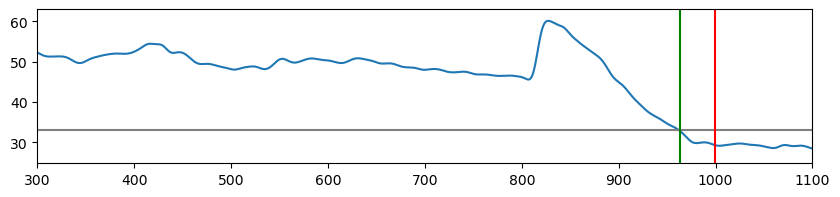

Filtering last event: 961 126
valid end point
valid beginning
(3, 3)


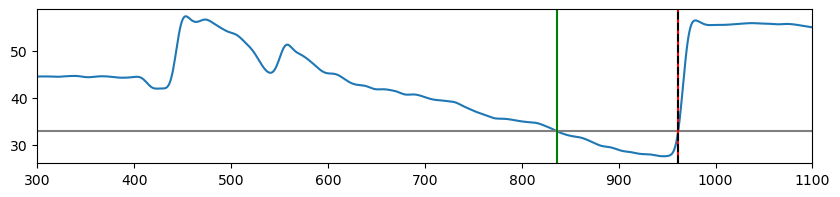

Filtering last event: 441 12
valid end point
remoning first event initiated during contraction 12
Filtering last event: 474 45
valid end point
remoning first event initiated during contraction 45
Filtering last event: 461 32
valid end point
remoning first event initiated during contraction 32
Filtering last event: 447 18
valid end point
remoning first event initiated during contraction 18
Filtering last event: 449 20
valid end point
valid beginning
(5, 6)


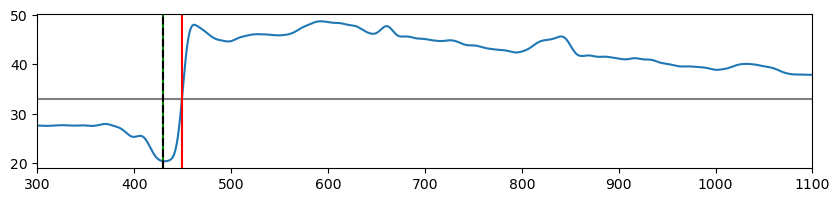

Filtering last event: 457 28
valid end point
valid beginning
(5, 7)


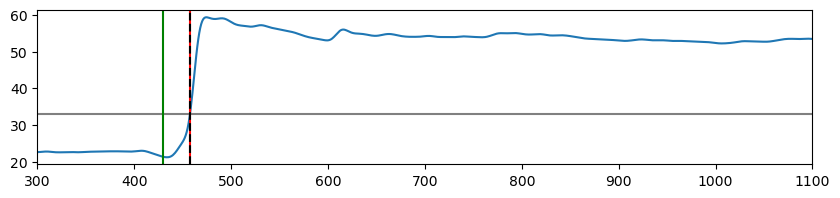

Filtering last event: 463 34
valid end point
valid beginning
(5, 8)


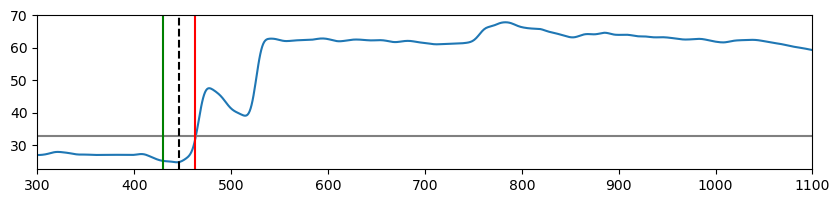

Filtering last event: 448 19
valid end point
remoning first event initiated during contraction 19
Filtering last event: 987 51
valid end point
valid beginning
(6, 1)


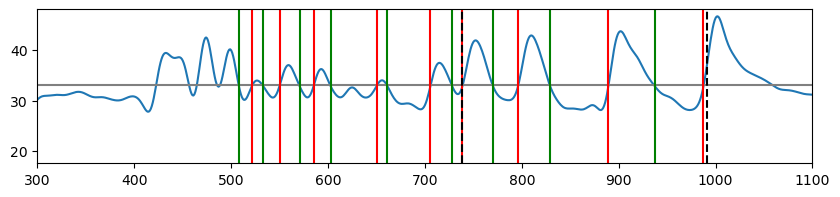

Filtering last event: 999 76
valid end point
valid beginning
(6, 2)


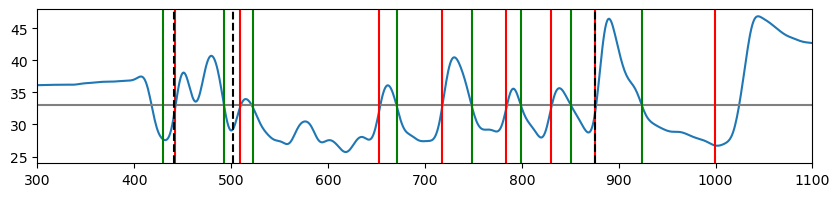

Filtering last event: 999 78
valid end point
valid beginning
(6, 3)


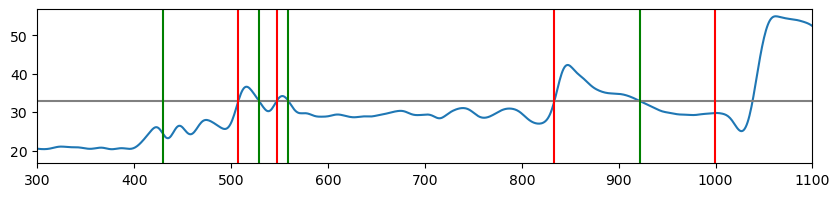

Filtering last event: 999 28
valid end point
remoning first event initiated during contraction 18
(6, 4)


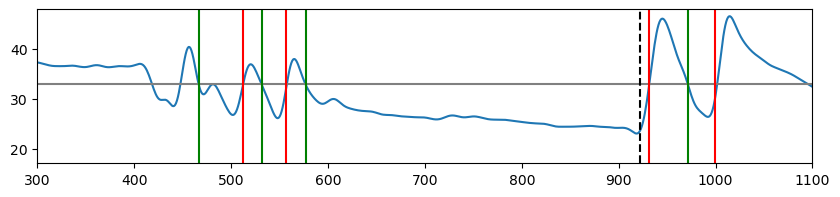

Filtering last event: 999 154
valid end point
remoning first event initiated during contraction 37
(6, 5)


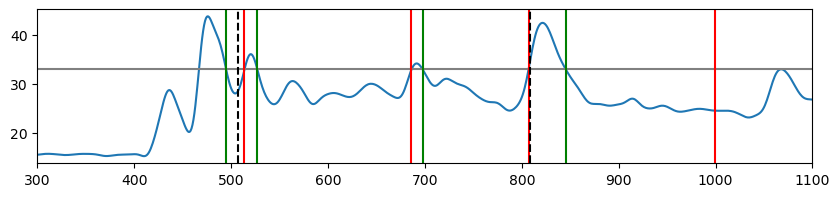

Filtering last event: 963 212
valid end point
remoning first event initiated during contraction 38
(6, 6)


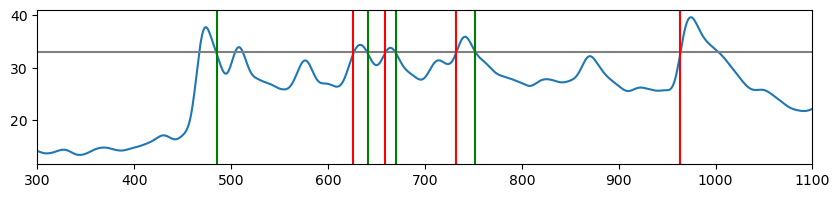

Filtering last event: 999 174
valid end point
valid beginning
(6, 7)


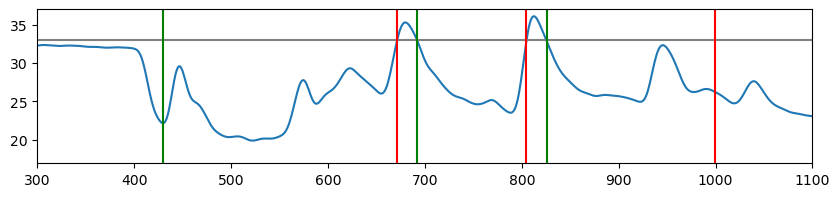

Filtering last event: 999 570
valid end point
valid beginning
(6, 8)


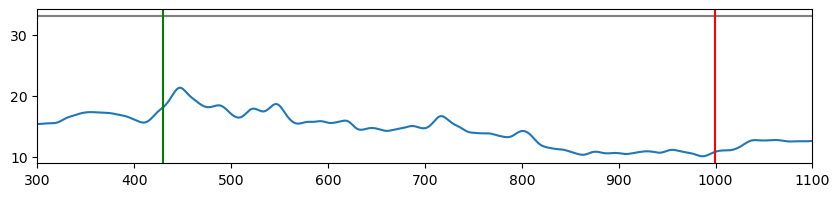

Filtering last event: 999 92
valid end point
valid beginning
(6, 9)


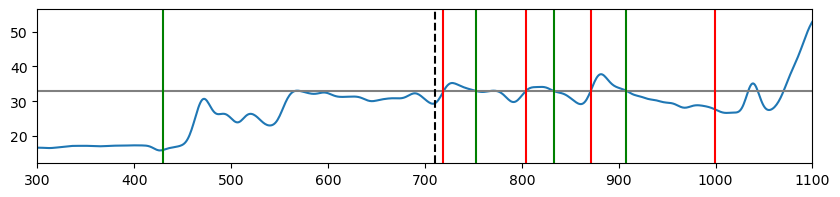

Filtering last event: 999 136
valid end point
valid beginning
(6, 10)


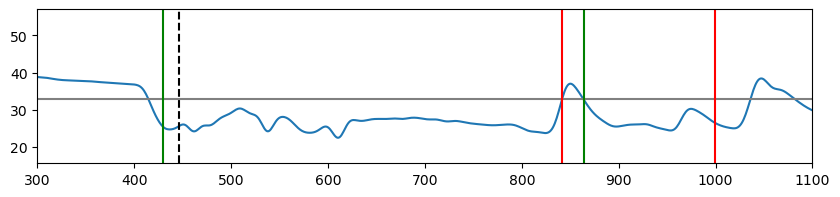

Filtering last event: 999 169
valid end point
valid beginning
(7, 1)


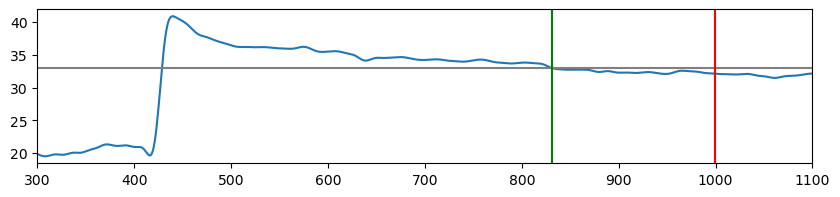

Filtering last event: 616 174
valid end point
valid beginning
(7, 5)


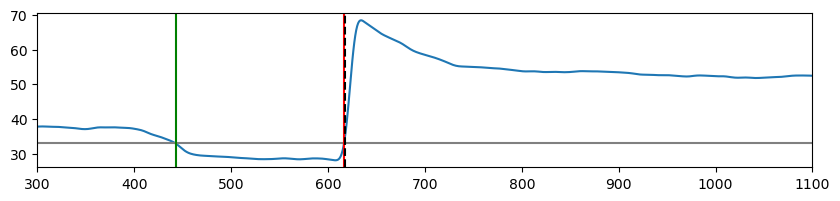

Filtering last event: 546 117
valid end point
valid beginning
(7, 7)


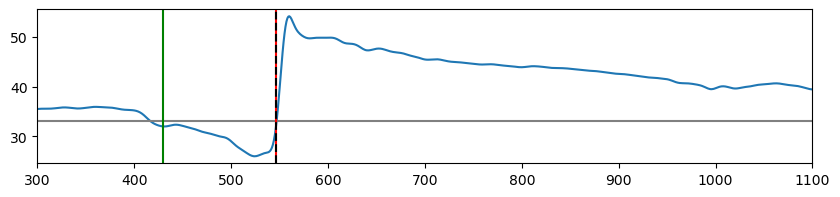

Filtering last event: 999 157
valid end point
valid beginning
(7, 9)


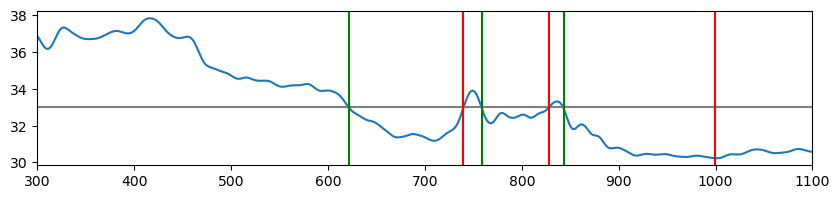

Filtering last event: 999 287
valid end point
valid beginning
(7, 10)


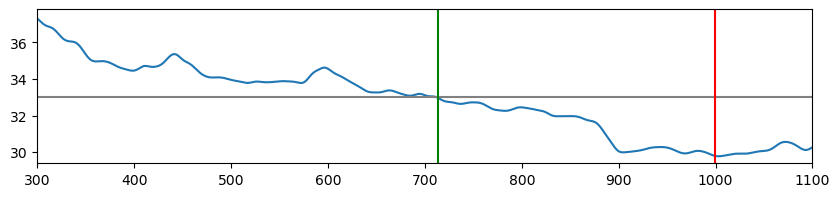

Filtering last event: 539 18
valid end point
valid beginning
(8, 7)


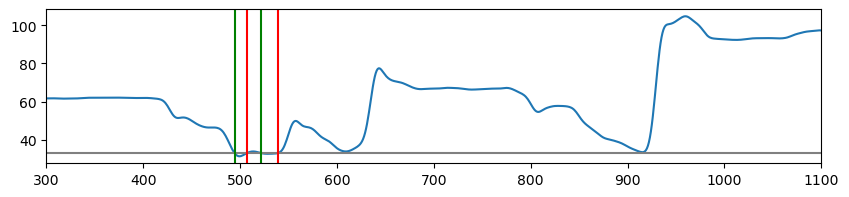

Filtering last event: 491 62
valid end point
valid beginning
(8, 9)


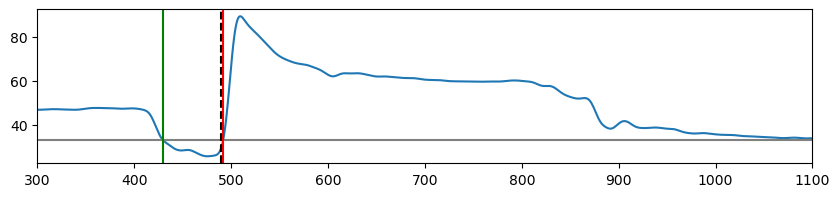

Filtering last event: 546 112
valid end point
valid beginning
(8, 10)


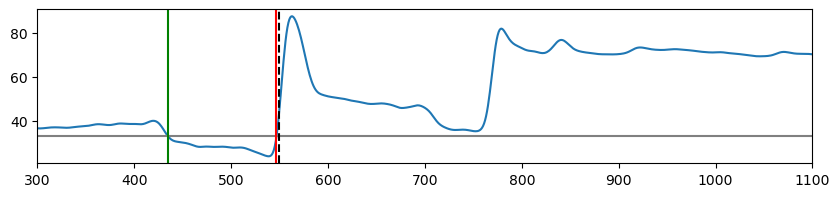

In [ ]:
count_SIZ_reached_MDN_Stop1_L2, swing_events_within_SIZ_MDN_Stop1_L2, percentage_MDN_Stop1_L2, dwell_time_MDN_Stop1_L2, SD_MDN_Stop1_L2  = get_stepping_params_Mleg(MDN_Stop1,'L2','L2'+ang_name, swing_ts_MDN_Stop1_L2 )
count_SIZ_reached_MDN_Stop1_R2, swing_events_within_SIZ_MDN_Stop1_R2, percentage_MDN_Stop1_R2, dwell_time_MDN_Stop1_R2, SD_MDN_Stop1_R2 = get_stepping_params_Mleg(MDN_Stop1,'R2','R2'+ang_name, swing_ts_MDN_Stop1_R2)

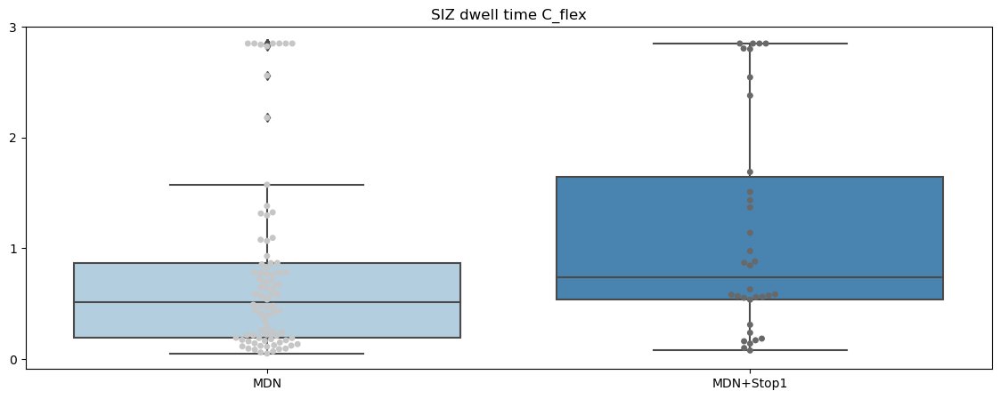

In [ ]:
dwell_time_Mlegs_pooled = pd.concat([pd.concat([pd.DataFrame(dwell_time_MDN_L2),pd.DataFrame(dwell_time_MDN_R2)]).reset_index(drop=True),
                                    pd.concat([pd.DataFrame(dwell_time_MDN_Stop1_L2),pd.DataFrame(dwell_time_MDN_Stop1_R2)]).reset_index(drop=True)], axis =1)
dwell_time_Mlegs_pooled.columns = header       
# dwell_time_Mlegs_pooled.to_csv(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Mid\DT_'+ang_name+'.csv')  


plt.rcParams['figure.figsize'] = (14,5)
sns.boxplot(dwell_time_Mlegs_pooled, palette= 'Blues')
sns.swarmplot(dwell_time_Mlegs_pooled, size = 5, palette= 'Greys')

plt.yticks(np.arange(0,800,200), np.arange(0,4,1))
plt.title('SIZ dwell time '+ ang_name)
# plt.savefig(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Mid\DwellTime_'+ang_name+'.svg', dpi = 300)

c:\Users\SthanuKumarD\Anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 20.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
c:\Users\SthanuKumarD\Anaconda3\lib\site-packages\seaborn\categorical.py:3544: UserWarning: 22.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


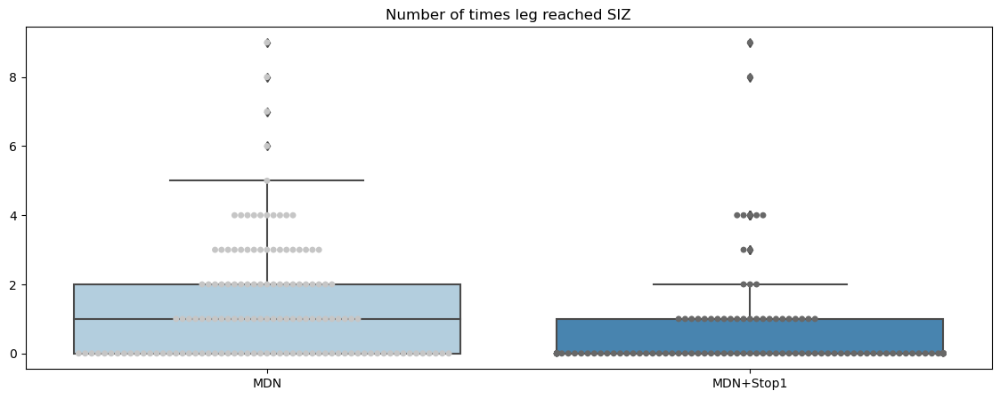

In [ ]:
count_SIZ_Mlegs_pooled = pd.concat([pd.concat([pd.DataFrame(count_SIZ_reached_MDN_L2),pd.DataFrame(count_SIZ_reached_MDN_R2)]).reset_index(drop=True),
                                    pd.concat([pd.DataFrame(count_SIZ_reached_MDN_Stop1_L2),pd.DataFrame(count_SIZ_reached_MDN_Stop1_R2)]).reset_index(drop=True)], axis =1)
count_SIZ_Mlegs_pooled.columns = header    
# count_SIZ_Mlegs_pooled.to_csv(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Mid\Count_'+ang_name+'.csv') 

plt.rcParams['figure.figsize'] = (14,5)


sns.boxplot(count_SIZ_Mlegs_pooled, palette= 'Blues')
sns.swarmplot(count_SIZ_Mlegs_pooled, size = 5, palette= 'Greys')

# plt.yticks(np.arange(0,13,2))
plt.title('Number of times leg reached SIZ')
# plt.savefig(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Mid\SIZ_Count_'+ang_name+'.svg', dpi = 300)

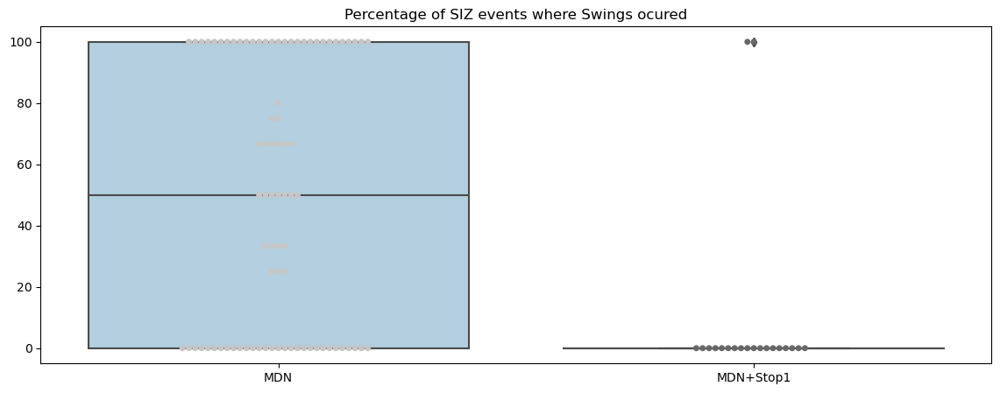

In [ ]:
percentage_swings_SIZ_Mlegs_pooled = pd.concat([pd.concat([pd.DataFrame(percentage_MDN_L2),pd.DataFrame(percentage_MDN_R2)]).reset_index(drop=True),
                                    pd.concat([pd.DataFrame(percentage_MDN_Stop1_L2),pd.DataFrame(percentage_MDN_Stop1_L2)]).reset_index(drop=True)], axis =1)
percentage_swings_SIZ_Mlegs_pooled.columns = header    
# percentage_swings_SIZ_Mlegs_pooled.to_csv(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Mid\PS_'+ang_name+'.csv') 

plt.rcParams['figure.figsize'] = (14,5)

sns.boxplot(percentage_swings_SIZ_Mlegs_pooled, palette= 'Blues')
sns.swarmplot(percentage_swings_SIZ_Mlegs_pooled, size = 5, palette= 'Greys')

# plt.yticks(np.arange(0,13,2))
plt.title('Percentage of SIZ events where Swings ocured')
# plt.savefig(r'Z:\Divya\TEMP_transfers\toSB\0_StopPAper_revision\3_Coactivation_Revised\MDN_BRK\Mid\Percent_Swings_'+ang_name+'.svg', dpi = 300)

In [ ]:
raise TypeError('end of section')

TypeError: end of section